### Brief introduction
Foygel and Dell's 

#### Data:
The network will be trained on 1000 words and tested on 548.  All data will be transformed into semantic and phonological representations. The phonoligcal transformation processes followed two distinct steps. First, Arpabet [8] was utilized create phonological representations of the sound sequences in each word.  The coding scheme with examples is provide in Table 1. This function was completed automatically through an online transcription tool at http://www.speech.cs.cmu.edu/cgi-bin/cmudict. Then binary (0,1) vectors for the representations of each phoneme needed to create each word were created. There was also a stop element in the phoneme input/output data with the intended purpose of informing the network when the ending of each phoneme sequence. 
	The semantic input consisted of a similarity matrix constructed from word embeddings from each word. Each word’s embedding is a vector with a length of 100. The vector for a single word is its distributed representation based on the use of each word in a twenty-six gigabyte corpus of linguistic data from Googles Newswire [9]. The similarity matrix is conducted of the cosine distance between each 100 element vector.  Each words input data in the semantic layer is their 1000 element word similarity vector. 

# insert table 1 here

#### Model configuration:
The network was constructed based off the Lichteim 2 model from Ueno and colleagues [3] and is displayed in Figure 1. The network architecture is informed by the assumptions of dual stream models of language [1], [2] with blue and red arrows representing the phonological (dorsal) and semantic (ventral) processing streams.  Each layer is also labeled as to its presumed cortical representation.  Pytorch [6] was utilized to construct the network, which contains bidirectional activation between three input/output layers, which contain a minimum of one hidden layer between each. The two input layers include semantics and phonology, which are both connected to output phonology. The input phonology and output phonology are connected by a single hidden layer with the aim of modeling a word repetition task.  Given the sequential processing of speech sounds that is necessary to complete such a task two processes were constructed in the model.  First, model recieves each phoneme of each word in sequential steps. For example the d, o, and g are delivered in three unique time steps.  To account for sequential processing of speech sounds, the hidden layer between input and output phonology includes a recurrent loop [7].  The semantic and output phonology path was designed to imitate a picture naming task and includes two hidden layers. Finally, auditory comprehension is modeled through the following connection: input phonology, semantics, to output phonology. 

#### Figure 1: Visual schematic of the Comprehension, Production, and Repetition neural network (Modified from Ueno and colleagues [3])
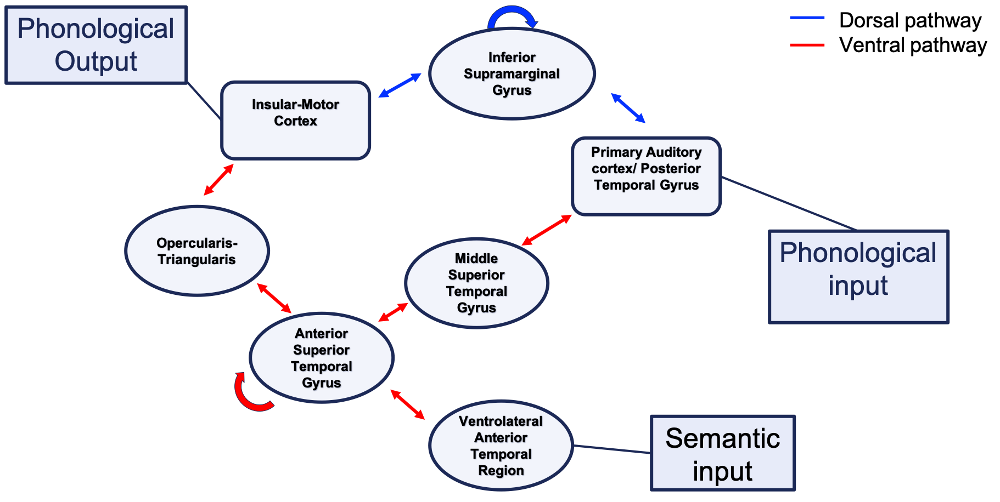
* Note: 
 1) Square boxes denote where the input layer is, and are NOT the input layer itself 
 2) Curved arrows represent a recurrent loop 

In [1]:
import gensim
from gensim.matutils import corpus2csc
from gensim.corpora import Dictionary
import pandas as pd
import numpy as np

#### Loading data and converting each to utilize in the semantic input layer. I do not know what is the better way to do this, so I my goal is to understand how to set up this input layer for both methods.
 1. Method one is an array of word embeddings of all the words that can be found in the wiki gigaword database
 2. Method two is a similarity matrix based on the word embeddings for all the words within the wikigigaworld database

In [2]:
#Load data
import numpy as np
import pandas as pd
from pandas import DataFrame
#ChNGED TO MATCH NEW INPUT WORDS
#words = pd.read_csv('DRitems.csv')
#words.columns = ['Number', 'Word']
words = pd.read_csv('Just_Item_Names.csv')
df = DataFrame(words, columns= ['Word'])
df_list = df.values.tolist()

In [3]:
words

,Unnamed: 0,Word
0,0,BEAR
1,1,BEAVER
2,2,BEE
3,3,BIRD
4,4,BUG
...,...,...
1349,1349,MAP
1350,1350,FLOWER
1351,1351,MOUNTAIN
1352,1352,TREE


In [4]:
#Method 1: Get word embeddings for all available words from Wikigigaworld.
import gensim.downloader as api
# Download dataset
glove_model300 = api.load('glove-wiki-gigaword-300')

# Label Encoding

In [5]:
from sklearn import preprocessing 

In [6]:
import torch
import torch.nn as nn

In [7]:
label_encoder = preprocessing.LabelEncoder() 

In [8]:
#words = pd.read_csv('Dritems.csv')
words = pd.read_csv('Just_Item_Names.csv')
#words.columns = ['Number', 'Word']
words.shape
#df = DataFrame(words, columns= ['Word'])
#df_list = df.values.tolist()

(1354, 2)

In [9]:
words

,Unnamed: 0,Word
0,0,BEAR
1,1,BEAVER
2,2,BEE
3,3,BIRD
4,4,BUG
...,...,...
1349,1349,MAP
1350,1350,FLOWER
1351,1351,MOUNTAIN
1352,1352,TREE


In [10]:
#phon = pd.read_csv('Words w transcription.csv')
phon = pd.read_csv('UpdatedWordList.csv')
phon.fillna('', inplace = True)
phon.columns = ['Word', '1', '2', '3', '4', '5', '6','7', '8', '9', '10', '11']
phon = phon.iloc[:-1 , :]
X = phon['Word']
X.head()
X.shape

(1354,)

In [11]:
phon

,Word,1,2,3,4,5,6,7,8,9,10,11
0,bear,B,EH,R,,,,,,,,
1,beaver,B,IY,V,ER,,,,,,,
2,bee,B,IY,,,,,,,,,
3,bird,B,ER,D,,,,,,,,
4,bug,B,AH,G,,,,,,,,
...,...,...,...,...,...,...,...,...,...,...,...,...
1349,map,M,AE,P,,,,,,,,
1350,flower,F,L,AW,ER,,,,,,,
1351,mountain,M,AW,N,T,AH,N,,,,,
1352,tree,T,R,IY,,,,,,,,


In [12]:
phon.shape

(1354, 12)

In [13]:
#word_array = np.empty((0, 300))
X2 = []
yfound = []
for idx, row in enumerate(X):
    try:
        word_array = np.empty((0, 300))
        result = glove_model300.word_vec(row)
        word_array = np.append(word_array, [result], axis = 0)
        X[idx] = result
        X2.append(result)
        #yfound.append(row[0:14])
        #print(X2)
    except:
         #X[idx] = 'None'
        pass

In [14]:
X

0       [0.086177, 0.054755, -0.44714, -0.022551, 0.31...
1       [-0.3514, -0.007505, -0.14778, -0.46901, -0.11...
2       [-0.26607, 0.3776, -0.37297, 0.39632, -0.25198...
3       [0.31526, 0.65435, -0.20719, -0.4703, -0.26015...
4       [-0.13152, 0.30946, -0.076001, -0.26066, 0.091...
                              ...                        
1349    [-0.30565, -0.32174, 0.062803, -0.44854, -0.26...
1350    [-0.56625, 0.20433, -0.58515, -0.33093, -0.115...
1351    [-0.43259, 0.40692, -0.12746, -0.25947, 0.0628...
1352    [-0.56435, -0.1297, 0.14408, -0.44019, -0.3366...
1353    [-0.17088, 0.62136, 0.20137, 0.12067, 0.25003,...
Name: Word, Length: 1354, dtype: object

In [15]:
#check for missing data
for i in X2:
    print(len(i))
    if(len(i)<300):
        print(i)

300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300
300


In [16]:
X2 = np.array(X2)
X2.shape

(1354, 300)

In [17]:
replace_phons = {'':0,
'AA' :1,

'AE' :2,

'AH' :3,

'AO' :4,

'AW' :5,

'AY' :6,

'B' :7,

'CH' :8,

'D' :9,

'DH' :10,

'EH' :11,

'ER' :12,

'EY' :13,

'F' :14,

'G' :15,

'HH' :16,

'IH' :17,

'IY' :18,

'JH' :19,

'K' :20,

'L' :21,

'M' :22,

'N' :23,

'NG' :24,

'OW' :25,

'OY' :26,

'P' :27,

'R' :28,

'S' :29,

'SH' :30,

'T' :31,

'TH' :32,

'UH' :33,

'UW' :34,

'V' :35,

'W' :36,

'Y' :37,

'Z' :38,

'ZH' :39}

In [18]:
#sorted_data
y = phon
#X = torch.Tensor(word_array)
phon = pd.read_csv('UpdatedWordList.csv')
phon.fillna('', inplace = True)
phon.columns = ['Word', '1', '2', '3', '4', '5', '6','7', '8', '9', '10', '11']
phon = phon.iloc[:-1 , :]
y = phon
y = y.drop('Word', axis = 1)

In [19]:
for col in y.columns:
    #y[col] = y.replace({col: replace_phons}) 
    y[col] = y[col].map(replace_phons)

In [20]:
y.head()

,1,2,3,4,5,6,7,8,9,10,11
0,7,11,28,0,0,0,0,0,0,0,0
1,7,18,35,12,0,0,0,0,0,0,0
2,7,18,0,0,0,0,0,0,0,0,0
3,7,12,9,0,0,0,0,0,0,0,0
4,7,3,15,0,0,0,0,0,0,0,0


In [21]:
y.shape

(1354, 11)

# Split

In [22]:
from sklearn.model_selection import train_test_split

In [23]:
y = np.array(y)
#X2 = np.array(X)

In [24]:
X_train, X_test, y_train, y_test = train_test_split(X2, y, test_size=0.10, random_state=42)

In [25]:
X2.shape

(1354, 300)

In [26]:
#for i in X_train:
    #print(len(i))
    #print(i)

In [27]:
X_train = torch.Tensor(X2)
X_test = torch.Tensor(X_test)
y_train = torch.Tensor(y)
y_test = torch.Tensor(y_test)

In [28]:
X_train.shape

torch.Size([1354, 300])

In [29]:
y_train.shape

torch.Size([1354, 11])

# Linear Model with one hidden layer

In [30]:
#Test with nn.sequential
input_size = 300
hidden_sizes = [200]
output_size = 11
model = nn.Sequential(nn.Linear(input_size, hidden_sizes[0]),
                      nn.ReLU(),
                      nn.Linear(hidden_sizes[0], output_size),
                      nn.ReLU())
print(model)
#build feedfrward network

Sequential(
  (0): Linear(in_features=300, out_features=200, bias=True)
  (1): ReLU()
  (2): Linear(in_features=200, out_features=11, bias=True)
  (3): ReLU()
)


In [31]:
optimizer = torch.optim.Adam(model.parameters(), lr=1.0e-3)

In [32]:
optimzer = torch.optim.SGD(model.parameters(), lr=0.05, momentum = 0.9)

In [33]:
from torch.autograd import Variable
import torch.utils.data as data

In [34]:
#Use this section for softmax and cross entropy
#criterion = nn.CrossEntropyLoss()
#output = Variable(torch.randn(1354, 11).float())
#target = Variable(torch.FloatTensor(1354).uniform_(0, 11).long())
#loss = criterion(output, target)

In [35]:
class dataset(data.Dataset):
    def __init__(self):
        self.datalist = X_train
        self.labels = torch.tensor(y_train, dtype=torch.float)
    def __getitem__(self, index):
        return torch.Tensor(self.datalist[index]), self.labels[index]
    def __len__(self):
        return self.datalist.shape[0]

In [36]:
class test_dataset(data.Dataset):
    def __init__(self):
        self.datalist = X_test.values
        self.labels = torch.tensor(y_test.values, dtype=torch.float)
    def __getitem__(self, index):
        return torch.Tensor(self.datalist[index]), self.labels[index]
    def __len__(self):
        return self.datalist.shape[0]

In [37]:
train_Set = dataset()
#test_Set = test_dataset()

<ipython-input-35-d62603124d20>:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.labels = torch.tensor(y_train, dtype=torch.float)


In [38]:
trainloader = torch.utils.data.DataLoader(dataset = train_Set, batch_size = 12, shuffle = True)
#testloader = torch.utils.data.DataLoader( dataset = test_Set, shuffle = False)

In [39]:
train_Set

In [40]:
outputs

NameError: name 'outputs' is not defined

### The following code is the working model

In [ ]:
# Define the loss 
# criterion = nn.NLLLoss()
epochs = 25
for epoch in range(epochs):
    for i, (value, labels) in enumerate(trainloader):
        value = Variable(value)
        labels = Variable(labels)
        labels = labels.squeeze()
        print(labels)
        optimizer.zero_grad()
        value = value.view(value.size(0), -1)
        outputs = model(value)        
        print(outputs)
        loss = criterion(outputs,labels)
        loss.backward()
        optimizer.step()
        
    print ('Epoch [%d/%d], Iter [%d] Loss: %.4f' %(epoch+1, 10, i+1, loss.data))

# Below is my attempt to plot accuracey overtime, which is not working.  The error is coming from the loss function.  Stackoverflow made me think it was because of the batch size, but im not sure why that would be.

In [ ]:
epochs = 5
running_loss = 0
correct = 0
total = 0
train_accu = []
train_losses = []
for epoch in range(epochs):
    for i, (value, labels) in enumerate(trainloader):
        value = Variable(value)
        labels = Variable(labels)
        labels = labels.squeeze()
        print(labels)
        optimizer.zero_grad()
        value = value.view(value.size(0), -1)
        outputs = model(value)        
        print(outputs)
        loss = criterion(outputs,labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
     
        #_, predicted = output
        total += labels.size(0)
        correct += outputs.eq(labels).sum().item()
    train_loss=running_loss/len(trainloader)
    accu=100.*correct/total
   
    train_accu.append(accu)
    train_losses.append(train_loss)
    print('Train Loss: %.3f | Accuracy: %.3f'%(train_loss,accu))

In [ ]:
train_losses

In [ ]:
labels.shape

In [ ]:
### Two hidden layers
#Test with nn.sequential
input_size = 300
hidden_sizes = [200, 100]
output_size = 11
model = nn.Sequential(nn.Linear(input_size, hidden_sizes[0]),
                      nn.ReLU(),
                      nn.Linear(hidden_sizes[0], hidden_sizes[1]),
                      nn.ReLU(),
                      nn.Linear(hidden_sizes[1], output_size),
                      nn.ReLU())
print(model)

In [41]:
net = model()

TypeError: forward() missing 1 required positional argument: 'input'

In [42]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter()

In [43]:
train_losses

NameError: name 'train_losses' is not defined

In [141]:
# Define the loss 
# criterion = nn.NLLLoss()
train_accu = []
train_losses = []
epochs = 100
for epoch in range(epochs):
    for i, (value, labels) in enumerate(trainloader):
        value = Variable(value)
        labels = Variable(labels)
        labels = labels.squeeze()
        print(labels)
        optimizer.zero_grad()
        value = value.view(value.size(0), -1)
        outputs = model(value)        
        print(outputs)
        loss = criterion(outputs, labels)
        writer.add_scalar("Loss/train", loss, epoch)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
     
        #_, predicted = output
        total += labels.size(0)
        correct += outputs.eq(labels).sum().item()
    train_loss=running_loss/len(trainloader)
    accu=100.*correct/total
   
    train_accu.append(accu)
    train_losses.append(train_loss)
    print('Train Loss: %.3f | Accuracy: %.3f'%(train_loss,accu))
        
    print ('Epoch [%d/%d], Iter [%d] Loss: %.4f' %(epoch+1, 10, i+1, loss.data))

tensor([[21., 11., 23., 31.,  3., 21., 38.,  0.,  0.,  0.,  0.],
        [29., 23., 25., 15., 21., 25.,  7.,  0.,  0.,  0.,  0.],
        [ 2., 20., 29.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16.,  4., 28., 23., 38.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 18., 25.,  9., 12.,  3., 23., 31.,  0.,  0.,  0.],
        [29., 31., 17., 24., 28., 13.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 23.,  3., 27., 18.,  0.,  0.,  0.,  0.,  0.],
        [ 8., 17., 27., 22.,  3., 24., 20.,  0.,  0.,  0.,  0.],
        [ 1., 20., 31.,  3., 27., 33., 29.,  0.,  0.,  0.,  0.],
        [22.,  2., 29., 20., 11., 28.,  3.,  0.,  0.,  0.,  0.],
        [28., 17., 24.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 1., 28.,  8.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0438, 0.0739, 0.0395, 0.0000, 0.0188, 0.0677, 0.0161,
         0.1457, 0.0074],
        [0.0000, 0.0000, 0.0186, 0.1347, 0.0376, 0.0000, 0.0672, 0.0602, 0.0329,
         0.1175, 0.0758],
     

         0.0919, 0.0459]], grad_fn=<ReluBackward0>)
tensor([[21., 17., 20., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  1., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  3., 22., 27., 20., 17., 23.,  0.,  0.,  0.,  0.],
        [14.,  1., 20., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 13., 23.,  7., 25.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 8.,  2., 27., 29., 31., 17., 20.,  0.,  0.,  0.,  0.],
        [ 2., 23., 31., 16., 17., 21.,  0.,  0.,  0.,  0.,  0.],
        [22.,  5., 29., 31., 28.,  2., 27.,  0.,  0.,  0.,  0.],
        [29., 20., 34., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29.,  6.,  3., 23., 31., 17., 29., 31.,  0.,  0.,  0.],
        [27.,  3., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  1., 23.,  8., 25.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0523, 0.1105, 0.1188, 0.0000, 0.0731, 0.0555, 0.0542,
         0.0863, 0.0712],
        [0.0000, 0.0000, 0.0342, 0.1099, 0.0743, 0.0000, 0.0

tensor([[0.0000, 0.0137, 0.0000, 0.0981, 0.0388, 0.0000, 0.0636, 0.0913, 0.0187,
         0.0814, 0.0494],
        [0.0000, 0.0000, 0.0148, 0.0847, 0.0538, 0.0000, 0.0120, 0.0317, 0.0577,
         0.1053, 0.0547],
        [0.0120, 0.0194, 0.0511, 0.0633, 0.0497, 0.0000, 0.0000, 0.0517, 0.0430,
         0.1144, 0.0232],
        [0.0000, 0.0000, 0.0601, 0.0879, 0.0746, 0.0000, 0.0311, 0.0691, 0.0457,
         0.0417, 0.0315],
        [0.0000, 0.0000, 0.0069, 0.1205, 0.0323, 0.0000, 0.0696, 0.0987, 0.0170,
         0.1060, 0.0276],
        [0.0000, 0.0000, 0.0224, 0.0887, 0.0994, 0.0000, 0.0544, 0.0371, 0.0700,
         0.0745, 0.0299],
        [0.0000, 0.0084, 0.0423, 0.0944, 0.0697, 0.0000, 0.0171, 0.0867, 0.0500,
         0.1215, 0.0000],
        [0.0000, 0.0000, 0.0824, 0.0949, 0.1139, 0.0000, 0.0661, 0.0887, 0.0719,
         0.0549, 0.0393],
        [0.0000, 0.0203, 0.0666, 0.1146, 0.0914, 0.0000, 0.0046, 0.0155, 0.0929,
         0.0995, 0.0287],
        [0.0000, 0.0000, 0.0370, 0.07

        [11., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0417, 0.1145, 0.0997, 0.0000, 0.0088, 0.0619, 0.0550,
         0.0750, 0.0460],
        [0.0000, 0.0000, 0.0355, 0.0630, 0.1044, 0.0000, 0.0489, 0.0668, 0.1195,
         0.0816, 0.0000],
        [0.0000, 0.0000, 0.0603, 0.0772, 0.0532, 0.0000, 0.0447, 0.0194, 0.0674,
         0.0896, 0.0000],
        [0.0000, 0.0000, 0.0210, 0.1321, 0.0000, 0.0000, 0.0578, 0.0564, 0.0533,
         0.0297, 0.0200],
        [0.0000, 0.0000, 0.0293, 0.0910, 0.0506, 0.0000, 0.0817, 0.0534, 0.0403,
         0.1111, 0.0378],
        [0.0000, 0.0000, 0.0482, 0.1109, 0.0719, 0.0000, 0.0357, 0.0987, 0.0299,
         0.1170, 0.0599],
        [0.0000, 0.0000, 0.0000, 0.0648, 0.0939, 0.0000, 0.0240, 0.0617, 0.1134,
         0.1030, 0.0080],
        [0.0000, 0.0204, 0.0433, 0.0449, 0.0246, 0.0062, 0.0856, 0.1137, 0.0937,
         0.0678, 0.0086],
        [0.0000, 0.0000, 0.0738, 0.1008, 0.0518, 0.0000, 0.0889, 0.0631, 0.016

tensor([[ 8., 17., 27., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 25., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 20., 13., 31.,  7.,  4., 28.,  9.,  0.,  0.,  0.],
        [30.,  2., 22., 27., 34.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 8., 17., 27., 22.,  3., 24., 20.,  0.,  0.,  0.,  0.],
        [ 7., 12., 11., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29.,  2.,  9.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 31., 28.,  6., 27., 29.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 34., 32.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  2., 29.,  3., 14.,  6., 12.,  0.,  0.,  0.,  0.],
        [15.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 28., 13., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0083, 0.0000, 0.0645, 0.0848, 0.0594, 0.0000, 0.0368, 0.0877, 0.0483,
         0.0521, 0.0193],
        [0.0000, 0.0000, 0.0164, 0.1120, 0.0571, 0.0000, 0.0140, 0.0583, 0.0571,
         0.0789, 0.0200],
     

         0.0587, 0.0711]], grad_fn=<ReluBackward0>)
tensor([[16.,  6., 36., 13.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [11., 21.,  3., 35., 13., 31., 12.,  0.,  0.,  0.,  0.],
        [16.,  4., 28., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15.,  2., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 28., 18., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 4., 29., 31., 28., 17.,  8.,  0.,  0.,  0.,  0.,  0.],
        [ 8.,  4., 20.,  7., 25., 28.,  9.,  0.,  0.,  0.,  0.],
        [11., 15., 27., 21.,  2., 23., 31.,  0.,  0.,  0.,  0.],
        [27., 28., 18., 29., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 21.,  3., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 27.,  6.,  9., 12., 36., 11.,  7.,  0.,  0.,  0.],
        [15., 28.,  3.,  7., 38.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0010, 0.0213, 0.0895, 0.0566, 0.0000, 0.0462, 0.0556, 0.0736,
         0.0785, 0.0086],
        [0.0000, 0.0000, 0.0000, 0.1302, 0.0500, 0.0000, 0.0

         0.0958, 0.0000]], grad_fn=<ReluBackward0>)
tensor([[ 1., 28.,  8.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 21.,  6.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 17., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 28.,  2., 15.,  3., 23.,  0.,  0.,  0.,  0.,  0.],
        [20.,  4., 28., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  6.,  7., 28., 11., 28., 18.,  0.,  0.,  0.,  0.],
        [14., 21.,  3.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  3., 31., 12., 14., 21.,  6.,  0.,  0.,  0.,  0.],
        [16., 11., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 18., 32.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 17., 24., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [19., 11., 31., 29., 20., 18.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.1192, 0.0628, 0.0000, 0.0672, 0.0648, 0.0432,
         0.0912, 0.0000],
        [0.0000, 0.0000, 0.0291, 0.0945, 0.0711, 0.0000, 0.0

         0.0847, 0.0470]], grad_fn=<ReluBackward0>)
tensor([[29., 20.,  6.,  9.,  6., 35., 12.,  0.,  0.,  0.,  0.],
        [ 7., 28.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 21., 34.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14., 33., 31.,  7.,  4., 21.,  0.,  0.,  0.,  0.,  0.],
        [ 1., 28.,  8.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 21., 25., 32.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16.,  1., 28., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [30.,  2.,  9., 25.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 28.,  1., 20., 27.,  1., 31.,  0.,  0.,  0.,  0.],
        [22.,  6., 20., 28.,  3., 29., 20., 25., 27.,  0.,  0.],
        [16.,  2., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 23., 25., 22.,  2., 23.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0517, 0.1272, 0.0794, 0.0000, 0.0420, 0.0670, 0.0436,
         0.0939, 0.0324],
        [0.0197, 0.0013, 0.0105, 0.1022, 0.1202, 0.0000, 0.0

        [31., 18.,  8., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0249, 0.0807, 0.0000, 0.0000, 0.0358, 0.0000, 0.0661,
         0.1115, 0.0553],
        [0.0000, 0.0143, 0.0852, 0.0547, 0.0961, 0.0000, 0.0371, 0.0343, 0.0722,
         0.0649, 0.0139],
        [0.0000, 0.0000, 0.0419, 0.0513, 0.0969, 0.0000, 0.0000, 0.0729, 0.0625,
         0.0749, 0.0225],
        [0.0000, 0.0000, 0.0559, 0.0911, 0.0536, 0.0000, 0.0339, 0.0534, 0.0610,
         0.0913, 0.0209],
        [0.0000, 0.0000, 0.0140, 0.1239, 0.0639, 0.0000, 0.0245, 0.0671, 0.0235,
         0.1286, 0.0577],
        [0.0000, 0.0000, 0.0590, 0.0548, 0.1172, 0.0000, 0.0775, 0.0940, 0.0735,
         0.0586, 0.0000],
        [0.0000, 0.0000, 0.0654, 0.0854, 0.0773, 0.0000, 0.0424, 0.0456, 0.0736,
         0.0727, 0.0204],
        [0.0000, 0.0000, 0.0380, 0.1025, 0.0914, 0.0000, 0.0276, 0.0555, 0.0725,
         0.0323, 0.0000],
        [0.0000, 0.0000, 0.0556, 0.0848, 0.0334, 0.0000, 0.0318, 0.0945, 0.068

        [29., 23.,  4., 28., 20.,  3., 21.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0452, 0.1018, 0.0630, 0.0000, 0.0533, 0.0690, 0.0307,
         0.0945, 0.0396],
        [0.0000, 0.0000, 0.0317, 0.0745, 0.1122, 0.0000, 0.0616, 0.0996, 0.0829,
         0.0559, 0.0000],
        [0.0000, 0.0025, 0.0625, 0.0994, 0.1150, 0.0000, 0.0610, 0.0780, 0.0470,
         0.0825, 0.0709],
        [0.0000, 0.0121, 0.0253, 0.0941, 0.0697, 0.0000, 0.0738, 0.0459, 0.0711,
         0.0384, 0.0700],
        [0.0000, 0.0000, 0.0318, 0.0788, 0.0742, 0.0000, 0.0821, 0.0962, 0.0321,
         0.0488, 0.0130],
        [0.0000, 0.0000, 0.0393, 0.0885, 0.0611, 0.0000, 0.0531, 0.0871, 0.0365,
         0.0916, 0.0097],
        [0.0000, 0.0000, 0.0397, 0.0496, 0.0561, 0.0000, 0.0896, 0.1207, 0.0198,
         0.0957, 0.0000],
        [0.0000, 0.0000, 0.0696, 0.0918, 0.0301, 0.0000, 0.0629, 0.0890, 0.0423,
         0.0282, 0.0197],
        [0.0000, 0.0000, 0.0026, 0.0865, 0.0498, 0.0000, 0.0459, 0.0550, 0.069

        [21.,  6., 31., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0603, 0.0640, 0.0641, 0.0000, 0.0192, 0.0633, 0.1090,
         0.1131, 0.0222],
        [0.0000, 0.0000, 0.0684, 0.0683, 0.0990, 0.0000, 0.0200, 0.0702, 0.0420,
         0.1414, 0.0221],
        [0.0000, 0.0000, 0.0698, 0.1481, 0.1018, 0.0000, 0.0465, 0.0980, 0.0448,
         0.0673, 0.0000],
        [0.0000, 0.0000, 0.0548, 0.0189, 0.1230, 0.0000, 0.0376, 0.1122, 0.0642,
         0.0688, 0.0097],
        [0.0000, 0.0000, 0.0629, 0.0460, 0.0785, 0.0000, 0.0288, 0.0805, 0.0665,
         0.0747, 0.0012],
        [0.0000, 0.0003, 0.0414, 0.1330, 0.0784, 0.0000, 0.0504, 0.0832, 0.0114,
         0.0883, 0.0447],
        [0.0000, 0.0000, 0.0473, 0.1379, 0.0364, 0.0000, 0.0500, 0.0193, 0.0951,
         0.0882, 0.0333],
        [0.0000, 0.0000, 0.0132, 0.1282, 0.0880, 0.0000, 0.0384, 0.0602, 0.0481,
         0.0957, 0.0269],
        [0.0083, 0.0000, 0.0645, 0.0848, 0.0594, 0.0000, 0.0368, 0.0877, 0.048

        [21.,  3., 27., 11., 21.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0563, 0.1013, 0.0910, 0.0000, 0.0776, 0.0678, 0.0217,
         0.0807, 0.0544],
        [0.0000, 0.0000, 0.0013, 0.1045, 0.0244, 0.0000, 0.0481, 0.0690, 0.0511,
         0.1037, 0.0353],
        [0.0000, 0.0000, 0.0452, 0.1018, 0.0630, 0.0000, 0.0533, 0.0690, 0.0307,
         0.0945, 0.0396],
        [0.0000, 0.0000, 0.0549, 0.0989, 0.0908, 0.0000, 0.0722, 0.0649, 0.0591,
         0.0401, 0.0442],
        [0.0000, 0.0000, 0.0696, 0.0795, 0.0444, 0.0000, 0.0452, 0.0671, 0.0594,
         0.0891, 0.0422],
        [0.0000, 0.0000, 0.0593, 0.0912, 0.0833, 0.0000, 0.0863, 0.0627, 0.0918,
         0.0879, 0.0425],
        [0.0000, 0.0000, 0.0686, 0.1199, 0.0717, 0.0000, 0.0491, 0.0801, 0.0089,
         0.0706, 0.0004],
        [0.0000, 0.0000, 0.0000, 0.1304, 0.1027, 0.0000, 0.0530, 0.0519, 0.0753,
         0.1116, 0.0565],
        [0.0000, 0.0000, 0.0132, 0.0898, 0.0479, 0.0000, 0.0395, 0.0808, 0.026

        [14.,  4., 28., 20., 21., 17., 14., 31.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0531, 0.1192, 0.0854, 0.0000, 0.0714, 0.0466, 0.0763,
         0.0977, 0.0419],
        [0.0000, 0.0000, 0.0415, 0.0897, 0.0736, 0.0000, 0.0147, 0.1058, 0.0396,
         0.0586, 0.0280],
        [0.0000, 0.0021, 0.0618, 0.0698, 0.0437, 0.0000, 0.0696, 0.0690, 0.0625,
         0.0948, 0.0364],
        [0.0000, 0.0000, 0.0326, 0.1167, 0.0940, 0.0000, 0.0931, 0.0426, 0.0458,
         0.0440, 0.0573],
        [0.0000, 0.0000, 0.0493, 0.0952, 0.0651, 0.0000, 0.0829, 0.0724, 0.0660,
         0.0749, 0.0127],
        [0.0000, 0.0000, 0.0602, 0.1363, 0.0636, 0.0000, 0.0668, 0.0601, 0.0271,
         0.0941, 0.0555],
        [0.0000, 0.0000, 0.0827, 0.0765, 0.0423, 0.0000, 0.0155, 0.0574, 0.0465,
         0.0493, 0.0000],
        [0.0000, 0.0000, 0.0920, 0.1013, 0.0747, 0.0000, 0.0511, 0.0566, 0.0570,
         0.0533, 0.0411],
        [0.0000, 0.0000, 0.0420, 0.1308, 0.0497, 0.0000, 0.0106, 0.0199, 0.017

        [14.,  6., 28., 36., 12., 20., 29.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0444, 0.0984, 0.0635, 0.0000, 0.0354, 0.1033, 0.0000,
         0.0432, 0.0920],
        [0.0000, 0.0000, 0.0878, 0.0653, 0.0595, 0.0000, 0.0912, 0.0747, 0.0314,
         0.0947, 0.0874],
        [0.0000, 0.0000, 0.0443, 0.0733, 0.1050, 0.0000, 0.0983, 0.1198, 0.0172,
         0.0938, 0.0184],
        [0.0000, 0.0000, 0.0000, 0.1416, 0.0300, 0.0000, 0.0721, 0.0736, 0.0241,
         0.1103, 0.0711],
        [0.0000, 0.0000, 0.0327, 0.0611, 0.0445, 0.0000, 0.0578, 0.0973, 0.0679,
         0.0813, 0.0338],
        [0.0000, 0.0000, 0.0123, 0.1313, 0.0552, 0.0000, 0.0599, 0.1109, 0.0000,
         0.1121, 0.0665],
        [0.0000, 0.0000, 0.0402, 0.0513, 0.0945, 0.0000, 0.0006, 0.0569, 0.0886,
         0.0874, 0.0327],
        [0.0000, 0.0000, 0.0437, 0.1110, 0.0627, 0.0000, 0.0311, 0.0474, 0.0330,
         0.0653, 0.0401],
        [0.0000, 0.0000, 0.0459, 0.0147, 0.1119, 0.0000, 0.0382, 0.0823, 0.057

        [ 7., 13., 20., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0126, 0.0773, 0.0681, 0.0000, 0.0101, 0.0520, 0.0667,
         0.0828, 0.0207],
        [0.0000, 0.0000, 0.0316, 0.1387, 0.0170, 0.0000, 0.1026, 0.0725, 0.0622,
         0.0814, 0.0348],
        [0.0000, 0.0000, 0.0480, 0.1233, 0.0653, 0.0000, 0.0473, 0.0203, 0.1167,
         0.0901, 0.0092],
        [0.0000, 0.0000, 0.0556, 0.1050, 0.0433, 0.0000, 0.0373, 0.0633, 0.0568,
         0.0813, 0.0077],
        [0.0000, 0.0000, 0.0453, 0.0802, 0.0437, 0.0000, 0.0562, 0.0727, 0.0000,
         0.1035, 0.1016],
        [0.0000, 0.0000, 0.0162, 0.1067, 0.0719, 0.0000, 0.0621, 0.0404, 0.0862,
         0.0863, 0.0101],
        [0.0000, 0.0102, 0.0664, 0.0836, 0.0775, 0.0000, 0.0318, 0.0412, 0.0745,
         0.0973, 0.0279],
        [0.0000, 0.0000, 0.0143, 0.0941, 0.0334, 0.0000, 0.0570, 0.0948, 0.0155,
         0.0744, 0.0641],
        [0.0000, 0.0000, 0.0000, 0.1151, 0.0702, 0.0000, 0.0342, 0.0714, 0.066

tensor([[36., 17., 23.,  9., 25.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  1., 28., 31., 11., 23.,  9., 12.,  0.,  0.,  0.],
        [20.,  2., 28., 17., 19.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 8., 11., 29., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 17., 23.,  9., 29.,  1., 20.,  0.,  0.,  0.,  0.],
        [28., 13., 23., 20., 25., 31.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 21., 18.,  8., 12., 38.,  0.,  0.,  0.,  0.,  0.],
        [20.,  3., 22., 27.,  3., 29.,  0.,  0.,  0.,  0.,  0.],
        [29., 23., 25., 22., 25.,  7., 18., 21.,  0.,  0.,  0.],
        [31., 28.,  2., 22., 27.,  3., 21., 18., 23.,  0.,  0.],
        [29.,  4., 29., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [38., 17., 27., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0178, 0.1096, 0.0879, 0.0000, 0.0526, 0.0629, 0.0510,
         0.0635, 0.0506],
        [0.0000, 0.0000, 0.0500, 0.1243, 0.0736, 0.0000, 0.0452, 0.0290, 0.0670,
         0.0932, 0.0229],
     

        [31., 28.,  3., 22., 27.,  3., 31.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0173, 0.0113, 0.0582, 0.0268, 0.0000, 0.0713, 0.0799, 0.1123,
         0.1432, 0.0000],
        [0.0000, 0.0000, 0.0073, 0.0779, 0.1143, 0.0000, 0.0744, 0.1405, 0.0000,
         0.1054, 0.0799],
        [0.0000, 0.0125, 0.0467, 0.1047, 0.0843, 0.0000, 0.0000, 0.0482, 0.0560,
         0.0765, 0.0736],
        [0.0000, 0.0000, 0.0197, 0.0729, 0.0896, 0.0000, 0.0358, 0.0783, 0.0845,
         0.0928, 0.0130],
        [0.0000, 0.0000, 0.0453, 0.0967, 0.0359, 0.0000, 0.0172, 0.0725, 0.0037,
         0.1149, 0.0476],
        [0.0000, 0.0000, 0.0482, 0.1122, 0.0516, 0.0000, 0.0476, 0.0360, 0.0433,
         0.0828, 0.0711],
        [0.0000, 0.0000, 0.0948, 0.1179, 0.0937, 0.0000, 0.0873, 0.0924, 0.0389,
         0.0591, 0.0179],
        [0.0000, 0.0000, 0.0260, 0.0663, 0.0730, 0.0000, 0.0589, 0.0531, 0.0411,
         0.0699, 0.0062],
        [0.0000, 0.0000, 0.0461, 0.1159, 0.0913, 0.0000, 0.0391, 0.0679, 0.051

        [20., 28.,  2., 20., 12., 38.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0512, 0.0576, 0.0599, 0.0000, 0.0739, 0.0704, 0.0486,
         0.0789, 0.0000],
        [0.0000, 0.0000, 0.0408, 0.1066, 0.0000, 0.0000, 0.0903, 0.0891, 0.0200,
         0.0613, 0.0603],
        [0.0000, 0.0000, 0.0293, 0.0910, 0.0506, 0.0000, 0.0817, 0.0534, 0.0403,
         0.1111, 0.0378],
        [0.0000, 0.0000, 0.0402, 0.0513, 0.0945, 0.0000, 0.0006, 0.0569, 0.0886,
         0.0874, 0.0327],
        [0.0000, 0.0000, 0.0531, 0.1242, 0.0963, 0.0000, 0.0593, 0.0425, 0.0833,
         0.1454, 0.0136],
        [0.0000, 0.0000, 0.0667, 0.1167, 0.0414, 0.0000, 0.0685, 0.0702, 0.0335,
         0.0894, 0.0594],
        [0.0000, 0.0000, 0.0477, 0.0862, 0.0884, 0.0000, 0.0693, 0.0629, 0.0186,
         0.0763, 0.0716],
        [0.0000, 0.0000, 0.1123, 0.1233, 0.0993, 0.0000, 0.0158, 0.0546, 0.0709,
         0.1543, 0.0169],
        [0.0000, 0.0145, 0.0552, 0.1288, 0.0613, 0.0000, 0.0316, 0.0200, 0.039

        [14.,  6., 28., 22.,  3., 23.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000e+00, 2.0270e-02, 6.6619e-02, 1.1456e-01, 9.1409e-02, 0.0000e+00,
         4.6260e-03, 1.5462e-02, 9.2893e-02, 9.9503e-02, 2.8677e-02],
        [0.0000e+00, 0.0000e+00, 4.2107e-02, 1.5852e-01, 6.0595e-02, 0.0000e+00,
         9.5200e-02, 8.8947e-02, 5.0655e-02, 1.1857e-01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 4.1494e-02, 8.9732e-02, 7.3581e-02, 0.0000e+00,
         1.4673e-02, 1.0581e-01, 3.9598e-02, 5.8578e-02, 2.7971e-02],
        [0.0000e+00, 0.0000e+00, 3.4448e-02, 1.1220e-01, 7.2414e-02, 0.0000e+00,
         6.0866e-02, 2.5555e-02, 6.2452e-02, 9.3246e-02, 5.9259e-02],
        [0.0000e+00, 0.0000e+00, 4.8427e-02, 9.3595e-02, 6.5307e-02, 0.0000e+00,
         2.2200e-02, 1.0221e-01, 3.5310e-02, 1.0720e-01, 2.1769e-02],
        [0.0000e+00, 0.0000e+00, 5.7653e-02, 1.2362e-01, 3.7087e-02, 0.0000e+00,
         6.0663e-02, 5.9426e-02, 3.5293e-02, 9.6588e-02, 9.4861e-02],
        [0.0000e+00, 0.0000e

        [ 9.,  1., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0564, 0.0639, 0.0736, 0.0000, 0.0725, 0.0729, 0.0461,
         0.0654, 0.0087],
        [0.0000, 0.0000, 0.0285, 0.1137, 0.0823, 0.0000, 0.0418, 0.0902, 0.0237,
         0.0524, 0.1037],
        [0.0000, 0.0000, 0.0493, 0.1027, 0.0480, 0.0000, 0.0529, 0.0445, 0.0771,
         0.0568, 0.0271],
        [0.0000, 0.0000, 0.0344, 0.1122, 0.0724, 0.0000, 0.0609, 0.0256, 0.0625,
         0.0932, 0.0593],
        [0.0000, 0.0000, 0.0734, 0.1159, 0.0326, 0.0000, 0.0061, 0.0329, 0.0537,
         0.1114, 0.0858],
        [0.0000, 0.0000, 0.0919, 0.0726, 0.0096, 0.0000, 0.0930, 0.0648, 0.0615,
         0.1129, 0.0123],
        [0.0000, 0.0000, 0.0000, 0.1394, 0.0709, 0.0000, 0.0326, 0.0611, 0.0444,
         0.0654, 0.0603],
        [0.0000, 0.0000, 0.0533, 0.1076, 0.0538, 0.0000, 0.0502, 0.0872, 0.0546,
         0.0749, 0.0596],
        [0.0000, 0.0189, 0.0638, 0.1585, 0.0746, 0.0000, 0.0929, 0.0688, 0.050

tensor([[36., 18., 21.,  7., 11., 28., 25.,  0.,  0.,  0.,  0.],
        [21., 13., 29.,  3., 38.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14., 17., 30.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 17., 28., 20.,  3., 31.,  0.,  0.,  0.,  0.,  0.],
        [27.,  6., 23.,  2., 27.,  3., 21.,  0.,  0.,  0.,  0.],
        [27.,  2., 23.,  9.,  3.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 23., 25., 14., 21., 13., 20.,  0.,  0.,  0.,  0.],
        [22., 18., 31.,  7.,  4., 21., 38.,  0.,  0.,  0.,  0.],
        [ 7., 18., 20., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  3., 31.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 17., 29., 11., 27., 30.,  3., 23., 17., 29., 31.],
        [21., 25., 30.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0339, 0.1307, 0.0615, 0.0000, 0.1238, 0.0659, 0.0410,
         0.0798, 0.0229],
        [0.0000, 0.0000, 0.0076, 0.1123, 0.0795, 0.0000, 0.0496, 0.0997, 0.0494,
         0.0703, 0.0566],
     

         0.0778, 0.0168]], grad_fn=<ReluBackward0>)
tensor([[23.,  3., 15.,  3., 31., 29.,  0.,  0.,  0.,  0.,  0.],
        [16., 12., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31.,  6., 27., 28.,  6., 31., 12.,  0.,  0.,  0.,  0.],
        [29., 18., 29.,  4.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  6., 29.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [30., 18., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  1., 28.,  7., 17., 20., 37., 34.,  0.,  0.,  0.],
        [29., 21., 18., 35.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 33., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 36.,  1., 20.,  3., 22., 25., 21., 18.,  0.,  0.],
        [20.,  1., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 18.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0548, 0.0821, 0.0937, 0.0000, 0.0674, 0.1214, 0.0650,
         0.1390, 0.0500],
        [0.0000, 0.0000, 0.0092, 0.0737, 0.0319, 0.0000, 0.0

        [22., 25.,  7.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0238, 0.1088, 0.0966, 0.0000, 0.0489, 0.1011, 0.0553,
         0.0713, 0.0529],
        [0.0000, 0.0000, 0.0363, 0.0931, 0.0932, 0.0000, 0.1136, 0.0907, 0.0863,
         0.1054, 0.0219],
        [0.0000, 0.0000, 0.0345, 0.0828, 0.0623, 0.0000, 0.0267, 0.0520, 0.0814,
         0.0559, 0.0138],
        [0.0000, 0.0000, 0.0537, 0.0718, 0.0250, 0.0000, 0.0522, 0.0956, 0.0104,
         0.1114, 0.0486],
        [0.0000, 0.0000, 0.0377, 0.0987, 0.0006, 0.0000, 0.0413, 0.0204, 0.1017,
         0.0949, 0.0444],
        [0.0000, 0.0000, 0.0060, 0.0678, 0.1076, 0.0000, 0.0588, 0.0677, 0.0524,
         0.0719, 0.0303],
        [0.0000, 0.0000, 0.0545, 0.1365, 0.0038, 0.0000, 0.0456, 0.0376, 0.0456,
         0.0555, 0.0013],
        [0.0000, 0.0000, 0.0303, 0.1288, 0.0532, 0.0000, 0.0498, 0.0484, 0.0244,
         0.0838, 0.0928],
        [0.0000, 0.0000, 0.0911, 0.0886, 0.0668, 0.0000, 0.0838, 0.0641, 0.044

tensor([[0.0000, 0.0000, 0.0797, 0.0683, 0.1140, 0.0000, 0.0437, 0.0390, 0.0997,
         0.0612, 0.0250],
        [0.0000, 0.0000, 0.0484, 0.0707, 0.0516, 0.0000, 0.0591, 0.0789, 0.0281,
         0.0946, 0.0525],
        [0.0000, 0.0000, 0.0550, 0.0627, 0.1001, 0.0000, 0.0488, 0.0956, 0.0555,
         0.0493, 0.0401],
        [0.0000, 0.0000, 0.0410, 0.0868, 0.0554, 0.0000, 0.0618, 0.0953, 0.0584,
         0.0721, 0.0474],
        [0.0000, 0.0000, 0.0248, 0.1113, 0.0361, 0.0000, 0.0189, 0.0448, 0.0351,
         0.0948, 0.0602],
        [0.0000, 0.0000, 0.0303, 0.0907, 0.0965, 0.0000, 0.0395, 0.0733, 0.0254,
         0.0597, 0.0427],
        [0.0000, 0.0000, 0.0421, 0.0541, 0.0866, 0.0000, 0.0312, 0.0803, 0.0219,
         0.1161, 0.0365],
        [0.0000, 0.0000, 0.0794, 0.0719, 0.1177, 0.0000, 0.0591, 0.0807, 0.0797,
         0.0775, 0.0271],
        [0.0000, 0.0000, 0.0407, 0.0817, 0.0665, 0.0000, 0.0671, 0.0626, 0.0382,
         0.0356, 0.0186],
        [0.0000, 0.0000, 0.0401, 0.08

        [ 2., 23., 31.,  3., 21., 25., 27.,  0.,  0.,  0.,  0.]])
tensor([[0.0000e+00, 0.0000e+00, 5.1419e-02, 8.6807e-02, 5.2554e-02, 0.0000e+00,
         5.2117e-02, 3.9943e-02, 9.5734e-02, 1.3419e-01, 3.8357e-02],
        [0.0000e+00, 0.0000e+00, 3.4637e-02, 3.9885e-02, 9.1682e-02, 0.0000e+00,
         3.2966e-02, 8.5116e-02, 6.4261e-02, 9.5545e-02, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.5277e-02, 1.2902e-01, 7.0499e-02, 0.0000e+00,
         6.1584e-02, 6.0969e-02, 3.3690e-02, 4.0501e-02, 8.6649e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1267e-01, 6.2421e-02, 0.0000e+00,
         1.0903e-01, 6.9842e-02, 2.4097e-02, 7.2950e-02, 1.5052e-02],
        [0.0000e+00, 0.0000e+00, 1.2266e-01, 4.3353e-02, 7.3618e-02, 0.0000e+00,
         1.1435e-01, 1.2622e-01, 6.3804e-02, 3.4862e-02, 0.0000e+00],
        [0.0000e+00, 8.6189e-03, 4.9736e-02, 1.1022e-01, 1.5935e-02, 0.0000e+00,
         7.4321e-02, 4.1398e-02, 5.6546e-02, 7.4434e-02, 0.0000e+00],
        [0.0000e+00, 0.0000e

        [29., 18., 29.,  4.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0257, 0.1096, 0.0844, 0.0000, 0.0404, 0.0467, 0.0270,
         0.1110, 0.0602],
        [0.0000, 0.0000, 0.0134, 0.0957, 0.0711, 0.0000, 0.0592, 0.1095, 0.0000,
         0.1341, 0.0611],
        [0.0000, 0.0000, 0.0195, 0.1031, 0.0106, 0.0000, 0.1005, 0.0880, 0.0398,
         0.0557, 0.0000],
        [0.0000, 0.0000, 0.0738, 0.1008, 0.0518, 0.0000, 0.0889, 0.0631, 0.0168,
         0.0683, 0.0623],
        [0.0000, 0.0000, 0.0000, 0.0987, 0.0878, 0.0000, 0.0392, 0.0994, 0.0389,
         0.1112, 0.0280],
        [0.0000, 0.0000, 0.0602, 0.1363, 0.0636, 0.0000, 0.0668, 0.0601, 0.0271,
         0.0941, 0.0555],
        [0.0000, 0.0000, 0.0465, 0.1288, 0.0446, 0.0000, 0.0572, 0.0352, 0.0416,
         0.0629, 0.0836],
        [0.0000, 0.0000, 0.0803, 0.0932, 0.0592, 0.0000, 0.0134, 0.0928, 0.0584,
         0.1033, 0.0268],
        [0.0000, 0.0000, 0.0996, 0.1434, 0.0302, 0.0000, 0.0880, 0.0556, 0.009

        [27., 37., 34.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0614, 0.0821, 0.0612, 0.0000, 0.0339, 0.0681, 0.0530,
         0.0585, 0.0686],
        [0.0000, 0.0349, 0.0503, 0.1282, 0.0711, 0.0000, 0.0780, 0.1167, 0.0289,
         0.1031, 0.0640],
        [0.0000, 0.0000, 0.0416, 0.1240, 0.0442, 0.0000, 0.0571, 0.0834, 0.0000,
         0.0561, 0.0783],
        [0.0000, 0.0000, 0.0092, 0.0737, 0.0319, 0.0000, 0.0807, 0.1082, 0.0521,
         0.1038, 0.0189],
        [0.0000, 0.0000, 0.0386, 0.0991, 0.0869, 0.0000, 0.0335, 0.0656, 0.0686,
         0.0709, 0.0435],
        [0.0000, 0.0000, 0.0371, 0.0200, 0.0159, 0.0000, 0.0600, 0.0849, 0.0925,
         0.0889, 0.0000],
        [0.0000, 0.0000, 0.0474, 0.1461, 0.1552, 0.0000, 0.1290, 0.0683, 0.0880,
         0.0589, 0.0000],
        [0.0000, 0.0000, 0.0918, 0.0586, 0.0825, 0.0000, 0.0605, 0.0451, 0.1146,
         0.0652, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.0800, 0.0753, 0.0000, 0.0416, 0.0797, 0.079

        [14., 28., 17., 29.,  7., 18.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0249, 0.0519, 0.1137, 0.0622, 0.0000, 0.0806, 0.0512, 0.0537,
         0.1065, 0.0523],
        [0.0000, 0.0000, 0.0549, 0.0688, 0.0996, 0.0000, 0.0065, 0.0606, 0.0524,
         0.1019, 0.0444],
        [0.0000, 0.0000, 0.0317, 0.0745, 0.1122, 0.0000, 0.0616, 0.0996, 0.0829,
         0.0559, 0.0000],
        [0.0000, 0.0000, 0.1287, 0.1659, 0.0322, 0.0000, 0.1087, 0.0703, 0.0525,
         0.1043, 0.0277],
        [0.0000, 0.0000, 0.0406, 0.0893, 0.0605, 0.0000, 0.0742, 0.1134, 0.0469,
         0.1008, 0.0145],
        [0.0000, 0.0000, 0.0555, 0.1115, 0.0000, 0.0000, 0.0683, 0.0685, 0.0230,
         0.1128, 0.1082],
        [0.0000, 0.0000, 0.0243, 0.0759, 0.0471, 0.0000, 0.0670, 0.0999, 0.0164,
         0.1052, 0.0000],
        [0.0000, 0.0000, 0.0633, 0.1005, 0.0938, 0.0000, 0.0736, 0.0756, 0.0696,
         0.0620, 0.0644],
        [0.0000, 0.0000, 0.0007, 0.1163, 0.1004, 0.0000, 0.1008, 0.0844, 0.046

        [29., 33., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0265, 0.1379, 0.1066, 0.0000, 0.0529, 0.1119, 0.0032,
         0.1017, 0.0611],
        [0.0000, 0.0000, 0.0611, 0.1089, 0.0329, 0.0000, 0.0613, 0.0458, 0.0668,
         0.0816, 0.0000],
        [0.0000, 0.0000, 0.0425, 0.1083, 0.0554, 0.0000, 0.0880, 0.0905, 0.0306,
         0.0335, 0.0795],
        [0.0000, 0.0000, 0.0000, 0.1194, 0.0758, 0.0000, 0.0293, 0.0819, 0.0383,
         0.1058, 0.0697],
        [0.0000, 0.0000, 0.0536, 0.1221, 0.0810, 0.0000, 0.0319, 0.1031, 0.0022,
         0.0649, 0.0281],
        [0.0000, 0.0000, 0.0370, 0.0847, 0.0613, 0.0000, 0.0185, 0.0191, 0.0735,
         0.1168, 0.0500],
        [0.0000, 0.0210, 0.0043, 0.0731, 0.0244, 0.0000, 0.0428, 0.0868, 0.0612,
         0.0875, 0.0556],
        [0.0000, 0.0000, 0.0550, 0.0627, 0.1001, 0.0000, 0.0488, 0.0956, 0.0555,
         0.0493, 0.0401],
        [0.0000, 0.0000, 0.0561, 0.1084, 0.1038, 0.0000, 0.0474, 0.0763, 0.058

         0.0706, 0.0000]], grad_fn=<ReluBackward0>)
tensor([[16., 12.,  9.,  3., 21., 12.,  0.,  0.,  0.,  0.,  0.],
        [20., 36.,  4., 28., 31., 12.,  0.,  0.,  0.,  0.,  0.],
        [12., 32.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 15., 27.,  6., 27., 29.,  0.,  0.,  0.,  0.],
        [36., 13., 35.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 31., 13.,  9., 18.,  3., 22.,  0.,  0.,  0.,  0.],
        [36., 33.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [23.,  6., 31., 21.,  6., 31.,  0.,  0.,  0.,  0.,  0.],
        [28.,  2.,  7.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [19., 11., 21., 18.,  7., 18., 23., 38.,  0.,  0.,  0.],
        [21.,  1., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  6.,  7., 28., 11., 28., 18.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0433, 0.0696, 0.0239, 0.0000, 0.0577, 0.0534, 0.0769,
         0.0693, 0.0050],
        [0.0000, 0.0000, 0.0468, 0.0887, 0.1414, 0.0000, 0.0

        [ 7.,  3., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0248, 0.0985, 0.1286, 0.0000, 0.0187, 0.0452, 0.0311,
         0.0915, 0.0350],
        [0.0000, 0.0000, 0.0541, 0.1209, 0.0779, 0.0000, 0.0878, 0.1127, 0.0185,
         0.0842, 0.0614],
        [0.0000, 0.0000, 0.0143, 0.0941, 0.0334, 0.0000, 0.0570, 0.0948, 0.0155,
         0.0744, 0.0641],
        [0.0000, 0.0000, 0.0559, 0.0911, 0.0536, 0.0000, 0.0339, 0.0534, 0.0610,
         0.0913, 0.0209],
        [0.0000, 0.0000, 0.0918, 0.0586, 0.0825, 0.0000, 0.0605, 0.0451, 0.1146,
         0.0652, 0.0000],
        [0.0000, 0.0000, 0.0433, 0.0912, 0.0628, 0.0000, 0.0627, 0.0792, 0.0632,
         0.0646, 0.0416],
        [0.0000, 0.0000, 0.0401, 0.1150, 0.0861, 0.0000, 0.0344, 0.0783, 0.0250,
         0.0658, 0.0356],
        [0.0000, 0.0000, 0.0137, 0.0973, 0.0358, 0.0000, 0.0474, 0.0885, 0.0244,
         0.1077, 0.0370],
        [0.0000, 0.0000, 0.0396, 0.0590, 0.0111, 0.0000, 0.0617, 0.0651, 0.017

         0.0640, 0.0498]], grad_fn=<ReluBackward0>)
tensor([[20., 21.,  5.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  3., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [35.,  3., 21.,  8., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 31.,  1., 20., 17., 24.,  0.,  0.,  0.,  0.,  0.],
        [28., 13., 23., 20., 25., 31.,  0.,  0.,  0.,  0.,  0.],
        [30., 33., 15., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 28.,  3., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 21.,  1., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  3., 21., 34., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14., 33., 31., 28., 11., 29., 31.,  0.,  0.,  0.,  0.],
        [20.,  4., 14., 18., 27.,  1., 31.,  0.,  0.,  0.,  0.],
        [19., 34., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0445, 0.1106, 0.0223, 0.0000, 0.0664, 0.0808, 0.0162,
         0.0590, 0.0675],
        [0.0000, 0.0279, 0.0343, 0.0594, 0.0702, 0.0000, 0.0

        [ 7., 28., 11., 20., 14.,  3., 29., 31.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0170, 0.0744, 0.1012, 0.0000, 0.0671, 0.1298, 0.0408,
         0.0709, 0.0237],
        [0.0000, 0.0000, 0.0383, 0.1230, 0.0315, 0.0000, 0.0756, 0.0755, 0.0298,
         0.0636, 0.0209],
        [0.0000, 0.0000, 0.0215, 0.1266, 0.0615, 0.0000, 0.0858, 0.0891, 0.0551,
         0.0641, 0.0359],
        [0.0000, 0.0000, 0.0132, 0.1282, 0.0880, 0.0000, 0.0384, 0.0602, 0.0481,
         0.0957, 0.0269],
        [0.0000, 0.0000, 0.0232, 0.0994, 0.0954, 0.0000, 0.0314, 0.0561, 0.0691,
         0.0762, 0.0081],
        [0.0000, 0.0000, 0.0208, 0.1004, 0.0544, 0.0000, 0.0748, 0.1119, 0.0442,
         0.1001, 0.0000],
        [0.0000, 0.0000, 0.0072, 0.0959, 0.0918, 0.0000, 0.0493, 0.0786, 0.0498,
         0.1123, 0.0163],
        [0.0000, 0.0000, 0.0432, 0.0679, 0.0787, 0.0000, 0.0000, 0.0806, 0.0544,
         0.1118, 0.0486],
        [0.0000, 0.0038, 0.0123, 0.1803, 0.0821, 0.0000, 0.0542, 0.0576, 0.062

        [ 9., 28.,  2., 15.,  3., 23.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0328, 0.0880, 0.0801, 0.0000, 0.0373, 0.0521, 0.0715,
         0.1028, 0.0118],
        [0.0000, 0.0000, 0.0069, 0.1184, 0.0366, 0.0000, 0.0496, 0.0608, 0.0581,
         0.0706, 0.0000],
        [0.0000, 0.0000, 0.0224, 0.0887, 0.0994, 0.0000, 0.0544, 0.0371, 0.0700,
         0.0745, 0.0299],
        [0.0000, 0.0000, 0.0696, 0.0878, 0.0536, 0.0000, 0.0380, 0.0805, 0.0706,
         0.0638, 0.0000],
        [0.0000, 0.0000, 0.0463, 0.1306, 0.0677, 0.0000, 0.0098, 0.0596, 0.0473,
         0.0514, 0.0071],
        [0.0016, 0.0000, 0.0006, 0.0609, 0.1106, 0.0000, 0.0495, 0.0381, 0.0440,
         0.0720, 0.0403],
        [0.0000, 0.0000, 0.0444, 0.1102, 0.0600, 0.0000, 0.0625, 0.0753, 0.0419,
         0.0487, 0.0000],
        [0.0000, 0.0000, 0.0484, 0.0707, 0.0516, 0.0000, 0.0591, 0.0789, 0.0281,
         0.0946, 0.0525],
        [0.0000, 0.0000, 0.0057, 0.1354, 0.0946, 0.0000, 0.0489, 0.1194, 0.033

        [37.,  2., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0345, 0.0828, 0.0623, 0.0000, 0.0267, 0.0520, 0.0814,
         0.0559, 0.0138],
        [0.0000, 0.0000, 0.0607, 0.1139, 0.0469, 0.0000, 0.0550, 0.0392, 0.0334,
         0.1006, 0.0453],
        [0.0000, 0.0000, 0.0944, 0.1093, 0.0629, 0.0000, 0.0748, 0.0605, 0.0314,
         0.0460, 0.0879],
        [0.0000, 0.0000, 0.0426, 0.1063, 0.0257, 0.0000, 0.0782, 0.0609, 0.0643,
         0.0792, 0.0000],
        [0.0000, 0.0000, 0.0550, 0.0627, 0.1001, 0.0000, 0.0488, 0.0956, 0.0555,
         0.0493, 0.0401],
        [0.0000, 0.0000, 0.0754, 0.0995, 0.0285, 0.0000, 0.0472, 0.0696, 0.0793,
         0.0883, 0.0314],
        [0.0000, 0.0000, 0.0681, 0.0899, 0.1301, 0.0000, 0.0417, 0.0541, 0.0274,
         0.0581, 0.0279],
        [0.0000, 0.0000, 0.0453, 0.0509, 0.0509, 0.0000, 0.0117, 0.0968, 0.0168,
         0.0720, 0.0105],
        [0.0000, 0.0014, 0.0000, 0.1134, 0.0567, 0.0000, 0.1033, 0.0918, 0.046

        [20., 28.,  2., 23.,  7., 11., 28., 18., 38.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0387, 0.0660, 0.0913, 0.0000, 0.0253, 0.0922, 0.0505,
         0.0802, 0.0042],
        [0.0000, 0.0000, 0.0316, 0.0839, 0.0555, 0.0000, 0.0251, 0.1201, 0.0046,
         0.0909, 0.0000],
        [0.0000, 0.0000, 0.0345, 0.0828, 0.0623, 0.0000, 0.0267, 0.0520, 0.0814,
         0.0559, 0.0138],
        [0.0070, 0.0000, 0.0159, 0.0842, 0.0771, 0.0000, 0.0348, 0.0655, 0.0887,
         0.0722, 0.0540],
        [0.0000, 0.0002, 0.0764, 0.0557, 0.0401, 0.0000, 0.0718, 0.0467, 0.0526,
         0.0579, 0.0305],
        [0.0000, 0.0000, 0.0437, 0.1579, 0.0683, 0.0000, 0.0272, 0.0436, 0.0387,
         0.1341, 0.0467],
        [0.0000, 0.0000, 0.0504, 0.1349, 0.0559, 0.0000, 0.0512, 0.0726, 0.0000,
         0.0575, 0.0543],
        [0.0000, 0.0000, 0.1057, 0.0769, 0.0864, 0.0000, 0.0264, 0.0611, 0.0665,
         0.1021, 0.0116],
        [0.0000, 0.0000, 0.0549, 0.0688, 0.0996, 0.0000, 0.0065, 0.0606, 0.052

tensor([[0.0000, 0.0000, 0.0463, 0.1035, 0.0305, 0.0000, 0.0521, 0.0527, 0.0353,
         0.0267, 0.0539],
        [0.0000, 0.0000, 0.0456, 0.1361, 0.0404, 0.0000, 0.0785, 0.0729, 0.0255,
         0.0527, 0.0625],
        [0.0000, 0.0049, 0.0516, 0.0818, 0.0651, 0.0000, 0.0607, 0.0726, 0.0463,
         0.0960, 0.0150],
        [0.0000, 0.0000, 0.0537, 0.1002, 0.0081, 0.0000, 0.1115, 0.0937, 0.0307,
         0.0367, 0.0546],
        [0.0000, 0.0000, 0.0306, 0.0579, 0.0619, 0.0000, 0.0000, 0.0715, 0.0609,
         0.1115, 0.0000],
        [0.0000, 0.0000, 0.0805, 0.0824, 0.0888, 0.0000, 0.0435, 0.0542, 0.0204,
         0.1106, 0.0316],
        [0.0000, 0.0000, 0.0582, 0.1128, 0.0737, 0.0000, 0.0308, 0.0531, 0.0483,
         0.1027, 0.0453],
        [0.0000, 0.0000, 0.0723, 0.1206, 0.1343, 0.0000, 0.0591, 0.0672, 0.0885,
         0.1178, 0.0452],
        [0.0000, 0.0000, 0.0696, 0.0795, 0.0444, 0.0000, 0.0452, 0.0671, 0.0594,
         0.0891, 0.0422],
        [0.0000, 0.0000, 0.0448, 0.09

tensor([[0.0000, 0.0000, 0.0242, 0.0918, 0.0980, 0.0000, 0.0519, 0.0386, 0.0606,
         0.1177, 0.0312],
        [0.0000, 0.0000, 0.0515, 0.0262, 0.0309, 0.0000, 0.0523, 0.0891, 0.0676,
         0.0594, 0.0459],
        [0.0000, 0.0000, 0.0556, 0.0923, 0.0912, 0.0000, 0.0260, 0.0739, 0.0396,
         0.1363, 0.0007],
        [0.0000, 0.0000, 0.0323, 0.0877, 0.0974, 0.0000, 0.0734, 0.0914, 0.0951,
         0.0663, 0.0000],
        [0.0000, 0.0000, 0.0251, 0.0572, 0.0797, 0.0000, 0.0541, 0.0626, 0.0749,
         0.1125, 0.0204],
        [0.0000, 0.0000, 0.0795, 0.1067, 0.0339, 0.0000, 0.0601, 0.0399, 0.0398,
         0.0808, 0.0560],
        [0.0000, 0.0000, 0.0573, 0.0903, 0.0642, 0.0000, 0.0132, 0.0776, 0.0263,
         0.1039, 0.0018],
        [0.0000, 0.0000, 0.0103, 0.1249, 0.0442, 0.0000, 0.0700, 0.0971, 0.0154,
         0.1044, 0.0939],
        [0.0000, 0.0000, 0.0074, 0.1179, 0.0495, 0.0000, 0.0817, 0.0757, 0.0000,
         0.0707, 0.0517],
        [0.0029, 0.0000, 0.0238, 0.06

tensor([[0.0000e+00, 0.0000e+00, 5.8801e-02, 1.1268e-01, 7.5652e-02, 0.0000e+00,
         5.2339e-02, 7.2722e-02, 6.5586e-02, 7.7277e-02, 7.1229e-02],
        [0.0000e+00, 0.0000e+00, 2.0130e-02, 6.9269e-02, 4.2694e-02, 0.0000e+00,
         3.0713e-02, 8.9990e-02, 4.8717e-02, 1.6375e-01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 5.4971e-02, 4.2432e-02, 6.4998e-02, 0.0000e+00,
         6.4708e-02, 1.3607e-01, 1.3626e-02, 3.0775e-02, 1.8037e-02],
        [0.0000e+00, 0.0000e+00, 3.4448e-02, 1.1220e-01, 7.2414e-02, 0.0000e+00,
         6.0866e-02, 2.5555e-02, 6.2452e-02, 9.3246e-02, 5.9259e-02],
        [0.0000e+00, 0.0000e+00, 3.0253e-02, 1.0102e-01, 5.6696e-02, 0.0000e+00,
         2.3701e-02, 5.5480e-02, 6.9876e-02, 4.7607e-02, 3.4612e-02],
        [0.0000e+00, 0.0000e+00, 5.7120e-02, 1.0799e-01, 6.8502e-02, 0.0000e+00,
         6.4796e-02, 3.4876e-03, 4.4735e-02, 1.2774e-01, 2.5875e-02],
        [1.1058e-04, 3.5471e-02, 8.5769e-02, 6.3889e-02, 1.0359e-01, 0.0000e+00,
         2.45

        [28., 25., 21., 12., 29., 20., 13., 31.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0797, 0.0695, 0.0000, 0.0465, 0.0534, 0.0667,
         0.0749, 0.0253],
        [0.0000, 0.0000, 0.0308, 0.1498, 0.0440, 0.0000, 0.0721, 0.0993, 0.0000,
         0.0482, 0.0628],
        [0.0000, 0.0000, 0.0601, 0.0598, 0.0387, 0.0000, 0.0259, 0.0678, 0.0488,
         0.0593, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.0824, 0.0833, 0.0000, 0.0313, 0.0799, 0.0429,
         0.0932, 0.0000],
        [0.0000, 0.0000, 0.0497, 0.0820, 0.0223, 0.0000, 0.0357, 0.0677, 0.0000,
         0.0687, 0.0269],
        [0.0000, 0.0000, 0.0430, 0.0855, 0.0134, 0.0000, 0.0988, 0.1184, 0.0173,
         0.0398, 0.0277],
        [0.0000, 0.0000, 0.0433, 0.0696, 0.0239, 0.0000, 0.0577, 0.0534, 0.0769,
         0.0693, 0.0050],
        [0.0000, 0.0000, 0.0000, 0.1599, 0.0802, 0.0000, 0.1025, 0.0541, 0.0468,
         0.0903, 0.0182],
        [0.0000, 0.0000, 0.0261, 0.0917, 0.0451, 0.0000, 0.0179, 0.0558, 0.039

        [20., 26., 23., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0686, 0.1199, 0.0717, 0.0000, 0.0491, 0.0801, 0.0089,
         0.0706, 0.0004],
        [0.0000, 0.0000, 0.0158, 0.1012, 0.0988, 0.0000, 0.0448, 0.0744, 0.0489,
         0.0759, 0.0633],
        [0.0000, 0.0078, 0.0426, 0.0689, 0.0527, 0.0000, 0.0267, 0.0358, 0.0550,
         0.0895, 0.0365],
        [0.0000, 0.0000, 0.0560, 0.1206, 0.0358, 0.0000, 0.0568, 0.0669, 0.0240,
         0.0723, 0.0222],
        [0.0000, 0.0000, 0.0285, 0.0628, 0.1060, 0.0000, 0.0726, 0.0714, 0.0591,
         0.0722, 0.0625],
        [0.0000, 0.0000, 0.0130, 0.0711, 0.1129, 0.0000, 0.0581, 0.0563, 0.0415,
         0.0800, 0.0201],
        [0.0000, 0.0000, 0.0144, 0.0476, 0.0814, 0.0000, 0.0252, 0.1037, 0.0327,
         0.0976, 0.0351],
        [0.0000, 0.0000, 0.0260, 0.1369, 0.0941, 0.0000, 0.0602, 0.0513, 0.0388,
         0.0576, 0.0615],
        [0.0000, 0.0000, 0.0241, 0.1288, 0.0767, 0.0000, 0.0612, 0.0507, 0.042

         0.0993, 0.0648]], grad_fn=<ReluBackward0>)
tensor([[31., 28.,  5., 36., 11., 21.,  0.,  0.,  0.,  0.,  0.],
        [20.,  3., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16., 11., 28.,  9., 28., 11., 29., 12.,  0.,  0.,  0.],
        [16., 11., 21., 17., 20.,  1., 27., 31., 12.,  0.,  0.],
        [27., 21., 13., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16.,  1., 31.,  9.,  4., 15.,  0.,  0.,  0.,  0.,  0.],
        [29., 21.,  6.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 26.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  3., 23., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [23.,  6., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  1.,  7., 29., 31., 12.,  0.,  0.,  0.,  0.,  0.],
        [31., 18.,  1., 28.,  3.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0681, 0.0899, 0.1301, 0.0000, 0.0417, 0.0541, 0.0274,
         0.0581, 0.0279],
        [0.0000, 0.0279, 0.0343, 0.0594, 0.0702, 0.0000, 0.0

        [28., 17., 29., 11., 27., 30.,  3., 23., 17., 29., 31.]])
tensor([[0.0000, 0.0000, 0.0546, 0.0728, 0.0341, 0.0000, 0.0320, 0.0581, 0.0515,
         0.1085, 0.0076],
        [0.0000, 0.0000, 0.0114, 0.0624, 0.0118, 0.0000, 0.0439, 0.1217, 0.0000,
         0.0662, 0.0781],
        [0.0000, 0.0000, 0.0823, 0.1585, 0.0726, 0.0000, 0.0709, 0.0838, 0.0087,
         0.0595, 0.0588],
        [0.0000, 0.0000, 0.0243, 0.0759, 0.0471, 0.0000, 0.0670, 0.0999, 0.0164,
         0.1052, 0.0000],
        [0.0331, 0.0303, 0.0451, 0.0907, 0.1170, 0.0000, 0.0284, 0.0664, 0.1078,
         0.0569, 0.0372],
        [0.0000, 0.0000, 0.0467, 0.0736, 0.0851, 0.0000, 0.0000, 0.0530, 0.0768,
         0.1045, 0.0196],
        [0.0000, 0.0000, 0.0634, 0.1140, 0.0932, 0.0000, 0.0923, 0.0434, 0.0465,
         0.0414, 0.0206],
        [0.0000, 0.0000, 0.0301, 0.1247, 0.0893, 0.0000, 0.0466, 0.0925, 0.0600,
         0.1261, 0.0630],
        [0.0000, 0.0000, 0.0190, 0.0798, 0.0830, 0.0000, 0.0462, 0.0772, 0.027

        [31., 36., 17., 23., 38.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0611, 0.0858, 0.0292, 0.0000, 0.0387, 0.0412, 0.0216,
         0.0948, 0.0630],
        [0.0000, 0.0000, 0.0000, 0.0860, 0.0162, 0.0000, 0.0098, 0.0975, 0.0033,
         0.1012, 0.0138],
        [0.0000, 0.0000, 0.0601, 0.0598, 0.0387, 0.0000, 0.0259, 0.0678, 0.0488,
         0.0593, 0.0000],
        [0.0000, 0.0000, 0.0241, 0.1075, 0.1058, 0.0000, 0.0427, 0.0843, 0.0328,
         0.0691, 0.0403],
        [0.0000, 0.0000, 0.0305, 0.0982, 0.1111, 0.0000, 0.0362, 0.0965, 0.0323,
         0.0883, 0.0186],
        [0.0000, 0.0000, 0.0040, 0.1143, 0.0000, 0.0000, 0.0313, 0.0328, 0.0430,
         0.0998, 0.0852],
        [0.0000, 0.0000, 0.0333, 0.1664, 0.0758, 0.0000, 0.0854, 0.0705, 0.0387,
         0.0365, 0.0585],
        [0.0000, 0.0042, 0.0222, 0.0825, 0.0818, 0.0000, 0.0714, 0.0374, 0.0720,
         0.0589, 0.0175],
        [0.0000, 0.0000, 0.0448, 0.0904, 0.1233, 0.0000, 0.0777, 0.0595, 0.059

        [ 8., 13., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0265, 0.1379, 0.1066, 0.0000, 0.0529, 0.1119, 0.0032,
         0.1017, 0.0611],
        [0.0000, 0.0000, 0.0626, 0.1053, 0.0902, 0.0000, 0.0443, 0.0594, 0.0474,
         0.0869, 0.0365],
        [0.0000, 0.0000, 0.0375, 0.0957, 0.0331, 0.0000, 0.0786, 0.0987, 0.0391,
         0.0698, 0.0309],
        [0.0000, 0.0000, 0.0645, 0.1145, 0.0306, 0.0000, 0.0829, 0.0532, 0.0554,
         0.0848, 0.0396],
        [0.0000, 0.0000, 0.0584, 0.1189, 0.0555, 0.0000, 0.0495, 0.0625, 0.0838,
         0.1110, 0.0255],
        [0.0000, 0.0000, 0.1108, 0.0979, 0.0316, 0.0000, 0.0084, 0.0124, 0.0449,
         0.0733, 0.0096],
        [0.0000, 0.0000, 0.0000, 0.1115, 0.0393, 0.0000, 0.0372, 0.0869, 0.0198,
         0.0754, 0.0671],
        [0.0000, 0.0000, 0.0326, 0.1167, 0.0940, 0.0000, 0.0931, 0.0426, 0.0458,
         0.0440, 0.0573],
        [0.0000, 0.0000, 0.0130, 0.0711, 0.1129, 0.0000, 0.0581, 0.0563, 0.041

        [31., 28.,  3., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.1212, 0.0400, 0.0000, 0.0850, 0.0859, 0.0074,
         0.0873, 0.0805],
        [0.0000, 0.0146, 0.0526, 0.0764, 0.0557, 0.0000, 0.0492, 0.0696, 0.0457,
         0.0883, 0.0466],
        [0.0000, 0.0000, 0.0858, 0.0859, 0.1006, 0.0000, 0.0633, 0.0739, 0.0293,
         0.0617, 0.0536],
        [0.0000, 0.0000, 0.0878, 0.0653, 0.0595, 0.0000, 0.0912, 0.0747, 0.0314,
         0.0947, 0.0874],
        [0.0000, 0.0000, 0.0287, 0.1317, 0.0997, 0.0000, 0.0633, 0.0762, 0.0420,
         0.0950, 0.0386],
        [0.0000, 0.0000, 0.0144, 0.0476, 0.0814, 0.0000, 0.0252, 0.1037, 0.0327,
         0.0976, 0.0351],
        [0.0000, 0.0038, 0.0123, 0.1803, 0.0821, 0.0000, 0.0542, 0.0576, 0.0624,
         0.1296, 0.0235],
        [0.0000, 0.0000, 0.0254, 0.0659, 0.0530, 0.0000, 0.0788, 0.0667, 0.0679,
         0.1248, 0.0144],
        [0.0000, 0.0000, 0.0414, 0.1014, 0.0633, 0.0000, 0.0694, 0.0511, 0.055

        [27., 11., 24., 15., 36.,  3., 23.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.1101, 0.0492, 0.0000, 0.0669, 0.1011, 0.0024,
         0.0880, 0.0697],
        [0.0000, 0.0000, 0.0588, 0.0752, 0.0450, 0.0000, 0.0573, 0.1023, 0.0282,
         0.0877, 0.0177],
        [0.0000, 0.0000, 0.0537, 0.1002, 0.0081, 0.0000, 0.1115, 0.0937, 0.0307,
         0.0367, 0.0546],
        [0.0000, 0.0104, 0.0171, 0.0483, 0.0935, 0.0000, 0.0538, 0.0909, 0.0588,
         0.0970, 0.0321],
        [0.0000, 0.0000, 0.0000, 0.1128, 0.1062, 0.0000, 0.0407, 0.0912, 0.0346,
         0.0729, 0.0982],
        [0.0000, 0.0000, 0.0469, 0.0887, 0.0498, 0.0000, 0.0531, 0.0498, 0.0466,
         0.0794, 0.0418],
        [0.0000, 0.0000, 0.0842, 0.0690, 0.0408, 0.0000, 0.0539, 0.1044, 0.0592,
         0.1001, 0.0000],
        [0.0000, 0.0000, 0.0805, 0.0824, 0.0888, 0.0000, 0.0435, 0.0542, 0.0204,
         0.1106, 0.0316],
        [0.0000, 0.0000, 0.0366, 0.0832, 0.0371, 0.0000, 0.0000, 0.0793, 0.000

        [14.,  2., 21., 20.,  3., 23.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0547, 0.1081, 0.0552, 0.0000, 0.0251, 0.0734, 0.0613,
         0.1271, 0.0000],
        [0.0000, 0.0204, 0.0433, 0.0449, 0.0246, 0.0062, 0.0856, 0.1137, 0.0937,
         0.0678, 0.0086],
        [0.0000, 0.0067, 0.0562, 0.1634, 0.0691, 0.0000, 0.0465, 0.0390, 0.0602,
         0.1032, 0.0658],
        [0.0000, 0.0000, 0.0183, 0.0862, 0.0492, 0.0000, 0.0591, 0.0848, 0.0172,
         0.1061, 0.0426],
        [0.0000, 0.0000, 0.0228, 0.1011, 0.0489, 0.0000, 0.0616, 0.0843, 0.0194,
         0.0540, 0.0996],
        [0.0000, 0.0000, 0.0334, 0.0969, 0.1002, 0.0000, 0.0617, 0.0728, 0.0413,
         0.0961, 0.0392],
        [0.0000, 0.0000, 0.0686, 0.1404, 0.0783, 0.0000, 0.0235, 0.0299, 0.0240,
         0.0945, 0.0868],
        [0.0088, 0.0000, 0.0561, 0.0515, 0.0977, 0.0000, 0.0062, 0.0501, 0.0831,
         0.0694, 0.0220],
        [0.0000, 0.0000, 0.0206, 0.0552, 0.1306, 0.0000, 0.0584, 0.0746, 0.114

         0.0893, 0.0370]], grad_fn=<ReluBackward0>)
tensor([[ 9., 26., 21., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 8., 11., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31.,  3., 22.,  7.,  3., 21., 36., 18.,  9.,  0.,  0.],
        [27.,  2., 21.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 17.,  7.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 2., 23., 35.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  4., 23., 22., 25., 12.,  0.,  0.,  0.,  0.,  0.],
        [32., 28., 11.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  1., 28.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 31., 28., 25., 21., 12.,  0.,  0.,  0.,  0.,  0.],
        [ 1., 20., 31.,  3., 27., 33., 29.,  0.,  0.,  0.,  0.],
        [ 9., 28., 25., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0308, 0.1498, 0.0440, 0.0000, 0.0721, 0.0993, 0.0000,
         0.0482, 0.0628],
        [0.0000, 0.0000, 0.0368, 0.1059, 0.0621, 0.0000, 0.0

        [20., 21., 17., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0170, 0.0863, 0.0202, 0.0000, 0.0195, 0.0431, 0.0626,
         0.1077, 0.0631],
        [0.0000, 0.0000, 0.0293, 0.0910, 0.0506, 0.0000, 0.0817, 0.0534, 0.0403,
         0.1111, 0.0378],
        [0.0000, 0.0000, 0.0000, 0.1416, 0.0300, 0.0000, 0.0721, 0.0736, 0.0241,
         0.1103, 0.0711],
        [0.0000, 0.0000, 0.0348, 0.0748, 0.1143, 0.0000, 0.0380, 0.0659, 0.0354,
         0.0553, 0.0198],
        [0.0000, 0.0000, 0.0724, 0.0909, 0.0938, 0.0000, 0.0439, 0.0993, 0.0175,
         0.0535, 0.0204],
        [0.0000, 0.0000, 0.0473, 0.1027, 0.0524, 0.0000, 0.0591, 0.0614, 0.0685,
         0.0323, 0.0000],
        [0.0000, 0.0000, 0.0403, 0.0924, 0.0837, 0.0000, 0.0422, 0.0498, 0.0629,
         0.0806, 0.0133],
        [0.0000, 0.0189, 0.0638, 0.1585, 0.0746, 0.0000, 0.0929, 0.0688, 0.0503,
         0.1006, 0.0304],
        [0.0000, 0.0000, 0.0571, 0.0646, 0.0000, 0.0000, 0.0577, 0.0858, 0.017

        [16.,  2., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0028, 0.0427, 0.0744, 0.0896, 0.0000, 0.0445, 0.0609, 0.0670,
         0.0828, 0.0081],
        [0.0000, 0.0000, 0.0000, 0.0946, 0.0465, 0.0000, 0.0720, 0.1169, 0.0144,
         0.0513, 0.0000],
        [0.0000, 0.0000, 0.0315, 0.0652, 0.0639, 0.0000, 0.0384, 0.1073, 0.0389,
         0.0898, 0.0374],
        [0.0000, 0.0000, 0.0606, 0.0987, 0.0971, 0.0000, 0.0351, 0.0479, 0.0553,
         0.1247, 0.0339],
        [0.0000, 0.0000, 0.0508, 0.0535, 0.0440, 0.0000, 0.0522, 0.0815, 0.0684,
         0.0742, 0.0000],
        [0.0000, 0.0000, 0.0468, 0.0887, 0.1414, 0.0000, 0.0840, 0.0809, 0.0337,
         0.0931, 0.0669],
        [0.0000, 0.0000, 0.0507, 0.1017, 0.0615, 0.0000, 0.0628, 0.0461, 0.0423,
         0.0962, 0.0500],
        [0.0000, 0.0000, 0.0443, 0.0733, 0.1050, 0.0000, 0.0983, 0.1198, 0.0172,
         0.0938, 0.0184],
        [0.0000, 0.0000, 0.0948, 0.1179, 0.0937, 0.0000, 0.0873, 0.0924, 0.038

        [20.,  1., 28.,  9., 38.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0349, 0.0196, 0.0568, 0.0000, 0.0336, 0.0479, 0.0650,
         0.0723, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.1020, 0.0740, 0.0000, 0.0330, 0.0989, 0.0036,
         0.0970, 0.0371],
        [0.0000, 0.0000, 0.0311, 0.0804, 0.0605, 0.0000, 0.0773, 0.1036, 0.0462,
         0.1415, 0.0000],
        [0.0000, 0.0000, 0.0248, 0.1172, 0.0479, 0.0000, 0.0229, 0.0492, 0.0476,
         0.0967, 0.0578],
        [0.0000, 0.0000, 0.0100, 0.1115, 0.0601, 0.0000, 0.0743, 0.0469, 0.0328,
         0.0583, 0.0642],
        [0.0000, 0.0000, 0.0000, 0.0890, 0.0697, 0.0000, 0.0331, 0.0765, 0.0570,
         0.1086, 0.0565],
        [0.0000, 0.0000, 0.0430, 0.0926, 0.0565, 0.0000, 0.0968, 0.0663, 0.0284,
         0.0768, 0.0669],
        [0.0000, 0.0000, 0.0338, 0.1041, 0.0520, 0.0000, 0.0326, 0.0614, 0.0314,
         0.0867, 0.0395],
        [0.0000, 0.0000, 0.0428, 0.0742, 0.0640, 0.0000, 0.0760, 0.0774, 0.071

         0.0526, 0.0711]], grad_fn=<ReluBackward0>)
tensor([[29., 21., 18., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 21.,  2., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15.,  1., 21., 14.,  7.,  4., 21.,  0.,  0.,  0.,  0.],
        [14., 28., 13., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 33., 20., 11., 23.,  9., 38.,  0.,  0.,  0.,  0.],
        [32.,  3., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 11., 28.,  3., 30., 34., 31.,  0.,  0.,  0.,  0.],
        [ 2., 27.,  3., 21., 29.,  4., 29.,  0.,  0.,  0.,  0.],
        [27., 25., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16., 18., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 8., 17., 22., 27.,  2., 23., 38., 18.,  0.,  0.,  0.],
        [ 9., 17., 30., 36.,  1., 30., 12.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0473, 0.1379, 0.0364, 0.0000, 0.0500, 0.0193, 0.0951,
         0.0882, 0.0333],
        [0.0000, 0.0000, 0.0391, 0.0793, 0.0753, 0.0000, 0.0

         0.0460, 0.0879]], grad_fn=<ReluBackward0>)
tensor([[29., 27.,  6.,  9., 12., 36., 11.,  7.,  0.,  0.,  0.],
        [31., 13., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 18., 23., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 17., 20.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 28., 13., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  6., 29.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  2., 22., 27., 30., 13.,  9.,  0.,  0.,  0.,  0.],
        [ 9.,  6., 23.,  3., 29.,  4., 28.,  0.,  0.,  0.,  0.],
        [ 7., 18., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 17., 31.,  1., 28.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 11., 21.,  3., 20.,  3., 23.,  0.,  0.,  0.,  0.],
        [31.,  2., 22.,  7., 12., 18., 23.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0504, 0.1349, 0.0559, 0.0000, 0.0512, 0.0726, 0.0000,
         0.0575, 0.0543],
        [0.0000, 0.0000, 0.0592, 0.1099, 0.0000, 0.0000, 0.0

        [23., 25., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0252, 0.0840, 0.0598, 0.0000, 0.0500, 0.0824, 0.0000,
         0.0949, 0.0907],
        [0.0000, 0.0000, 0.0000, 0.1473, 0.0413, 0.0000, 0.0604, 0.0982, 0.0497,
         0.1023, 0.0153],
        [0.0000, 0.0000, 0.0218, 0.1113, 0.0997, 0.0000, 0.0211, 0.0682, 0.0434,
         0.0693, 0.0630],
        [0.0000, 0.0000, 0.0458, 0.1118, 0.0656, 0.0000, 0.0348, 0.0557, 0.0052,
         0.1252, 0.0257],
        [0.0000, 0.0000, 0.0486, 0.1020, 0.0524, 0.0000, 0.0944, 0.0989, 0.0451,
         0.0734, 0.0441],
        [0.0000, 0.0000, 0.0398, 0.0990, 0.0537, 0.0000, 0.0408, 0.0796, 0.0434,
         0.0894, 0.0507],
        [0.0000, 0.0000, 0.0214, 0.1037, 0.0695, 0.0000, 0.0248, 0.0457, 0.0640,
         0.1357, 0.0089],
        [0.0000, 0.0000, 0.0120, 0.1475, 0.0601, 0.0000, 0.0270, 0.0348, 0.0366,
         0.0831, 0.0646],
        [0.0000, 0.0000, 0.0373, 0.0663, 0.0624, 0.0000, 0.0269, 0.0436, 0.065

        [23.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0165, 0.1044, 0.0621, 0.0000, 0.0487, 0.0438, 0.0444,
         0.0764, 0.0669],
        [0.0000, 0.0000, 0.0493, 0.0704, 0.0429, 0.0000, 0.0444, 0.0484, 0.0050,
         0.1327, 0.0289],
        [0.0000, 0.0000, 0.0403, 0.0924, 0.0837, 0.0000, 0.0422, 0.0498, 0.0629,
         0.0806, 0.0133],
        [0.0000, 0.0000, 0.0820, 0.0890, 0.0939, 0.0000, 0.0141, 0.0742, 0.0764,
         0.1592, 0.0201],
        [0.0000, 0.0000, 0.0491, 0.1202, 0.0316, 0.0000, 0.0824, 0.0800, 0.0413,
         0.0707, 0.0981],
        [0.0000, 0.0000, 0.0280, 0.0704, 0.0924, 0.0000, 0.0478, 0.0844, 0.0465,
         0.0721, 0.0874],
        [0.0000, 0.0000, 0.0805, 0.0967, 0.0726, 0.0000, 0.0678, 0.0874, 0.0058,
         0.0985, 0.0193],
        [0.0318, 0.0000, 0.0399, 0.0141, 0.1063, 0.0000, 0.0000, 0.0562, 0.1019,
         0.0889, 0.0336],
        [0.0000, 0.0000, 0.0092, 0.0737, 0.0319, 0.0000, 0.0807, 0.1082, 0.052

        [31., 28.,  6.,  2., 24., 15.,  3., 21.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0452, 0.0814, 0.0660, 0.0000, 0.1001, 0.0512, 0.0468,
         0.0573, 0.0479],
        [0.0000, 0.0000, 0.0160, 0.0944, 0.0929, 0.0000, 0.0577, 0.0817, 0.0926,
         0.1329, 0.0141],
        [0.0252, 0.0089, 0.0521, 0.0775, 0.0840, 0.0000, 0.0483, 0.0527, 0.0928,
         0.0649, 0.0060],
        [0.0000, 0.0000, 0.0382, 0.0892, 0.0747, 0.0000, 0.0000, 0.0298, 0.0516,
         0.1041, 0.0095],
        [0.0000, 0.0000, 0.0224, 0.0887, 0.0994, 0.0000, 0.0544, 0.0371, 0.0700,
         0.0745, 0.0299],
        [0.0000, 0.0000, 0.0792, 0.0920, 0.0498, 0.0000, 0.0564, 0.0810, 0.0723,
         0.0748, 0.0475],
        [0.0000, 0.0000, 0.0504, 0.1349, 0.0559, 0.0000, 0.0512, 0.0726, 0.0000,
         0.0575, 0.0543],
        [0.0000, 0.0000, 0.0000, 0.1445, 0.0671, 0.0000, 0.1229, 0.1297, 0.0000,
         0.0781, 0.0860],
        [0.0000, 0.0000, 0.0580, 0.1049, 0.0491, 0.0000, 0.0395, 0.0811, 0.028

         0.0720, 0.0403]], grad_fn=<ReluBackward0>)
tensor([[ 9., 28., 17., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [23., 18.,  9.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 17., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 23., 25., 15., 21., 25.,  7.,  0.,  0.,  0.,  0.],
        [13., 27., 28.,  3., 20.,  1., 31.,  0.,  0.,  0.,  0.],
        [20., 11., 28.,  3., 29., 11., 21.,  0.,  0.,  0.,  0.],
        [ 2., 27.,  3., 21., 29.,  4., 29.,  0.,  0.,  0.,  0.],
        [ 7., 18., 23., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36.,  4., 21., 23.,  3., 31.,  0.,  0.,  0.,  0.,  0.],
        [20.,  3., 22., 27.,  3., 29.,  0.,  0.,  0.,  0.,  0.],
        [28., 25., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  1., 27., 29., 17., 20.,  3., 21.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0337, 0.0727, 0.0800, 0.0000, 0.0002, 0.0550, 0.0481,
         0.1195, 0.0539],
        [0.0000, 0.0000, 0.0134, 0.1077, 0.0858, 0.0000, 0.0

        [16., 11., 21., 17., 20.,  1., 27., 31., 12.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0382, 0.0700, 0.0316, 0.0000, 0.0411, 0.0568, 0.0046,
         0.0535, 0.0873],
        [0.0000, 0.0000, 0.0279, 0.1059, 0.0457, 0.0000, 0.0648, 0.0856, 0.0701,
         0.0819, 0.0064],
        [0.0000, 0.0000, 0.0416, 0.1240, 0.0442, 0.0000, 0.0571, 0.0834, 0.0000,
         0.0561, 0.0783],
        [0.0000, 0.0000, 0.1052, 0.1002, 0.0543, 0.0000, 0.0390, 0.0738, 0.0485,
         0.0744, 0.0562],
        [0.0000, 0.0000, 0.0217, 0.1052, 0.0971, 0.0000, 0.0926, 0.0853, 0.0346,
         0.0453, 0.0347],
        [0.0000, 0.0000, 0.0637, 0.1205, 0.0520, 0.0000, 0.0564, 0.0663, 0.0347,
         0.0675, 0.0673],
        [0.0000, 0.0000, 0.0283, 0.0856, 0.1103, 0.0000, 0.0335, 0.0520, 0.0598,
         0.0966, 0.0560],
        [0.0000, 0.0000, 0.0465, 0.1288, 0.0446, 0.0000, 0.0572, 0.0352, 0.0416,
         0.0629, 0.0836],
        [0.0000, 0.0000, 0.0402, 0.0513, 0.0945, 0.0000, 0.0006, 0.0569, 0.088

        [23., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0582, 0.1128, 0.0737, 0.0000, 0.0308, 0.0531, 0.0483,
         0.1027, 0.0453],
        [0.0000, 0.0000, 0.0654, 0.0854, 0.0773, 0.0000, 0.0424, 0.0456, 0.0736,
         0.0727, 0.0204],
        [0.0000, 0.0000, 0.0426, 0.1063, 0.0257, 0.0000, 0.0782, 0.0609, 0.0643,
         0.0792, 0.0000],
        [0.0000, 0.0000, 0.0561, 0.0743, 0.0409, 0.0000, 0.0391, 0.0633, 0.0000,
         0.0480, 0.0683],
        [0.0000, 0.0000, 0.0210, 0.1321, 0.0000, 0.0000, 0.0578, 0.0564, 0.0533,
         0.0297, 0.0200],
        [0.0000, 0.0000, 0.0299, 0.0866, 0.0958, 0.0000, 0.0518, 0.1153, 0.0661,
         0.0616, 0.0000],
        [0.0000, 0.0000, 0.0333, 0.1239, 0.0507, 0.0000, 0.0625, 0.0707, 0.0716,
         0.1264, 0.0311],
        [0.0000, 0.0086, 0.0497, 0.1102, 0.0159, 0.0000, 0.0743, 0.0414, 0.0565,
         0.0744, 0.0000],
        [0.0000, 0.0000, 0.0243, 0.0776, 0.1066, 0.0000, 0.0082, 0.0676, 0.018

         0.0705, 0.0657]], grad_fn=<ReluBackward0>)
tensor([[20., 21., 17., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 34., 31., 20., 13., 29.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 34., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21., 11., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 27., 34., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 2., 24., 20.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 2., 35.,  3., 20.,  1.,  9., 25.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 28.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 17., 28., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 17., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 4., 28., 23.,  3., 22.,  3., 23., 31.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0612, 0.1076, 0.0599, 0.0000, 0.0600, 0.0727, 0.0091,
         0.0811, 0.0480],
        [0.0000, 0.0000, 0.0069, 0.1205, 0.0323, 0.0000, 0.0

        [27.,  3., 19.,  1., 22.,  3., 38.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0368, 0.1059, 0.0621, 0.0000, 0.0435, 0.0597, 0.0437,
         0.0873, 0.0446],
        [0.0000, 0.0000, 0.0382, 0.0892, 0.0747, 0.0000, 0.0000, 0.0298, 0.0516,
         0.1041, 0.0095],
        [0.0000, 0.0000, 0.0827, 0.0765, 0.0423, 0.0000, 0.0155, 0.0574, 0.0465,
         0.0493, 0.0000],
        [0.0000, 0.0000, 0.0718, 0.0958, 0.0774, 0.0000, 0.0279, 0.0360, 0.0736,
         0.1224, 0.0000],
        [0.0000, 0.0000, 0.0316, 0.1387, 0.0170, 0.0000, 0.1026, 0.0725, 0.0622,
         0.0814, 0.0348],
        [0.0000, 0.0094, 0.0044, 0.0996, 0.0653, 0.0000, 0.0659, 0.0688, 0.0788,
         0.0763, 0.0383],
        [0.0000, 0.0000, 0.0417, 0.1246, 0.0834, 0.0000, 0.0812, 0.0710, 0.0310,
         0.1079, 0.0754],
        [0.0000, 0.0000, 0.0000, 0.1020, 0.0740, 0.0000, 0.0330, 0.0989, 0.0036,
         0.0970, 0.0371],
        [0.0475, 0.0000, 0.0134, 0.0439, 0.0486, 0.0000, 0.0536, 0.1094, 0.035

        [16., 17., 27., 25.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0861, 0.1010, 0.0000, 0.0433, 0.0664, 0.0851,
         0.0637, 0.0000],
        [0.0000, 0.0000, 0.0122, 0.0761, 0.1020, 0.0000, 0.0586, 0.0651, 0.0359,
         0.0563, 0.0602],
        [0.0000, 0.0000, 0.0377, 0.1055, 0.0734, 0.0000, 0.0359, 0.0583, 0.0635,
         0.1120, 0.0525],
        [0.0000, 0.0000, 0.0455, 0.0831, 0.0817, 0.0000, 0.0376, 0.0236, 0.0718,
         0.0895, 0.0002],
        [0.0000, 0.0000, 0.0443, 0.1122, 0.0871, 0.0000, 0.0703, 0.0176, 0.0684,
         0.0409, 0.0209],
        [0.0000, 0.0000, 0.0049, 0.1334, 0.0613, 0.0000, 0.0536, 0.0561, 0.0742,
         0.1385, 0.0032],
        [0.0000, 0.0000, 0.0544, 0.1016, 0.0659, 0.0000, 0.0484, 0.0687, 0.0074,
         0.0698, 0.0204],
        [0.0000, 0.0000, 0.0342, 0.1073, 0.0002, 0.0000, 0.0547, 0.0591, 0.0355,
         0.1374, 0.0637],
        [0.0000, 0.0000, 0.0795, 0.1020, 0.0944, 0.0000, 0.0524, 0.0590, 0.117

tensor([[0.0000, 0.0000, 0.0590, 0.0548, 0.1172, 0.0000, 0.0775, 0.0940, 0.0735,
         0.0586, 0.0000],
        [0.0000, 0.0575, 0.0389, 0.1249, 0.0000, 0.0000, 0.0896, 0.0509, 0.0302,
         0.0969, 0.0842],
        [0.0000, 0.0000, 0.0355, 0.0997, 0.0453, 0.0000, 0.0296, 0.0541, 0.0648,
         0.0974, 0.0000],
        [0.0000, 0.0000, 0.0248, 0.1113, 0.0361, 0.0000, 0.0189, 0.0448, 0.0351,
         0.0948, 0.0602],
        [0.0000, 0.0000, 0.0477, 0.0811, 0.0738, 0.0000, 0.0821, 0.0610, 0.0704,
         0.1013, 0.0000],
        [0.0000, 0.0000, 0.0014, 0.0710, 0.0959, 0.0000, 0.0427, 0.1063, 0.0328,
         0.0725, 0.0212],
        [0.0000, 0.0000, 0.0563, 0.0722, 0.0809, 0.0000, 0.0250, 0.1092, 0.0446,
         0.1235, 0.0375],
        [0.0000, 0.0000, 0.0222, 0.0801, 0.0750, 0.0000, 0.0559, 0.0883, 0.0451,
         0.0865, 0.0357],
        [0.0000, 0.0000, 0.0451, 0.0867, 0.0808, 0.0000, 0.0605, 0.0932, 0.0301,
         0.0682, 0.1001],
        [0.0000, 0.0000, 0.0151, 0.09

        [27.,  3., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0072, 0.0959, 0.0918, 0.0000, 0.0493, 0.0786, 0.0498,
         0.1123, 0.0163],
        [0.0000, 0.0000, 0.1221, 0.0926, 0.0485, 0.0000, 0.0262, 0.0197, 0.0599,
         0.0744, 0.0482],
        [0.0000, 0.0000, 0.0241, 0.1288, 0.0767, 0.0000, 0.0612, 0.0507, 0.0427,
         0.1037, 0.0228],
        [0.0000, 0.0000, 0.0533, 0.1316, 0.0694, 0.0000, 0.0334, 0.0603, 0.0613,
         0.1012, 0.0518],
        [0.0000, 0.0000, 0.0288, 0.1337, 0.1098, 0.0000, 0.0540, 0.0279, 0.0889,
         0.0861, 0.0505],
        [0.0000, 0.0000, 0.0419, 0.0513, 0.0969, 0.0000, 0.0000, 0.0729, 0.0625,
         0.0749, 0.0225],
        [0.0000, 0.0000, 0.0265, 0.1379, 0.1066, 0.0000, 0.0529, 0.1119, 0.0032,
         0.1017, 0.0611],
        [0.0000, 0.0000, 0.1047, 0.0848, 0.0919, 0.0000, 0.0477, 0.0488, 0.0600,
         0.0771, 0.0635],
        [0.0000, 0.0000, 0.0858, 0.0859, 0.1006, 0.0000, 0.0633, 0.0739, 0.029

         0.0926, 0.0861]], grad_fn=<ReluBackward0>)
tensor([[20., 25., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31.,  2., 20., 29., 18.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9.,  1., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [17., 28., 22.,  3., 14., 29.,  0.,  0.,  0.,  0.,  0.],
        [20.,  1., 21.,  3., 22.,  0.,  0.,  0.,  0.,  0.,  0.],
        [30.,  5., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 18.,  8.,  7.,  1., 21.,  0.,  0.,  0.,  0.,  0.],
        [36., 17., 24.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 34., 32., 27., 13., 29., 31.,  0.,  0.,  0.,  0.],
        [31., 11., 21.,  3., 14., 25., 23.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 28.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9.,  2., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0610, 0.0702, 0.0964, 0.0000, 0.0466, 0.0723, 0.0324,
         0.0747, 0.0471],
        [0.0000, 0.0000, 0.0521, 0.0998, 0.1183, 0.0000, 0.0

        [ 7., 25., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0262, 0.0811, 0.0605, 0.0000, 0.0260, 0.0766, 0.0356,
         0.1086, 0.0575],
        [0.0000, 0.0000, 0.0064, 0.0984, 0.0756, 0.0000, 0.0610, 0.0513, 0.0627,
         0.1325, 0.0613],
        [0.0050, 0.0058, 0.0328, 0.0492, 0.0443, 0.0000, 0.0585, 0.0870, 0.0688,
         0.0711, 0.0590],
        [0.0000, 0.0000, 0.0429, 0.1358, 0.0714, 0.0000, 0.0579, 0.1028, 0.0395,
         0.0401, 0.0925],
        [0.0000, 0.0000, 0.0195, 0.1105, 0.0767, 0.0000, 0.0725, 0.0621, 0.1315,
         0.1017, 0.0000],
        [0.0000, 0.0000, 0.0079, 0.0978, 0.0780, 0.0000, 0.0333, 0.0967, 0.0723,
         0.0922, 0.0134],
        [0.0000, 0.0000, 0.0361, 0.0677, 0.0628, 0.0000, 0.0312, 0.0412, 0.0677,
         0.0521, 0.0070],
        [0.0000, 0.0000, 0.0415, 0.0897, 0.0736, 0.0000, 0.0147, 0.1058, 0.0396,
         0.0586, 0.0280],
        [0.0000, 0.0526, 0.0379, 0.1142, 0.0591, 0.0000, 0.0530, 0.0245, 0.078

        [ 7., 18., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0514, 0.0868, 0.0526, 0.0000, 0.0521, 0.0399, 0.0957,
         0.1342, 0.0384],
        [0.0132, 0.0000, 0.0169, 0.0658, 0.0563, 0.0000, 0.0389, 0.0688, 0.0088,
         0.1288, 0.0798],
        [0.0000, 0.0000, 0.0324, 0.0997, 0.0806, 0.0000, 0.0325, 0.0619, 0.0390,
         0.0501, 0.0436],
        [0.0000, 0.0000, 0.0820, 0.1149, 0.0252, 0.0000, 0.0060, 0.0198, 0.0870,
         0.1149, 0.0174],
        [0.0000, 0.0000, 0.0500, 0.1149, 0.0356, 0.0000, 0.0641, 0.0420, 0.0449,
         0.0608, 0.0456],
        [0.0000, 0.0000, 0.0610, 0.1099, 0.0000, 0.0000, 0.0534, 0.0569, 0.0000,
         0.0734, 0.0302],
        [0.0000, 0.0000, 0.0469, 0.1052, 0.0632, 0.0000, 0.0126, 0.0540, 0.0128,
         0.0562, 0.1305],
        [0.0000, 0.0000, 0.0593, 0.0912, 0.0833, 0.0000, 0.0863, 0.0627, 0.0918,
         0.0879, 0.0425],
        [0.0000, 0.0000, 0.0172, 0.0376, 0.0668, 0.0000, 0.0464, 0.1129, 0.047

         0.0745, 0.0376]], grad_fn=<ReluBackward0>)
tensor([[ 9., 26., 21., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 13., 38.,  3., 23., 38.,  0.,  0.,  0.,  0.,  0.],
        [28.,  2., 14., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 1., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 13., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16., 37., 34., 22., 17.,  9.,  4., 28.,  0.,  0.,  0.],
        [16.,  2., 23.,  9., 20.,  3., 14., 29.,  0.,  0.,  0.],
        [ 7.,  3., 21., 34., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [19., 18., 23., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 26., 38.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31.,  2., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [18., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0308, 0.1498, 0.0440, 0.0000, 0.0721, 0.0993, 0.0000,
         0.0482, 0.0628],
        [0.0000, 0.0000, 0.0741, 0.0647, 0.0367, 0.0000, 0.0

        [27.,  6., 27., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0349, 0.0987, 0.0302, 0.0000, 0.0376, 0.1002, 0.0170,
         0.0942, 0.0500],
        [0.0000, 0.0000, 0.0273, 0.0813, 0.0655, 0.0000, 0.0471, 0.0825, 0.0000,
         0.0705, 0.0864],
        [0.0000, 0.0000, 0.0496, 0.1187, 0.1082, 0.0000, 0.0109, 0.0834, 0.0944,
         0.1624, 0.0656],
        [0.0331, 0.0303, 0.0451, 0.0907, 0.1170, 0.0000, 0.0284, 0.0664, 0.1078,
         0.0569, 0.0372],
        [0.0000, 0.0000, 0.0989, 0.1111, 0.0588, 0.0000, 0.0367, 0.0530, 0.0110,
         0.0851, 0.0208],
        [0.0000, 0.0000, 0.0521, 0.0856, 0.0644, 0.0000, 0.1016, 0.0820, 0.0600,
         0.0944, 0.0591],
        [0.0000, 0.0000, 0.0000, 0.1416, 0.0300, 0.0000, 0.0721, 0.0736, 0.0241,
         0.1103, 0.0711],
        [0.0000, 0.0000, 0.0563, 0.0979, 0.1067, 0.0000, 0.0569, 0.0967, 0.0610,
         0.1052, 0.0244],
        [0.0000, 0.0000, 0.0321, 0.1307, 0.0516, 0.0000, 0.0705, 0.1024, 0.037

        [14., 21.,  6.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0189, 0.1116, 0.0771, 0.0000, 0.0704, 0.0768, 0.0449,
         0.1036, 0.0654],
        [0.0000, 0.0000, 0.0000, 0.0855, 0.0658, 0.0000, 0.0369, 0.0468, 0.1104,
         0.1192, 0.0000],
        [0.0000, 0.0000, 0.0080, 0.1314, 0.0816, 0.0000, 0.1062, 0.0736, 0.0608,
         0.0508, 0.0094],
        [0.0000, 0.0000, 0.0408, 0.1501, 0.0715, 0.0000, 0.0301, 0.0378, 0.0298,
         0.1003, 0.0208],
        [0.0000, 0.0000, 0.0055, 0.1230, 0.0887, 0.0000, 0.0768, 0.0881, 0.0871,
         0.0373, 0.0137],
        [0.0000, 0.0000, 0.0564, 0.0639, 0.0736, 0.0000, 0.0725, 0.0729, 0.0461,
         0.0654, 0.0087],
        [0.0000, 0.0000, 0.0261, 0.0775, 0.0753, 0.0000, 0.0165, 0.0469, 0.0558,
         0.0961, 0.0000],
        [0.0000, 0.0000, 0.0088, 0.0945, 0.1112, 0.0000, 0.0418, 0.1041, 0.0445,
         0.0744, 0.0588],
        [0.0000, 0.0000, 0.0718, 0.0827, 0.0734, 0.0000, 0.0675, 0.0739, 0.000

        [30.,  1., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0505, 0.0962, 0.1002, 0.0000, 0.0535, 0.0631, 0.0564,
         0.0518, 0.0532],
        [0.0000, 0.0000, 0.0091, 0.0586, 0.0672, 0.0000, 0.0315, 0.0476, 0.0811,
         0.1059, 0.0049],
        [0.0120, 0.0194, 0.0511, 0.0633, 0.0497, 0.0000, 0.0000, 0.0517, 0.0430,
         0.1144, 0.0232],
        [0.0000, 0.0000, 0.0257, 0.0745, 0.0631, 0.0000, 0.0615, 0.0730, 0.0839,
         0.0336, 0.0486],
        [0.0000, 0.0000, 0.0203, 0.0612, 0.0431, 0.0000, 0.0530, 0.0745, 0.0295,
         0.0756, 0.0454],
        [0.0000, 0.0000, 0.0337, 0.1027, 0.0377, 0.0000, 0.1016, 0.0781, 0.0466,
         0.1146, 0.0384],
        [0.0000, 0.0000, 0.0805, 0.0967, 0.0726, 0.0000, 0.0678, 0.0874, 0.0058,
         0.0985, 0.0193],
        [0.0000, 0.0000, 0.0401, 0.1150, 0.0861, 0.0000, 0.0344, 0.0783, 0.0250,
         0.0658, 0.0356],
        [0.0000, 0.0000, 0.0297, 0.0868, 0.0325, 0.0000, 0.0420, 0.0448, 0.036

tensor([[15., 21., 34.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [11., 21.,  3., 14.,  3., 23., 31.,  0.,  0.,  0.,  0.],
        [21., 17., 27., 29., 31., 17., 20.,  0.,  0.,  0.,  0.],
        [29., 20.,  6., 21.,  6., 31.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  3., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [35.,  6.,  3., 21., 17., 23.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 15., 27.,  6., 27., 29.,  0.,  0.,  0.,  0.],
        [36.,  1., 30., 20., 21.,  4., 32.,  0.,  0.,  0.,  0.],
        [20.,  2., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  3., 31., 34., 23., 18.,  3.,  0.,  0.,  0.,  0.],
        [20.,  4., 28., 20., 29., 20., 28., 34.,  0.,  0.,  0.],
        [16.,  3.,  7., 20.,  2., 27.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0477, 0.0862, 0.0884, 0.0000, 0.0693, 0.0629, 0.0186,
         0.0763, 0.0716],
        [0.0000, 0.0000, 0.0299, 0.0929, 0.0734, 0.0000, 0.0651, 0.0337, 0.0885,
         0.1258, 0.0528],
     

        [14., 17., 24., 15., 12., 23., 13., 21.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0644, 0.0523, 0.1612, 0.0097, 0.0000, 0.0493, 0.0718, 0.0180,
         0.0949, 0.0825],
        [0.0000, 0.0000, 0.0113, 0.0894, 0.0631, 0.0000, 0.0327, 0.0620, 0.0999,
         0.1056, 0.0000],
        [0.0000, 0.0000, 0.0100, 0.1191, 0.0834, 0.0000, 0.0784, 0.0895, 0.0191,
         0.0522, 0.0538],
        [0.0000, 0.0000, 0.0482, 0.1109, 0.0719, 0.0000, 0.0357, 0.0987, 0.0299,
         0.1170, 0.0599],
        [0.0000, 0.0000, 0.0271, 0.1038, 0.0612, 0.0000, 0.0321, 0.0598, 0.0152,
         0.1053, 0.0200],
        [0.0000, 0.0000, 0.0150, 0.0813, 0.0896, 0.0000, 0.0625, 0.0713, 0.0574,
         0.1111, 0.0211],
        [0.0000, 0.0000, 0.0507, 0.1017, 0.0615, 0.0000, 0.0628, 0.0461, 0.0423,
         0.0962, 0.0500],
        [0.0000, 0.0000, 0.0025, 0.1819, 0.0250, 0.0000, 0.0770, 0.0871, 0.0227,
         0.0966, 0.0176],
        [0.0000, 0.0000, 0.0456, 0.0898, 0.0711, 0.0000, 0.0600, 0.0705, 0.006

        [21., 17., 20., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0480, 0.0629, 0.0328, 0.0000, 0.0114, 0.0637, 0.0401,
         0.0934, 0.0000],
        [0.0000, 0.0000, 0.0533, 0.1316, 0.0694, 0.0000, 0.0334, 0.0603, 0.0613,
         0.1012, 0.0518],
        [0.0000, 0.0000, 0.0339, 0.0558, 0.0198, 0.0000, 0.0322, 0.0872, 0.0741,
         0.1219, 0.0174],
        [0.0000, 0.0000, 0.0465, 0.1288, 0.0446, 0.0000, 0.0572, 0.0352, 0.0416,
         0.0629, 0.0836],
        [0.0000, 0.0000, 0.0273, 0.0813, 0.0655, 0.0000, 0.0471, 0.0825, 0.0000,
         0.0705, 0.0864],
        [0.0000, 0.0000, 0.0593, 0.0972, 0.0672, 0.0000, 0.0431, 0.0731, 0.0369,
         0.1176, 0.0000],
        [0.0000, 0.0000, 0.0466, 0.1139, 0.0135, 0.0000, 0.0517, 0.0608, 0.0189,
         0.0589, 0.0629],
        [0.0000, 0.0014, 0.0000, 0.1134, 0.0567, 0.0000, 0.1033, 0.0918, 0.0461,
         0.0308, 0.0559],
        [0.0000, 0.0000, 0.0324, 0.1164, 0.0475, 0.0000, 0.0287, 0.0632, 0.006

        [20.,  3., 22., 27., 37., 34., 31., 12.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0084, 0.0647, 0.0750, 0.1146, 0.0000, 0.0667, 0.0534, 0.0912,
         0.0297, 0.0274],
        [0.0000, 0.0000, 0.0157, 0.1009, 0.0796, 0.0000, 0.1032, 0.1311, 0.0347,
         0.0957, 0.0541],
        [0.0000, 0.0000, 0.0637, 0.1205, 0.0520, 0.0000, 0.0564, 0.0663, 0.0347,
         0.0675, 0.0673],
        [0.0000, 0.0000, 0.0581, 0.0531, 0.0461, 0.0000, 0.0000, 0.0690, 0.0475,
         0.0667, 0.0389],
        [0.0000, 0.0000, 0.0512, 0.1186, 0.0266, 0.0000, 0.0326, 0.0352, 0.0000,
         0.1130, 0.0650],
        [0.0252, 0.0089, 0.0521, 0.0775, 0.0840, 0.0000, 0.0483, 0.0527, 0.0928,
         0.0649, 0.0060],
        [0.0000, 0.0000, 0.0434, 0.0534, 0.0658, 0.0000, 0.0107, 0.0728, 0.0307,
         0.0973, 0.0151],
        [0.0000, 0.0000, 0.0364, 0.0984, 0.0528, 0.0000, 0.0714, 0.0757, 0.0545,
         0.0811, 0.0426],
        [0.0000, 0.0000, 0.0522, 0.1044, 0.0000, 0.0000, 0.0297, 0.0689, 0.037

        [17., 28., 17., 24.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0948, 0.1179, 0.0937, 0.0000, 0.0873, 0.0924, 0.0389,
         0.0591, 0.0179],
        [0.0000, 0.0000, 0.0203, 0.1014, 0.0940, 0.0000, 0.0537, 0.0747, 0.0494,
         0.0966, 0.0807],
        [0.0000, 0.0000, 0.0417, 0.1246, 0.0834, 0.0000, 0.0812, 0.0710, 0.0310,
         0.1079, 0.0754],
        [0.0000, 0.0000, 0.0360, 0.0859, 0.0378, 0.0000, 0.0795, 0.0642, 0.0462,
         0.0542, 0.0267],
        [0.0000, 0.0000, 0.0000, 0.1532, 0.0667, 0.0000, 0.0046, 0.0461, 0.0255,
         0.0843, 0.1390],
        [0.0000, 0.0000, 0.0569, 0.1318, 0.0000, 0.0000, 0.0000, 0.0624, 0.0630,
         0.1282, 0.0576],
        [0.0000, 0.0000, 0.0007, 0.1163, 0.1004, 0.0000, 0.1008, 0.0844, 0.0462,
         0.0636, 0.0587],
        [0.0000, 0.0000, 0.1227, 0.0434, 0.0736, 0.0000, 0.1143, 0.1262, 0.0638,
         0.0349, 0.0000],
        [0.0000, 0.0000, 0.0228, 0.1011, 0.0489, 0.0000, 0.0616, 0.0843, 0.019

tensor([[0.0000, 0.0000, 0.0175, 0.1489, 0.0664, 0.0000, 0.0353, 0.0705, 0.1044,
         0.0967, 0.0000],
        [0.0000, 0.0000, 0.0278, 0.0706, 0.0759, 0.0000, 0.0565, 0.1138, 0.0780,
         0.0612, 0.0104],
        [0.0000, 0.0000, 0.0126, 0.0773, 0.0681, 0.0000, 0.0101, 0.0520, 0.0667,
         0.0828, 0.0207],
        [0.0000, 0.0000, 0.0520, 0.1177, 0.1148, 0.0000, 0.1223, 0.0538, 0.0865,
         0.0427, 0.0391],
        [0.0000, 0.0118, 0.0789, 0.0942, 0.1036, 0.0000, 0.0152, 0.0440, 0.0312,
         0.0808, 0.0000],
        [0.0000, 0.0074, 0.0250, 0.1209, 0.0925, 0.0000, 0.0584, 0.0733, 0.0318,
         0.0781, 0.0527],
        [0.0000, 0.0000, 0.0920, 0.1013, 0.0747, 0.0000, 0.0511, 0.0566, 0.0570,
         0.0533, 0.0411],
        [0.0000, 0.0000, 0.0026, 0.1459, 0.0433, 0.0000, 0.0796, 0.0539, 0.0312,
         0.0781, 0.0037],
        [0.0000, 0.0000, 0.0000, 0.0664, 0.0767, 0.0000, 0.0283, 0.1077, 0.0013,
         0.0588, 0.0000],
        [0.0000, 0.0000, 0.0248, 0.09

        [14.,  1., 20., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000e+00, 0.0000e+00, 4.3791e-02, 7.3912e-02, 3.9463e-02, 0.0000e+00,
         1.8790e-02, 6.7663e-02, 1.6109e-02, 1.4568e-01, 7.3678e-03],
        [0.0000e+00, 9.4315e-03, 4.4322e-03, 9.9634e-02, 6.5293e-02, 0.0000e+00,
         6.5855e-02, 6.8793e-02, 7.8773e-02, 7.6291e-02, 3.8348e-02],
        [0.0000e+00, 0.0000e+00, 2.3984e-02, 1.1712e-01, 8.1902e-02, 0.0000e+00,
         3.3265e-02, 5.9067e-02, 2.0261e-02, 8.2628e-02, 5.8867e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.4624e-02, 4.6497e-02, 0.0000e+00,
         7.1962e-02, 1.1694e-01, 1.4435e-02, 5.1339e-02, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 4.6193e-02, 6.3211e-02, 6.9231e-02, 0.0000e+00,
         4.9047e-02, 7.8936e-02, 5.6301e-02, 9.1450e-02, 9.4917e-03],
        [0.0000e+00, 0.0000e+00, 4.8410e-02, 8.2660e-02, 7.8269e-02, 0.0000e+00,
         3.8074e-02, 5.5965e-02, 6.8118e-02, 1.2402e-01, 5.9446e-02],
        [0.0000e+00, 1.8536e

        [ 9.,  3., 29., 31., 27.,  2., 23.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0074, 0.0781, 0.0885, 0.0000, 0.0097, 0.1002, 0.0665,
         0.1249, 0.0466],
        [0.0000, 0.0000, 0.0450, 0.1019, 0.0940, 0.0000, 0.0881, 0.0909, 0.0023,
         0.0782, 0.0608],
        [0.0000, 0.0000, 0.0125, 0.0778, 0.0595, 0.0000, 0.0207, 0.0626, 0.0382,
         0.1055, 0.0607],
        [0.0000, 0.0000, 0.0068, 0.1238, 0.0658, 0.0000, 0.0411, 0.0924, 0.0000,
         0.1075, 0.0477],
        [0.0000, 0.0000, 0.0229, 0.1365, 0.0464, 0.0000, 0.0847, 0.0478, 0.0435,
         0.0959, 0.0113],
        [0.0000, 0.0000, 0.0170, 0.0863, 0.0202, 0.0000, 0.0195, 0.0431, 0.0626,
         0.1077, 0.0631],
        [0.0000, 0.0000, 0.0548, 0.0821, 0.0937, 0.0000, 0.0674, 0.1214, 0.0650,
         0.1390, 0.0500],
        [0.0000, 0.0000, 0.0629, 0.0460, 0.0785, 0.0000, 0.0288, 0.0805, 0.0665,
         0.0747, 0.0012],
        [0.0000, 0.0000, 0.0402, 0.0597, 0.0184, 0.0000, 0.0103, 0.0634, 0.062

        [36.,  1., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0160, 0.1212, 0.0726, 0.0000, 0.0788, 0.0668, 0.0386,
         0.0797, 0.0027],
        [0.0000, 0.0000, 0.0282, 0.1040, 0.0462, 0.0000, 0.0645, 0.0901, 0.0273,
         0.0712, 0.0320],
        [0.0000, 0.0000, 0.0407, 0.0817, 0.0665, 0.0000, 0.0671, 0.0626, 0.0382,
         0.0356, 0.0186],
        [0.0000, 0.0000, 0.0612, 0.1076, 0.0599, 0.0000, 0.0600, 0.0727, 0.0091,
         0.0811, 0.0480],
        [0.0000, 0.0086, 0.0497, 0.1102, 0.0159, 0.0000, 0.0743, 0.0414, 0.0565,
         0.0744, 0.0000],
        [0.0000, 0.0000, 0.0560, 0.0813, 0.0466, 0.0000, 0.0472, 0.1030, 0.0387,
         0.0575, 0.0471],
        [0.0000, 0.0000, 0.0000, 0.1599, 0.0802, 0.0000, 0.1025, 0.0541, 0.0468,
         0.0903, 0.0182],
        [0.0000, 0.0000, 0.0000, 0.0997, 0.0743, 0.0000, 0.0648, 0.0888, 0.0748,
         0.1301, 0.0233],
        [0.0000, 0.0042, 0.0222, 0.0825, 0.0818, 0.0000, 0.0714, 0.0374, 0.072

         0.0989, 0.0473]], grad_fn=<ReluBackward0>)
tensor([[20., 18.,  7.,  4., 28.,  9.,  0.,  0.,  0.,  0.,  0.],
        [19.,  2., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [17., 15., 23., 17., 30.,  3., 23.,  0.,  0.,  0.,  0.],
        [31., 11., 20., 29., 31.,  7., 33., 20.,  0.,  0.,  0.],
        [15., 28., 17., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [23.,  6., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  6., 31., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 4., 28., 20.,  3.,  9.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 33., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  3., 19., 17., 30.,  3., 23.,  0.,  0.,  0.,  0.],
        [31.,  2., 31., 34.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 18.,  2., 23., 25.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0680, 0.1042, 0.1116, 0.0000, 0.0252, 0.1025, 0.0436,
         0.0913, 0.1002],
        [0.0000, 0.0000, 0.0406, 0.1394, 0.0763, 0.0000, 0.0

        [31., 28., 25., 14., 18.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0267, 0.0691, 0.0782, 0.0000, 0.0201, 0.1095, 0.0698,
         0.0795, 0.0190],
        [0.0000, 0.0000, 0.0560, 0.1031, 0.0791, 0.0000, 0.0238, 0.0585, 0.0671,
         0.0891, 0.0000],
        [0.0000, 0.0000, 0.0364, 0.0984, 0.0528, 0.0000, 0.0714, 0.0757, 0.0545,
         0.0811, 0.0426],
        [0.0000, 0.0000, 0.0375, 0.0819, 0.0737, 0.0000, 0.0198, 0.0827, 0.0562,
         0.0486, 0.0217],
        [0.0000, 0.0000, 0.0606, 0.0699, 0.0601, 0.0000, 0.0502, 0.0858, 0.0627,
         0.0654, 0.0000],
        [0.0000, 0.0000, 0.0607, 0.1444, 0.1292, 0.0000, 0.0460, 0.0567, 0.0254,
         0.0784, 0.1006],
        [0.0000, 0.0000, 0.0233, 0.1039, 0.0976, 0.0000, 0.0129, 0.0779, 0.0272,
         0.0540, 0.0506],
        [0.0000, 0.0000, 0.0346, 0.0725, 0.0973, 0.0000, 0.0507, 0.0723, 0.0268,
         0.0711, 0.0442],
        [0.0000, 0.0000, 0.0718, 0.1223, 0.0866, 0.0000, 0.0383, 0.0636, 0.017

tensor([[0.0000, 0.0000, 0.0409, 0.0728, 0.1195, 0.0000, 0.0693, 0.0954, 0.0696,
         0.0862, 0.0000],
        [0.0000, 0.0000, 0.0203, 0.1014, 0.0940, 0.0000, 0.0537, 0.0747, 0.0494,
         0.0966, 0.0807],
        [0.0000, 0.0000, 0.0134, 0.0733, 0.0601, 0.0000, 0.0417, 0.0897, 0.0254,
         0.1078, 0.0687],
        [0.0000, 0.0000, 0.0404, 0.1101, 0.0517, 0.0000, 0.0454, 0.1032, 0.0443,
         0.1168, 0.0595],
        [0.0000, 0.0291, 0.0500, 0.0880, 0.0652, 0.0000, 0.0525, 0.0516, 0.0819,
         0.0786, 0.0613],
        [0.0000, 0.0000, 0.0503, 0.0521, 0.0772, 0.0000, 0.0355, 0.1129, 0.0295,
         0.0614, 0.0261],
        [0.0000, 0.0000, 0.0305, 0.0982, 0.1111, 0.0000, 0.0362, 0.0965, 0.0323,
         0.0883, 0.0186],
        [0.0000, 0.0000, 0.0651, 0.1032, 0.0354, 0.0000, 0.0546, 0.0407, 0.0532,
         0.0747, 0.0477],
        [0.0000, 0.0000, 0.0073, 0.0920, 0.0707, 0.0000, 0.0644, 0.0733, 0.0438,
         0.0778, 0.0168],
        [0.0000, 0.0000, 0.0275, 0.07

         0.0783, 0.0293]], grad_fn=<ReluBackward0>)
tensor([[20.,  4., 28., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14., 17., 30.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 18., 31., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21., 17., 20., 12., 17., 30.,  0.,  0.,  0.,  0.,  0.],
        [22., 13., 20.,  3., 27.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  1., 28., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 18., 35., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 1., 28., 31.,  3., 29., 31.,  0.,  0.,  0.,  0.,  0.],
        [22., 11., 21.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 4., 29., 31., 28., 17.,  8.,  0.,  0.,  0.,  0.,  0.],
        [36.,  4., 21., 23.,  3., 31.,  0.,  0.,  0.,  0.,  0.],
        [36.,  4., 21.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0718, 0.0827, 0.0734, 0.0000, 0.0675, 0.0739, 0.0000,
         0.0985, 0.0281],
        [0.0000, 0.0000, 0.0273, 0.1069, 0.0571, 0.0000, 0.0

tensor([[0.0000, 0.0146, 0.0526, 0.0764, 0.0557, 0.0000, 0.0492, 0.0696, 0.0457,
         0.0883, 0.0466],
        [0.0000, 0.0036, 0.0399, 0.1409, 0.0397, 0.0000, 0.0942, 0.0144, 0.1175,
         0.1387, 0.0541],
        [0.0000, 0.0097, 0.0086, 0.1163, 0.0827, 0.0000, 0.0426, 0.0423, 0.0553,
         0.0605, 0.0513],
        [0.0000, 0.0000, 0.0000, 0.0941, 0.0574, 0.0000, 0.0792, 0.0775, 0.0180,
         0.1098, 0.0518],
        [0.0000, 0.0000, 0.0441, 0.0521, 0.0512, 0.0000, 0.0497, 0.0826, 0.0588,
         0.0774, 0.0000],
        [0.0000, 0.0000, 0.0473, 0.0310, 0.0909, 0.0000, 0.0368, 0.0646, 0.0730,
         0.0798, 0.0203],
        [0.0000, 0.0000, 0.0267, 0.0893, 0.0907, 0.0000, 0.0555, 0.0575, 0.0157,
         0.0926, 0.0701],
        [0.0000, 0.0000, 0.0686, 0.1404, 0.0783, 0.0000, 0.0235, 0.0299, 0.0240,
         0.0945, 0.0868],
        [0.0000, 0.0000, 0.0553, 0.0626, 0.0965, 0.0000, 0.0383, 0.0730, 0.0251,
         0.0857, 0.0295],
        [0.0000, 0.0000, 0.0107, 0.11

        [27.,  3., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0240, 0.0930, 0.0551, 0.0000, 0.0333, 0.0795, 0.0250,
         0.0643, 0.0220],
        [0.0000, 0.0000, 0.0098, 0.0735, 0.0932, 0.0000, 0.0592, 0.1048, 0.0713,
         0.1276, 0.0000],
        [0.0000, 0.0000, 0.0228, 0.1048, 0.0776, 0.0000, 0.0838, 0.0990, 0.0010,
         0.0773, 0.0743],
        [0.0000, 0.0000, 0.0294, 0.0825, 0.1120, 0.0000, 0.0411, 0.0807, 0.0558,
         0.1161, 0.1145],
        [0.0197, 0.0013, 0.0105, 0.1022, 0.1202, 0.0000, 0.0688, 0.1246, 0.0950,
         0.0055, 0.0606],
        [0.0512, 0.0000, 0.0286, 0.0434, 0.0898, 0.0000, 0.0349, 0.0667, 0.0521,
         0.0676, 0.0314],
        [0.0000, 0.0000, 0.0482, 0.1122, 0.0516, 0.0000, 0.0476, 0.0360, 0.0433,
         0.0828, 0.0711],
        [0.0000, 0.0000, 0.0116, 0.0775, 0.0744, 0.0000, 0.0134, 0.0800, 0.0394,
         0.1264, 0.0000],
        [0.0000, 0.0000, 0.0453, 0.1051, 0.0008, 0.0000, 0.0331, 0.0553, 0.013

        [14., 17., 29., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0331, 0.0303, 0.0451, 0.0907, 0.1170, 0.0000, 0.0284, 0.0664, 0.1078,
         0.0569, 0.0372],
        [0.0000, 0.0000, 0.0526, 0.1146, 0.0666, 0.0000, 0.0641, 0.0512, 0.0151,
         0.1079, 0.0499],
        [0.0000, 0.0000, 0.0531, 0.1192, 0.0854, 0.0000, 0.0714, 0.0466, 0.0763,
         0.0977, 0.0419],
        [0.0000, 0.0000, 0.0061, 0.0866, 0.0588, 0.0000, 0.0294, 0.0527, 0.0604,
         0.0840, 0.0312],
        [0.0000, 0.0000, 0.0206, 0.1143, 0.0790, 0.0000, 0.0447, 0.0834, 0.0512,
         0.1684, 0.0068],
        [0.0000, 0.0000, 0.0497, 0.0820, 0.0223, 0.0000, 0.0357, 0.0677, 0.0000,
         0.0687, 0.0269],
        [0.0000, 0.0000, 0.0892, 0.0961, 0.0461, 0.0000, 0.0593, 0.0433, 0.1049,
         0.1221, 0.0000],
        [0.0000, 0.0000, 0.0258, 0.0897, 0.0659, 0.0000, 0.0000, 0.0886, 0.0942,
         0.1275, 0.0406],
        [0.0000, 0.0000, 0.0415, 0.1336, 0.0223, 0.0000, 0.0333, 0.1090, 0.024

        [20., 13.,  7.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0533, 0.1316, 0.0694, 0.0000, 0.0334, 0.0603, 0.0613,
         0.1012, 0.0518],
        [0.0000, 0.0000, 0.0486, 0.1020, 0.0524, 0.0000, 0.0944, 0.0989, 0.0451,
         0.0734, 0.0441],
        [0.0000, 0.0000, 0.0297, 0.0988, 0.0485, 0.0000, 0.0525, 0.0583, 0.0046,
         0.1219, 0.0293],
        [0.0164, 0.0000, 0.0343, 0.0268, 0.0663, 0.0000, 0.0847, 0.0950, 0.0557,
         0.0576, 0.0139],
        [0.0000, 0.0000, 0.0456, 0.1361, 0.0404, 0.0000, 0.0785, 0.0729, 0.0255,
         0.0527, 0.0625],
        [0.0000, 0.0000, 0.0417, 0.1171, 0.0218, 0.0000, 0.0760, 0.0456, 0.0912,
         0.1652, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.0646, 0.0454, 0.0000, 0.0210, 0.0862, 0.0365,
         0.0905, 0.0116],
        [0.0000, 0.0000, 0.0155, 0.0750, 0.0715, 0.0000, 0.0469, 0.0467, 0.0580,
         0.0757, 0.0501],
        [0.0000, 0.0000, 0.0283, 0.0856, 0.1103, 0.0000, 0.0335, 0.0520, 0.059

         0.0424, 0.0554]], grad_fn=<ReluBackward0>)
tensor([[ 7., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  2., 29., 20., 11., 28.,  3.,  0.,  0.,  0.,  0.],
        [20., 26., 23., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [19., 18., 23., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [35.,  6.,  3., 21., 17., 31.,  0.,  0.,  0.,  0.,  0.],
        [30.,  1., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 12., 14., 37., 34., 22.,  0.,  0.,  0.,  0.,  0.],
        [22.,  6., 20., 28.,  3., 36., 13., 35.,  0.,  0.,  0.],
        [ 8.,  1., 28., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [17., 28., 17., 24.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 28., 34., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 23., 25., 14., 21., 13., 20.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0399, 0.0792, 0.0902, 0.0923, 0.0000, 0.1413, 0.0895, 0.0796,
         0.1044, 0.0000],
        [0.0000, 0.0000, 0.0068, 0.0863, 0.0578, 0.0000, 0.0

tensor([[0.0000, 0.0000, 0.0281, 0.0578, 0.1031, 0.0000, 0.0335, 0.0786, 0.0589,
         0.0567, 0.0000],
        [0.0000, 0.0000, 0.0502, 0.0944, 0.0197, 0.0000, 0.0932, 0.1237, 0.0190,
         0.0622, 0.0047],
        [0.0000, 0.0000, 0.0396, 0.0590, 0.0111, 0.0000, 0.0617, 0.0651, 0.0174,
         0.0611, 0.0197],
        [0.0000, 0.0000, 0.0409, 0.1087, 0.0829, 0.0000, 0.0686, 0.0622, 0.0410,
         0.1129, 0.0045],
        [0.0000, 0.0000, 0.0871, 0.0956, 0.0499, 0.0000, 0.0424, 0.0585, 0.0258,
         0.0844, 0.0073],
        [0.0000, 0.0000, 0.0082, 0.0745, 0.0914, 0.0000, 0.0085, 0.0861, 0.0431,
         0.0830, 0.0145],
        [0.0000, 0.0000, 0.0402, 0.0513, 0.0945, 0.0000, 0.0006, 0.0569, 0.0886,
         0.0874, 0.0327],
        [0.0000, 0.0000, 0.0294, 0.0825, 0.1120, 0.0000, 0.0411, 0.0807, 0.0558,
         0.1161, 0.1145],
        [0.0000, 0.0000, 0.0406, 0.1394, 0.0763, 0.0000, 0.0792, 0.0778, 0.0088,
         0.0883, 0.0145],
        [0.0000, 0.0000, 0.0140, 0.08

        [29.,  2., 23.,  9.,  3., 21.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000e+00, 0.0000e+00, 4.8002e-02, 6.2930e-02, 3.2754e-02, 0.0000e+00,
         1.1420e-02, 6.3669e-02, 4.0088e-02, 9.3426e-02, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 2.1374e-02, 1.0373e-01, 6.9497e-02, 0.0000e+00,
         2.4795e-02, 4.5685e-02, 6.3997e-02, 1.3566e-01, 8.8605e-03],
        [0.0000e+00, 0.0000e+00, 5.1161e-02, 9.7309e-02, 8.8673e-02, 0.0000e+00,
         4.9015e-02, 6.2564e-02, 6.2587e-02, 8.0604e-02, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 4.2932e-02, 1.3577e-01, 7.1407e-02, 0.0000e+00,
         5.7860e-02, 1.0282e-01, 3.9467e-02, 4.0063e-02, 9.2536e-02],
        [0.0000e+00, 0.0000e+00, 6.5764e-02, 8.1329e-02, 2.1574e-02, 0.0000e+00,
         3.1739e-02, 8.7035e-02, 4.4007e-02, 5.8954e-02, 1.1573e-02],
        [0.0000e+00, 0.0000e+00, 3.6278e-02, 9.3106e-02, 9.3163e-02, 0.0000e+00,
         1.1360e-01, 9.0745e-02, 8.6269e-02, 1.0538e-01, 2.1884e-02],
        [0.0000e+00, 0.0000e

        [19.,  2., 15., 36.,  1., 28.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0603, 0.0872, 0.0641, 0.0000, 0.0724, 0.0815, 0.0258,
         0.0756, 0.1081],
        [0.0000, 0.0000, 0.0418, 0.1016, 0.0831, 0.0000, 0.0751, 0.0810, 0.0538,
         0.0812, 0.0075],
        [0.0000, 0.0000, 0.0205, 0.0941, 0.0142, 0.0000, 0.0062, 0.0175, 0.0372,
         0.1050, 0.0685],
        [0.0338, 0.0000, 0.0588, 0.1285, 0.1397, 0.0000, 0.0890, 0.0831, 0.0851,
         0.0300, 0.0877],
        [0.0213, 0.0000, 0.0428, 0.0839, 0.0536, 0.0000, 0.0652, 0.0653, 0.0810,
         0.0579, 0.0417],
        [0.0000, 0.0000, 0.0354, 0.0927, 0.0256, 0.0000, 0.0567, 0.0763, 0.0392,
         0.0863, 0.0243],
        [0.0000, 0.0000, 0.0537, 0.0922, 0.0539, 0.0000, 0.0341, 0.0373, 0.0579,
         0.1105, 0.0029],
        [0.0000, 0.0000, 0.0500, 0.1243, 0.0736, 0.0000, 0.0452, 0.0290, 0.0670,
         0.0932, 0.0229],
        [0.0000, 0.0000, 0.0296, 0.0754, 0.0711, 0.0000, 0.0339, 0.0575, 0.047

        [14., 12., 23.,  3., 29.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0081, 0.1153, 0.0554, 0.0000, 0.0662, 0.0899, 0.0519,
         0.1174, 0.0341],
        [0.0000, 0.0000, 0.0342, 0.0767, 0.0739, 0.0000, 0.0474, 0.0770, 0.0115,
         0.0717, 0.0467],
        [0.0087, 0.0000, 0.0388, 0.0759, 0.0899, 0.0000, 0.0019, 0.0411, 0.0617,
         0.0910, 0.0505],
        [0.0000, 0.0000, 0.0279, 0.0784, 0.0447, 0.0000, 0.0364, 0.0537, 0.0402,
         0.0816, 0.0322],
        [0.0000, 0.0000, 0.0000, 0.1532, 0.0667, 0.0000, 0.0046, 0.0461, 0.0255,
         0.0843, 0.1390],
        [0.0000, 0.0000, 0.0252, 0.0840, 0.0598, 0.0000, 0.0500, 0.0824, 0.0000,
         0.0949, 0.0907],
        [0.0000, 0.0000, 0.0073, 0.0977, 0.0506, 0.0000, 0.0464, 0.0720, 0.0338,
         0.0488, 0.0809],
        [0.0000, 0.0000, 0.0505, 0.0439, 0.0870, 0.0000, 0.0181, 0.0568, 0.0891,
         0.0386, 0.0004],
        [0.0000, 0.0000, 0.0002, 0.0889, 0.0348, 0.0000, 0.0969, 0.0669, 0.033

         0.0919, 0.0459]], grad_fn=<ReluBackward0>)
tensor([[ 7.,  2., 31., 12., 18.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14., 11., 23., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14.,  1., 28., 22.,  3., 29., 18.,  0.,  0.,  0.,  0.],
        [28.,  6., 14.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21., 25., 30.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36.,  1., 30.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 18.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  6., 31.,  7.,  3., 21.,  7.,  0.,  0.,  0.,  0.],
        [36.,  4., 21., 31., 29.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 11.,  7.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 11., 31.,  3., 21.,  7., 11., 21.,  0.,  0.,  0.],
        [29., 25., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0387, 0.0680, 0.0819, 0.0000, 0.0143, 0.0746, 0.0682,
         0.0869, 0.0266],
        [0.0000, 0.0000, 0.0000, 0.1066, 0.0815, 0.0000, 0.0

tensor([[0.0000, 0.0078, 0.0426, 0.0689, 0.0527, 0.0000, 0.0267, 0.0358, 0.0550,
         0.0895, 0.0365],
        [0.0000, 0.0000, 0.0105, 0.1305, 0.0829, 0.0000, 0.0074, 0.0438, 0.0776,
         0.0989, 0.0473],
        [0.0000, 0.0189, 0.0638, 0.1585, 0.0746, 0.0000, 0.0929, 0.0688, 0.0503,
         0.1006, 0.0304],
        [0.0000, 0.0000, 0.0058, 0.1060, 0.0249, 0.0000, 0.0351, 0.0672, 0.0116,
         0.0823, 0.0726],
        [0.0000, 0.0000, 0.0193, 0.1205, 0.0025, 0.0000, 0.0261, 0.0520, 0.0661,
         0.0876, 0.0227],
        [0.0000, 0.0000, 0.0451, 0.0881, 0.0780, 0.0000, 0.0840, 0.1233, 0.0539,
         0.0622, 0.0433],
        [0.0000, 0.0000, 0.0555, 0.1115, 0.0000, 0.0000, 0.0683, 0.0685, 0.0230,
         0.1128, 0.1082],
        [0.0000, 0.0000, 0.0539, 0.1127, 0.0633, 0.0000, 0.0610, 0.0729, 0.0551,
         0.0821, 0.0198],
        [0.0000, 0.0000, 0.0267, 0.0691, 0.0782, 0.0000, 0.0201, 0.1095, 0.0698,
         0.0795, 0.0190],
        [0.0000, 0.0000, 0.0299, 0.14

         0.0594, 0.0459]], grad_fn=<ReluBackward0>)
tensor([[ 7.,  6.,  7.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 12., 11., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 34., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 25., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 17., 29.,  3., 21., 31., 25.,  0.,  0.,  0.,  0.],
        [27., 11., 21.,  3., 20.,  3., 23.,  0.,  0.,  0.,  0.],
        [ 9.,  6., 35.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 13., 21.,  7.,  1., 20., 29.,  0.,  0.,  0.,  0.],
        [30., 25., 14., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28.,  2., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 28.,  2., 29., 16.,  1., 27., 12.,  0.,  0.,  0.],
        [16.,  1., 28., 23.,  3., 29.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0440, 0.0901, 0.0514, 0.0000, 0.0071, 0.0741, 0.0482,
         0.0662, 0.0470],
        [0.0000, 0.0000, 0.0000, 0.1473, 0.0413, 0.0000, 0.0

        [31., 34., 21.,  7.,  4., 20., 29.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0496, 0.1138, 0.0676, 0.0000, 0.0462, 0.0742, 0.0658,
         0.1422, 0.0214],
        [0.0000, 0.0000, 0.0524, 0.0964, 0.0411, 0.0000, 0.0547, 0.0450, 0.0583,
         0.1265, 0.0370],
        [0.0000, 0.0000, 0.0392, 0.1426, 0.0538, 0.0000, 0.1211, 0.0683, 0.0708,
         0.0692, 0.0053],
        [0.0000, 0.0000, 0.0026, 0.0865, 0.0498, 0.0000, 0.0459, 0.0550, 0.0698,
         0.1354, 0.0733],
        [0.0000, 0.0000, 0.0333, 0.1664, 0.0758, 0.0000, 0.0854, 0.0705, 0.0387,
         0.0365, 0.0585],
        [0.0000, 0.0000, 0.0153, 0.1290, 0.0705, 0.0000, 0.0616, 0.0610, 0.0337,
         0.0405, 0.0866],
        [0.0000, 0.0000, 0.0092, 0.0730, 0.0647, 0.0000, 0.0641, 0.0848, 0.0595,
         0.0953, 0.0077],
        [0.0000, 0.0000, 0.0718, 0.1223, 0.0866, 0.0000, 0.0383, 0.0636, 0.0171,
         0.1040, 0.1443],
        [0.0000, 0.0000, 0.0512, 0.1186, 0.0266, 0.0000, 0.0326, 0.0352, 0.000

tensor([[ 2., 22., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 20.,  2., 21., 37.,  3., 23., 38.,  0.,  0.,  0.],
        [30.,  1., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  2., 15.,  3., 38., 18., 23.,  0.,  0.,  0.,  0.],
        [29., 20., 12., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 21., 25.,  7.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 5., 12., 15., 21.,  2., 29.,  0.,  0.,  0.,  0.,  0.],
        [31., 18., 20.,  3., 27.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 22., 12.,  3.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 37., 33., 28., 18., 25.,  0.,  0.,  0.,  0.,  0.],
        [30.,  2., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 17., 38., 12., 38.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0792, 0.0764, 0.0000, 0.0167, 0.0955, 0.0344,
         0.0989, 0.0670],
        [0.0000, 0.0000, 0.0209, 0.0866, 0.0586, 0.0000, 0.0181, 0.0390, 0.0652,
         0.0691, 0.0554],
     

        [ 9., 28.,  4., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0401, 0.0809, 0.0646, 0.0000, 0.0490, 0.0680, 0.0442,
         0.0724, 0.0648],
        [0.0000, 0.0000, 0.0370, 0.0869, 0.0648, 0.0000, 0.0256, 0.0485, 0.0475,
         0.1337, 0.0377],
        [0.0000, 0.0000, 0.0255, 0.0751, 0.0326, 0.0000, 0.0424, 0.0593, 0.0245,
         0.0694, 0.0000],
        [0.0000, 0.0000, 0.1057, 0.0769, 0.0864, 0.0000, 0.0264, 0.0611, 0.0665,
         0.1021, 0.0116],
        [0.0000, 0.0000, 0.0684, 0.0683, 0.0990, 0.0000, 0.0200, 0.0702, 0.0420,
         0.1414, 0.0221],
        [0.0000, 0.0000, 0.0556, 0.1050, 0.0433, 0.0000, 0.0373, 0.0633, 0.0568,
         0.0813, 0.0077],
        [0.0000, 0.0000, 0.0000, 0.1127, 0.0624, 0.0000, 0.1090, 0.0698, 0.0241,
         0.0730, 0.0151],
        [0.0000, 0.0000, 0.0590, 0.0548, 0.1172, 0.0000, 0.0775, 0.0940, 0.0735,
         0.0586, 0.0000],
        [0.0000, 0.0000, 0.0385, 0.0767, 0.0581, 0.0000, 0.0567, 0.0629, 0.078

        [22.,  3., 29., 31., 12.,  9.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0201, 0.0693, 0.0427, 0.0000, 0.0307, 0.0900, 0.0487,
         0.1637, 0.0000],
        [0.0000, 0.0000, 0.0820, 0.1149, 0.0252, 0.0000, 0.0060, 0.0198, 0.0870,
         0.1149, 0.0174],
        [0.0000, 0.0000, 0.0208, 0.1004, 0.0544, 0.0000, 0.0748, 0.1119, 0.0442,
         0.1001, 0.0000],
        [0.0000, 0.0000, 0.0612, 0.1017, 0.0577, 0.0000, 0.0334, 0.0633, 0.0635,
         0.1360, 0.0127],
        [0.0000, 0.0000, 0.0718, 0.0958, 0.0774, 0.0000, 0.0279, 0.0360, 0.0736,
         0.1224, 0.0000],
        [0.0000, 0.0000, 0.0467, 0.1162, 0.0387, 0.0000, 0.0725, 0.1009, 0.0356,
         0.0202, 0.0470],
        [0.0000, 0.0000, 0.0000, 0.1192, 0.0628, 0.0000, 0.0672, 0.0648, 0.0432,
         0.0912, 0.0000],
        [0.0000, 0.0000, 0.0248, 0.0946, 0.0475, 0.0000, 0.0630, 0.0906, 0.0153,
         0.0700, 0.0468],
        [0.0000, 0.0000, 0.0555, 0.1115, 0.0000, 0.0000, 0.0683, 0.0685, 0.023

        [30., 18., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0183, 0.0862, 0.0492, 0.0000, 0.0591, 0.0848, 0.0172,
         0.1061, 0.0426],
        [0.0000, 0.0000, 0.0000, 0.0943, 0.1092, 0.0000, 0.0289, 0.0314, 0.0730,
         0.0792, 0.0154],
        [0.0000, 0.0000, 0.0000, 0.0797, 0.0695, 0.0000, 0.0465, 0.0534, 0.0667,
         0.0749, 0.0253],
        [0.0000, 0.0000, 0.0414, 0.1014, 0.0633, 0.0000, 0.0694, 0.0511, 0.0554,
         0.0321, 0.0521],
        [0.0000, 0.0000, 0.0197, 0.1108, 0.0947, 0.0000, 0.1091, 0.0724, 0.0232,
         0.0304, 0.0455],
        [0.0000, 0.0000, 0.0057, 0.1354, 0.0946, 0.0000, 0.0489, 0.1194, 0.0333,
         0.0972, 0.0371],
        [0.0000, 0.0000, 0.0389, 0.1358, 0.0404, 0.0000, 0.0983, 0.0672, 0.0451,
         0.0619, 0.0481],
        [0.0000, 0.0000, 0.0548, 0.0821, 0.0937, 0.0000, 0.0674, 0.1214, 0.0650,
         0.1390, 0.0500],
        [0.0000, 0.0000, 0.0623, 0.0804, 0.1271, 0.0000, 0.0467, 0.1011, 0.029

         0.1077, 0.0034]], grad_fn=<ReluBackward0>)
tensor([[22.,  1., 28., 20., 12., 38.,  0.,  0.,  0.,  0.,  0.],
        [27.,  3., 27.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29.,  4., 21., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 8., 17., 27., 22.,  3., 24., 20.,  0.,  0.,  0.,  0.],
        [ 7., 21.,  2., 20.,  7., 11., 28., 18.,  0.,  0.,  0.],
        [20.,  2., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 29., 20.,  3., 31.,  0.,  0.,  0.,  0.,  0.],
        [14., 28., 13., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 27., 28., 17., 24., 20.,  3., 21., 38.,  0.,  0.],
        [14.,  2.,  7., 28., 17., 20.,  0.,  0.,  0.,  0.,  0.],
        [14.,  1., 20., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16.,  1., 28., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0025, 0.0625, 0.0994, 0.1150, 0.0000, 0.0610, 0.0780, 0.0470,
         0.0825, 0.0709],
        [0.0000, 0.0000, 0.0000, 0.1383, 0.0453, 0.0000, 0.0

         0.1098, 0.0121]], grad_fn=<ReluBackward0>)
tensor([[ 7., 11., 23.,  8.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 23.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 11., 21., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  6., 23.,  9., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  4., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 18.,  8., 13., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 18.,  9., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 12., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 4., 28., 23.,  3., 22.,  3., 23., 31.,  0.,  0.,  0.],
        [21.,  6., 31., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 28., 34., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 2., 35.,  3., 20.,  1.,  9., 25.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0878, 0.0653, 0.0595, 0.0000, 0.0912, 0.0747, 0.0314,
         0.0947, 0.0874],
        [0.0000, 0.0000, 0.0126, 0.0773, 0.0681, 0.0000, 0.0

tensor([[21.,  6., 29.,  3., 23., 29.,  0.,  0.,  0.,  0.,  0.],
        [22.,  2., 29., 20., 11., 28.,  3.,  0.,  0.,  0.,  0.],
        [12.,  7., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 12., 31.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 27.,  3., 15., 11., 31., 18.,  0.,  0.,  0.,  0.],
        [ 7., 18., 15.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 21., 25.,  7.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  2., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  1., 20., 17., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 18., 31., 21., 25., 14.,  0.,  0.,  0.,  0.,  0.],
        [29.,  2., 30.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16.,  2., 22., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0797, 0.0966, 0.1365, 0.0000, 0.0461, 0.0788, 0.0325,
         0.1113, 0.0235],
        [0.0000, 0.0000, 0.0068, 0.0863, 0.0578, 0.0000, 0.0885, 0.0912, 0.0320,
         0.0262, 0.0261],
     

        [20.,  3., 23., 31., 13., 23., 12.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.1287, 0.1659, 0.0322, 0.0000, 0.1087, 0.0703, 0.0525,
         0.1043, 0.0277],
        [0.0000, 0.0000, 0.0000, 0.0985, 0.0553, 0.0000, 0.0752, 0.0789, 0.0197,
         0.0975, 0.0627],
        [0.0000, 0.0000, 0.0309, 0.1016, 0.0888, 0.0000, 0.0533, 0.0790, 0.0137,
         0.1219, 0.0691],
        [0.0000, 0.0000, 0.0429, 0.0961, 0.0635, 0.0000, 0.0877, 0.0530, 0.0674,
         0.0756, 0.0356],
        [0.0000, 0.0000, 0.0299, 0.0929, 0.0734, 0.0000, 0.0651, 0.0337, 0.0885,
         0.1258, 0.0528],
        [0.0000, 0.0000, 0.0222, 0.0801, 0.0750, 0.0000, 0.0559, 0.0883, 0.0451,
         0.0865, 0.0357],
        [0.0000, 0.0000, 0.0130, 0.0711, 0.1129, 0.0000, 0.0581, 0.0563, 0.0415,
         0.0800, 0.0201],
        [0.0000, 0.0000, 0.0302, 0.0699, 0.0906, 0.0000, 0.0702, 0.0873, 0.0457,
         0.0759, 0.0309],
        [0.0000, 0.0000, 0.0084, 0.0811, 0.0230, 0.0000, 0.0397, 0.0452, 0.079

        [19., 11., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.1182, 0.0418, 0.0000, 0.0536, 0.0721, 0.0000,
         0.0534, 0.0698],
        [0.0000, 0.0000, 0.0853, 0.0729, 0.0522, 0.0000, 0.0791, 0.0839, 0.0479,
         0.0598, 0.0512],
        [0.0000, 0.0000, 0.0725, 0.0945, 0.0523, 0.0000, 0.0499, 0.0722, 0.0518,
         0.0578, 0.0192],
        [0.0000, 0.0210, 0.0043, 0.0731, 0.0244, 0.0000, 0.0428, 0.0868, 0.0612,
         0.0875, 0.0556],
        [0.0022, 0.0000, 0.0686, 0.0864, 0.0437, 0.0000, 0.0728, 0.0749, 0.0284,
         0.0788, 0.0287],
        [0.0000, 0.0086, 0.0497, 0.1102, 0.0159, 0.0000, 0.0743, 0.0414, 0.0565,
         0.0744, 0.0000],
        [0.0000, 0.0000, 0.0437, 0.1358, 0.0178, 0.0000, 0.0556, 0.0228, 0.0676,
         0.1253, 0.0499],
        [0.0000, 0.0000, 0.0686, 0.1404, 0.0783, 0.0000, 0.0235, 0.0299, 0.0240,
         0.0945, 0.0868],
        [0.0000, 0.0000, 0.0425, 0.1083, 0.0554, 0.0000, 0.0880, 0.0905, 0.030

         0.0744, 0.0588]], grad_fn=<ReluBackward0>)
tensor([[ 7., 25., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [35., 13., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [11., 29., 20.,  3., 21., 13., 31., 12.,  0.,  0.,  0.],
        [31.,  5.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  3., 20.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  3., 23., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 33., 20., 30., 11., 21., 14.,  0.,  0.,  0.,  0.],
        [27.,  3., 22., 27., 20., 17., 23.,  0.,  0.,  0.,  0.],
        [ 8., 17., 22., 23., 18.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29.,  4., 21., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 28., 17., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 33., 20., 11., 23.,  9., 38.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0256, 0.0986, 0.0693, 0.0000, 0.0381, 0.0606, 0.0801,
         0.0845, 0.0318],
        [0.0000, 0.0000, 0.0151, 0.0716, 0.0382, 0.0000, 0.0

        [15., 12., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0183, 0.1143, 0.0599, 0.0000, 0.0541, 0.0839, 0.0424,
         0.1072, 0.0840],
        [0.0000, 0.0000, 0.0100, 0.1191, 0.0834, 0.0000, 0.0784, 0.0895, 0.0191,
         0.0522, 0.0538],
        [0.0000, 0.0000, 0.0696, 0.1039, 0.0379, 0.0000, 0.0782, 0.0586, 0.0000,
         0.0441, 0.0704],
        [0.0000, 0.0000, 0.0262, 0.0746, 0.0729, 0.0000, 0.0485, 0.0624, 0.0426,
         0.1193, 0.0000],
        [0.0000, 0.0000, 0.0492, 0.0713, 0.0789, 0.0000, 0.0418, 0.0598, 0.0504,
         0.1071, 0.0358],
        [0.0000, 0.0000, 0.0329, 0.1618, 0.0061, 0.0000, 0.0890, 0.0339, 0.0577,
         0.1157, 0.0627],
        [0.0000, 0.0000, 0.0347, 0.0503, 0.1027, 0.0000, 0.0139, 0.0587, 0.0503,
         0.0958, 0.0000],
        [0.0000, 0.0000, 0.0345, 0.0828, 0.0623, 0.0000, 0.0267, 0.0520, 0.0814,
         0.0559, 0.0138],
        [0.0000, 0.0000, 0.0544, 0.1016, 0.0659, 0.0000, 0.0484, 0.0687, 0.007

        [36.,  1., 30.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0072, 0.0000, 0.0385, 0.0804, 0.1023, 0.0000, 0.0319, 0.0871, 0.0882,
         0.0713, 0.0204],
        [0.0000, 0.0203, 0.0666, 0.1146, 0.0914, 0.0000, 0.0046, 0.0155, 0.0929,
         0.0995, 0.0287],
        [0.0000, 0.0000, 0.0390, 0.1138, 0.0310, 0.0000, 0.0039, 0.0325, 0.0609,
         0.1476, 0.0559],
        [0.0016, 0.0000, 0.0006, 0.0609, 0.1106, 0.0000, 0.0495, 0.0381, 0.0440,
         0.0720, 0.0403],
        [0.0000, 0.0000, 0.0420, 0.1308, 0.0497, 0.0000, 0.0106, 0.0199, 0.0175,
         0.1556, 0.0801],
        [0.0000, 0.0000, 0.0344, 0.1122, 0.0724, 0.0000, 0.0609, 0.0256, 0.0625,
         0.0932, 0.0593],
        [0.0000, 0.0000, 0.0000, 0.1005, 0.0849, 0.0000, 0.0439, 0.0716, 0.0323,
         0.0985, 0.0217],
        [0.0000, 0.0000, 0.0313, 0.1130, 0.0770, 0.0000, 0.0327, 0.0643, 0.0210,
         0.0691, 0.0423],
        [0.0000, 0.0000, 0.0000, 0.0956, 0.0048, 0.0000, 0.0567, 0.0771, 0.000

tensor([[0.0000, 0.0000, 0.0559, 0.0911, 0.0536, 0.0000, 0.0339, 0.0534, 0.0610,
         0.0913, 0.0209],
        [0.0000, 0.0000, 0.0406, 0.1273, 0.0526, 0.0000, 0.0369, 0.0334, 0.0407,
         0.0992, 0.1101],
        [0.0000, 0.0000, 0.0645, 0.1145, 0.0306, 0.0000, 0.0829, 0.0532, 0.0554,
         0.0848, 0.0396],
        [0.0000, 0.0000, 0.0561, 0.0683, 0.0973, 0.0000, 0.0677, 0.0987, 0.0063,
         0.0820, 0.0642],
        [0.0000, 0.0000, 0.0718, 0.0827, 0.0734, 0.0000, 0.0675, 0.0739, 0.0000,
         0.0985, 0.0281],
        [0.0000, 0.0000, 0.0595, 0.0498, 0.0511, 0.0000, 0.0116, 0.1114, 0.0301,
         0.0884, 0.0347],
        [0.0000, 0.0000, 0.0485, 0.0734, 0.0919, 0.0000, 0.0377, 0.0866, 0.0152,
         0.0643, 0.0230],
        [0.0000, 0.0000, 0.0453, 0.0509, 0.0509, 0.0000, 0.0117, 0.0968, 0.0168,
         0.0720, 0.0105],
        [0.0000, 0.0000, 0.0578, 0.1090, 0.0810, 0.0000, 0.0557, 0.0364, 0.0180,
         0.1055, 0.0645],
        [0.0000, 0.0204, 0.0433, 0.04

        [21., 11., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0361, 0.0677, 0.0628, 0.0000, 0.0312, 0.0412, 0.0677,
         0.0521, 0.0070],
        [0.0000, 0.0000, 0.0243, 0.0945, 0.0734, 0.0000, 0.0711, 0.0632, 0.0428,
         0.0863, 0.0000],
        [0.0000, 0.0000, 0.0241, 0.1075, 0.1058, 0.0000, 0.0427, 0.0843, 0.0328,
         0.0691, 0.0403],
        [0.0000, 0.0000, 0.0681, 0.0899, 0.1301, 0.0000, 0.0417, 0.0541, 0.0274,
         0.0581, 0.0279],
        [0.0000, 0.0000, 0.0241, 0.1471, 0.1030, 0.0000, 0.0927, 0.0835, 0.0276,
         0.0730, 0.0604],
        [0.0000, 0.0000, 0.0319, 0.0509, 0.0598, 0.0000, 0.0429, 0.0975, 0.0806,
         0.1388, 0.0597],
        [0.0000, 0.0000, 0.0000, 0.1122, 0.0838, 0.0000, 0.1051, 0.0916, 0.0718,
         0.1162, 0.0712],
        [0.0000, 0.0000, 0.0192, 0.0568, 0.0574, 0.0000, 0.0103, 0.1152, 0.0000,
         0.0924, 0.0167],
        [0.0000, 0.0000, 0.0000, 0.1238, 0.0134, 0.0000, 0.0575, 0.1040, 0.006

         0.0967, 0.0000]], grad_fn=<ReluBackward0>)
tensor([[30.,  2., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31.,  3., 23.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 28.,  4., 29.,  7., 25.,  0.,  0.,  0.,  0.,  0.],
        [ 8., 18., 31.,  3.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [23.,  3., 31., 20., 28.,  2., 20., 12.,  0.,  0.,  0.],
        [36., 13., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 17., 29., 37., 34.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16., 25., 21., 29., 31., 12.,  0.,  0.,  0.,  0.,  0.],
        [19.,  4.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 21., 25.,  7.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [19., 18., 23., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  4., 14., 18., 31., 13.,  7.,  3., 21.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0497, 0.1358, 0.0957, 0.0000, 0.0249, 0.0616, 0.0754,
         0.1214, 0.0452],
        [0.0000, 0.0000, 0.0000, 0.1357, 0.0823, 0.0000, 0.0

        [29., 18., 31.,  7., 11., 21., 31.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0403, 0.0849, 0.0860, 0.0000, 0.0515, 0.0824, 0.0607,
         0.1192, 0.0209],
        [0.0000, 0.0000, 0.0514, 0.0868, 0.0526, 0.0000, 0.0521, 0.0399, 0.0957,
         0.1342, 0.0384],
        [0.0000, 0.0000, 0.0263, 0.1094, 0.0941, 0.0000, 0.0390, 0.0109, 0.0696,
         0.0995, 0.0228],
        [0.0000, 0.0000, 0.0314, 0.1296, 0.0961, 0.0000, 0.0580, 0.0886, 0.0224,
         0.0921, 0.0589],
        [0.0000, 0.0000, 0.0468, 0.0980, 0.0883, 0.0000, 0.0442, 0.0848, 0.0879,
         0.0831, 0.0358],
        [0.0000, 0.0000, 0.0000, 0.1086, 0.1001, 0.0000, 0.0719, 0.1020, 0.0641,
         0.1540, 0.0519],
        [0.0000, 0.0000, 0.0417, 0.1246, 0.0834, 0.0000, 0.0812, 0.0710, 0.0310,
         0.1079, 0.0754],
        [0.0000, 0.0000, 0.0000, 0.1556, 0.0317, 0.0000, 0.0827, 0.0891, 0.0000,
         0.0544, 0.0224],
        [0.0000, 0.0000, 0.0196, 0.1198, 0.0550, 0.0000, 0.0734, 0.0692, 0.032

        [29., 18., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0850, 0.0866, 0.0000, 0.0806, 0.0894, 0.0714,
         0.1184, 0.0012],
        [0.0000, 0.0000, 0.0057, 0.1354, 0.0946, 0.0000, 0.0489, 0.1194, 0.0333,
         0.0972, 0.0371],
        [0.0000, 0.0000, 0.0228, 0.1011, 0.0489, 0.0000, 0.0616, 0.0843, 0.0194,
         0.0540, 0.0996],
        [0.0000, 0.0000, 0.0061, 0.1108, 0.0388, 0.0000, 0.0297, 0.0858, 0.0411,
         0.1076, 0.0852],
        [0.0000, 0.0000, 0.0000, 0.1127, 0.0624, 0.0000, 0.1090, 0.0698, 0.0241,
         0.0730, 0.0151],
        [0.0000, 0.0000, 0.0763, 0.1145, 0.0312, 0.0000, 0.0500, 0.0549, 0.0648,
         0.1134, 0.0461],
        [0.0000, 0.0000, 0.0277, 0.0578, 0.0850, 0.0000, 0.0625, 0.0627, 0.0720,
         0.0964, 0.0000],
        [0.0000, 0.0000, 0.0285, 0.1137, 0.0823, 0.0000, 0.0418, 0.0902, 0.0237,
         0.0524, 0.1037],
        [0.0000, 0.0000, 0.0473, 0.1027, 0.0524, 0.0000, 0.0591, 0.0614, 0.068

tensor([[0.0000, 0.0000, 0.0558, 0.1248, 0.0164, 0.0000, 0.0620, 0.0922, 0.0000,
         0.0848, 0.0686],
        [0.0000, 0.0000, 0.0183, 0.0748, 0.0398, 0.0000, 0.0581, 0.0748, 0.0166,
         0.1334, 0.0415],
        [0.0000, 0.0000, 0.0341, 0.1284, 0.0969, 0.0000, 0.0996, 0.0555, 0.0496,
         0.1199, 0.0761],
        [0.0000, 0.0000, 0.0180, 0.1110, 0.0396, 0.0000, 0.0403, 0.0385, 0.0544,
         0.1017, 0.0471],
        [0.0000, 0.0000, 0.0421, 0.0541, 0.0866, 0.0000, 0.0312, 0.0803, 0.0219,
         0.1161, 0.0365],
        [0.0000, 0.0000, 0.0793, 0.0571, 0.0393, 0.0000, 0.0172, 0.0545, 0.0704,
         0.0750, 0.0000],
        [0.0000, 0.0000, 0.0214, 0.1037, 0.0695, 0.0000, 0.0248, 0.0457, 0.0640,
         0.1357, 0.0089],
        [0.0000, 0.0000, 0.0363, 0.0931, 0.0932, 0.0000, 0.1136, 0.0907, 0.0863,
         0.1054, 0.0219],
        [0.0000, 0.0000, 0.0486, 0.0801, 0.0147, 0.0000, 0.0279, 0.0327, 0.0840,
         0.0907, 0.0436],
        [0.0000, 0.0000, 0.0000, 0.09

        [29., 20., 34., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0579, 0.0862, 0.0418, 0.0000, 0.0343, 0.0704, 0.0405,
         0.0925, 0.0699],
        [0.0000, 0.0000, 0.0208, 0.1004, 0.0544, 0.0000, 0.0748, 0.1119, 0.0442,
         0.1001, 0.0000],
        [0.0000, 0.0000, 0.0564, 0.0639, 0.0736, 0.0000, 0.0725, 0.0729, 0.0461,
         0.0654, 0.0087],
        [0.0000, 0.0000, 0.0422, 0.1369, 0.0636, 0.0000, 0.0426, 0.0638, 0.0426,
         0.0804, 0.0827],
        [0.0000, 0.0000, 0.0000, 0.1416, 0.0300, 0.0000, 0.0721, 0.0736, 0.0241,
         0.1103, 0.0711],
        [0.0000, 0.0000, 0.0595, 0.0498, 0.0511, 0.0000, 0.0116, 0.1114, 0.0301,
         0.0884, 0.0347],
        [0.0000, 0.0000, 0.0247, 0.1145, 0.0918, 0.0000, 0.0679, 0.0754, 0.0759,
         0.1049, 0.0461],
        [0.0000, 0.0000, 0.0000, 0.1504, 0.0425, 0.0000, 0.1058, 0.1040, 0.0458,
         0.0806, 0.0232],
        [0.0000, 0.0000, 0.0101, 0.1039, 0.0433, 0.0000, 0.0090, 0.0612, 0.005

        [29., 20., 34., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0797, 0.0966, 0.1365, 0.0000, 0.0461, 0.0788, 0.0325,
         0.1113, 0.0235],
        [0.0000, 0.0000, 0.0493, 0.0952, 0.0651, 0.0000, 0.0829, 0.0724, 0.0660,
         0.0749, 0.0127],
        [0.0000, 0.0000, 0.0292, 0.1005, 0.0295, 0.0000, 0.0203, 0.0740, 0.0594,
         0.0710, 0.0419],
        [0.0000, 0.0000, 0.1287, 0.1659, 0.0322, 0.0000, 0.1087, 0.0703, 0.0525,
         0.1043, 0.0277],
        [0.0000, 0.0000, 0.0382, 0.0892, 0.0747, 0.0000, 0.0000, 0.0298, 0.0516,
         0.1041, 0.0095],
        [0.0000, 0.0000, 0.0026, 0.1459, 0.0433, 0.0000, 0.0796, 0.0539, 0.0312,
         0.0781, 0.0037],
        [0.0000, 0.0000, 0.0183, 0.0748, 0.0398, 0.0000, 0.0581, 0.0748, 0.0166,
         0.1334, 0.0415],
        [0.0016, 0.0000, 0.0006, 0.0609, 0.1106, 0.0000, 0.0495, 0.0381, 0.0440,
         0.0720, 0.0403],
        [0.0000, 0.0000, 0.0559, 0.1116, 0.0256, 0.0000, 0.0052, 0.0403, 0.063

       grad_fn=<ReluBackward0>)
tensor([[ 5., 12., 15., 21.,  2., 29.,  0.,  0.,  0.,  0.,  0.],
        [29., 12., 17., 23., 19.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  2., 23., 30.,  3., 23.,  0.,  0.,  0.,  0.,  0.],
        [27., 12., 21., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14., 11., 23.,  9., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28.,  1., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 28.,  4., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 28., 13.,  1., 23., 38.,  0.,  0.,  0.,  0.,  0.],
        [29., 20., 28., 25., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9.,  6., 23.,  3., 29.,  4., 28.,  0.,  0.,  0.,  0.],
        [32., 18., 13., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 13., 27., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0160, 0.1212, 0.0726, 0.0000, 0.0788, 0.0668, 0.0386,
         0.0797, 0.0027],
        [0.0000, 0.0000, 0.0366, 0.1087, 0.0896, 0.0000, 0.0523, 0.0546, 0.0634,

        [27., 17., 19.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0125, 0.0778, 0.0595, 0.0000, 0.0207, 0.0626, 0.0382,
         0.1055, 0.0607],
        [0.0000, 0.0000, 0.0553, 0.1024, 0.0785, 0.0000, 0.0570, 0.0446, 0.0595,
         0.0905, 0.0627],
        [0.0000, 0.0000, 0.0617, 0.0890, 0.0411, 0.0000, 0.0486, 0.0677, 0.0465,
         0.0163, 0.0548],
        [0.0000, 0.0153, 0.0564, 0.1085, 0.0885, 0.0000, 0.0263, 0.0461, 0.0441,
         0.0954, 0.0453],
        [0.0000, 0.0000, 0.0305, 0.0986, 0.0457, 0.0000, 0.0091, 0.0577, 0.0359,
         0.0966, 0.0030],
        [0.0000, 0.0000, 0.0000, 0.1212, 0.0400, 0.0000, 0.0850, 0.0859, 0.0074,
         0.0873, 0.0805],
        [0.0000, 0.0000, 0.0068, 0.1125, 0.0640, 0.0000, 0.0860, 0.0867, 0.0196,
         0.0991, 0.0483],
        [0.0000, 0.0000, 0.0243, 0.0776, 0.1066, 0.0000, 0.0082, 0.0676, 0.0181,
         0.0580, 0.0497],
        [0.0000, 0.0000, 0.0151, 0.0716, 0.0382, 0.0000, 0.0659, 0.1398, 0.012

         0.0814, 0.0494]], grad_fn=<ReluBackward0>)
tensor([[22., 18., 31.,  7.,  4., 21., 38.,  0.,  0.,  0.,  0.],
        [14., 17., 21., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21., 13., 29.,  3., 38.,  0.,  0.,  0.,  0.,  0.,  0.],
        [35., 13., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 21.,  3., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 36.,  1., 29.,  1., 23., 31.,  0.,  0.,  0.,  0.],
        [29., 31., 18., 27.,  3., 21.,  0.,  0.,  0.,  0.,  0.],
        [ 1., 28.,  8.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9.,  1., 21., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 31., 28.,  6., 27., 29.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 22.,  3., 14., 21.,  1., 39.,  0.,  0.,  0.],
        [23., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0094, 0.0018, 0.0712, 0.0680, 0.0505, 0.0000, 0.0300, 0.0934, 0.0837,
         0.0626, 0.0777],
        [0.0000, 0.0000, 0.0321, 0.1307, 0.0516, 0.0000, 0.0

tensor([[0.0000, 0.0143, 0.0852, 0.0547, 0.0961, 0.0000, 0.0371, 0.0343, 0.0722,
         0.0649, 0.0139],
        [0.0000, 0.0000, 0.0734, 0.1159, 0.0326, 0.0000, 0.0061, 0.0329, 0.0537,
         0.1114, 0.0858],
        [0.0000, 0.0000, 0.0178, 0.1096, 0.0879, 0.0000, 0.0526, 0.0629, 0.0510,
         0.0635, 0.0506],
        [0.0000, 0.0000, 0.0242, 0.0918, 0.0980, 0.0000, 0.0519, 0.0386, 0.0606,
         0.1177, 0.0312],
        [0.0008, 0.0006, 0.0385, 0.0821, 0.0411, 0.0000, 0.0310, 0.0975, 0.0299,
         0.0779, 0.0872],
        [0.0000, 0.0000, 0.0820, 0.0890, 0.0939, 0.0000, 0.0141, 0.0742, 0.0764,
         0.1592, 0.0201],
        [0.0000, 0.0000, 0.0426, 0.1063, 0.0257, 0.0000, 0.0782, 0.0609, 0.0643,
         0.0792, 0.0000],
        [0.0000, 0.0000, 0.0283, 0.0856, 0.1103, 0.0000, 0.0335, 0.0520, 0.0598,
         0.0966, 0.0560],
        [0.0000, 0.0000, 0.0477, 0.0862, 0.0884, 0.0000, 0.0693, 0.0629, 0.0186,
         0.0763, 0.0716],
        [0.0000, 0.0114, 0.0009, 0.09

         0.0744, 0.0620]], grad_fn=<ReluBackward0>)
tensor([[21., 18., 23., 31., 34.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 11., 21.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  1., 20.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [37., 34., 23.,  3., 29.,  6., 20.,  3., 21.,  0.,  0.],
        [23.,  3., 15.,  3., 31., 29.,  0.,  0.,  0.,  0.,  0.],
        [29., 20.,  2., 28., 20., 28., 25.,  0.,  0.,  0.,  0.],
        [15., 12., 23., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 3., 20.,  4., 28.,  9., 18.,  3., 23.,  0.,  0.,  0.],
        [27., 18., 23.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 18., 25.,  9., 12.,  3., 23., 31.,  0.,  0.,  0.],
        [27.,  3., 23., 17., 23., 29.,  3., 21.,  3.,  0.,  0.],
        [28., 25., 21., 12., 20., 25., 29., 31., 12.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.1005, 0.0849, 0.0000, 0.0439, 0.0716, 0.0323,
         0.0985, 0.0217],
        [0.0000, 0.0132, 0.0193, 0.0819, 0.1098, 0.0000, 0.0

         0.0782, 0.0608]], grad_fn=<ReluBackward0>)
tensor([[ 8.,  4., 20.,  7., 25., 28.,  9.,  0.,  0.,  0.,  0.],
        [22.,  4., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 27., 17., 23.,  3.,  8.,  0.,  0.,  0.,  0.,  0.],
        [20.,  3., 23.,  2., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 28.,  1., 19., 11., 20., 31., 12.,  0.,  0.,  0.],
        [20.,  1., 21.,  3., 22.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 36., 17., 23., 38.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  6., 23., 20., 25., 23.,  0.,  0.,  0.,  0.,  0.],
        [22.,  2., 28.,  3., 20.,  3., 38.,  0.,  0.,  0.,  0.],
        [20.,  2., 21., 38., 25., 23.,  0.,  0.,  0.,  0.,  0.],
        [23., 18., 27.,  2.,  9., 38.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 11., 23., 31.,  3., 29., 31.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0440, 0.0829, 0.0468, 0.0000, 0.0805, 0.0621, 0.0652,
         0.1092, 0.0537],
        [0.0000, 0.0000, 0.0134, 0.0957, 0.0711, 0.0000, 0.0

        [36.,  3., 23., 38., 18.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0119, 0.0670, 0.0414, 0.0000, 0.0688, 0.0753, 0.0656,
         0.1254, 0.0241],
        [0.0000, 0.0000, 0.0081, 0.0613, 0.1166, 0.0000, 0.0734, 0.1205, 0.0738,
         0.0714, 0.0173],
        [0.0000, 0.0000, 0.0199, 0.1031, 0.0562, 0.0000, 0.0602, 0.0610, 0.0397,
         0.0961, 0.0425],
        [0.0000, 0.0000, 0.0038, 0.0885, 0.0693, 0.0000, 0.0304, 0.0371, 0.0760,
         0.0973, 0.0000],
        [0.0000, 0.0000, 0.0026, 0.1459, 0.0433, 0.0000, 0.0796, 0.0539, 0.0312,
         0.0781, 0.0037],
        [0.0000, 0.0000, 0.0276, 0.1183, 0.0409, 0.0000, 0.0515, 0.0996, 0.0000,
         0.1452, 0.0592],
        [0.0000, 0.0000, 0.0291, 0.0945, 0.0711, 0.0000, 0.0736, 0.0827, 0.0173,
         0.0926, 0.0861],
        [0.0000, 0.0000, 0.0474, 0.1461, 0.1552, 0.0000, 0.1290, 0.0683, 0.0880,
         0.0589, 0.0000],
        [0.0000, 0.0000, 0.0410, 0.0868, 0.0554, 0.0000, 0.0618, 0.0953, 0.058

        [29., 21., 13.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.1133, 0.0363, 0.0000, 0.0710, 0.0949, 0.0599,
         0.0457, 0.0172],
        [0.0000, 0.0000, 0.0496, 0.1187, 0.1082, 0.0000, 0.0109, 0.0834, 0.0944,
         0.1624, 0.0656],
        [0.0000, 0.0000, 0.0310, 0.1042, 0.0933, 0.0000, 0.0669, 0.0971, 0.0598,
         0.0570, 0.0095],
        [0.0000, 0.0000, 0.1057, 0.0769, 0.0864, 0.0000, 0.0264, 0.0611, 0.0665,
         0.1021, 0.0116],
        [0.0000, 0.0000, 0.0453, 0.0509, 0.0509, 0.0000, 0.0117, 0.0968, 0.0168,
         0.0720, 0.0105],
        [0.0000, 0.0000, 0.0424, 0.1101, 0.0461, 0.0000, 0.0741, 0.0982, 0.0485,
         0.0363, 0.0517],
        [0.0000, 0.0000, 0.0805, 0.0967, 0.0726, 0.0000, 0.0678, 0.0874, 0.0058,
         0.0985, 0.0193],
        [0.0000, 0.0000, 0.0320, 0.1006, 0.0674, 0.0000, 0.0616, 0.0644, 0.0803,
         0.0941, 0.0245],
        [0.0091, 0.0000, 0.0476, 0.0681, 0.0810, 0.0000, 0.0222, 0.0966, 0.020

        [27., 17., 20.,  3., 21., 38.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.1227, 0.0434, 0.0736, 0.0000, 0.1143, 0.1262, 0.0638,
         0.0349, 0.0000],
        [0.0016, 0.0000, 0.0006, 0.0609, 0.1106, 0.0000, 0.0495, 0.0381, 0.0440,
         0.0720, 0.0403],
        [0.0000, 0.0000, 0.0445, 0.1106, 0.0223, 0.0000, 0.0664, 0.0808, 0.0162,
         0.0590, 0.0675],
        [0.0000, 0.0000, 0.0298, 0.0528, 0.0925, 0.0000, 0.0223, 0.0517, 0.1107,
         0.0768, 0.0091],
        [0.0000, 0.0000, 0.0792, 0.0920, 0.0498, 0.0000, 0.0564, 0.0810, 0.0723,
         0.0748, 0.0475],
        [0.0000, 0.0000, 0.0090, 0.0805, 0.0530, 0.0000, 0.0791, 0.0941, 0.0708,
         0.1195, 0.0448],
        [0.0000, 0.0000, 0.0466, 0.1139, 0.0135, 0.0000, 0.0517, 0.0608, 0.0189,
         0.0589, 0.0629],
        [0.0000, 0.0000, 0.0242, 0.1285, 0.1044, 0.0000, 0.0943, 0.0608, 0.0835,
         0.0855, 0.0000],
        [0.0000, 0.0000, 0.0022, 0.0879, 0.0755, 0.0000, 0.0566, 0.0877, 0.066

        [29., 20.,  3., 24., 20.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0985, 0.0553, 0.0000, 0.0752, 0.0789, 0.0197,
         0.0975, 0.0627],
        [0.0000, 0.0000, 0.0237, 0.0802, 0.0964, 0.0000, 0.0432, 0.0722, 0.0783,
         0.1044, 0.0183],
        [0.0000, 0.0000, 0.0424, 0.1101, 0.0461, 0.0000, 0.0741, 0.0982, 0.0485,
         0.0363, 0.0517],
        [0.0000, 0.0000, 0.0509, 0.0726, 0.0449, 0.0000, 0.0000, 0.0463, 0.0254,
         0.0773, 0.0837],
        [0.0000, 0.0000, 0.0312, 0.0960, 0.1008, 0.0000, 0.1059, 0.0855, 0.0320,
         0.0929, 0.0228],
        [0.0000, 0.0000, 0.0349, 0.0987, 0.0302, 0.0000, 0.0376, 0.1002, 0.0170,
         0.0942, 0.0500],
        [0.0000, 0.0000, 0.0461, 0.0808, 0.0573, 0.0000, 0.0028, 0.0765, 0.0253,
         0.1610, 0.0544],
        [0.0000, 0.0000, 0.0118, 0.1007, 0.0394, 0.0000, 0.0426, 0.0867, 0.0358,
         0.1146, 0.0725],
        [0.0000, 0.0000, 0.0599, 0.1182, 0.1048, 0.0000, 0.0605, 0.0689, 0.060

        [29., 20., 13., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0342, 0.1073, 0.0002, 0.0000, 0.0547, 0.0591, 0.0355,
         0.1374, 0.0637],
        [0.0000, 0.0000, 0.0067, 0.1032, 0.0491, 0.0000, 0.0753, 0.0540, 0.0322,
         0.0909, 0.0757],
        [0.0000, 0.0000, 0.0417, 0.1575, 0.0224, 0.0000, 0.0950, 0.0585, 0.0252,
         0.0587, 0.0711],
        [0.0331, 0.0303, 0.0451, 0.0907, 0.1170, 0.0000, 0.0284, 0.0664, 0.1078,
         0.0569, 0.0372],
        [0.0000, 0.0000, 0.0379, 0.1066, 0.0400, 0.0000, 0.0966, 0.0853, 0.0351,
         0.0835, 0.0423],
        [0.0000, 0.0000, 0.0843, 0.1330, 0.0668, 0.0000, 0.0570, 0.0757, 0.0689,
         0.0814, 0.0657],
        [0.0000, 0.0000, 0.0321, 0.1220, 0.0546, 0.0000, 0.1145, 0.0900, 0.0464,
         0.0783, 0.0293],
        [0.0000, 0.0000, 0.0238, 0.1072, 0.0310, 0.0000, 0.0644, 0.0692, 0.0535,
         0.0862, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.1532, 0.0667, 0.0000, 0.0046, 0.0461, 0.025

         0.0921, 0.0589]], grad_fn=<ReluBackward0>)
tensor([[20.,  3., 27., 20., 13., 20.,  0.,  0.,  0.,  0.,  0.],
        [31., 28.,  2., 30., 20.,  2., 23.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 29., 20.,  3., 31.,  7.,  4., 21.,  0.,  0.],
        [36., 18., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 36., 17., 22., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 21.,  5., 23., 14., 17., 30.,  0.,  0.,  0.,  0.],
        [36., 17., 23.,  9., 22., 17., 21.,  0.,  0.,  0.,  0.],
        [29.,  4., 28.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16., 12., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16., 17., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 21.,  2., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 17., 27., 21., 25., 22.,  1.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0275, 0.0900, 0.0413, 0.0000, 0.0585, 0.0938, 0.0483,
         0.0769, 0.0372],
        [0.0000, 0.0000, 0.0538, 0.0777, 0.0776, 0.0000, 0.0

         0.1044, 0.0939]], grad_fn=<ReluBackward0>)
tensor([[20.,  2., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 12., 20.,  3., 29.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 11., 28.,  3., 29., 11., 21.,  0.,  0.,  0.,  0.],
        [ 7.,  3., 21., 34., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36.,  6., 23., 15., 21.,  2., 29.,  0.,  0.,  0.,  0.],
        [36., 17., 23.,  9., 29.,  1., 20.,  0.,  0.,  0.,  0.],
        [22., 17., 22., 25., 29.,  3.,  0.,  0.,  0.,  0.,  0.],
        [17., 23., 12., 31., 34.,  7.,  0.,  0.,  0.,  0.,  0.],
        [14., 17.,  9.,  4., 28.,  3.,  0.,  0.,  0.,  0.,  0.],
        [22.,  3., 23., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 31.,  3., 21., 30., 17., 27.,  0.,  0.,  0.],
        [29., 31.,  2., 22., 27.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0561, 0.1084, 0.1038, 0.0000, 0.0474, 0.0763, 0.0583,
         0.1276, 0.0636],
        [0.0000, 0.0000, 0.0190, 0.0798, 0.0830, 0.0000, 0.0

        [21.,  6., 31., 16.,  5., 29.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000e+00, 0.0000e+00, 4.1568e-02, 6.3511e-02, 7.3149e-02, 0.0000e+00,
         4.2032e-02, 7.3756e-02, 5.1232e-02, 8.5666e-02, 3.4971e-03],
        [0.0000e+00, 0.0000e+00, 4.3206e-02, 6.7898e-02, 7.8749e-02, 0.0000e+00,
         0.0000e+00, 8.0633e-02, 5.4419e-02, 1.1181e-01, 4.8579e-02],
        [0.0000e+00, 0.0000e+00, 2.3981e-02, 8.6435e-02, 8.3016e-02, 0.0000e+00,
         1.1540e-02, 3.3172e-02, 4.3257e-02, 1.2151e-01, 4.5656e-02],
        [0.0000e+00, 0.0000e+00, 7.4120e-03, 7.8083e-02, 8.8544e-02, 0.0000e+00,
         9.7173e-03, 1.0019e-01, 6.6497e-02, 1.2494e-01, 4.6619e-02],
        [0.0000e+00, 0.0000e+00, 3.6993e-02, 8.4736e-02, 6.1308e-02, 0.0000e+00,
         1.8540e-02, 1.9053e-02, 7.3475e-02, 1.1684e-01, 4.9997e-02],
        [0.0000e+00, 0.0000e+00, 8.2047e-02, 6.7334e-02, 9.8243e-02, 0.0000e+00,
         7.9674e-02, 8.9470e-02, 3.2576e-02, 1.3426e-01, 4.8015e-02],
        [0.0000e+00, 0.0000e

        [21., 13.,  9.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0421, 0.1585, 0.0606, 0.0000, 0.0952, 0.0889, 0.0507,
         0.1186, 0.0000],
        [0.0000, 0.0000, 0.0276, 0.1183, 0.0409, 0.0000, 0.0515, 0.0996, 0.0000,
         0.1452, 0.0592],
        [0.0000, 0.0000, 0.0355, 0.0630, 0.1044, 0.0000, 0.0489, 0.0668, 0.1195,
         0.0816, 0.0000],
        [0.0000, 0.0000, 0.0242, 0.0918, 0.0980, 0.0000, 0.0519, 0.0386, 0.0606,
         0.1177, 0.0312],
        [0.0000, 0.0000, 0.0183, 0.0748, 0.0398, 0.0000, 0.0581, 0.0748, 0.0166,
         0.1334, 0.0415],
        [0.0000, 0.0000, 0.0152, 0.0690, 0.0615, 0.0000, 0.0262, 0.0771, 0.0446,
         0.1207, 0.0019],
        [0.0000, 0.0000, 0.0383, 0.1230, 0.0315, 0.0000, 0.0756, 0.0755, 0.0298,
         0.0636, 0.0209],
        [0.0000, 0.0000, 0.0082, 0.0711, 0.0803, 0.0000, 0.0577, 0.0956, 0.0695,
         0.1194, 0.0128],
        [0.0000, 0.0000, 0.0559, 0.0916, 0.0648, 0.0000, 0.0872, 0.0638, 0.028

         0.0761, 0.0618]], grad_fn=<ReluBackward0>)
tensor([[14., 33., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 8.,  1., 28., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [37., 25., 37., 25.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 17., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 18., 35., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 21., 18., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 11., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14.,  1., 28., 22.,  3., 29., 18.,  0.,  0.,  0.,  0.],
        [27., 17.,  8., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [17., 24., 20., 37.,  3.,  7., 13., 31., 12.,  0.,  0.],
        [ 9., 28.,  2., 15.,  3., 23.,  0.,  0.,  0.,  0.,  0.],
        [29., 36., 17., 24.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0682, 0.1012, 0.0000, 0.0471, 0.0699, 0.0486,
         0.0561, 0.0349],
        [0.0000, 0.0349, 0.0503, 0.1282, 0.0711, 0.0000, 0.0

        [27., 11., 31.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0106, 0.0223, 0.1039, 0.0700, 0.0000, 0.0528, 0.0755, 0.0430,
         0.1328, 0.0487],
        [0.0000, 0.0000, 0.0911, 0.0696, 0.0698, 0.0000, 0.0396, 0.0704, 0.0741,
         0.0434, 0.0309],
        [0.0000, 0.0000, 0.0245, 0.1377, 0.0583, 0.0000, 0.0894, 0.0463, 0.0410,
         0.1266, 0.0437],
        [0.0000, 0.0000, 0.0119, 0.0670, 0.0414, 0.0000, 0.0688, 0.0753, 0.0656,
         0.1254, 0.0241],
        [0.0000, 0.0000, 0.0718, 0.1223, 0.0866, 0.0000, 0.0383, 0.0636, 0.0171,
         0.1040, 0.1443],
        [0.0000, 0.0000, 0.0223, 0.0998, 0.0531, 0.0000, 0.0459, 0.0374, 0.0846,
         0.0310, 0.0416],
        [0.0000, 0.0000, 0.0131, 0.0888, 0.0686, 0.0000, 0.0484, 0.0582, 0.0310,
         0.0918, 0.0587],
        [0.0000, 0.0000, 0.0497, 0.1191, 0.0508, 0.0000, 0.0471, 0.0277, 0.0149,
         0.1123, 0.0772],
        [0.0000, 0.0000, 0.0380, 0.1025, 0.0914, 0.0000, 0.0276, 0.0555, 0.072

tensor([[0.0000, 0.0000, 0.0782, 0.0995, 0.0358, 0.0000, 0.1007, 0.0992, 0.0577,
         0.1329, 0.1058],
        [0.0000, 0.0000, 0.0401, 0.1150, 0.0861, 0.0000, 0.0344, 0.0783, 0.0250,
         0.0658, 0.0356],
        [0.0000, 0.0000, 0.0696, 0.0918, 0.0301, 0.0000, 0.0629, 0.0890, 0.0423,
         0.0282, 0.0197],
        [0.0000, 0.0000, 0.0293, 0.0728, 0.0714, 0.0000, 0.0514, 0.0569, 0.0609,
         0.0597, 0.0436],
        [0.0000, 0.0000, 0.0000, 0.0800, 0.0753, 0.0000, 0.0416, 0.0797, 0.0795,
         0.1607, 0.0090],
        [0.0000, 0.0000, 0.0603, 0.0772, 0.0532, 0.0000, 0.0447, 0.0194, 0.0674,
         0.0896, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.1128, 0.0961, 0.0000, 0.0484, 0.0940, 0.0603,
         0.1662, 0.0635],
        [0.0000, 0.0000, 0.0463, 0.1079, 0.0488, 0.0000, 0.0707, 0.0508, 0.0654,
         0.0266, 0.0252],
        [0.0000, 0.0000, 0.0537, 0.0922, 0.0539, 0.0000, 0.0341, 0.0373, 0.0579,
         0.1105, 0.0029],
        [0.0000, 0.0000, 0.0715, 0.09

        [16.,  6., 18., 23.,  3.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0156, 0.0940, 0.0462, 0.0000, 0.0448, 0.0758, 0.0203,
         0.0829, 0.0808],
        [0.0000, 0.0000, 0.0587, 0.0969, 0.0247, 0.0000, 0.0424, 0.0313, 0.0789,
         0.1207, 0.0000],
        [0.0000, 0.0000, 0.0319, 0.0509, 0.0598, 0.0000, 0.0429, 0.0975, 0.0806,
         0.1388, 0.0597],
        [0.0000, 0.0000, 0.0068, 0.0863, 0.0578, 0.0000, 0.0885, 0.0912, 0.0320,
         0.0262, 0.0261],
        [0.0000, 0.0000, 0.0610, 0.0702, 0.0964, 0.0000, 0.0466, 0.0723, 0.0324,
         0.0747, 0.0471],
        [0.0000, 0.0000, 0.0588, 0.0752, 0.0450, 0.0000, 0.0573, 0.1023, 0.0282,
         0.0877, 0.0177],
        [0.0000, 0.0000, 0.0262, 0.1501, 0.0585, 0.0000, 0.0772, 0.0880, 0.0439,
         0.1118, 0.0558],
        [0.0000, 0.0145, 0.0552, 0.1288, 0.0613, 0.0000, 0.0316, 0.0200, 0.0399,
         0.0627, 0.0544],
        [0.0000, 0.0000, 0.0002, 0.0889, 0.0348, 0.0000, 0.0969, 0.0669, 0.033

        [35.,  1., 21., 20., 13., 23., 25.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0214, 0.0743, 0.0389, 0.0000, 0.0859, 0.0703, 0.0615,
         0.0807, 0.0294],
        [0.0000, 0.0000, 0.0718, 0.0827, 0.0734, 0.0000, 0.0675, 0.0739, 0.0000,
         0.0985, 0.0281],
        [0.0000, 0.0000, 0.0428, 0.0742, 0.0640, 0.0000, 0.0760, 0.0774, 0.0716,
         0.0789, 0.0000],
        [0.0000, 0.0000, 0.0549, 0.0688, 0.0996, 0.0000, 0.0065, 0.0606, 0.0524,
         0.1019, 0.0444],
        [0.0000, 0.0000, 0.0576, 0.0815, 0.0918, 0.0000, 0.0673, 0.1209, 0.0036,
         0.0576, 0.0061],
        [0.0000, 0.0000, 0.1287, 0.1659, 0.0322, 0.0000, 0.1087, 0.0703, 0.0525,
         0.1043, 0.0277],
        [0.0000, 0.0000, 0.0301, 0.1247, 0.0893, 0.0000, 0.0466, 0.0925, 0.0600,
         0.1261, 0.0630],
        [0.0000, 0.0000, 0.0189, 0.1116, 0.0771, 0.0000, 0.0704, 0.0768, 0.0449,
         0.1036, 0.0654],
        [0.0000, 0.0000, 0.0288, 0.1337, 0.1098, 0.0000, 0.0540, 0.0279, 0.088

        [ 7., 25., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0333, 0.1664, 0.0758, 0.0000, 0.0854, 0.0705, 0.0387,
         0.0365, 0.0585],
        [0.0000, 0.0000, 0.0645, 0.1145, 0.0306, 0.0000, 0.0829, 0.0532, 0.0554,
         0.0848, 0.0396],
        [0.0000, 0.0000, 0.0328, 0.1544, 0.0932, 0.0000, 0.0541, 0.0896, 0.0498,
         0.1025, 0.0439],
        [0.0000, 0.0000, 0.0100, 0.0763, 0.0596, 0.0000, 0.0930, 0.1074, 0.0638,
         0.0989, 0.0114],
        [0.0000, 0.0000, 0.0493, 0.0727, 0.0800, 0.0000, 0.0267, 0.0854, 0.0225,
         0.0689, 0.0196],
        [0.0000, 0.0000, 0.0225, 0.0712, 0.0446, 0.0000, 0.0695, 0.1167, 0.0410,
         0.0983, 0.0115],
        [0.0000, 0.0067, 0.0562, 0.1634, 0.0691, 0.0000, 0.0465, 0.0390, 0.0602,
         0.1032, 0.0658],
        [0.0000, 0.0000, 0.0479, 0.0965, 0.0541, 0.0000, 0.0432, 0.0233, 0.0518,
         0.0936, 0.0281],
        [0.0000, 0.0000, 0.0422, 0.1175, 0.0605, 0.0000, 0.1113, 0.1005, 0.064

        [ 7., 17., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000e+00, 0.0000e+00, 4.5122e-02, 6.4165e-02, 9.8020e-02, 0.0000e+00,
         3.3208e-02, 1.0152e-01, 5.6615e-02, 8.2221e-02, 9.5310e-03],
        [0.0000e+00, 0.0000e+00, 2.4136e-02, 1.0752e-01, 1.0575e-01, 0.0000e+00,
         4.2702e-02, 8.4257e-02, 3.2797e-02, 6.9093e-02, 4.0254e-02],
        [0.0000e+00, 0.0000e+00, 5.4401e-02, 1.2345e-01, 8.9694e-02, 0.0000e+00,
         6.0902e-02, 6.2060e-02, 3.1847e-02, 6.4428e-02, 5.3556e-02],
        [0.0000e+00, 0.0000e+00, 3.7585e-02, 1.0334e-01, 4.3234e-02, 0.0000e+00,
         2.0810e-02, 5.4188e-02, 4.8836e-02, 1.0329e-01, 4.2037e-02],
        [0.0000e+00, 0.0000e+00, 4.5292e-02, 1.0505e-01, 8.4412e-04, 0.0000e+00,
         3.3091e-02, 5.5298e-02, 1.3527e-02, 7.6308e-02, 7.5231e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 8.2350e-02, 8.3332e-02, 0.0000e+00,
         3.1252e-02, 7.9854e-02, 4.2888e-02, 9.3230e-02, 0.0000e+00],
        [0.0000e+00, 0.0000e

         0.0627, 0.0359]], grad_fn=<ReluBackward0>)
tensor([[29., 23., 25., 27., 21.,  5.,  0.,  0.,  0.,  0.,  0.],
        [14., 21.,  3., 22., 17., 24., 15., 25.,  0.,  0.,  0.],
        [29., 12., 17., 23., 19.,  0.,  0.,  0.,  0.,  0.,  0.],
        [37., 11., 21., 25.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 21., 34.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 12.,  9., 16.,  5., 29.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 20., 27.,  2., 20.,  0.,  0.,  0.,  0.,  0.],
        [20., 13., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 21., 18., 35.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28.,  2., 22., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14., 17., 24., 15., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9.,  6., 27., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0686, 0.1404, 0.0783, 0.0000, 0.0235, 0.0299, 0.0240,
         0.0945, 0.0868],
        [0.0000, 0.0032, 0.0560, 0.0606, 0.0787, 0.0000, 0.0

        [37., 25., 37., 25.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0213, 0.0000, 0.0428, 0.0839, 0.0536, 0.0000, 0.0652, 0.0653, 0.0810,
         0.0579, 0.0417],
        [0.0000, 0.0000, 0.0555, 0.0900, 0.1010, 0.0000, 0.0811, 0.0881, 0.0860,
         0.0580, 0.0000],
        [0.0000, 0.0000, 0.0481, 0.0899, 0.0653, 0.0000, 0.0545, 0.0887, 0.0101,
         0.1039, 0.0109],
        [0.0000, 0.0000, 0.0461, 0.1495, 0.1320, 0.0000, 0.0623, 0.0387, 0.0376,
         0.0812, 0.0973],
        [0.0000, 0.0000, 0.0481, 0.1249, 0.0210, 0.0000, 0.0714, 0.0610, 0.0008,
         0.0604, 0.0684],
        [0.0000, 0.0000, 0.0250, 0.1082, 0.0473, 0.0000, 0.0627, 0.0517, 0.0350,
         0.1022, 0.0131],
        [0.0000, 0.0000, 0.0659, 0.0786, 0.0710, 0.0000, 0.0620, 0.0394, 0.0964,
         0.0925, 0.0000],
        [0.0000, 0.0095, 0.0404, 0.0273, 0.0405, 0.0000, 0.0000, 0.0344, 0.0597,
         0.0652, 0.0030],
        [0.0000, 0.0000, 0.0000, 0.1042, 0.0558, 0.0000, 0.0718, 0.1105, 0.079

        [ 9.,  1., 22.,  3., 23., 25., 38.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0076, 0.0506, 0.0320, 0.0000, 0.0171, 0.0891, 0.1103,
         0.0597, 0.0138],
        [0.0000, 0.0000, 0.1202, 0.0899, 0.0449, 0.0000, 0.0764, 0.1218, 0.0507,
         0.0227, 0.0528],
        [0.0000, 0.0000, 0.0434, 0.1594, 0.0000, 0.0000, 0.0775, 0.0515, 0.0000,
         0.1208, 0.0629],
        [0.0000, 0.0000, 0.0000, 0.1383, 0.0453, 0.0000, 0.0785, 0.1059, 0.0530,
         0.0824, 0.0406],
        [0.0000, 0.0000, 0.0679, 0.1030, 0.0668, 0.0000, 0.0900, 0.0869, 0.0273,
         0.0834, 0.0172],
        [0.0000, 0.0000, 0.0168, 0.1295, 0.0945, 0.0000, 0.0672, 0.0937, 0.0251,
         0.0938, 0.0529],
        [0.0000, 0.0000, 0.0079, 0.0635, 0.1497, 0.0000, 0.0322, 0.0789, 0.1298,
         0.0973, 0.0070],
        [0.0000, 0.0000, 0.0275, 0.0772, 0.0393, 0.0000, 0.0159, 0.0972, 0.0000,
         0.0914, 0.0591],
        [0.0000, 0.0000, 0.0793, 0.0571, 0.0393, 0.0000, 0.0172, 0.0545, 0.070

         0.1341, 0.0611]], grad_fn=<ReluBackward0>)
tensor([[31., 28., 13., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 25., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 28.,  4., 14., 17., 30.,  0.,  0.,  0.,  0.,  0.],
        [27., 21.,  2.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [32., 28., 11.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 3., 29., 27., 11., 28.,  3., 15.,  3., 29.,  0.,  0.],
        [20., 28.,  4., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [30.,  2., 22., 27., 13., 23.,  0.,  0.,  0.,  0.,  0.],
        [15., 21.,  2., 29.,  3., 38.,  0.,  0.,  0.,  0.,  0.],
        [17., 15., 36.,  1., 23.,  3.,  0.,  0.,  0.,  0.,  0.],
        [28., 17., 22., 25., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 18., 20., 18., 27., 12.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0295, 0.0969, 0.0882, 0.0000, 0.0000, 0.0490, 0.0285,
         0.0963, 0.0053],
        [0.0000, 0.0000, 0.0610, 0.0702, 0.0964, 0.0000, 0.0

        [21., 17.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0344, 0.1122, 0.0724, 0.0000, 0.0609, 0.0256, 0.0625,
         0.0932, 0.0593],
        [0.0000, 0.0000, 0.0498, 0.0771, 0.0614, 0.0000, 0.0554, 0.1023, 0.0074,
         0.0759, 0.0199],
        [0.0000, 0.0000, 0.0281, 0.0578, 0.1031, 0.0000, 0.0335, 0.0786, 0.0589,
         0.0567, 0.0000],
        [0.0000, 0.0000, 0.0092, 0.0737, 0.0319, 0.0000, 0.0807, 0.1082, 0.0521,
         0.1038, 0.0189],
        [0.0000, 0.0000, 0.0522, 0.0803, 0.0727, 0.0000, 0.0743, 0.0825, 0.0379,
         0.0549, 0.0405],
        [0.0000, 0.0000, 0.0195, 0.0831, 0.0454, 0.0000, 0.0332, 0.0853, 0.0877,
         0.1079, 0.0000],
        [0.0000, 0.0000, 0.0536, 0.1221, 0.0810, 0.0000, 0.0319, 0.1031, 0.0022,
         0.0649, 0.0281],
        [0.0000, 0.0000, 0.0539, 0.1127, 0.0633, 0.0000, 0.0610, 0.0729, 0.0551,
         0.0821, 0.0198],
        [0.0000, 0.0000, 0.0715, 0.0927, 0.0327, 0.0000, 0.0726, 0.0755, 0.001

         0.0882, 0.0333]], grad_fn=<ReluBackward0>)
Train Loss: 32772.425 | Accuracy: 89.991
Epoch [46/10], Iter [113] Loss: 241.9010
tensor([[16.,  4., 28., 23., 17., 31.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 23.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  3., 23.,  2., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 29., 20.,  3., 31.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 22.,  3., 14., 21.,  1., 39.,  0.,  0.,  0.],
        [19., 11., 29., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  1., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 11., 28.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 27.,  6.,  9., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 11., 21.,  3., 14., 13., 23.,  0.,  0.,  0.,  0.],
        [31., 11., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 8.,  1., 28., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0746, 0.0421, 0.1005, 0.0000, 0.0485, 0.1369, 0.0429,
    

        [20., 13., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0387, 0.0680, 0.0819, 0.0000, 0.0143, 0.0746, 0.0682,
         0.0869, 0.0266],
        [0.0000, 0.0000, 0.0150, 0.0813, 0.0896, 0.0000, 0.0625, 0.0713, 0.0574,
         0.1111, 0.0211],
        [0.0214, 0.0000, 0.0443, 0.0782, 0.1024, 0.0000, 0.0292, 0.0525, 0.0920,
         0.0506, 0.0416],
        [0.0000, 0.0000, 0.0086, 0.0664, 0.0311, 0.0000, 0.1039, 0.1075, 0.0964,
         0.1654, 0.0091],
        [0.0000, 0.0000, 0.0322, 0.0857, 0.0911, 0.0000, 0.0124, 0.0856, 0.0809,
         0.1128, 0.0093],
        [0.0000, 0.0000, 0.0555, 0.0900, 0.1010, 0.0000, 0.0811, 0.0881, 0.0860,
         0.0580, 0.0000],
        [0.0000, 0.0000, 0.0249, 0.0807, 0.0000, 0.0000, 0.0358, 0.0000, 0.0661,
         0.1115, 0.0553],
        [0.0000, 0.0000, 0.0438, 0.0739, 0.0395, 0.0000, 0.0188, 0.0677, 0.0161,
         0.1457, 0.0074],
        [0.0000, 0.0000, 0.0315, 0.0652, 0.0639, 0.0000, 0.0384, 0.1073, 0.038

        [21.,  4., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0183, 0.1143, 0.0599, 0.0000, 0.0541, 0.0839, 0.0424,
         0.1072, 0.0840],
        [0.0000, 0.0000, 0.0460, 0.0995, 0.0438, 0.0000, 0.0202, 0.0509, 0.0406,
         0.0823, 0.0273],
        [0.0000, 0.0000, 0.0327, 0.0611, 0.0445, 0.0000, 0.0578, 0.0973, 0.0679,
         0.0813, 0.0338],
        [0.0000, 0.0000, 0.0765, 0.1181, 0.0607, 0.0000, 0.0653, 0.0627, 0.0789,
         0.0663, 0.0128],
        [0.0000, 0.0000, 0.0441, 0.0959, 0.0328, 0.0000, 0.0181, 0.0251, 0.1015,
         0.1152, 0.0000],
        [0.0000, 0.0000, 0.0203, 0.0612, 0.0431, 0.0000, 0.0530, 0.0745, 0.0295,
         0.0756, 0.0454],
        [0.0000, 0.0199, 0.0552, 0.0769, 0.0337, 0.0000, 0.0682, 0.0562, 0.0415,
         0.1265, 0.0674],
        [0.0000, 0.0000, 0.0416, 0.1240, 0.0442, 0.0000, 0.0571, 0.0834, 0.0000,
         0.0561, 0.0783],
        [0.0000, 0.0000, 0.0312, 0.0835, 0.0699, 0.0000, 0.0487, 0.0618, 0.039

        [27.,  2., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0170, 0.1438, 0.0563, 0.0000, 0.0673, 0.0276, 0.0466,
         0.0711, 0.0852],
        [0.0000, 0.0000, 0.0681, 0.1139, 0.1062, 0.0000, 0.0485, 0.0522, 0.0464,
         0.0922, 0.0607],
        [0.0000, 0.0000, 0.0560, 0.1031, 0.0791, 0.0000, 0.0238, 0.0585, 0.0671,
         0.0891, 0.0000],
        [0.0000, 0.0000, 0.0617, 0.0632, 0.0255, 0.0000, 0.0142, 0.0459, 0.0604,
         0.1275, 0.0306],
        [0.0000, 0.0000, 0.0718, 0.0958, 0.0774, 0.0000, 0.0279, 0.0360, 0.0736,
         0.1224, 0.0000],
        [0.0000, 0.0000, 0.0471, 0.1004, 0.0616, 0.0000, 0.0420, 0.0918, 0.0530,
         0.0562, 0.0000],
        [0.0000, 0.0000, 0.0602, 0.1363, 0.0636, 0.0000, 0.0668, 0.0601, 0.0271,
         0.0941, 0.0555],
        [0.0000, 0.0000, 0.0607, 0.1444, 0.1292, 0.0000, 0.0460, 0.0567, 0.0254,
         0.0784, 0.1006],
        [0.0000, 0.0000, 0.0035, 0.1252, 0.0877, 0.0000, 0.0624, 0.0499, 0.006

        [ 9., 28.,  3., 22., 29., 31., 17., 20.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0081, 0.1191, 0.0414, 0.0000, 0.0479, 0.0769, 0.0737,
         0.0346, 0.0165],
        [0.0000, 0.0000, 0.0286, 0.0834, 0.0619, 0.0000, 0.0145, 0.0427, 0.0503,
         0.0768, 0.0552],
        [0.0000, 0.0000, 0.0297, 0.0988, 0.0485, 0.0000, 0.0525, 0.0583, 0.0046,
         0.1219, 0.0293],
        [0.0000, 0.0000, 0.0277, 0.1128, 0.0697, 0.0000, 0.0253, 0.0440, 0.0645,
         0.1087, 0.0456],
        [0.0000, 0.0000, 0.0398, 0.0990, 0.0537, 0.0000, 0.0408, 0.0796, 0.0434,
         0.0894, 0.0507],
        [0.0000, 0.0000, 0.0524, 0.0964, 0.0411, 0.0000, 0.0547, 0.0450, 0.0583,
         0.1265, 0.0370],
        [0.0000, 0.0000, 0.0308, 0.1498, 0.0440, 0.0000, 0.0721, 0.0993, 0.0000,
         0.0482, 0.0628],
        [0.0000, 0.0000, 0.0441, 0.0635, 0.0735, 0.0000, 0.0540, 0.0842, 0.0024,
         0.0727, 0.0490],
        [0.0000, 0.0000, 0.0792, 0.0920, 0.0498, 0.0000, 0.0564, 0.0810, 0.072

       grad_fn=<ReluBackward0>)
tensor([[28., 11., 29., 31., 12.,  1., 23., 31.,  0.,  0.,  0.],
        [11., 28., 27., 21., 13., 23.,  0.,  0.,  0.,  0.,  0.],
        [27., 21.,  3., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 21.,  2., 31.,  3., 27., 33., 29.,  0.,  0.,  0.],
        [16., 13., 21., 25.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 11., 31., 29., 34., 31.,  0.,  0.,  0.,  0.,  0.],
        [27.,  2., 21.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 28.,  3., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 11., 23., 31., 12., 27., 18., 29.,  0.,  0.,  0.],
        [31., 13., 21., 27.,  6., 27.,  0.,  0.,  0.,  0.,  0.],
        [22.,  3., 24., 20., 18.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 28.,  6.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0606, 0.0987, 0.0971, 0.0000, 0.0351, 0.0479, 0.0553,
         0.1247, 0.0339],
        [0.0000, 0.0000, 0.0239, 0.1017, 0.1043, 0.0000, 0.0141, 0.0761, 0.0789,

tensor([[ 6.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 20.,  2., 21., 27.,  3., 21.,  0.,  0.,  0.,  0.],
        [20.,  2., 22., 27., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 17., 29.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [19.,  4.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14.,  4., 29.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 21., 20.,  3., 23., 18.,  0.,  0.,  0.,  0.],
        [28.,  3., 14., 28., 17., 19., 12., 13., 31., 12.,  0.],
        [ 7.,  1., 23.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29.,  4., 14., 31.,  7.,  4., 21.,  0.,  0.,  0.,  0.],
        [37., 25., 15., 12., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9.,  2., 20., 12., 18.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[8.6162e-05, 0.0000e+00, 6.3445e-02, 8.5014e-02, 5.9990e-02, 0.0000e+00,
         4.6626e-02, 6.8344e-02, 4.5525e-02, 9.4150e-02, 3.9051e-02],
        [0.0000e+00, 0.0000e+00, 1.6804e-02, 1.2955e-01, 9.4524e-02,

        [ 7., 28., 13., 29., 21.,  3., 31.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0440, 0.0901, 0.0514, 0.0000, 0.0071, 0.0741, 0.0482,
         0.0662, 0.0470],
        [0.0000, 0.0000, 0.0488, 0.1079, 0.0765, 0.0000, 0.1190, 0.0724, 0.0927,
         0.0593, 0.0187],
        [0.0000, 0.0000, 0.0136, 0.0834, 0.0258, 0.0000, 0.0522, 0.0500, 0.0937,
         0.1094, 0.0090],
        [0.0000, 0.0000, 0.0607, 0.1444, 0.1292, 0.0000, 0.0460, 0.0567, 0.0254,
         0.0784, 0.1006],
        [0.0000, 0.0000, 0.0073, 0.0727, 0.0948, 0.0000, 0.0223, 0.0679, 0.0140,
         0.0885, 0.0581],
        [0.0000, 0.0000, 0.0305, 0.0982, 0.1111, 0.0000, 0.0362, 0.0965, 0.0323,
         0.0883, 0.0186],
        [0.0000, 0.0000, 0.0572, 0.0828, 0.0909, 0.0000, 0.0090, 0.0784, 0.0407,
         0.1247, 0.0328],
        [0.0000, 0.0000, 0.0363, 0.0931, 0.0932, 0.0000, 0.1136, 0.0907, 0.0863,
         0.1054, 0.0219],
        [0.0000, 0.0000, 0.0387, 0.0680, 0.0819, 0.0000, 0.0143, 0.0746, 0.068

         0.0568, 0.0271]], grad_fn=<ReluBackward0>)
tensor([[27., 28., 25., 31., 28.,  2., 20., 31., 12.,  0.,  0.],
        [27.,  3., 38.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  1., 27., 29., 17., 20.,  3., 21.,  0.,  0.,  0.],
        [28., 13.,  9., 18., 13., 31., 12.,  0.,  0.,  0.,  0.],
        [27.,  2., 21.,  3., 29.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 28., 25.,  7.,  1., 28.,  0.,  0.,  0.,  0.,  0.],
        [29., 21., 17., 24., 30.,  1., 31.,  0.,  0.,  0.,  0.],
        [29., 31.,  2.,  8., 34.,  0.,  0.,  0.,  0.,  0.,  0.],
        [37., 34., 23.,  3., 29.,  6., 20.,  3., 21.,  0.,  0.],
        [15., 25., 21., 27., 25., 29., 31.,  0.,  0.,  0.,  0.],
        [ 9., 28.,  3., 22., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 3., 23.,  9., 12., 36., 11., 28.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0427, 0.0936, 0.0846, 0.0000, 0.0665, 0.0468, 0.0473,
         0.0622, 0.0475],
        [0.0000, 0.0000, 0.0314, 0.1296, 0.0961, 0.0000, 0.0

        [20., 18.,  8., 13., 23.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0358, 0.0799, 0.0710, 0.0000, 0.0374, 0.1186, 0.0000,
         0.0538, 0.0810],
        [0.0000, 0.0000, 0.0477, 0.0811, 0.0738, 0.0000, 0.0821, 0.0610, 0.0704,
         0.1013, 0.0000],
        [0.0000, 0.0000, 0.0316, 0.0685, 0.0292, 0.0000, 0.0701, 0.0910, 0.0671,
         0.0721, 0.0583],
        [0.0000, 0.0000, 0.0869, 0.0826, 0.0797, 0.0000, 0.0536, 0.0574, 0.0522,
         0.0859, 0.0213],
        [0.0000, 0.0000, 0.0512, 0.0576, 0.0599, 0.0000, 0.0739, 0.0704, 0.0486,
         0.0789, 0.0000],
        [0.0000, 0.0000, 0.0409, 0.0728, 0.1195, 0.0000, 0.0693, 0.0954, 0.0696,
         0.0862, 0.0000],
        [0.0000, 0.0000, 0.0468, 0.0887, 0.1414, 0.0000, 0.0840, 0.0809, 0.0337,
         0.0931, 0.0669],
        [0.0000, 0.0000, 0.0183, 0.0862, 0.0492, 0.0000, 0.0591, 0.0848, 0.0172,
         0.1061, 0.0426],
        [0.0000, 0.0000, 0.0686, 0.1199, 0.0717, 0.0000, 0.0491, 0.0801, 0.008

        [14., 21.,  2., 23.,  3., 21.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0599, 0.1061, 0.0066, 0.0000, 0.0903, 0.0444, 0.0536,
         0.0807, 0.0954],
        [0.0000, 0.0000, 0.0221, 0.0913, 0.0693, 0.0000, 0.0800, 0.1311, 0.0675,
         0.1014, 0.0000],
        [0.0000, 0.0000, 0.0517, 0.1272, 0.0794, 0.0000, 0.0420, 0.0670, 0.0436,
         0.0939, 0.0324],
        [0.0000, 0.0000, 0.0253, 0.1119, 0.0707, 0.0000, 0.0524, 0.0337, 0.0653,
         0.1223, 0.0137],
        [0.0000, 0.0000, 0.0405, 0.1331, 0.0930, 0.0000, 0.0286, 0.0589, 0.0709,
         0.0278, 0.0278],
        [0.0000, 0.0000, 0.0493, 0.0972, 0.0948, 0.0000, 0.0818, 0.0661, 0.0761,
         0.0494, 0.0176],
        [0.0000, 0.0000, 0.0324, 0.0997, 0.0806, 0.0000, 0.0325, 0.0619, 0.0390,
         0.0501, 0.0436],
        [0.0209, 0.0000, 0.0550, 0.0555, 0.0747, 0.0000, 0.0065, 0.0690, 0.1020,
         0.0717, 0.0466],
        [0.0000, 0.0000, 0.0718, 0.1223, 0.0866, 0.0000, 0.0383, 0.0636, 0.017

        [20., 28.,  2., 20., 12., 38.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0375, 0.1196, 0.0680, 0.0000, 0.0874, 0.1045, 0.0596,
         0.1054, 0.0123],
        [0.0000, 0.0000, 0.0000, 0.0964, 0.0085, 0.0000, 0.0622, 0.0893, 0.0385,
         0.0643, 0.0000],
        [0.0000, 0.0000, 0.0317, 0.0745, 0.1122, 0.0000, 0.0616, 0.0996, 0.0829,
         0.0559, 0.0000],
        [0.0000, 0.0000, 0.0293, 0.0728, 0.0714, 0.0000, 0.0514, 0.0569, 0.0609,
         0.0597, 0.0436],
        [0.0000, 0.0000, 0.0119, 0.0670, 0.0414, 0.0000, 0.0688, 0.0753, 0.0656,
         0.1254, 0.0241],
        [0.0000, 0.0000, 0.1047, 0.0848, 0.0919, 0.0000, 0.0477, 0.0488, 0.0600,
         0.0771, 0.0635],
        [0.0000, 0.0108, 0.0324, 0.0829, 0.0420, 0.0000, 0.0480, 0.0481, 0.0601,
         0.1034, 0.1039],
        [0.0000, 0.0000, 0.0380, 0.0954, 0.0912, 0.0000, 0.0506, 0.0933, 0.0440,
         0.1074, 0.0056],
        [0.0000, 0.0000, 0.0484, 0.0936, 0.0653, 0.0000, 0.0222, 0.1022, 0.035

         0.0713, 0.0204]], grad_fn=<ReluBackward0>)
tensor([[29.,  1., 22.,  7., 28., 11., 28., 25.,  0.,  0.,  0.],
        [31., 28.,  3., 27., 18., 38.,  0.,  0.,  0.,  0.,  0.],
        [31., 36., 17., 23., 38.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  3., 23.,  8.,  7., 25., 21.,  0.,  0.,  0.,  0.],
        [ 8., 17., 22., 27.,  2., 23., 38., 18.,  0.,  0.,  0.],
        [20.,  5., 15., 12., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31.,  3., 29., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 23.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 17., 29., 11., 27., 30.,  3., 23., 17., 29., 31.],
        [31., 18., 32.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 28.,  3., 22., 29., 31., 17., 20.,  0.,  0.,  0.],
        [20.,  2., 29., 20.,  3., 31.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0839, 0.1515, 0.0727, 0.0000, 0.0406, 0.0512, 0.0247,
         0.0924, 0.0882],
        [0.0000, 0.0000, 0.0041, 0.1148, 0.0905, 0.0000, 0.0

        [ 9.,  4., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0404, 0.1101, 0.0517, 0.0000, 0.0454, 0.1032, 0.0443,
         0.1168, 0.0595],
        [0.0000, 0.0000, 0.0603, 0.0872, 0.0641, 0.0000, 0.0724, 0.0815, 0.0258,
         0.0756, 0.1081],
        [0.0000, 0.0000, 0.0444, 0.1355, 0.0263, 0.0000, 0.0602, 0.0977, 0.0173,
         0.1199, 0.0721],
        [0.0000, 0.0000, 0.0619, 0.0888, 0.0617, 0.0000, 0.0412, 0.0902, 0.0066,
         0.0838, 0.0704],
        [0.0000, 0.0000, 0.0444, 0.0984, 0.0635, 0.0000, 0.0354, 0.1033, 0.0000,
         0.0432, 0.0920],
        [0.0000, 0.0000, 0.0429, 0.1358, 0.0714, 0.0000, 0.0579, 0.1028, 0.0395,
         0.0401, 0.0925],
        [0.0000, 0.0000, 0.0355, 0.0630, 0.1044, 0.0000, 0.0489, 0.0668, 0.1195,
         0.0816, 0.0000],
        [0.0000, 0.0000, 0.0595, 0.0680, 0.1037, 0.0000, 0.0889, 0.0686, 0.0661,
         0.0843, 0.0806],
        [0.0000, 0.0000, 0.0263, 0.1305, 0.1032, 0.0000, 0.0334, 0.0653, 0.048

         0.1457, 0.0074]], grad_fn=<ReluBackward0>)
tensor([[21.,  6., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [23., 34.,  9.,  3., 21., 38.,  0.,  0.,  0.,  0.,  0.],
        [27., 18., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 11., 28.,  3., 29., 20., 25., 27.,  0.,  0.,  0.],
        [18., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 28., 13., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [23.,  3., 15.,  3., 31., 29.,  0.,  0.,  0.,  0.,  0.],
        [ 8., 11., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31.,  2., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  6., 29., 17., 20.,  3., 21.,  0.,  0.,  0.,  0.],
        [16.,  4., 28., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 25., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0276, 0.1294, 0.0523, 0.0000, 0.0336, 0.0305, 0.0688,
         0.1225, 0.0529],
        [0.0000, 0.0000, 0.0197, 0.0729, 0.0896, 0.0000, 0.0

        [ 7.,  2., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0496, 0.1040, 0.1107, 0.0000, 0.0840, 0.0617, 0.0344,
         0.1042, 0.0300],
        [0.0000, 0.0000, 0.0283, 0.0991, 0.0496, 0.0000, 0.0524, 0.0622, 0.0514,
         0.1254, 0.0543],
        [0.0000, 0.0000, 0.0026, 0.1459, 0.0433, 0.0000, 0.0796, 0.0539, 0.0312,
         0.0781, 0.0037],
        [0.0000, 0.0000, 0.0347, 0.0503, 0.1027, 0.0000, 0.0139, 0.0587, 0.0503,
         0.0958, 0.0000],
        [0.0000, 0.0000, 0.0477, 0.0862, 0.0884, 0.0000, 0.0693, 0.0629, 0.0186,
         0.0763, 0.0716],
        [0.0000, 0.0000, 0.0594, 0.0665, 0.0209, 0.0000, 0.0300, 0.0569, 0.0783,
         0.1199, 0.0000],
        [0.0000, 0.0002, 0.0764, 0.0557, 0.0401, 0.0000, 0.0718, 0.0467, 0.0526,
         0.0579, 0.0305],
        [0.0000, 0.0000, 0.0148, 0.0847, 0.0538, 0.0000, 0.0120, 0.0317, 0.0577,
         0.1053, 0.0547],
        [0.0000, 0.0000, 0.0463, 0.1035, 0.0305, 0.0000, 0.0521, 0.0527, 0.035

tensor([[20.,  2., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [18., 38.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 28.,  3., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21., 18.,  8.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16., 11., 19., 16.,  1., 15.,  0.,  0.,  0.,  0.,  0.],
        [27., 11., 31.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 18.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 12.,  3., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14., 33., 31., 29., 31., 34., 21.,  0.,  0.,  0.,  0.],
        [20.,  1., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [13., 27., 28.,  3., 20.,  1., 31.,  0.,  0.,  0.,  0.],
        [21.,  3., 24., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0237, 0.0802, 0.0964, 0.0000, 0.0432, 0.0722, 0.0783,
         0.1044, 0.0183],
        [0.0000, 0.0000, 0.0342, 0.1363, 0.0881, 0.0000, 0.0435, 0.0729, 0.0336,
         0.0966, 0.0138],
     

tensor([[0.0000, 0.0000, 0.0278, 0.0962, 0.0393, 0.0000, 0.0382, 0.0699, 0.0079,
         0.0943, 0.0440],
        [0.0000, 0.0000, 0.0739, 0.1141, 0.0689, 0.0000, 0.0524, 0.0334, 0.0742,
         0.1264, 0.0675],
        [0.0000, 0.0000, 0.0380, 0.1025, 0.0914, 0.0000, 0.0276, 0.0555, 0.0725,
         0.0323, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.1532, 0.0667, 0.0000, 0.0046, 0.0461, 0.0255,
         0.0843, 0.1390],
        [0.0000, 0.0000, 0.0033, 0.1090, 0.0639, 0.0000, 0.0875, 0.1029, 0.0485,
         0.0580, 0.0409],
        [0.0000, 0.0000, 0.0170, 0.1148, 0.0272, 0.0000, 0.0384, 0.0538, 0.0502,
         0.0775, 0.0409],
        [0.0000, 0.0000, 0.0416, 0.0972, 0.0900, 0.0000, 0.0563, 0.1097, 0.0784,
         0.0845, 0.0000],
        [0.0000, 0.0000, 0.0793, 0.0571, 0.0393, 0.0000, 0.0172, 0.0545, 0.0704,
         0.0750, 0.0000],
        [0.0000, 0.0034, 0.0000, 0.1290, 0.0067, 0.0000, 0.0572, 0.0750, 0.0190,
         0.1064, 0.0791],
        [0.0000, 0.0000, 0.0213, 0.09

        [23.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0839, 0.0992, 0.0527, 0.0000, 0.0988, 0.1173, 0.0520,
         0.0649, 0.0391],
        [0.0000, 0.0000, 0.0000, 0.1383, 0.0453, 0.0000, 0.0785, 0.1059, 0.0530,
         0.0824, 0.0406],
        [0.0000, 0.0000, 0.0560, 0.1206, 0.0358, 0.0000, 0.0568, 0.0669, 0.0240,
         0.0723, 0.0222],
        [0.0000, 0.0000, 0.0072, 0.0959, 0.0918, 0.0000, 0.0493, 0.0786, 0.0498,
         0.1123, 0.0163],
        [0.0000, 0.0000, 0.0070, 0.0858, 0.1090, 0.0000, 0.0644, 0.0633, 0.0635,
         0.0570, 0.0346],
        [0.0000, 0.0000, 0.0430, 0.0855, 0.0134, 0.0000, 0.0988, 0.1184, 0.0173,
         0.0398, 0.0277],
        [0.0000, 0.0000, 0.0453, 0.0620, 0.0767, 0.0000, 0.0295, 0.0593, 0.0642,
         0.1320, 0.0485],
        [0.0050, 0.0058, 0.0328, 0.0492, 0.0443, 0.0000, 0.0585, 0.0870, 0.0688,
         0.0711, 0.0590],
        [0.0000, 0.0000, 0.0696, 0.0878, 0.0536, 0.0000, 0.0380, 0.0805, 0.070

        [35.,  4., 21., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0044, 0.1225, 0.0655, 0.0000, 0.0432, 0.0678, 0.0141,
         0.1087, 0.0000],
        [0.0013, 0.0000, 0.0735, 0.0497, 0.0954, 0.0000, 0.0536, 0.0428, 0.1073,
         0.0954, 0.0000],
        [0.0000, 0.0000, 0.0580, 0.1049, 0.0491, 0.0000, 0.0395, 0.0811, 0.0283,
         0.0556, 0.0172],
        [0.0000, 0.0000, 0.0117, 0.1118, 0.0710, 0.0000, 0.0538, 0.0803, 0.0284,
         0.0592, 0.0220],
        [0.0000, 0.0000, 0.0484, 0.0827, 0.0783, 0.0000, 0.0381, 0.0560, 0.0681,
         0.1240, 0.0594],
        [0.0000, 0.0000, 0.0624, 0.0848, 0.0724, 0.0000, 0.0314, 0.0553, 0.0305,
         0.1111, 0.0429],
        [0.0000, 0.0000, 0.0534, 0.0835, 0.0734, 0.0000, 0.0403, 0.0889, 0.0927,
         0.1137, 0.0257],
        [0.0000, 0.0000, 0.0319, 0.0509, 0.0598, 0.0000, 0.0429, 0.0975, 0.0806,
         0.1388, 0.0597],
        [0.0000, 0.0000, 0.0599, 0.1182, 0.1048, 0.0000, 0.0605, 0.0689, 0.060

        [31., 28.,  2., 14., 17., 20.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0079, 0.0341, 0.0876, 0.0488, 0.0000, 0.0676, 0.0552, 0.0644,
         0.1106, 0.0477],
        [0.0000, 0.0000, 0.0110, 0.0853, 0.0813, 0.0000, 0.0168, 0.0896, 0.0459,
         0.0752, 0.0383],
        [0.0000, 0.0000, 0.0560, 0.0813, 0.0466, 0.0000, 0.0472, 0.1030, 0.0387,
         0.0575, 0.0471],
        [0.0000, 0.0000, 0.0213, 0.0990, 0.0750, 0.0000, 0.0342, 0.0729, 0.0299,
         0.0912, 0.0411],
        [0.0000, 0.0000, 0.0416, 0.0635, 0.0731, 0.0000, 0.0420, 0.0738, 0.0512,
         0.0857, 0.0035],
        [0.0000, 0.0000, 0.0486, 0.0956, 0.0622, 0.0000, 0.0424, 0.0231, 0.0739,
         0.0946, 0.0314],
        [0.0000, 0.0000, 0.0696, 0.0975, 0.0765, 0.0000, 0.0355, 0.0577, 0.0308,
         0.0976, 0.0467],
        [0.0000, 0.0000, 0.0522, 0.1044, 0.0000, 0.0000, 0.0297, 0.0689, 0.0374,
         0.1142, 0.0879],
        [0.0000, 0.0000, 0.0080, 0.1314, 0.0816, 0.0000, 0.1062, 0.0736, 0.060

        [16., 13., 29., 31.,  2., 20.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0302, 0.0952, 0.0622, 0.0000, 0.0724, 0.0729, 0.0211,
         0.1045, 0.0202],
        [0.0000, 0.0000, 0.0222, 0.0801, 0.0750, 0.0000, 0.0559, 0.0883, 0.0451,
         0.0865, 0.0357],
        [0.0000, 0.0000, 0.0253, 0.1230, 0.0331, 0.0000, 0.0787, 0.0882, 0.0679,
         0.0971, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.1182, 0.0418, 0.0000, 0.0536, 0.0721, 0.0000,
         0.0534, 0.0698],
        [0.0000, 0.0000, 0.0160, 0.1212, 0.0726, 0.0000, 0.0788, 0.0668, 0.0386,
         0.0797, 0.0027],
        [0.0000, 0.0000, 0.0480, 0.0907, 0.0640, 0.0000, 0.0798, 0.0928, 0.0318,
         0.0475, 0.0000],
        [0.0000, 0.0000, 0.0098, 0.1454, 0.0572, 0.0000, 0.0428, 0.0485, 0.0741,
         0.1263, 0.0467],
        [0.0000, 0.0000, 0.0759, 0.0774, 0.0727, 0.0000, 0.0370, 0.0702, 0.0750,
         0.0591, 0.0591],
        [0.0000, 0.0000, 0.0342, 0.0959, 0.1122, 0.0000, 0.0874, 0.1001, 0.044

        [16., 13.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0419, 0.0513, 0.0969, 0.0000, 0.0000, 0.0729, 0.0625,
         0.0749, 0.0225],
        [0.0000, 0.0000, 0.0137, 0.0973, 0.0358, 0.0000, 0.0474, 0.0885, 0.0244,
         0.1077, 0.0370],
        [0.0000, 0.0000, 0.0605, 0.0755, 0.0594, 0.0000, 0.0554, 0.0769, 0.0686,
         0.0725, 0.0000],
        [0.0000, 0.0000, 0.0768, 0.1058, 0.0985, 0.0000, 0.0651, 0.0573, 0.0520,
         0.0754, 0.0777],
        [0.0000, 0.0000, 0.0548, 0.0189, 0.1230, 0.0000, 0.0376, 0.1122, 0.0642,
         0.0688, 0.0097],
        [0.0000, 0.0000, 0.0338, 0.1041, 0.0520, 0.0000, 0.0326, 0.0614, 0.0314,
         0.0867, 0.0395],
        [0.0000, 0.0000, 0.0739, 0.1141, 0.0689, 0.0000, 0.0524, 0.0334, 0.0742,
         0.1264, 0.0675],
        [0.0000, 0.0000, 0.0465, 0.1495, 0.0593, 0.0000, 0.0792, 0.0374, 0.0524,
         0.0973, 0.0323],
        [0.0000, 0.0000, 0.0267, 0.0691, 0.0782, 0.0000, 0.0201, 0.1095, 0.069

        [ 9.,  4., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0379, 0.0919, 0.0294, 0.0000, 0.0582, 0.0664, 0.0241,
         0.0998, 0.0381],
        [0.0000, 0.0000, 0.0025, 0.1819, 0.0250, 0.0000, 0.0770, 0.0871, 0.0227,
         0.0966, 0.0176],
        [0.0000, 0.0000, 0.0291, 0.0502, 0.0378, 0.0000, 0.0513, 0.1050, 0.0092,
         0.0853, 0.0479],
        [0.0000, 0.0000, 0.0724, 0.0909, 0.0938, 0.0000, 0.0439, 0.0993, 0.0175,
         0.0535, 0.0204],
        [0.0000, 0.0000, 0.0000, 0.0943, 0.1092, 0.0000, 0.0289, 0.0314, 0.0730,
         0.0792, 0.0154],
        [0.0000, 0.0000, 0.0000, 0.1212, 0.0400, 0.0000, 0.0850, 0.0859, 0.0074,
         0.0873, 0.0805],
        [0.0000, 0.0000, 0.0081, 0.0613, 0.1166, 0.0000, 0.0734, 0.1205, 0.0738,
         0.0714, 0.0173],
        [0.0000, 0.0000, 0.0463, 0.1035, 0.0305, 0.0000, 0.0521, 0.0527, 0.0353,
         0.0267, 0.0539],
        [0.0000, 0.0000, 0.0190, 0.0798, 0.0830, 0.0000, 0.0462, 0.0772, 0.027

        [29., 20., 13., 31.,  7.,  4., 28.,  9.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0418, 0.1016, 0.0831, 0.0000, 0.0751, 0.0810, 0.0538,
         0.0812, 0.0075],
        [0.0000, 0.0038, 0.0123, 0.1803, 0.0821, 0.0000, 0.0542, 0.0576, 0.0624,
         0.1296, 0.0235],
        [0.0000, 0.0106, 0.0223, 0.1039, 0.0700, 0.0000, 0.0528, 0.0755, 0.0430,
         0.1328, 0.0487],
        [0.0000, 0.0000, 0.0173, 0.1143, 0.0507, 0.0000, 0.0780, 0.0551, 0.0268,
         0.0905, 0.0552],
        [0.0000, 0.0000, 0.0611, 0.0858, 0.0292, 0.0000, 0.0387, 0.0412, 0.0216,
         0.0948, 0.0630],
        [0.0000, 0.0000, 0.0598, 0.1154, 0.0180, 0.0000, 0.1018, 0.0690, 0.0364,
         0.0597, 0.0152],
        [0.0087, 0.0000, 0.0388, 0.0759, 0.0899, 0.0000, 0.0019, 0.0411, 0.0617,
         0.0910, 0.0505],
        [0.0000, 0.0000, 0.0780, 0.1074, 0.0395, 0.0000, 0.0671, 0.0828, 0.0287,
         0.0912, 0.0184],
        [0.0000, 0.0000, 0.0486, 0.0999, 0.0968, 0.0000, 0.0221, 0.0342, 0.073

        [20., 36., 17., 21., 31.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0463, 0.1306, 0.0677, 0.0000, 0.0098, 0.0596, 0.0473,
         0.0514, 0.0071],
        [0.0000, 0.0000, 0.0405, 0.1331, 0.0930, 0.0000, 0.0286, 0.0589, 0.0709,
         0.0278, 0.0278],
        [0.0000, 0.0000, 0.0000, 0.0630, 0.0570, 0.0000, 0.0330, 0.0955, 0.0174,
         0.1047, 0.0000],
        [0.0000, 0.0000, 0.0484, 0.0936, 0.0653, 0.0000, 0.0222, 0.1022, 0.0353,
         0.1072, 0.0218],
        [0.0000, 0.0000, 0.0820, 0.0890, 0.0939, 0.0000, 0.0141, 0.0742, 0.0764,
         0.1592, 0.0201],
        [0.0000, 0.0000, 0.0096, 0.0640, 0.0752, 0.0000, 0.0163, 0.0711, 0.0369,
         0.0646, 0.0000],
        [0.0000, 0.0000, 0.0138, 0.1618, 0.0672, 0.0000, 0.0450, 0.0340, 0.0000,
         0.1081, 0.0852],
        [0.0000, 0.0000, 0.0624, 0.0848, 0.0724, 0.0000, 0.0314, 0.0553, 0.0305,
         0.1111, 0.0429],
        [0.0000, 0.0000, 0.0316, 0.0839, 0.0555, 0.0000, 0.0251, 0.1201, 0.004

         0.0545, 0.0825]], grad_fn=<ReluBackward0>)
tensor([[31.,  3., 29., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [30., 11., 21., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 24., 15., 12., 34.,  0.,  0.,  0.,  0.,  0.],
        [20.,  1., 28.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 8., 11., 29., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36.,  2., 15.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28.,  2., 20., 34., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 28.,  3., 22., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  4., 28., 20., 29., 20., 28., 34.,  0.,  0.,  0.],
        [15., 28.,  5., 23.,  9., 16.,  1., 15.,  0.,  0.,  0.],
        [28., 34.,  7., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  1., 28., 20., 12., 38.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0245, 0.1377, 0.0583, 0.0000, 0.0894, 0.0463, 0.0410,
         0.1266, 0.0437],
        [0.0000, 0.0000, 0.0189, 0.1116, 0.0771, 0.0000, 0.0

         0.0533, 0.0411]], grad_fn=<ReluBackward0>)
tensor([[27., 17., 23., 36., 18., 21.,  0.,  0.,  0.,  0.,  0.],
        [36.,  4., 21., 28.,  3., 29.,  0.,  0.,  0.,  0.,  0.],
        [35.,  1., 21., 20., 13., 23., 25.,  0.,  0.,  0.,  0.],
        [37.,  2., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29.,  4., 14., 31.,  7.,  4., 21.,  0.,  0.,  0.,  0.],
        [27., 17.,  8., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28.,  2., 31.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9.,  4., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [25., 30.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  3., 23.,  9.,  3., 20., 31., 12.,  0.,  0.,  0.],
        [21., 17., 27., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  1., 20.,  3., 31., 18., 21.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0536, 0.1221, 0.0810, 0.0000, 0.0319, 0.1031, 0.0022,
         0.0649, 0.0281],
        [0.0000, 0.0000, 0.0234, 0.1567, 0.0298, 0.0000, 0.0

         0.1060, 0.0276]], grad_fn=<ReluBackward0>)
tensor([[21., 13.,  9.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 37., 34., 20.,  3., 22.,  7., 12.,  0.,  0.,  0.],
        [20.,  2., 23.,  3., 27., 18.,  0.,  0.,  0.,  0.,  0.],
        [27.,  1., 29., 31.,  3.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 20., 13., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 31.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  4., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 21.,  2., 24., 20.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 1., 22., 21.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [23., 13., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 23., 13., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0610, 0.0317, 0.0000, 0.0483, 0.1037, 0.0196,
         0.0715, 0.0306],
        [0.0000, 0.0000, 0.0368, 0.0710, 0.1064, 0.0000, 0.0

        [29., 17., 20.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0543, 0.1144, 0.0539, 0.0000, 0.0355, 0.0650, 0.0456,
         0.0797, 0.0507],
        [0.0288, 0.0000, 0.0190, 0.1073, 0.0688, 0.0000, 0.0373, 0.0964, 0.0313,
         0.1224, 0.0309],
        [0.0000, 0.0000, 0.0000, 0.1304, 0.1027, 0.0000, 0.0530, 0.0519, 0.0753,
         0.1116, 0.0565],
        [0.0000, 0.0000, 0.0328, 0.0689, 0.0582, 0.0000, 0.0528, 0.1219, 0.0424,
         0.0622, 0.0550],
        [0.0000, 0.0000, 0.0457, 0.1108, 0.1031, 0.0000, 0.0381, 0.0368, 0.1170,
         0.0615, 0.0000],
        [0.0000, 0.0000, 0.0008, 0.1084, 0.0578, 0.0000, 0.0666, 0.1119, 0.0350,
         0.0972, 0.0271],
        [0.0000, 0.0000, 0.0439, 0.1289, 0.0270, 0.0000, 0.0299, 0.0767, 0.0000,
         0.1468, 0.0450],
        [0.0000, 0.0094, 0.0044, 0.0996, 0.0653, 0.0000, 0.0659, 0.0688, 0.0788,
         0.0763, 0.0383],
        [0.0000, 0.0000, 0.0192, 0.0568, 0.0574, 0.0000, 0.0103, 0.1152, 0.000

        [20.,  2., 22.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0683, 0.1000, 0.0916, 0.0000, 0.0860, 0.0791, 0.0731,
         0.0631, 0.0372],
        [0.0000, 0.0000, 0.0115, 0.1033, 0.0561, 0.0000, 0.0208, 0.0648, 0.0889,
         0.1539, 0.0533],
        [0.0000, 0.0000, 0.0605, 0.0755, 0.0594, 0.0000, 0.0554, 0.0769, 0.0686,
         0.0725, 0.0000],
        [0.0000, 0.0000, 0.0486, 0.0801, 0.0147, 0.0000, 0.0279, 0.0327, 0.0840,
         0.0907, 0.0436],
        [0.0000, 0.0000, 0.0482, 0.1449, 0.0054, 0.0000, 0.0591, 0.0646, 0.0000,
         0.1415, 0.0597],
        [0.0000, 0.0000, 0.0643, 0.1100, 0.0968, 0.0000, 0.0777, 0.0306, 0.0589,
         0.1048, 0.0322],
        [0.0000, 0.0000, 0.0443, 0.1122, 0.0871, 0.0000, 0.0703, 0.0176, 0.0684,
         0.0409, 0.0209],
        [0.0000, 0.0000, 0.0753, 0.0441, 0.0887, 0.0000, 0.0340, 0.1147, 0.0449,
         0.1372, 0.0000],
        [0.0000, 0.0000, 0.0236, 0.0844, 0.0655, 0.0000, 0.0332, 0.0611, 0.084

        [20.,  2.,  7.,  3., 23.,  3., 31.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0739, 0.1366, 0.0239, 0.0000, 0.0419, 0.0463, 0.0472,
         0.0983, 0.0679],
        [0.0000, 0.0000, 0.0000, 0.1563, 0.0722, 0.0000, 0.0658, 0.0613, 0.0536,
         0.0324, 0.0401],
        [0.0000, 0.0000, 0.0444, 0.0984, 0.0635, 0.0000, 0.0354, 0.1033, 0.0000,
         0.0432, 0.0920],
        [0.0000, 0.0000, 0.0486, 0.1020, 0.0524, 0.0000, 0.0944, 0.0989, 0.0451,
         0.0734, 0.0441],
        [0.0000, 0.0000, 0.0417, 0.1575, 0.0224, 0.0000, 0.0950, 0.0585, 0.0252,
         0.0587, 0.0711],
        [0.0000, 0.0000, 0.0210, 0.1446, 0.0250, 0.0000, 0.0748, 0.0567, 0.0177,
         0.0581, 0.0386],
        [0.0000, 0.0000, 0.0564, 0.0639, 0.0736, 0.0000, 0.0725, 0.0729, 0.0461,
         0.0654, 0.0087],
        [0.0000, 0.0000, 0.0542, 0.0675, 0.1050, 0.0000, 0.0198, 0.0882, 0.0783,
         0.0597, 0.0000],
        [0.0000, 0.0000, 0.0061, 0.0866, 0.0588, 0.0000, 0.0294, 0.0527, 0.060

         0.1184, 0.0471]], grad_fn=<ReluBackward0>)
tensor([[11., 21.,  7., 25.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 21., 25., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 17., 24., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 11.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16.,  4., 28., 23., 38.,  0.,  0.,  0.,  0.,  0.,  0.],
        [11., 23., 35.,  3., 21., 25., 27.,  0.,  0.,  0.,  0.],
        [14., 17., 30., 31.,  2., 24., 20.,  0.,  0.,  0.,  0.],
        [27., 17., 21., 25.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 28., 13., 35.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 21., 17., 27., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14., 21.,  2., 23.,  3., 21.,  0.,  0.,  0.,  0.,  0.],
        [31., 18.,  8., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0143, 0.0852, 0.0547, 0.0961, 0.0000, 0.0371, 0.0343, 0.0722,
         0.0649, 0.0139],
        [0.0000, 0.0000, 0.0150, 0.0813, 0.0896, 0.0000, 0.0

        [14.,  2., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000e+00, 0.0000e+00, 4.7766e-02, 1.2233e-01, 6.6982e-02, 0.0000e+00,
         7.5796e-02, 1.0611e-01, 1.0358e-02, 6.7170e-02, 4.3999e-02],
        [0.0000e+00, 0.0000e+00, 5.3254e-02, 1.3156e-01, 6.9450e-02, 0.0000e+00,
         3.3351e-02, 6.0338e-02, 6.1255e-02, 1.0121e-01, 5.1771e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 6.6368e-02, 7.6703e-02, 0.0000e+00,
         2.8263e-02, 1.0766e-01, 1.3060e-03, 5.8829e-02, 0.0000e+00],
        [1.1058e-04, 3.5471e-02, 8.5769e-02, 6.3889e-02, 1.0359e-01, 0.0000e+00,
         2.4549e-02, 6.1163e-02, 6.3820e-02, 1.2564e-01, 2.1497e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2046e-01, 6.2625e-02, 0.0000e+00,
         9.3336e-02, 9.6993e-02, 0.0000e+00, 7.0194e-02, 3.6847e-02],
        [0.0000e+00, 0.0000e+00, 2.5878e-02, 1.0773e-01, 5.7031e-02, 0.0000e+00,
         5.3448e-02, 6.8392e-02, 6.3658e-02, 1.0913e-01, 4.8390e-02],
        [0.0000e+00, 0.0000e

        [29., 25., 21., 19., 12.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0492, 0.0713, 0.0789, 0.0000, 0.0418, 0.0598, 0.0504,
         0.1071, 0.0358],
        [0.0016, 0.0000, 0.0006, 0.0609, 0.1106, 0.0000, 0.0495, 0.0381, 0.0440,
         0.0720, 0.0403],
        [0.0000, 0.0000, 0.0038, 0.0885, 0.0693, 0.0000, 0.0304, 0.0371, 0.0760,
         0.0973, 0.0000],
        [0.0000, 0.0000, 0.0312, 0.0835, 0.0699, 0.0000, 0.0487, 0.0618, 0.0390,
         0.0963, 0.0635],
        [0.0000, 0.0000, 0.0427, 0.1397, 0.0244, 0.0000, 0.0000, 0.0508, 0.0030,
         0.0859, 0.0454],
        [0.0005, 0.0000, 0.0195, 0.0973, 0.0859, 0.0000, 0.0428, 0.0526, 0.0516,
         0.0873, 0.0338],
        [0.0000, 0.0000, 0.0103, 0.1254, 0.0799, 0.0000, 0.0517, 0.0698, 0.0136,
         0.1308, 0.0428],
        [0.0000, 0.0000, 0.0000, 0.1117, 0.0666, 0.0000, 0.0388, 0.0843, 0.0763,
         0.0921, 0.0669],
        [0.0000, 0.0000, 0.0824, 0.0718, 0.0496, 0.0000, 0.0399, 0.0573, 0.057

        [20.,  3., 23.,  9.,  3., 20., 31., 12.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0985, 0.0553, 0.0000, 0.0752, 0.0789, 0.0197,
         0.0975, 0.0627],
        [0.0000, 0.0000, 0.0000, 0.0860, 0.0162, 0.0000, 0.0098, 0.0975, 0.0033,
         0.1012, 0.0138],
        [0.0000, 0.0000, 0.0211, 0.1106, 0.0307, 0.0000, 0.0499, 0.0562, 0.0263,
         0.1114, 0.0676],
        [0.0000, 0.0000, 0.0533, 0.0968, 0.0451, 0.0000, 0.0640, 0.0873, 0.0353,
         0.0488, 0.0534],
        [0.0000, 0.0000, 0.0439, 0.1150, 0.0615, 0.0000, 0.0643, 0.0570, 0.0838,
         0.0607, 0.0268],
        [0.0000, 0.0000, 0.0213, 0.1255, 0.0687, 0.0000, 0.0114, 0.0142, 0.1149,
         0.0721, 0.0553],
        [0.0000, 0.0000, 0.0385, 0.0713, 0.0753, 0.0000, 0.0902, 0.0890, 0.0537,
         0.0627, 0.0359],
        [0.0000, 0.0000, 0.0486, 0.0956, 0.0622, 0.0000, 0.0424, 0.0231, 0.0739,
         0.0946, 0.0314],
        [0.0000, 0.0000, 0.0192, 0.0568, 0.0574, 0.0000, 0.0103, 0.1152, 0.000

        [31., 28.,  1., 22.,  7., 25., 23.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0101, 0.1039, 0.0433, 0.0000, 0.0090, 0.0612, 0.0059,
         0.1044, 0.0473],
        [0.0000, 0.0000, 0.0437, 0.1110, 0.0627, 0.0000, 0.0311, 0.0474, 0.0330,
         0.0653, 0.0401],
        [0.0000, 0.0000, 0.0557, 0.1185, 0.0563, 0.0000, 0.1038, 0.0553, 0.0492,
         0.0757, 0.0435],
        [0.0000, 0.0000, 0.0760, 0.0543, 0.0884, 0.0000, 0.0817, 0.0427, 0.0875,
         0.0748, 0.0282],
        [0.0000, 0.0000, 0.0417, 0.1171, 0.0218, 0.0000, 0.0760, 0.0456, 0.0912,
         0.1652, 0.0000],
        [0.0000, 0.0000, 0.0171, 0.0676, 0.0743, 0.0000, 0.0319, 0.0614, 0.0834,
         0.0759, 0.0569],
        [0.0000, 0.0079, 0.0208, 0.1235, 0.1094, 0.0000, 0.0528, 0.0316, 0.0797,
         0.0558, 0.0348],
        [0.0000, 0.0000, 0.0417, 0.1246, 0.0834, 0.0000, 0.0812, 0.0710, 0.0310,
         0.1079, 0.0754],
        [0.0000, 0.0199, 0.0552, 0.0769, 0.0337, 0.0000, 0.0682, 0.0562, 0.041

        [ 7., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0079, 0.0978, 0.0780, 0.0000, 0.0333, 0.0967, 0.0723,
         0.0922, 0.0134],
        [0.0000, 0.0000, 0.0251, 0.0572, 0.0797, 0.0000, 0.0541, 0.0626, 0.0749,
         0.1125, 0.0204],
        [0.0000, 0.0000, 0.0563, 0.0722, 0.0809, 0.0000, 0.0250, 0.1092, 0.0446,
         0.1235, 0.0375],
        [0.0000, 0.0000, 0.0342, 0.1363, 0.0881, 0.0000, 0.0435, 0.0729, 0.0336,
         0.0966, 0.0138],
        [0.0000, 0.0000, 0.0481, 0.1249, 0.0210, 0.0000, 0.0714, 0.0610, 0.0008,
         0.0604, 0.0684],
        [0.0000, 0.0080, 0.0271, 0.0974, 0.0268, 0.0000, 0.0449, 0.0443, 0.0309,
         0.0640, 0.0498],
        [0.0000, 0.0000, 0.0075, 0.1345, 0.0722, 0.0000, 0.1118, 0.0883, 0.0640,
         0.0705, 0.0657],
        [0.0000, 0.0000, 0.0000, 0.1917, 0.0285, 0.0000, 0.0507, 0.0458, 0.0675,
         0.0826, 0.0577],
        [0.0000, 0.0000, 0.0130, 0.0622, 0.0448, 0.0000, 0.0108, 0.0481, 0.059

        [ 7.,  2., 31., 12., 18.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0339, 0.1307, 0.0615, 0.0000, 0.1238, 0.0659, 0.0410,
         0.0798, 0.0229],
        [0.0000, 0.0000, 0.0041, 0.0677, 0.1033, 0.0000, 0.0210, 0.0960, 0.0954,
         0.0280, 0.0037],
        [0.0000, 0.0000, 0.0393, 0.0436, 0.0870, 0.0000, 0.0411, 0.0744, 0.0587,
         0.0940, 0.0005],
        [0.0000, 0.0000, 0.0103, 0.1249, 0.0442, 0.0000, 0.0700, 0.0971, 0.0154,
         0.1044, 0.0939],
        [0.0000, 0.0000, 0.0402, 0.0513, 0.0945, 0.0000, 0.0006, 0.0569, 0.0886,
         0.0874, 0.0327],
        [0.0000, 0.0000, 0.0318, 0.0788, 0.0742, 0.0000, 0.0821, 0.0962, 0.0321,
         0.0488, 0.0130],
        [0.0000, 0.0000, 0.0415, 0.0372, 0.0973, 0.0000, 0.0210, 0.0809, 0.0416,
         0.0852, 0.0517],
        [0.0000, 0.0000, 0.0228, 0.1011, 0.0489, 0.0000, 0.0616, 0.0843, 0.0194,
         0.0540, 0.0996],
        [0.0000, 0.0000, 0.0000, 0.1563, 0.0722, 0.0000, 0.0658, 0.0613, 0.053

tensor([[0.0000, 0.0000, 0.0165, 0.1044, 0.0621, 0.0000, 0.0487, 0.0438, 0.0444,
         0.0764, 0.0669],
        [0.0000, 0.0575, 0.0389, 0.1249, 0.0000, 0.0000, 0.0896, 0.0509, 0.0302,
         0.0969, 0.0842],
        [0.0000, 0.0000, 0.0271, 0.1038, 0.0612, 0.0000, 0.0321, 0.0598, 0.0152,
         0.1053, 0.0200],
        [0.0000, 0.0000, 0.0008, 0.1177, 0.0292, 0.0000, 0.0499, 0.0685, 0.0776,
         0.0946, 0.0259],
        [0.0000, 0.0000, 0.0263, 0.0618, 0.0532, 0.0000, 0.0688, 0.0940, 0.0552,
         0.1298, 0.0137],
        [0.0000, 0.0000, 0.0115, 0.0751, 0.0454, 0.0000, 0.0799, 0.0688, 0.0263,
         0.0956, 0.0398],
        [0.0000, 0.0000, 0.0448, 0.0904, 0.1233, 0.0000, 0.0777, 0.0595, 0.0591,
         0.1338, 0.0505],
        [0.0000, 0.0000, 0.0247, 0.1145, 0.0918, 0.0000, 0.0679, 0.0754, 0.0759,
         0.1049, 0.0461],
        [0.0000, 0.0000, 0.0426, 0.1322, 0.0582, 0.0000, 0.0197, 0.0225, 0.0020,
         0.1400, 0.0726],
        [0.0000, 0.0000, 0.0086, 0.13

        [ 3., 22.,  7., 28., 11., 21.,  3.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.1151, 0.0702, 0.0000, 0.0342, 0.0714, 0.0667,
         0.1738, 0.0420],
        [0.0000, 0.0000, 0.0132, 0.1282, 0.0880, 0.0000, 0.0384, 0.0602, 0.0481,
         0.0957, 0.0269],
        [0.0000, 0.0125, 0.0467, 0.1047, 0.0843, 0.0000, 0.0000, 0.0482, 0.0560,
         0.0765, 0.0736],
        [0.0000, 0.0000, 0.0256, 0.1106, 0.0734, 0.0000, 0.0667, 0.0970, 0.0305,
         0.0539, 0.0688],
        [0.0000, 0.0000, 0.0257, 0.0745, 0.0631, 0.0000, 0.0615, 0.0730, 0.0839,
         0.0336, 0.0486],
        [0.0000, 0.0000, 0.0696, 0.0795, 0.0444, 0.0000, 0.0452, 0.0671, 0.0594,
         0.0891, 0.0422],
        [0.0000, 0.0000, 0.0434, 0.1047, 0.0104, 0.0000, 0.0619, 0.0704, 0.0030,
         0.0583, 0.0416],
        [0.0000, 0.0000, 0.0244, 0.0794, 0.0868, 0.0000, 0.0189, 0.0661, 0.0536,
         0.0820, 0.0000],
        [0.0000, 0.0000, 0.0545, 0.0927, 0.0580, 0.0000, 0.0538, 0.0223, 0.075

        [ 7.,  6., 23.,  9., 12.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0213, 0.0990, 0.0750, 0.0000, 0.0342, 0.0729, 0.0299,
         0.0912, 0.0411],
        [0.0000, 0.0000, 0.0486, 0.0956, 0.0622, 0.0000, 0.0424, 0.0231, 0.0739,
         0.0946, 0.0314],
        [0.0000, 0.0000, 0.0464, 0.0834, 0.0734, 0.0000, 0.0544, 0.0595, 0.1259,
         0.1045, 0.0030],
        [0.0000, 0.0189, 0.0638, 0.1585, 0.0746, 0.0000, 0.0929, 0.0688, 0.0503,
         0.1006, 0.0304],
        [0.0000, 0.0000, 0.0342, 0.1073, 0.0002, 0.0000, 0.0547, 0.0591, 0.0355,
         0.1374, 0.0637],
        [0.0000, 0.0000, 0.0291, 0.0945, 0.0711, 0.0000, 0.0736, 0.0827, 0.0173,
         0.0926, 0.0861],
        [0.0000, 0.0000, 0.0820, 0.0890, 0.0939, 0.0000, 0.0141, 0.0742, 0.0764,
         0.1592, 0.0201],
        [0.0000, 0.0000, 0.0269, 0.1015, 0.0264, 0.0000, 0.0734, 0.0494, 0.0889,
         0.1326, 0.0183],
        [0.0000, 0.0000, 0.0427, 0.1397, 0.0244, 0.0000, 0.0000, 0.0508, 0.003

        [16.,  2., 22.,  3., 20.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0355, 0.0997, 0.0453, 0.0000, 0.0296, 0.0541, 0.0648,
         0.0974, 0.0000],
        [0.0209, 0.0000, 0.0550, 0.0555, 0.0747, 0.0000, 0.0065, 0.0690, 0.1020,
         0.0717, 0.0466],
        [0.0000, 0.0000, 0.0081, 0.1191, 0.0414, 0.0000, 0.0479, 0.0769, 0.0737,
         0.0346, 0.0165],
        [0.0000, 0.0000, 0.0521, 0.0998, 0.1183, 0.0000, 0.0314, 0.0675, 0.0556,
         0.1279, 0.0049],
        [0.0000, 0.0000, 0.0334, 0.0969, 0.1002, 0.0000, 0.0617, 0.0728, 0.0413,
         0.0961, 0.0392],
        [0.0000, 0.0000, 0.0073, 0.0920, 0.0707, 0.0000, 0.0644, 0.0733, 0.0438,
         0.0778, 0.0168],
        [0.0000, 0.0036, 0.0399, 0.1409, 0.0397, 0.0000, 0.0942, 0.0144, 0.1175,
         0.1387, 0.0541],
        [0.0331, 0.0303, 0.0451, 0.0907, 0.1170, 0.0000, 0.0284, 0.0664, 0.1078,
         0.0569, 0.0372],
        [0.0000, 0.0000, 0.0145, 0.0995, 0.0398, 0.0000, 0.0877, 0.0482, 0.042

        [27., 21.,  3., 23., 19., 12.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0237, 0.0802, 0.0964, 0.0000, 0.0432, 0.0722, 0.0783,
         0.1044, 0.0183],
        [0.0000, 0.0000, 0.0711, 0.1118, 0.0900, 0.0000, 0.0966, 0.0426, 0.1010,
         0.1091, 0.0442],
        [0.0000, 0.0000, 0.0000, 0.1383, 0.0453, 0.0000, 0.0785, 0.1059, 0.0530,
         0.0824, 0.0406],
        [0.0000, 0.0000, 0.0172, 0.0376, 0.0668, 0.0000, 0.0464, 0.1129, 0.0476,
         0.0959, 0.0093],
        [0.0000, 0.0000, 0.0197, 0.0729, 0.0896, 0.0000, 0.0358, 0.0783, 0.0845,
         0.0928, 0.0130],
        [0.0000, 0.0000, 0.0396, 0.1105, 0.0835, 0.0000, 0.0971, 0.0778, 0.1178,
         0.1101, 0.0063],
        [0.0000, 0.0000, 0.0486, 0.1020, 0.0524, 0.0000, 0.0944, 0.0989, 0.0451,
         0.0734, 0.0441],
        [0.0073, 0.0000, 0.0201, 0.1061, 0.0860, 0.0000, 0.0214, 0.0873, 0.0443,
         0.1482, 0.0262],
        [0.0000, 0.0000, 0.0060, 0.0678, 0.1076, 0.0000, 0.0588, 0.0677, 0.052

tensor([[0.0086, 0.0000, 0.0812, 0.1067, 0.0783, 0.0000, 0.0418, 0.1112, 0.0658,
         0.0820, 0.0314],
        [0.0000, 0.0000, 0.0486, 0.0801, 0.0147, 0.0000, 0.0279, 0.0327, 0.0840,
         0.0907, 0.0436],
        [0.0000, 0.0000, 0.0595, 0.0680, 0.1037, 0.0000, 0.0889, 0.0686, 0.0661,
         0.0843, 0.0806],
        [0.0000, 0.0000, 0.0563, 0.0722, 0.0809, 0.0000, 0.0250, 0.1092, 0.0446,
         0.1235, 0.0375],
        [0.0000, 0.0000, 0.0079, 0.0978, 0.0780, 0.0000, 0.0333, 0.0967, 0.0723,
         0.0922, 0.0134],
        [0.0000, 0.0000, 0.0005, 0.1341, 0.0407, 0.0000, 0.0656, 0.0755, 0.0537,
         0.1110, 0.0561],
        [0.0000, 0.0000, 0.0598, 0.1154, 0.0180, 0.0000, 0.1018, 0.0690, 0.0364,
         0.0597, 0.0152],
        [0.0000, 0.0000, 0.0074, 0.0781, 0.0885, 0.0000, 0.0097, 0.1002, 0.0665,
         0.1249, 0.0466],
        [0.0000, 0.0000, 0.0515, 0.0582, 0.0710, 0.0000, 0.0462, 0.0734, 0.0936,
         0.0644, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.10

        [38., 17., 27., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0363, 0.0931, 0.0932, 0.0000, 0.1136, 0.0907, 0.0863,
         0.1054, 0.0219],
        [0.0000, 0.0000, 0.0000, 0.0861, 0.1010, 0.0000, 0.0433, 0.0664, 0.0851,
         0.0637, 0.0000],
        [0.0000, 0.0000, 0.0211, 0.1106, 0.0307, 0.0000, 0.0499, 0.0562, 0.0263,
         0.1114, 0.0676],
        [0.0000, 0.0000, 0.0380, 0.1025, 0.0914, 0.0000, 0.0276, 0.0555, 0.0725,
         0.0323, 0.0000],
        [0.0000, 0.0000, 0.0461, 0.1159, 0.0913, 0.0000, 0.0391, 0.0679, 0.0518,
         0.0976, 0.0430],
        [0.0000, 0.0000, 0.0309, 0.1016, 0.0888, 0.0000, 0.0533, 0.0790, 0.0137,
         0.1219, 0.0691],
        [0.0000, 0.0000, 0.0458, 0.1118, 0.0656, 0.0000, 0.0348, 0.0557, 0.0052,
         0.1252, 0.0257],
        [0.0000, 0.0000, 0.1354, 0.1003, 0.1090, 0.0000, 0.0872, 0.0887, 0.0722,
         0.0341, 0.0498],
        [0.0000, 0.0000, 0.0177, 0.1147, 0.0705, 0.0000, 0.0560, 0.0735, 0.055

        [36.,  1.,  8.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0202, 0.0841, 0.0461, 0.0000, 0.0318, 0.0929, 0.0511,
         0.0660, 0.0391],
        [0.0000, 0.0000, 0.0073, 0.0920, 0.0707, 0.0000, 0.0644, 0.0733, 0.0438,
         0.0778, 0.0168],
        [0.0000, 0.0000, 0.0324, 0.0997, 0.0806, 0.0000, 0.0325, 0.0619, 0.0390,
         0.0501, 0.0436],
        [0.0000, 0.0021, 0.0618, 0.0698, 0.0437, 0.0000, 0.0696, 0.0690, 0.0625,
         0.0948, 0.0364],
        [0.0000, 0.0000, 0.0385, 0.0713, 0.0753, 0.0000, 0.0902, 0.0890, 0.0537,
         0.0627, 0.0359],
        [0.0004, 0.0000, 0.0043, 0.0789, 0.0838, 0.0000, 0.0853, 0.0827, 0.0473,
         0.0611, 0.0105],
        [0.0000, 0.0000, 0.0633, 0.1231, 0.0432, 0.0000, 0.0876, 0.0325, 0.0924,
         0.0543, 0.0000],
        [0.0000, 0.0000, 0.0440, 0.0829, 0.0468, 0.0000, 0.0805, 0.0621, 0.0652,
         0.1092, 0.0537],
        [0.0000, 0.0000, 0.0787, 0.1007, 0.0296, 0.0000, 0.0406, 0.0554, 0.021

        [14.,  2., 20., 31., 12., 18.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0238, 0.1088, 0.0966, 0.0000, 0.0489, 0.1011, 0.0553,
         0.0713, 0.0529],
        [0.0000, 0.0000, 0.0262, 0.0811, 0.0605, 0.0000, 0.0260, 0.0766, 0.0356,
         0.1086, 0.0575],
        [0.0000, 0.0000, 0.0574, 0.1217, 0.0972, 0.0000, 0.0321, 0.0606, 0.0529,
         0.0618, 0.0684],
        [0.0000, 0.0000, 0.0159, 0.0352, 0.0764, 0.0000, 0.1019, 0.0760, 0.1514,
         0.0854, 0.0000],
        [0.0050, 0.0058, 0.0328, 0.0492, 0.0443, 0.0000, 0.0585, 0.0870, 0.0688,
         0.0711, 0.0590],
        [0.0000, 0.0000, 0.0537, 0.0718, 0.0250, 0.0000, 0.0522, 0.0956, 0.0104,
         0.1114, 0.0486],
        [0.0000, 0.0114, 0.0009, 0.0922, 0.0808, 0.0000, 0.0739, 0.0641, 0.0662,
         0.1126, 0.0398],
        [0.0000, 0.0000, 0.0251, 0.1154, 0.0792, 0.0000, 0.0636, 0.0192, 0.0371,
         0.1337, 0.0974],
        [0.0112, 0.0000, 0.0320, 0.0553, 0.0493, 0.0000, 0.0417, 0.0614, 0.043

        [29., 18., 16.,  4., 28., 29.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0698, 0.1481, 0.1018, 0.0000, 0.0465, 0.0980, 0.0448,
         0.0673, 0.0000],
        [0.0000, 0.0000, 0.0297, 0.0868, 0.0325, 0.0000, 0.0420, 0.0448, 0.0361,
         0.1059, 0.0678],
        [0.0000, 0.0000, 0.0175, 0.1489, 0.0664, 0.0000, 0.0353, 0.0705, 0.1044,
         0.0967, 0.0000],
        [0.0000, 0.0000, 0.0188, 0.0911, 0.0946, 0.0000, 0.0489, 0.0675, 0.0611,
         0.1017, 0.0383],
        [0.0000, 0.0000, 0.0448, 0.0904, 0.1233, 0.0000, 0.0777, 0.0595, 0.0591,
         0.1338, 0.0505],
        [0.0000, 0.0000, 0.0637, 0.1205, 0.0520, 0.0000, 0.0564, 0.0663, 0.0347,
         0.0675, 0.0673],
        [0.0000, 0.0000, 0.0000, 0.1066, 0.0815, 0.0000, 0.0204, 0.0638, 0.0983,
         0.0838, 0.0452],
        [0.0000, 0.0000, 0.0244, 0.1184, 0.0637, 0.0000, 0.1041, 0.0627, 0.0913,
         0.0856, 0.0326],
        [0.0000, 0.0000, 0.0546, 0.1224, 0.0412, 0.0000, 0.0628, 0.0655, 0.061

        [21., 13., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0579, 0.0749, 0.0621, 0.0000, 0.0485, 0.0706, 0.0985,
         0.0635, 0.0204],
        [0.0000, 0.0000, 0.0518, 0.0950, 0.1188, 0.0000, 0.0597, 0.0997, 0.0220,
         0.0765, 0.0309],
        [0.0000, 0.0000, 0.0430, 0.0855, 0.0134, 0.0000, 0.0988, 0.1184, 0.0173,
         0.0398, 0.0277],
        [0.0000, 0.0000, 0.0379, 0.1218, 0.0548, 0.0000, 0.1053, 0.0639, 0.0078,
         0.0826, 0.0721],
        [0.0000, 0.0000, 0.0595, 0.0680, 0.1037, 0.0000, 0.0889, 0.0686, 0.0661,
         0.0843, 0.0806],
        [0.0000, 0.0000, 0.0471, 0.1004, 0.0616, 0.0000, 0.0420, 0.0918, 0.0530,
         0.0562, 0.0000],
        [0.0000, 0.0000, 0.0140, 0.1239, 0.0639, 0.0000, 0.0245, 0.0671, 0.0235,
         0.1286, 0.0577],
        [0.0000, 0.0000, 0.0424, 0.1101, 0.0461, 0.0000, 0.0741, 0.0982, 0.0485,
         0.0363, 0.0517],
        [0.0000, 0.0000, 0.0000, 0.1357, 0.0823, 0.0000, 0.0878, 0.0786, 0.028

        [20.,  2., 29., 20.,  3., 31.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0430, 0.0926, 0.0565, 0.0000, 0.0968, 0.0663, 0.0284,
         0.0768, 0.0669],
        [0.0000, 0.0000, 0.0358, 0.0799, 0.0710, 0.0000, 0.0374, 0.1186, 0.0000,
         0.0538, 0.0810],
        [0.0000, 0.0000, 0.0523, 0.0774, 0.0497, 0.0000, 0.0274, 0.0639, 0.0515,
         0.0865, 0.0420],
        [0.0000, 0.0000, 0.0402, 0.0513, 0.0945, 0.0000, 0.0006, 0.0569, 0.0886,
         0.0874, 0.0327],
        [0.0000, 0.0000, 0.0548, 0.0189, 0.1230, 0.0000, 0.0376, 0.1122, 0.0642,
         0.0688, 0.0097],
        [0.0000, 0.0000, 0.0000, 0.1128, 0.1062, 0.0000, 0.0407, 0.0912, 0.0346,
         0.0729, 0.0982],
        [0.0000, 0.0019, 0.0258, 0.0933, 0.1197, 0.0000, 0.0184, 0.0646, 0.0804,
         0.1214, 0.0043],
        [0.0000, 0.0000, 0.0416, 0.0972, 0.0900, 0.0000, 0.0563, 0.1097, 0.0784,
         0.0845, 0.0000],
        [0.0000, 0.0000, 0.0314, 0.1296, 0.0961, 0.0000, 0.0580, 0.0886, 0.022

        [31., 12., 31.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0805, 0.0953, 0.0574, 0.0000, 0.0931, 0.0721, 0.0313,
         0.0730, 0.0383],
        [0.0000, 0.0000, 0.0092, 0.0730, 0.0647, 0.0000, 0.0641, 0.0848, 0.0595,
         0.0953, 0.0077],
        [0.0000, 0.0000, 0.0588, 0.0752, 0.0450, 0.0000, 0.0573, 0.1023, 0.0282,
         0.0877, 0.0177],
        [0.0000, 0.0000, 0.0467, 0.0736, 0.0851, 0.0000, 0.0000, 0.0530, 0.0768,
         0.1045, 0.0196],
        [0.0000, 0.0000, 0.0463, 0.1306, 0.0677, 0.0000, 0.0098, 0.0596, 0.0473,
         0.0514, 0.0071],
        [0.0000, 0.0000, 0.0601, 0.0598, 0.0387, 0.0000, 0.0259, 0.0678, 0.0488,
         0.0593, 0.0000],
        [0.0000, 0.0000, 0.0361, 0.0677, 0.0628, 0.0000, 0.0312, 0.0412, 0.0677,
         0.0521, 0.0070],
        [0.0000, 0.0000, 0.0623, 0.0838, 0.0753, 0.0000, 0.0389, 0.0577, 0.0492,
         0.0702, 0.0000],
        [0.0000, 0.0000, 0.0331, 0.0963, 0.0403, 0.0000, 0.0314, 0.0544, 0.030

        [27., 17., 28.,  3., 22., 17.,  9.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0034, 0.0000, 0.1290, 0.0067, 0.0000, 0.0572, 0.0750, 0.0190,
         0.1064, 0.0791],
        [0.0000, 0.0000, 0.0209, 0.0866, 0.0586, 0.0000, 0.0181, 0.0390, 0.0652,
         0.0691, 0.0554],
        [0.0000, 0.0000, 0.0507, 0.1017, 0.0615, 0.0000, 0.0628, 0.0461, 0.0423,
         0.0962, 0.0500],
        [0.0331, 0.0303, 0.0451, 0.0907, 0.1170, 0.0000, 0.0284, 0.0664, 0.1078,
         0.0569, 0.0372],
        [0.0000, 0.0000, 0.0469, 0.1052, 0.0632, 0.0000, 0.0126, 0.0540, 0.0128,
         0.0562, 0.1305],
        [0.0000, 0.0000, 0.0022, 0.0879, 0.0755, 0.0000, 0.0566, 0.0877, 0.0663,
         0.0749, 0.0084],
        [0.0000, 0.0000, 0.0432, 0.0679, 0.0787, 0.0000, 0.0000, 0.0806, 0.0544,
         0.1118, 0.0486],
        [0.0000, 0.0000, 0.0075, 0.1345, 0.0722, 0.0000, 0.1118, 0.0883, 0.0640,
         0.0705, 0.0657],
        [0.0000, 0.0000, 0.1052, 0.1002, 0.0543, 0.0000, 0.0390, 0.0738, 0.048

tensor([[23.,  1., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  4.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 28., 11., 31., 38.,  3., 21.,  0.,  0.,  0.,  0.],
        [14., 17., 21., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 13.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  2., 29., 25.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  2., 22., 27., 30., 13.,  9.,  0.,  0.,  0.,  0.],
        [20., 28.,  2.,  7.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  1., 20., 17., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 24., 15., 12., 34.,  0.,  0.,  0.,  0.,  0.],
        [ 8., 12.,  8.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 31.,  4., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0004, 0.0000, 0.0611, 0.0434, 0.1184, 0.0000, 0.0451, 0.1112, 0.0700,
         0.0766, 0.0161],
        [0.0000, 0.0000, 0.0007, 0.1163, 0.1004, 0.0000, 0.1008, 0.0844, 0.0462,
         0.0636, 0.0587],
     

tensor([[27., 13., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16., 37., 34., 22., 17.,  9.,  4., 28.,  0.,  0.,  0.],
        [ 7.,  2., 19., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28.,  2.,  7.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 23., 35.,  3., 29.,  0.,  0.,  0.,  0.,  0.],
        [11., 29., 20.,  3., 22., 25.,  0.,  0.,  0.,  0.,  0.],
        [20.,  1., 28.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 33., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 20., 27.,  2., 20.,  0.,  0.,  0.,  0.,  0.],
        [20.,  4., 14., 18., 27.,  1., 31.,  0.,  0.,  0.,  0.],
        [ 2., 20., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 12., 20., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.1127, 0.0624, 0.0000, 0.1090, 0.0698, 0.0241,
         0.0730, 0.0151],
        [0.0000, 0.0000, 0.0559, 0.0916, 0.0648, 0.0000, 0.0872, 0.0638, 0.0287,
         0.0993, 0.0648],
     

        [29., 20.,  3., 24., 20.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0211, 0.1012, 0.0406, 0.0000, 0.0605, 0.0828, 0.0594,
         0.0959, 0.0108],
        [0.0000, 0.0000, 0.0186, 0.1347, 0.0376, 0.0000, 0.0672, 0.0602, 0.0329,
         0.1175, 0.0758],
        [0.0000, 0.0000, 0.0082, 0.0711, 0.0803, 0.0000, 0.0577, 0.0956, 0.0695,
         0.1194, 0.0128],
        [0.0000, 0.0000, 0.0000, 0.1182, 0.0418, 0.0000, 0.0536, 0.0721, 0.0000,
         0.0534, 0.0698],
        [0.0000, 0.0000, 0.0734, 0.1159, 0.0326, 0.0000, 0.0061, 0.0329, 0.0537,
         0.1114, 0.0858],
        [0.0000, 0.0000, 0.0518, 0.1109, 0.0882, 0.0000, 0.0481, 0.0583, 0.0866,
         0.0836, 0.0675],
        [0.0000, 0.0000, 0.0698, 0.1481, 0.1018, 0.0000, 0.0465, 0.0980, 0.0448,
         0.0673, 0.0000],
        [0.0000, 0.0000, 0.0263, 0.0618, 0.0532, 0.0000, 0.0688, 0.0940, 0.0552,
         0.1298, 0.0137],
        [0.0000, 0.0000, 0.0128, 0.0829, 0.0701, 0.0000, 0.0740, 0.0769, 0.039

        [31.,  3., 22., 13., 31., 25.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0542, 0.0675, 0.1050, 0.0000, 0.0198, 0.0882, 0.0783,
         0.0597, 0.0000],
        [0.0000, 0.0000, 0.0168, 0.1295, 0.0945, 0.0000, 0.0672, 0.0937, 0.0251,
         0.0938, 0.0529],
        [0.0000, 0.0000, 0.0000, 0.0860, 0.0162, 0.0000, 0.0098, 0.0975, 0.0033,
         0.1012, 0.0138],
        [0.0000, 0.0000, 0.0280, 0.0704, 0.0924, 0.0000, 0.0478, 0.0844, 0.0465,
         0.0721, 0.0874],
        [0.0000, 0.0000, 0.0100, 0.1191, 0.0834, 0.0000, 0.0784, 0.0895, 0.0191,
         0.0522, 0.0538],
        [0.0000, 0.0118, 0.0789, 0.0942, 0.1036, 0.0000, 0.0152, 0.0440, 0.0312,
         0.0808, 0.0000],
        [0.0000, 0.0000, 0.0300, 0.1295, 0.0634, 0.0000, 0.0703, 0.0939, 0.0700,
         0.0359, 0.0513],
        [0.0000, 0.0000, 0.0493, 0.0972, 0.0948, 0.0000, 0.0818, 0.0661, 0.0761,
         0.0494, 0.0176],
        [0.0000, 0.0000, 0.0094, 0.0961, 0.0294, 0.0000, 0.0359, 0.0837, 0.011

        [ 2., 27.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0534, 0.0835, 0.0842, 0.0000, 0.0576, 0.0499, 0.0581,
         0.1263, 0.0331],
        [0.0000, 0.0000, 0.1202, 0.0899, 0.0449, 0.0000, 0.0764, 0.1218, 0.0507,
         0.0227, 0.0528],
        [0.0000, 0.0000, 0.0473, 0.0310, 0.0909, 0.0000, 0.0368, 0.0646, 0.0730,
         0.0798, 0.0203],
        [0.0000, 0.0000, 0.0342, 0.0767, 0.0739, 0.0000, 0.0474, 0.0770, 0.0115,
         0.0717, 0.0467],
        [0.0000, 0.0000, 0.0475, 0.0735, 0.0223, 0.0000, 0.0342, 0.0595, 0.0152,
         0.0985, 0.0243],
        [0.0000, 0.0000, 0.0000, 0.0855, 0.0658, 0.0000, 0.0369, 0.0468, 0.1104,
         0.1192, 0.0000],
        [0.0000, 0.0000, 0.0324, 0.1164, 0.0475, 0.0000, 0.0287, 0.0632, 0.0062,
         0.0884, 0.0564],
        [0.0000, 0.0000, 0.0240, 0.0930, 0.0551, 0.0000, 0.0333, 0.0795, 0.0250,
         0.0643, 0.0220],
        [0.0000, 0.0000, 0.0218, 0.1113, 0.0997, 0.0000, 0.0211, 0.0682, 0.043

        [28., 18., 32.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0967, 0.0000, 0.0000, 0.0891, 0.1090, 0.0122,
         0.0612, 0.0474],
        [0.0000, 0.0000, 0.0471, 0.1004, 0.0616, 0.0000, 0.0420, 0.0918, 0.0530,
         0.0562, 0.0000],
        [0.0000, 0.0000, 0.0414, 0.0789, 0.1134, 0.0000, 0.0440, 0.0883, 0.0519,
         0.0862, 0.0173],
        [0.0000, 0.0000, 0.0599, 0.1182, 0.1048, 0.0000, 0.0605, 0.0689, 0.0603,
         0.1592, 0.0717],
        [0.0000, 0.0000, 0.0000, 0.1563, 0.0722, 0.0000, 0.0658, 0.0613, 0.0536,
         0.0324, 0.0401],
        [0.0000, 0.0173, 0.0113, 0.0582, 0.0268, 0.0000, 0.0713, 0.0799, 0.1123,
         0.1432, 0.0000],
        [0.0000, 0.0036, 0.0399, 0.1409, 0.0397, 0.0000, 0.0942, 0.0144, 0.1175,
         0.1387, 0.0541],
        [0.0000, 0.0000, 0.0197, 0.0682, 0.0719, 0.0000, 0.0473, 0.1162, 0.0778,
         0.1078, 0.0408],
        [0.0000, 0.0000, 0.0560, 0.0813, 0.0466, 0.0000, 0.0472, 0.1030, 0.038

         0.0365, 0.0121]], grad_fn=<ReluBackward0>)
tensor([[29., 21., 17., 24., 30.,  1., 31.,  0.,  0.,  0.,  0.],
        [ 7.,  3., 20., 17., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [23., 34., 38., 27., 13., 27., 12.,  0.,  0.,  0.,  0.],
        [36., 17., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 13., 23., 31.,  7., 28.,  3., 30.,  0.,  0.,  0.],
        [20.,  4., 14., 18., 27.,  1., 31.,  0.,  0.,  0.,  0.],
        [16., 17., 27., 25.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 17., 29.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  2., 23., 30.,  3., 23.,  0.,  0.,  0.,  0.,  0.],
        [29., 31., 17., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 25., 21., 12., 29., 20., 13., 31.,  0.,  0.,  0.],
        [22.,  6., 20., 28.,  3., 29., 20., 25., 27.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0326, 0.1167, 0.0940, 0.0000, 0.0931, 0.0426, 0.0458,
         0.0440, 0.0573],
        [0.0000, 0.0000, 0.0040, 0.1149, 0.0696, 0.0000, 0.1

        [20., 21., 25., 10., 29., 27., 17., 23.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0577, 0.1236, 0.0371, 0.0000, 0.0607, 0.0594, 0.0353,
         0.0966, 0.0949],
        [0.0000, 0.0000, 0.0334, 0.1144, 0.0669, 0.0000, 0.0387, 0.0603, 0.0556,
         0.0469, 0.0350],
        [0.0000, 0.0000, 0.0000, 0.0861, 0.1010, 0.0000, 0.0433, 0.0664, 0.0851,
         0.0637, 0.0000],
        [0.0000, 0.0168, 0.0152, 0.1299, 0.0198, 0.0000, 0.0484, 0.0772, 0.0184,
         0.0612, 0.0508],
        [0.0000, 0.0000, 0.0136, 0.0722, 0.0303, 0.0000, 0.0187, 0.0396, 0.0221,
         0.0809, 0.0570],
        [0.0000, 0.0000, 0.0654, 0.0854, 0.0773, 0.0000, 0.0424, 0.0456, 0.0736,
         0.0727, 0.0204],
        [0.0000, 0.0000, 0.0000, 0.0610, 0.0317, 0.0000, 0.0483, 0.1037, 0.0196,
         0.0715, 0.0306],
        [0.0000, 0.0000, 0.0348, 0.0830, 0.0643, 0.0000, 0.0547, 0.0431, 0.0237,
         0.0961, 0.0195],
        [0.0000, 0.0000, 0.0542, 0.0445, 0.1089, 0.0000, 0.0597, 0.0802, 0.063

tensor([[0.0000, 0.0000, 0.0805, 0.0967, 0.0726, 0.0000, 0.0678, 0.0874, 0.0058,
         0.0985, 0.0193],
        [0.0000, 0.0000, 0.0528, 0.1079, 0.0663, 0.0000, 0.0442, 0.0432, 0.0726,
         0.0545, 0.0223],
        [0.0088, 0.0000, 0.0561, 0.0515, 0.0977, 0.0000, 0.0062, 0.0501, 0.0831,
         0.0694, 0.0220],
        [0.0000, 0.0000, 0.0772, 0.0717, 0.0716, 0.0000, 0.0000, 0.0782, 0.0261,
         0.0857, 0.0341],
        [0.0000, 0.0000, 0.0000, 0.1471, 0.0742, 0.0000, 0.0602, 0.1088, 0.0057,
         0.0967, 0.0000],
        [0.0000, 0.0000, 0.0455, 0.0831, 0.0817, 0.0000, 0.0376, 0.0236, 0.0718,
         0.0895, 0.0002],
        [0.0000, 0.0000, 0.0098, 0.1454, 0.0572, 0.0000, 0.0428, 0.0485, 0.0741,
         0.1263, 0.0467],
        [0.0000, 0.0000, 0.0456, 0.0898, 0.0711, 0.0000, 0.0600, 0.0705, 0.0069,
         0.0838, 0.0928],
        [0.0000, 0.0000, 0.0361, 0.0677, 0.0628, 0.0000, 0.0312, 0.0412, 0.0677,
         0.0521, 0.0070],
        [0.0000, 0.0000, 0.0203, 0.09

tensor([[ 7., 28., 11., 20., 14.,  3., 29., 31.,  0.,  0.,  0.],
        [29., 23., 25., 15., 21., 25.,  7.,  0.,  0.,  0.,  0.],
        [29., 23., 25.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 8., 11., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 28., 17., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [13., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 8., 12.,  8.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 20.,  2., 28., 20., 28., 25.,  0.,  0.,  0.,  0.],
        [15., 28., 13., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14., 21., 13., 20., 29.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 13., 21., 27.,  6., 27.,  0.,  0.,  0.,  0.,  0.],
        [21.,  6., 31., 16.,  5., 29.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0763, 0.0619, 0.0457, 0.0000, 0.0472, 0.0462, 0.1000,
         0.1056, 0.0141],
        [0.0000, 0.0000, 0.0186, 0.1347, 0.0376, 0.0000, 0.0672, 0.0602, 0.0329,
         0.1175, 0.0758],
     

         0.0854, 0.0390]], grad_fn=<ReluBackward0>)
tensor([[29., 17., 28., 18.,  3., 21.,  0.,  0.,  0.,  0.,  0.],
        [ 1., 28.,  8.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 34., 32.,  7., 28.,  3., 30.,  0.,  0.,  0.,  0.],
        [38., 17., 27., 21.,  6., 23.,  0.,  0.,  0.,  0.,  0.],
        [31.,  2., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 31., 13.,  7.,  3., 21.,  0.,  0.,  0.,  0.,  0.],
        [31.,  3., 28.,  2., 23.,  8., 34., 21.,  3.,  0.,  0.],
        [ 7.,  2., 29., 20.,  3., 31.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 28.,  2., 15.,  3., 23., 14., 21.,  6.,  0.,  0.],
        [28., 34.,  7., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 12., 14.,  7.,  4., 28.,  9.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 23., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0323, 0.0877, 0.0974, 0.0000, 0.0734, 0.0914, 0.0951,
         0.0663, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.1192, 0.0628, 0.0000, 0.0

        [32.,  3., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0175, 0.1489, 0.0664, 0.0000, 0.0353, 0.0705, 0.1044,
         0.0967, 0.0000],
        [0.0000, 0.0000, 0.0324, 0.1164, 0.0475, 0.0000, 0.0287, 0.0632, 0.0062,
         0.0884, 0.0564],
        [0.0000, 0.0000, 0.0437, 0.1358, 0.0178, 0.0000, 0.0556, 0.0228, 0.0676,
         0.1253, 0.0499],
        [0.0000, 0.0000, 0.0465, 0.1128, 0.0441, 0.0000, 0.0399, 0.0280, 0.0128,
         0.0916, 0.0660],
        [0.0000, 0.0000, 0.0217, 0.1052, 0.0971, 0.0000, 0.0926, 0.0853, 0.0346,
         0.0453, 0.0347],
        [0.0000, 0.0000, 0.0696, 0.1039, 0.0379, 0.0000, 0.0782, 0.0586, 0.0000,
         0.0441, 0.0704],
        [0.0000, 0.0000, 0.0723, 0.1206, 0.1343, 0.0000, 0.0591, 0.0672, 0.0885,
         0.1178, 0.0452],
        [0.0000, 0.0000, 0.0461, 0.1159, 0.0913, 0.0000, 0.0391, 0.0679, 0.0518,
         0.0976, 0.0430],
        [0.0000, 0.0000, 0.0387, 0.0680, 0.0819, 0.0000, 0.0143, 0.0746, 0.068

        [ 9., 28.,  4., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0156, 0.0940, 0.0462, 0.0000, 0.0448, 0.0758, 0.0203,
         0.0829, 0.0808],
        [0.0000, 0.0000, 0.0480, 0.0629, 0.0328, 0.0000, 0.0114, 0.0637, 0.0401,
         0.0934, 0.0000],
        [0.0000, 0.0000, 0.0392, 0.1426, 0.0538, 0.0000, 0.1211, 0.0683, 0.0708,
         0.0692, 0.0053],
        [0.0000, 0.0000, 0.0463, 0.1306, 0.0677, 0.0000, 0.0098, 0.0596, 0.0473,
         0.0514, 0.0071],
        [0.0000, 0.0000, 0.0253, 0.1119, 0.0707, 0.0000, 0.0524, 0.0337, 0.0653,
         0.1223, 0.0137],
        [0.0016, 0.0000, 0.0006, 0.0609, 0.1106, 0.0000, 0.0495, 0.0381, 0.0440,
         0.0720, 0.0403],
        [0.0120, 0.0000, 0.0456, 0.0448, 0.0622, 0.0000, 0.0020, 0.0837, 0.0630,
         0.1152, 0.0374],
        [0.0000, 0.0000, 0.0362, 0.1072, 0.0794, 0.0000, 0.0272, 0.0513, 0.0449,
         0.1090, 0.0473],
        [0.0000, 0.0000, 0.0358, 0.0799, 0.0710, 0.0000, 0.0374, 0.1186, 0.000

        [ 9., 17., 27., 21., 25., 22.,  1.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0314, 0.1296, 0.0961, 0.0000, 0.0580, 0.0886, 0.0224,
         0.0921, 0.0589],
        [0.0000, 0.0000, 0.0485, 0.0382, 0.0465, 0.0000, 0.0291, 0.0722, 0.0736,
         0.0901, 0.0392],
        [0.0000, 0.0000, 0.0000, 0.1599, 0.0802, 0.0000, 0.1025, 0.0541, 0.0468,
         0.0903, 0.0182],
        [0.0000, 0.0000, 0.0105, 0.1305, 0.0829, 0.0000, 0.0074, 0.0438, 0.0776,
         0.0989, 0.0473],
        [0.0000, 0.0000, 0.0705, 0.0832, 0.0844, 0.0000, 0.0500, 0.1351, 0.0411,
         0.0909, 0.0545],
        [0.0000, 0.0000, 0.0209, 0.0897, 0.0486, 0.0000, 0.0484, 0.0714, 0.0258,
         0.0644, 0.0730],
        [0.0000, 0.0000, 0.0364, 0.0984, 0.0528, 0.0000, 0.0714, 0.0757, 0.0545,
         0.0811, 0.0426],
        [0.0000, 0.0000, 0.0402, 0.0513, 0.0945, 0.0000, 0.0006, 0.0569, 0.0886,
         0.0874, 0.0327],
        [0.0000, 0.0000, 0.0098, 0.0735, 0.0932, 0.0000, 0.0592, 0.1048, 0.071

        [ 7., 33., 21.,  9., 25., 38., 12.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0337, 0.0727, 0.0800, 0.0000, 0.0002, 0.0550, 0.0481,
         0.1195, 0.0539],
        [0.0000, 0.0000, 0.0299, 0.1452, 0.0655, 0.0000, 0.0354, 0.0406, 0.0436,
         0.1370, 0.0545],
        [0.0000, 0.0000, 0.0273, 0.0813, 0.0655, 0.0000, 0.0471, 0.0825, 0.0000,
         0.0705, 0.0864],
        [0.0000, 0.0000, 0.0820, 0.1149, 0.0252, 0.0000, 0.0060, 0.0198, 0.0870,
         0.1149, 0.0174],
        [0.0000, 0.0000, 0.0202, 0.0841, 0.0461, 0.0000, 0.0318, 0.0929, 0.0511,
         0.0660, 0.0391],
        [0.0000, 0.0000, 0.0594, 0.0665, 0.0209, 0.0000, 0.0300, 0.0569, 0.0783,
         0.1199, 0.0000],
        [0.0000, 0.0000, 0.0288, 0.1337, 0.1098, 0.0000, 0.0540, 0.0279, 0.0889,
         0.0861, 0.0505],
        [0.0000, 0.0000, 0.0439, 0.0895, 0.0363, 0.0000, 0.0621, 0.0586, 0.0764,
         0.0767, 0.0419],
        [0.0000, 0.0000, 0.0531, 0.1192, 0.0854, 0.0000, 0.0714, 0.0466, 0.076

        [36.,  4., 31., 12., 29., 21.,  6.,  9.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0480, 0.1233, 0.0653, 0.0000, 0.0473, 0.0203, 0.1167,
         0.0901, 0.0092],
        [0.0000, 0.0000, 0.0402, 0.1372, 0.0721, 0.0000, 0.0257, 0.0584, 0.0175,
         0.0587, 0.1061],
        [0.0000, 0.0000, 0.0346, 0.0725, 0.0973, 0.0000, 0.0507, 0.0723, 0.0268,
         0.0711, 0.0442],
        [0.0000, 0.0080, 0.0271, 0.0974, 0.0268, 0.0000, 0.0449, 0.0443, 0.0309,
         0.0640, 0.0498],
        [0.0000, 0.0000, 0.0823, 0.0838, 0.0909, 0.0000, 0.0499, 0.0736, 0.0106,
         0.0586, 0.0731],
        [0.0000, 0.0000, 0.0000, 0.0592, 0.1180, 0.0000, 0.0200, 0.0925, 0.0729,
         0.0813, 0.0488],
        [0.0000, 0.0000, 0.0442, 0.0709, 0.0955, 0.0000, 0.0541, 0.0865, 0.0787,
         0.0098, 0.0042],
        [0.0000, 0.0000, 0.0559, 0.0916, 0.0648, 0.0000, 0.0872, 0.0638, 0.0287,
         0.0993, 0.0648],
        [0.0000, 0.0000, 0.0456, 0.0898, 0.0711, 0.0000, 0.0600, 0.0705, 0.006

        [23., 13., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000e+00, 0.0000e+00, 7.8932e-02, 8.4965e-02, 8.8495e-02, 0.0000e+00,
         5.6454e-02, 5.2637e-02, 1.0609e-01, 1.1433e-01, 1.7273e-02],
        [1.1058e-04, 3.5471e-02, 8.5769e-02, 6.3889e-02, 1.0359e-01, 0.0000e+00,
         2.4549e-02, 6.1163e-02, 6.3820e-02, 1.2564e-01, 2.1497e-03],
        [0.0000e+00, 0.0000e+00, 3.8647e-02, 9.9054e-02, 8.6866e-02, 0.0000e+00,
         3.3496e-02, 6.5599e-02, 6.8556e-02, 7.0915e-02, 4.3483e-02],
        [0.0000e+00, 1.3590e-02, 1.5199e-02, 1.1945e-01, 3.8069e-02, 0.0000e+00,
         5.2171e-02, 9.0365e-02, 5.8076e-02, 1.0064e-01, 8.3004e-02],
        [0.0000e+00, 0.0000e+00, 8.5837e-02, 8.5910e-02, 1.0059e-01, 0.0000e+00,
         6.3290e-02, 7.3920e-02, 2.9300e-02, 6.1732e-02, 5.3565e-02],
        [0.0000e+00, 0.0000e+00, 5.0020e-02, 1.1494e-01, 3.5572e-02, 0.0000e+00,
         6.4052e-02, 4.2043e-02, 4.4881e-02, 6.0845e-02, 4.5551e-02],
        [0.0000e+00, 0.0000e

        [23., 18., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0602, 0.1363, 0.0636, 0.0000, 0.0668, 0.0601, 0.0271,
         0.0941, 0.0555],
        [0.0000, 0.0000, 0.0058, 0.1060, 0.0249, 0.0000, 0.0351, 0.0672, 0.0116,
         0.0823, 0.0726],
        [0.0000, 0.0000, 0.0684, 0.0683, 0.0990, 0.0000, 0.0200, 0.0702, 0.0420,
         0.1414, 0.0221],
        [0.0000, 0.0000, 0.0314, 0.1296, 0.0961, 0.0000, 0.0580, 0.0886, 0.0224,
         0.0921, 0.0589],
        [0.0000, 0.0000, 0.0479, 0.0501, 0.0492, 0.0000, 0.0603, 0.0416, 0.0587,
         0.1107, 0.0000],
        [0.0000, 0.0000, 0.0318, 0.0929, 0.0484, 0.0000, 0.0527, 0.0720, 0.0181,
         0.1086, 0.1131],
        [0.0000, 0.0000, 0.0201, 0.0542, 0.0790, 0.0000, 0.0166, 0.0746, 0.0550,
         0.0966, 0.0362],
        [0.0000, 0.0000, 0.0238, 0.0913, 0.0739, 0.0000, 0.0394, 0.0732, 0.0451,
         0.1095, 0.0485],
        [0.0000, 0.0000, 0.0497, 0.0820, 0.0223, 0.0000, 0.0357, 0.0677, 0.000

        [21., 13., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0550, 0.0627, 0.1001, 0.0000, 0.0488, 0.0956, 0.0555,
         0.0493, 0.0401],
        [0.0000, 0.0000, 0.0795, 0.0542, 0.0410, 0.0000, 0.0628, 0.0493, 0.0297,
         0.0793, 0.0563],
        [0.0000, 0.0000, 0.0359, 0.1180, 0.0713, 0.0000, 0.0423, 0.0455, 0.0355,
         0.1277, 0.0649],
        [0.0000, 0.0000, 0.0354, 0.0657, 0.0455, 0.0000, 0.0765, 0.1190, 0.0275,
         0.0553, 0.0555],
        [0.0214, 0.0000, 0.0443, 0.0782, 0.1024, 0.0000, 0.0292, 0.0525, 0.0920,
         0.0506, 0.0416],
        [0.0000, 0.0000, 0.0545, 0.0927, 0.0580, 0.0000, 0.0538, 0.0223, 0.0755,
         0.0424, 0.0554],
        [0.0000, 0.0000, 0.0000, 0.0855, 0.0658, 0.0000, 0.0369, 0.0468, 0.1104,
         0.1192, 0.0000],
        [0.0000, 0.0000, 0.0536, 0.1272, 0.0699, 0.0000, 0.0064, 0.0595, 0.0743,
         0.1594, 0.0563],
        [0.0000, 0.0000, 0.0485, 0.0498, 0.0743, 0.0000, 0.0358, 0.0860, 0.015

        [16.,  2., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0645, 0.1145, 0.0306, 0.0000, 0.0829, 0.0532, 0.0554,
         0.0848, 0.0396],
        [0.0000, 0.0000, 0.0079, 0.1271, 0.0819, 0.0000, 0.0356, 0.0753, 0.0145,
         0.0711, 0.0436],
        [0.0000, 0.0000, 0.0373, 0.0663, 0.0624, 0.0000, 0.0269, 0.0436, 0.0652,
         0.0545, 0.0889],
        [0.0000, 0.0000, 0.0000, 0.1563, 0.0722, 0.0000, 0.0658, 0.0613, 0.0536,
         0.0324, 0.0401],
        [0.0000, 0.0000, 0.0248, 0.0985, 0.1286, 0.0000, 0.0187, 0.0452, 0.0311,
         0.0915, 0.0350],
        [0.0000, 0.0000, 0.0633, 0.1231, 0.0432, 0.0000, 0.0876, 0.0325, 0.0924,
         0.0543, 0.0000],
        [0.0475, 0.0067, 0.0557, 0.0658, 0.1226, 0.0000, 0.0747, 0.0898, 0.0557,
         0.1128, 0.0196],
        [0.0000, 0.0000, 0.0318, 0.0788, 0.0742, 0.0000, 0.0821, 0.0962, 0.0321,
         0.0488, 0.0130],
        [0.0000, 0.0000, 0.0465, 0.1128, 0.0441, 0.0000, 0.0399, 0.0280, 0.012

        [ 7.,  4., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0619, 0.0580, 0.1045, 0.0000, 0.0354, 0.0962, 0.0177,
         0.0720, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.0853, 0.0827, 0.0000, 0.0579, 0.0572, 0.0690,
         0.0939, 0.0602],
        [0.0000, 0.0000, 0.0871, 0.0956, 0.0499, 0.0000, 0.0424, 0.0585, 0.0258,
         0.0844, 0.0073],
        [0.0000, 0.0000, 0.0348, 0.0748, 0.1143, 0.0000, 0.0380, 0.0659, 0.0354,
         0.0553, 0.0198],
        [0.0000, 0.0000, 0.0309, 0.1016, 0.0888, 0.0000, 0.0533, 0.0790, 0.0137,
         0.1219, 0.0691],
        [0.0000, 0.0000, 0.0375, 0.0819, 0.0737, 0.0000, 0.0198, 0.0827, 0.0562,
         0.0486, 0.0217],
        [0.0000, 0.0000, 0.0510, 0.1242, 0.0673, 0.0000, 0.1265, 0.0832, 0.0626,
         0.0409, 0.0218],
        [0.0000, 0.0000, 0.0349, 0.0196, 0.0568, 0.0000, 0.0336, 0.0479, 0.0650,
         0.0723, 0.0000],
        [0.0000, 0.0000, 0.0638, 0.0433, 0.0257, 0.0000, 0.0331, 0.1039, 0.066

         0.0544, 0.0224]], grad_fn=<ReluBackward0>)
tensor([[20., 28., 25.,  7.,  1., 28.,  0.,  0.,  0.,  0.,  0.],
        [23., 11., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16.,  1., 28., 22.,  1., 23., 17., 20.,  3.,  0.,  0.],
        [29., 36., 17., 24.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 11., 23.,  3., 23., 31.,  0.,  0.,  0.,  0.,  0.],
        [29., 20.,  6., 21.,  6., 31.,  0.,  0.,  0.,  0.,  0.],
        [31.,  2., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  1., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16.,  6.,  8., 11., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 37., 34.,  7.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  2., 29., 20., 11., 28.,  3.,  0.,  0.,  0.,  0.],
        [21.,  6., 29.,  3., 23., 29.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0985, 0.0553, 0.0000, 0.0752, 0.0789, 0.0197,
         0.0975, 0.0627],
        [0.0013, 0.0000, 0.0735, 0.0497, 0.0954, 0.0000, 0.0

tensor([[0.0000, 0.0000, 0.0578, 0.1090, 0.0810, 0.0000, 0.0557, 0.0364, 0.0180,
         0.1055, 0.0645],
        [0.0000, 0.0000, 0.0448, 0.0904, 0.1233, 0.0000, 0.0777, 0.0595, 0.0591,
         0.1338, 0.0505],
        [0.0000, 0.0000, 0.0440, 0.0829, 0.0468, 0.0000, 0.0805, 0.0621, 0.0652,
         0.1092, 0.0537],
        [0.0000, 0.0000, 0.0793, 0.0571, 0.0393, 0.0000, 0.0172, 0.0545, 0.0704,
         0.0750, 0.0000],
        [0.0000, 0.0000, 0.0324, 0.0997, 0.0806, 0.0000, 0.0325, 0.0619, 0.0390,
         0.0501, 0.0436],
        [0.0000, 0.0000, 0.0474, 0.1403, 0.0569, 0.0000, 0.0429, 0.0733, 0.0262,
         0.1541, 0.1168],
        [0.0000, 0.0000, 0.0441, 0.0959, 0.0328, 0.0000, 0.0181, 0.0251, 0.1015,
         0.1152, 0.0000],
        [0.0000, 0.0000, 0.0421, 0.0541, 0.0866, 0.0000, 0.0312, 0.0803, 0.0219,
         0.1161, 0.0365],
        [0.0000, 0.0000, 0.0333, 0.1664, 0.0758, 0.0000, 0.0854, 0.0705, 0.0387,
         0.0365, 0.0585],
        [0.0048, 0.0000, 0.0649, 0.05

        [30., 12., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0189, 0.1116, 0.0771, 0.0000, 0.0704, 0.0768, 0.0449,
         0.1036, 0.0654],
        [0.0000, 0.0000, 0.0405, 0.1331, 0.0930, 0.0000, 0.0286, 0.0589, 0.0709,
         0.0278, 0.0278],
        [0.0000, 0.0000, 0.0090, 0.1217, 0.0727, 0.0000, 0.0573, 0.0654, 0.0379,
         0.0890, 0.0735],
        [0.0000, 0.0000, 0.0523, 0.0774, 0.0497, 0.0000, 0.0274, 0.0639, 0.0515,
         0.0865, 0.0420],
        [0.0000, 0.0000, 0.0229, 0.1365, 0.0464, 0.0000, 0.0847, 0.0478, 0.0435,
         0.0959, 0.0113],
        [0.0000, 0.0000, 0.0401, 0.1150, 0.0861, 0.0000, 0.0344, 0.0783, 0.0250,
         0.0658, 0.0356],
        [0.0000, 0.0000, 0.0428, 0.0742, 0.0640, 0.0000, 0.0760, 0.0774, 0.0716,
         0.0789, 0.0000],
        [0.0000, 0.0287, 0.0129, 0.1194, 0.0195, 0.0000, 0.0570, 0.0535, 0.0217,
         0.1523, 0.0394],
        [0.0000, 0.0000, 0.0444, 0.1355, 0.0263, 0.0000, 0.0602, 0.0977, 0.017

        [20.,  4., 28., 20., 29., 20., 28., 34.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0339, 0.0558, 0.0198, 0.0000, 0.0322, 0.0872, 0.0741,
         0.1219, 0.0174],
        [0.0000, 0.0000, 0.0206, 0.1143, 0.0790, 0.0000, 0.0447, 0.0834, 0.0512,
         0.1684, 0.0068],
        [0.0000, 0.0000, 0.0000, 0.1192, 0.0628, 0.0000, 0.0672, 0.0648, 0.0432,
         0.0912, 0.0000],
        [0.0000, 0.0000, 0.0061, 0.0866, 0.0588, 0.0000, 0.0294, 0.0527, 0.0604,
         0.0840, 0.0312],
        [0.0000, 0.0000, 0.0356, 0.0726, 0.0862, 0.0000, 0.0865, 0.0675, 0.0502,
         0.0776, 0.0167],
        [0.0000, 0.0000, 0.0407, 0.0817, 0.0665, 0.0000, 0.0671, 0.0626, 0.0382,
         0.0356, 0.0186],
        [0.0000, 0.0000, 0.0189, 0.1127, 0.0704, 0.0000, 0.0939, 0.0300, 0.0517,
         0.0650, 0.1261],
        [0.0000, 0.0000, 0.0270, 0.1381, 0.0670, 0.0000, 0.0633, 0.0694, 0.0620,
         0.0923, 0.0464],
        [0.0000, 0.0000, 0.0637, 0.1205, 0.0520, 0.0000, 0.0564, 0.0663, 0.034

        [ 8.,  1., 28., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000e+00, 0.0000e+00, 1.7221e-02, 1.0784e-01, 5.2618e-02, 0.0000e+00,
         6.3956e-02, 4.2295e-02, 1.0502e-01, 9.8428e-02, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 5.2784e-02, 1.0786e-01, 6.6346e-02, 0.0000e+00,
         4.4239e-02, 4.3220e-02, 7.2624e-02, 5.4514e-02, 2.2257e-02],
        [0.0000e+00, 0.0000e+00, 5.5876e-02, 9.1592e-02, 6.4840e-02, 0.0000e+00,
         8.7195e-02, 6.3794e-02, 2.8693e-02, 9.9271e-02, 6.4821e-02],
        [0.0000e+00, 0.0000e+00, 5.5035e-02, 1.1546e-01, 5.8726e-02, 0.0000e+00,
         6.3152e-02, 9.3496e-02, 2.5543e-02, 9.9689e-02, 3.7052e-02],
        [0.0000e+00, 0.0000e+00, 7.1841e-02, 1.4790e-01, 6.6592e-03, 0.0000e+00,
         1.3406e-01, 3.0008e-02, 2.2066e-03, 1.1067e-01, 8.7523e-02],
        [0.0000e+00, 2.5026e-02, 2.3987e-02, 1.1133e-01, 6.0693e-02, 0.0000e+00,
         3.6861e-02, 5.0619e-02, 8.2785e-02, 5.2739e-02, 5.5861e-04],
        [0.0000e+00, 0.0000e

         0.0893, 0.0370]], grad_fn=<ReluBackward0>)
tensor([[27.,  2., 21.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 27., 17., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 22., 12.,  3.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 11., 21.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 18., 20., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 20.,  3., 24., 20.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  3., 27., 20., 13., 20.,  0.,  0.,  0.,  0.,  0.],
        [ 2., 23., 31.,  3., 21., 25., 27.,  0.,  0.,  0.,  0.],
        [36., 17., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 18.,  9., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14., 21.,  2., 23.,  3., 21.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0194, 0.1474, 0.1109, 0.0000, 0.0963, 0.0806, 0.0580,
         0.1177, 0.0000],
        [0.0000, 0.0000, 0.0212, 0.0709, 0.0908, 0.0000, 0.0

        [21., 11., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0038, 0.0885, 0.0693, 0.0000, 0.0304, 0.0371, 0.0760,
         0.0973, 0.0000],
        [0.0000, 0.0000, 0.0559, 0.0726, 0.0762, 0.0000, 0.0265, 0.0652, 0.0681,
         0.0875, 0.0000],
        [0.0000, 0.0000, 0.0559, 0.1116, 0.0256, 0.0000, 0.0052, 0.0403, 0.0635,
         0.1148, 0.0667],
        [0.0000, 0.0000, 0.0441, 0.0521, 0.0512, 0.0000, 0.0497, 0.0826, 0.0588,
         0.0774, 0.0000],
        [0.0000, 0.0000, 0.0426, 0.0824, 0.0511, 0.0000, 0.0524, 0.0635, 0.0000,
         0.0664, 0.0275],
        [0.0000, 0.0000, 0.0000, 0.1205, 0.0626, 0.0000, 0.0933, 0.0970, 0.0000,
         0.0702, 0.0368],
        [0.0000, 0.0000, 0.0189, 0.1116, 0.0771, 0.0000, 0.0704, 0.0768, 0.0449,
         0.1036, 0.0654],
        [0.0000, 0.0000, 0.0368, 0.0710, 0.1064, 0.0000, 0.0306, 0.0694, 0.0890,
         0.0734, 0.0069],
        [0.0338, 0.0000, 0.0588, 0.1285, 0.1397, 0.0000, 0.0890, 0.0831, 0.085

        [31., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0210, 0.1446, 0.0250, 0.0000, 0.0748, 0.0567, 0.0177,
         0.0581, 0.0386],
        [0.0000, 0.0000, 0.0422, 0.1369, 0.0636, 0.0000, 0.0426, 0.0638, 0.0426,
         0.0804, 0.0827],
        [0.0000, 0.0000, 0.0463, 0.1079, 0.0488, 0.0000, 0.0707, 0.0508, 0.0654,
         0.0266, 0.0252],
        [0.0000, 0.0000, 0.0573, 0.0903, 0.0642, 0.0000, 0.0132, 0.0776, 0.0263,
         0.1039, 0.0018],
        [0.0000, 0.0000, 0.0072, 0.0959, 0.0918, 0.0000, 0.0493, 0.0786, 0.0498,
         0.1123, 0.0163],
        [0.0000, 0.0000, 0.0190, 0.0798, 0.0830, 0.0000, 0.0462, 0.0772, 0.0270,
         0.1182, 0.0966],
        [0.0000, 0.0000, 0.0417, 0.1145, 0.0997, 0.0000, 0.0088, 0.0619, 0.0550,
         0.0750, 0.0460],
        [0.0000, 0.0000, 0.0078, 0.0886, 0.0374, 0.0000, 0.0254, 0.1011, 0.0146,
         0.1229, 0.0209],
        [0.0000, 0.0000, 0.0173, 0.1143, 0.0507, 0.0000, 0.0780, 0.0551, 0.026

         0.0797, 0.0507]], grad_fn=<ReluBackward0>)
tensor([[29., 11., 21.,  3., 14., 13., 23.,  0.,  0.,  0.,  0.],
        [36.,  1., 14.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 28., 17., 19.,  0.,  0.,  0.,  0.,  0.,  0.],
        [23.,  3., 15.,  3., 31., 29.,  0.,  0.,  0.,  0.,  0.],
        [27.,  1., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 18., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  3., 22., 27., 20., 17., 23.,  0.,  0.,  0.,  0.],
        [19., 18., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16.,  1., 28., 23.,  3., 29.,  0.,  0.,  0.,  0.,  0.],
        [29.,  2., 20., 29.,  3., 14., 25., 23.,  0.,  0.,  0.],
        [29., 34., 27., 29., 27., 34., 23.,  0.,  0.,  0.,  0.],
        [22.,  3., 23., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0286, 0.0878, 0.0621, 0.0000, 0.0711, 0.1252, 0.0526,
         0.0908, 0.0000],
        [0.0000, 0.0000, 0.0073, 0.0977, 0.0506, 0.0000, 0.0

         0.0643, 0.0000]], grad_fn=<ReluBackward0>)
tensor([[ 8., 18., 38., 20., 13., 20.,  0.,  0.,  0.,  0.,  0.],
        [31.,  6.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  2.,  9.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  6., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 28.,  2., 23.,  7., 11., 28., 18., 38.,  0.,  0.],
        [29., 31., 17., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 21., 18., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 17., 20.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 12., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 18.,  8.,  7.,  1., 21.,  0.,  0.,  0.,  0.,  0.],
        [20., 18.,  7.,  4., 28.,  9.,  0.,  0.,  0.,  0.,  0.],
        [27.,  6., 23., 20., 25., 23.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0086, 0.1326, 0.0704, 0.0000, 0.1098, 0.0731, 0.0809,
         0.0312, 0.0843],
        [0.0000, 0.0000, 0.0203, 0.1014, 0.0940, 0.0000, 0.0

        [ 9.,  6., 23.,  3., 29.,  4., 28.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0477, 0.0811, 0.0738, 0.0000, 0.0821, 0.0610, 0.0704,
         0.1013, 0.0000],
        [0.0000, 0.0000, 0.0254, 0.0659, 0.0530, 0.0000, 0.0788, 0.0667, 0.0679,
         0.1248, 0.0144],
        [0.0000, 0.0000, 0.0417, 0.1246, 0.0834, 0.0000, 0.0812, 0.0710, 0.0310,
         0.1079, 0.0754],
        [0.0000, 0.0000, 0.0878, 0.0653, 0.0595, 0.0000, 0.0912, 0.0747, 0.0314,
         0.0947, 0.0874],
        [0.0000, 0.0000, 0.0409, 0.0728, 0.1195, 0.0000, 0.0693, 0.0954, 0.0696,
         0.0862, 0.0000],
        [0.0000, 0.0000, 0.0125, 0.0474, 0.0654, 0.0000, 0.0134, 0.0596, 0.0551,
         0.1066, 0.0130],
        [0.0000, 0.0000, 0.0496, 0.1202, 0.0597, 0.0000, 0.0287, 0.0602, 0.0459,
         0.0946, 0.0636],
        [0.0000, 0.0000, 0.0279, 0.1059, 0.0457, 0.0000, 0.0648, 0.0856, 0.0701,
         0.0819, 0.0064],
        [0.0000, 0.0000, 0.0522, 0.1044, 0.0000, 0.0000, 0.0297, 0.0689, 0.037

tensor([[0.0000, 0.0644, 0.0523, 0.1612, 0.0097, 0.0000, 0.0493, 0.0718, 0.0180,
         0.0949, 0.0825],
        [0.0000, 0.0271, 0.0046, 0.1239, 0.0315, 0.0000, 0.0394, 0.0847, 0.0348,
         0.0530, 0.0755],
        [0.0000, 0.0000, 0.0584, 0.1189, 0.0555, 0.0000, 0.0495, 0.0625, 0.0838,
         0.1110, 0.0255],
        [0.0000, 0.0000, 0.0090, 0.0805, 0.0530, 0.0000, 0.0791, 0.0941, 0.0708,
         0.1195, 0.0448],
        [0.0000, 0.0000, 0.0017, 0.1341, 0.0265, 0.0000, 0.0263, 0.0828, 0.0110,
         0.0761, 0.0618],
        [0.0016, 0.0000, 0.0006, 0.0609, 0.1106, 0.0000, 0.0495, 0.0381, 0.0440,
         0.0720, 0.0403],
        [0.0000, 0.0000, 0.0171, 0.0557, 0.0561, 0.0000, 0.0543, 0.1340, 0.0347,
         0.0143, 0.0000],
        [0.0000, 0.0000, 0.0433, 0.0696, 0.0239, 0.0000, 0.0577, 0.0534, 0.0769,
         0.0693, 0.0050],
        [0.0000, 0.0000, 0.0379, 0.1218, 0.0548, 0.0000, 0.1053, 0.0639, 0.0078,
         0.0826, 0.0721],
        [0.0000, 0.0000, 0.0370, 0.08

        [ 1., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0292, 0.1005, 0.0295, 0.0000, 0.0203, 0.0740, 0.0594,
         0.0710, 0.0419],
        [0.0000, 0.0000, 0.0493, 0.0704, 0.0429, 0.0000, 0.0444, 0.0484, 0.0050,
         0.1327, 0.0289],
        [0.0000, 0.0000, 0.0145, 0.1412, 0.0523, 0.0000, 0.0848, 0.0515, 0.0581,
         0.1175, 0.0329],
        [0.0000, 0.0292, 0.0149, 0.0895, 0.0377, 0.0000, 0.0332, 0.0816, 0.0507,
         0.1463, 0.0065],
        [0.0000, 0.0000, 0.0479, 0.0501, 0.0492, 0.0000, 0.0603, 0.0416, 0.0587,
         0.1107, 0.0000],
        [0.0000, 0.0000, 0.0443, 0.1122, 0.0871, 0.0000, 0.0703, 0.0176, 0.0684,
         0.0409, 0.0209],
        [0.0000, 0.0000, 0.0284, 0.0817, 0.1200, 0.0000, 0.0423, 0.0853, 0.0411,
         0.1078, 0.0279],
        [0.0000, 0.0000, 0.0445, 0.0425, 0.1131, 0.0000, 0.0411, 0.0820, 0.0360,
         0.0672, 0.0238],
        [0.0000, 0.0000, 0.0463, 0.1079, 0.0488, 0.0000, 0.0707, 0.0508, 0.065

         0.0675, 0.0673]], grad_fn=<ReluBackward0>)
tensor([[35., 13., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 17., 38., 12.,  9.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  1., 21.,  3., 23.,  9., 12.,  0.,  0.,  0.,  0.],
        [22., 11.,  9.,  3., 29.,  3., 23.,  0.,  0.,  0.,  0.],
        [31., 26., 21.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [32., 28., 25., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [30.,  2.,  9., 25.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 37., 34.,  7.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 36., 11., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 29.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 25., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 28.,  1., 29., 36.,  1., 20.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0967, 0.0000, 0.0000, 0.0891, 0.1090, 0.0122,
         0.0612, 0.0474],
        [0.0000, 0.0000, 0.0153, 0.1290, 0.0705, 0.0000, 0.0

        [23., 11., 20., 21.,  3., 29.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0316, 0.0839, 0.0555, 0.0000, 0.0251, 0.1201, 0.0046,
         0.0909, 0.0000],
        [0.0000, 0.0000, 0.0301, 0.1247, 0.0893, 0.0000, 0.0466, 0.0925, 0.0600,
         0.1261, 0.0630],
        [0.0000, 0.0000, 0.0233, 0.1051, 0.0988, 0.0000, 0.0899, 0.0889, 0.0467,
         0.0463, 0.0157],
        [0.0000, 0.0000, 0.0346, 0.0725, 0.0973, 0.0000, 0.0507, 0.0723, 0.0268,
         0.0711, 0.0442],
        [0.0000, 0.0000, 0.0698, 0.1481, 0.1018, 0.0000, 0.0465, 0.0980, 0.0448,
         0.0673, 0.0000],
        [0.0000, 0.0000, 0.0502, 0.0944, 0.0197, 0.0000, 0.0932, 0.1237, 0.0190,
         0.0622, 0.0047],
        [0.0000, 0.0000, 0.0210, 0.1321, 0.0000, 0.0000, 0.0578, 0.0564, 0.0533,
         0.0297, 0.0200],
        [0.0000, 0.0000, 0.0385, 0.0767, 0.0581, 0.0000, 0.0567, 0.0629, 0.0781,
         0.0766, 0.0168],
        [0.0000, 0.0000, 0.0718, 0.0827, 0.0734, 0.0000, 0.0675, 0.0739, 0.000

tensor([[0.0000, 0.0000, 0.0241, 0.1075, 0.1058, 0.0000, 0.0427, 0.0843, 0.0328,
         0.0691, 0.0403],
        [0.0000, 0.0000, 0.0523, 0.1105, 0.1188, 0.0000, 0.0731, 0.0555, 0.0542,
         0.0863, 0.0712],
        [0.0000, 0.0000, 0.0160, 0.1212, 0.0726, 0.0000, 0.0788, 0.0668, 0.0386,
         0.0797, 0.0027],
        [0.0000, 0.0000, 0.0189, 0.1116, 0.0771, 0.0000, 0.0704, 0.0768, 0.0449,
         0.1036, 0.0654],
        [0.0000, 0.0000, 0.0560, 0.0813, 0.0466, 0.0000, 0.0472, 0.1030, 0.0387,
         0.0575, 0.0471],
        [0.0000, 0.0000, 0.0000, 0.0853, 0.0827, 0.0000, 0.0579, 0.0572, 0.0690,
         0.0939, 0.0602],
        [0.0000, 0.0080, 0.0271, 0.0974, 0.0268, 0.0000, 0.0449, 0.0443, 0.0309,
         0.0640, 0.0498],
        [0.0000, 0.0000, 0.0000, 0.1563, 0.0722, 0.0000, 0.0658, 0.0613, 0.0536,
         0.0324, 0.0401],
        [0.0000, 0.0000, 0.0486, 0.1020, 0.0524, 0.0000, 0.0944, 0.0989, 0.0451,
         0.0734, 0.0441],
        [0.0000, 0.0000, 0.0132, 0.12

tensor([[0.0000, 0.0000, 0.0476, 0.0816, 0.0656, 0.0000, 0.0708, 0.0906, 0.0547,
         0.0840, 0.0062],
        [0.0000, 0.0000, 0.0584, 0.0903, 0.0880, 0.0000, 0.0451, 0.0619, 0.0138,
         0.0757, 0.0644],
        [0.0000, 0.0003, 0.0414, 0.1330, 0.0784, 0.0000, 0.0504, 0.0832, 0.0114,
         0.0883, 0.0447],
        [0.0000, 0.0000, 0.0434, 0.1594, 0.0000, 0.0000, 0.0775, 0.0515, 0.0000,
         0.1208, 0.0629],
        [0.0000, 0.0000, 0.0858, 0.0859, 0.1006, 0.0000, 0.0633, 0.0739, 0.0293,
         0.0617, 0.0536],
        [0.0000, 0.0000, 0.0441, 0.0635, 0.0735, 0.0000, 0.0540, 0.0842, 0.0024,
         0.0727, 0.0490],
        [0.0000, 0.0000, 0.0611, 0.1151, 0.0408, 0.0000, 0.0614, 0.0498, 0.1148,
         0.1086, 0.0000],
        [0.0000, 0.0000, 0.0402, 0.0597, 0.0184, 0.0000, 0.0103, 0.0634, 0.0626,
         0.0888, 0.0479],
        [0.0000, 0.0000, 0.0686, 0.1199, 0.0717, 0.0000, 0.0491, 0.0801, 0.0089,
         0.0706, 0.0004],
        [0.0000, 0.0000, 0.0000, 0.10

        [27.,  6., 28.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0598, 0.1154, 0.0180, 0.0000, 0.1018, 0.0690, 0.0364,
         0.0597, 0.0152],
        [0.0000, 0.0000, 0.0715, 0.0927, 0.0327, 0.0000, 0.0726, 0.0755, 0.0011,
         0.0702, 0.0809],
        [0.0000, 0.0000, 0.0464, 0.1102, 0.0672, 0.0000, 0.0682, 0.0321, 0.0469,
         0.0993, 0.0153],
        [0.0338, 0.0000, 0.0588, 0.1285, 0.1397, 0.0000, 0.0890, 0.0831, 0.0851,
         0.0300, 0.0877],
        [0.0000, 0.0000, 0.0003, 0.0834, 0.0911, 0.0000, 0.0386, 0.0867, 0.0205,
         0.1138, 0.0417],
        [0.0004, 0.0000, 0.0611, 0.0434, 0.1184, 0.0000, 0.0451, 0.1112, 0.0700,
         0.0766, 0.0161],
        [0.0000, 0.0000, 0.0334, 0.0969, 0.1002, 0.0000, 0.0617, 0.0728, 0.0413,
         0.0961, 0.0392],
        [0.0000, 0.0000, 0.0174, 0.0916, 0.0536, 0.0000, 0.0492, 0.0744, 0.0333,
         0.0577, 0.0181],
        [0.0000, 0.0000, 0.0339, 0.0558, 0.0198, 0.0000, 0.0322, 0.0872, 0.074

tensor([[30., 11., 21., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 23.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14., 17., 21., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 17., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 31., 11., 32.,  3., 29., 20., 25., 27.,  0.,  0.],
        [ 7.,  3., 31.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  1., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  6., 14., 15.,  1., 28.,  9.,  0.,  0.,  0.,  0.],
        [20.,  2., 22., 12.,  3.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 21.,  2., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 31., 13., 27.,  3., 21., 12.,  0.,  0.,  0.,  0.],
        [ 7., 28., 13., 29., 21.,  3., 31.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0189, 0.1116, 0.0771, 0.0000, 0.0704, 0.0768, 0.0449,
         0.1036, 0.0654],
        [0.0000, 0.0000, 0.0126, 0.0773, 0.0681, 0.0000, 0.0101, 0.0520, 0.0667,
         0.0828, 0.0207],
     

        [29., 36., 11., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0260, 0.0663, 0.0730, 0.0000, 0.0589, 0.0531, 0.0411,
         0.0699, 0.0062],
        [0.0000, 0.0000, 0.0465, 0.1495, 0.0593, 0.0000, 0.0792, 0.0374, 0.0524,
         0.0973, 0.0323],
        [0.0000, 0.0000, 0.0464, 0.0834, 0.0734, 0.0000, 0.0544, 0.0595, 0.1259,
         0.1045, 0.0030],
        [0.0012, 0.0000, 0.0519, 0.1046, 0.0977, 0.0000, 0.0447, 0.0454, 0.0575,
         0.0802, 0.0167],
        [0.0000, 0.0000, 0.0061, 0.1108, 0.0388, 0.0000, 0.0297, 0.0858, 0.0411,
         0.1076, 0.0852],
        [0.0000, 0.0000, 0.0058, 0.1060, 0.0249, 0.0000, 0.0351, 0.0672, 0.0116,
         0.0823, 0.0726],
        [0.0000, 0.0000, 0.0308, 0.1498, 0.0440, 0.0000, 0.0721, 0.0993, 0.0000,
         0.0482, 0.0628],
        [0.0000, 0.0000, 0.0754, 0.0995, 0.0285, 0.0000, 0.0472, 0.0696, 0.0793,
         0.0883, 0.0314],
        [0.0000, 0.0000, 0.0000, 0.1020, 0.0740, 0.0000, 0.0330, 0.0989, 0.003

         0.0699, 0.0166]], grad_fn=<ReluBackward0>)
tensor([[16., 12., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 18.,  9., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [19.,  4.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  3., 31.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16.,  1., 28., 22.,  1., 23., 17., 20.,  3.,  0.,  0.],
        [22.,  3., 14.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 26., 21.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 17., 21., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 25.,  9., 18.,  3., 22.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 21.,  6., 23.,  9., 38.,  0.,  0.,  0.,  0.,  0.],
        [ 9.,  1., 22.,  3., 23., 25., 38.,  0.,  0.,  0.,  0.],
        [ 3., 23., 37.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0092, 0.0737, 0.0319, 0.0000, 0.0807, 0.1082, 0.0521,
         0.1038, 0.0189],
        [0.0000, 0.0000, 0.0050, 0.1253, 0.0524, 0.0000, 0.0

        [ 7.,  3., 20., 17., 31.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0350, 0.1024, 0.0438, 0.0000, 0.0375, 0.0702, 0.0132,
         0.1026, 0.0419],
        [0.0000, 0.0000, 0.1227, 0.0434, 0.0736, 0.0000, 0.1143, 0.1262, 0.0638,
         0.0349, 0.0000],
        [0.0000, 0.0000, 0.0242, 0.1285, 0.1044, 0.0000, 0.0943, 0.0608, 0.0835,
         0.0855, 0.0000],
        [0.0000, 0.0080, 0.0271, 0.0974, 0.0268, 0.0000, 0.0449, 0.0443, 0.0309,
         0.0640, 0.0498],
        [0.0000, 0.0000, 0.0073, 0.0920, 0.0707, 0.0000, 0.0644, 0.0733, 0.0438,
         0.0778, 0.0168],
        [0.0000, 0.0000, 0.0602, 0.1363, 0.0636, 0.0000, 0.0668, 0.0601, 0.0271,
         0.0941, 0.0555],
        [0.0000, 0.0000, 0.0368, 0.1328, 0.0585, 0.0000, 0.0921, 0.0960, 0.0528,
         0.0271, 0.0483],
        [0.0000, 0.0000, 0.0100, 0.0763, 0.0596, 0.0000, 0.0930, 0.1074, 0.0638,
         0.0989, 0.0114],
        [0.0000, 0.0000, 0.0337, 0.1138, 0.0616, 0.0000, 0.0645, 0.0938, 0.047

        [16., 11., 21., 17., 20.,  1., 27., 31., 12.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0419, 0.0513, 0.0969, 0.0000, 0.0000, 0.0729, 0.0625,
         0.0749, 0.0225],
        [0.0000, 0.0199, 0.0552, 0.0769, 0.0337, 0.0000, 0.0682, 0.0562, 0.0415,
         0.1265, 0.0674],
        [0.0000, 0.0094, 0.0044, 0.0996, 0.0653, 0.0000, 0.0659, 0.0688, 0.0788,
         0.0763, 0.0383],
        [0.0000, 0.0000, 0.0486, 0.0956, 0.0622, 0.0000, 0.0424, 0.0231, 0.0739,
         0.0946, 0.0314],
        [0.0000, 0.0000, 0.0451, 0.0881, 0.0780, 0.0000, 0.0840, 0.1233, 0.0539,
         0.0622, 0.0433],
        [0.0000, 0.0168, 0.0152, 0.1299, 0.0198, 0.0000, 0.0484, 0.0772, 0.0184,
         0.0612, 0.0508],
        [0.0000, 0.0000, 0.0090, 0.1217, 0.0727, 0.0000, 0.0573, 0.0654, 0.0379,
         0.0890, 0.0735],
        [0.0000, 0.0000, 0.0433, 0.0696, 0.0239, 0.0000, 0.0577, 0.0534, 0.0769,
         0.0693, 0.0050],
        [0.0000, 0.0203, 0.0666, 0.1146, 0.0914, 0.0000, 0.0046, 0.0155, 0.092

tensor([[0.0000, 0.0000, 0.0515, 0.0582, 0.0710, 0.0000, 0.0462, 0.0734, 0.0936,
         0.0644, 0.0000],
        [0.0000, 0.0000, 0.0183, 0.1143, 0.0599, 0.0000, 0.0541, 0.0839, 0.0424,
         0.1072, 0.0840],
        [0.0000, 0.0000, 0.0000, 0.0890, 0.0697, 0.0000, 0.0331, 0.0765, 0.0570,
         0.1086, 0.0565],
        [0.0000, 0.0000, 0.0000, 0.0805, 0.0955, 0.0000, 0.0547, 0.0850, 0.0000,
         0.0622, 0.0594],
        [0.0000, 0.0000, 0.0633, 0.1005, 0.0938, 0.0000, 0.0736, 0.0756, 0.0696,
         0.0620, 0.0644],
        [0.0000, 0.0000, 0.0100, 0.1191, 0.0834, 0.0000, 0.0784, 0.0895, 0.0191,
         0.0522, 0.0538],
        [0.0000, 0.0000, 0.0218, 0.1158, 0.0592, 0.0000, 0.0709, 0.0455, 0.0322,
         0.0853, 0.0227],
        [0.0000, 0.0000, 0.1123, 0.1233, 0.0993, 0.0000, 0.0158, 0.0546, 0.0709,
         0.1543, 0.0169],
        [0.0000, 0.0000, 0.0353, 0.0900, 0.1193, 0.0000, 0.0659, 0.0664, 0.0848,
         0.0606, 0.0491],
        [0.0000, 0.0000, 0.0421, 0.05

tensor([[0.0000, 0.0000, 0.0126, 0.0773, 0.0681, 0.0000, 0.0101, 0.0520, 0.0667,
         0.0828, 0.0207],
        [0.0000, 0.0000, 0.1129, 0.0545, 0.0729, 0.0000, 0.1010, 0.1062, 0.0086,
         0.0528, 0.0599],
        [0.0000, 0.0000, 0.0823, 0.0838, 0.0909, 0.0000, 0.0499, 0.0736, 0.0106,
         0.0586, 0.0731],
        [0.0000, 0.0000, 0.0386, 0.0973, 0.0683, 0.0000, 0.0272, 0.0871, 0.0529,
         0.0927, 0.0024],
        [0.0000, 0.0000, 0.0686, 0.1404, 0.0783, 0.0000, 0.0235, 0.0299, 0.0240,
         0.0945, 0.0868],
        [0.0000, 0.0000, 0.0299, 0.0929, 0.0734, 0.0000, 0.0651, 0.0337, 0.0885,
         0.1258, 0.0528],
        [0.0000, 0.0000, 0.0496, 0.1202, 0.0597, 0.0000, 0.0287, 0.0602, 0.0459,
         0.0946, 0.0636],
        [0.0000, 0.0000, 0.0869, 0.0826, 0.0797, 0.0000, 0.0536, 0.0574, 0.0522,
         0.0859, 0.0213],
        [0.0000, 0.0000, 0.0679, 0.1030, 0.0668, 0.0000, 0.0900, 0.0869, 0.0273,
         0.0834, 0.0172],
        [0.0000, 0.0000, 0.0795, 0.10

        [ 7.,  3., 14.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0486, 0.0830, 0.0802, 0.0000, 0.0133, 0.0336, 0.0729,
         0.1037, 0.0531],
        [0.0000, 0.0000, 0.0368, 0.0710, 0.1064, 0.0000, 0.0306, 0.0694, 0.0890,
         0.0734, 0.0069],
        [0.0000, 0.0128, 0.0666, 0.1088, 0.0860, 0.0000, 0.0520, 0.0438, 0.0481,
         0.0686, 0.0860],
        [0.0000, 0.0000, 0.0160, 0.0944, 0.0929, 0.0000, 0.0577, 0.0817, 0.0926,
         0.1329, 0.0141],
        [0.0000, 0.0000, 0.0408, 0.1136, 0.0399, 0.0000, 0.0910, 0.0587, 0.0682,
         0.0514, 0.0096],
        [0.0000, 0.0000, 0.0210, 0.1062, 0.0879, 0.0000, 0.0017, 0.0713, 0.0435,
         0.1075, 0.0208],
        [0.0603, 0.0000, 0.0497, 0.0500, 0.0649, 0.0000, 0.0765, 0.1072, 0.0730,
         0.0898, 0.1077],
        [0.0000, 0.0000, 0.0238, 0.1008, 0.0514, 0.0000, 0.0589, 0.0290, 0.0422,
         0.0762, 0.0194],
        [0.0000, 0.0000, 0.0122, 0.0761, 0.1020, 0.0000, 0.0586, 0.0651, 0.035

        [29., 27.,  6.,  9., 12.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0702, 0.1175, 0.1022, 0.0000, 0.0928, 0.0603, 0.0894,
         0.0695, 0.0161],
        [0.0000, 0.0000, 0.0480, 0.0629, 0.0328, 0.0000, 0.0114, 0.0637, 0.0401,
         0.0934, 0.0000],
        [0.0000, 0.0000, 0.0310, 0.1346, 0.0751, 0.0000, 0.0510, 0.1128, 0.0296,
         0.0672, 0.0283],
        [0.0000, 0.0000, 0.0453, 0.0620, 0.0767, 0.0000, 0.0295, 0.0593, 0.0642,
         0.1320, 0.0485],
        [0.0000, 0.0000, 0.0580, 0.1049, 0.0491, 0.0000, 0.0395, 0.0811, 0.0283,
         0.0556, 0.0172],
        [0.0000, 0.0000, 0.0705, 0.0832, 0.0844, 0.0000, 0.0500, 0.1351, 0.0411,
         0.0909, 0.0545],
        [0.0000, 0.0000, 0.0623, 0.0804, 0.1271, 0.0000, 0.0467, 0.1011, 0.0291,
         0.1549, 0.0601],
        [0.0000, 0.0000, 0.0536, 0.0843, 0.0948, 0.0000, 0.0524, 0.0834, 0.0467,
         0.0547, 0.0215],
        [0.0000, 0.0000, 0.0569, 0.1318, 0.0000, 0.0000, 0.0000, 0.0624, 0.063

        [ 9., 11., 23.,  8., 12., 38.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0341, 0.1286, 0.0358, 0.0000, 0.0903, 0.0510, 0.0770,
         0.0712, 0.0204],
        [0.0000, 0.0000, 0.0342, 0.1037, 0.0743, 0.0000, 0.0392, 0.0469, 0.0486,
         0.1073, 0.0229],
        [0.0000, 0.0290, 0.0161, 0.1030, 0.0136, 0.0000, 0.0336, 0.0259, 0.0776,
         0.0932, 0.0547],
        [0.0051, 0.0000, 0.0884, 0.0660, 0.0903, 0.0000, 0.0295, 0.0975, 0.0419,
         0.0250, 0.0614],
        [0.0000, 0.0000, 0.0339, 0.1307, 0.0615, 0.0000, 0.1238, 0.0659, 0.0410,
         0.0798, 0.0229],
        [0.0000, 0.0000, 0.0416, 0.0635, 0.0731, 0.0000, 0.0420, 0.0738, 0.0512,
         0.0857, 0.0035],
        [0.0000, 0.0000, 0.0228, 0.1048, 0.0776, 0.0000, 0.0838, 0.0990, 0.0010,
         0.0773, 0.0743],
        [0.0000, 0.0000, 0.0503, 0.1017, 0.1201, 0.0000, 0.0461, 0.0454, 0.0389,
         0.0330, 0.0000],
        [0.0000, 0.0097, 0.0086, 0.1163, 0.0827, 0.0000, 0.0426, 0.0423, 0.055

        [36.,  1., 30.,  7.,  4., 28.,  9.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0170, 0.1148, 0.0272, 0.0000, 0.0384, 0.0538, 0.0502,
         0.0775, 0.0409],
        [0.0000, 0.0000, 0.0288, 0.0551, 0.0336, 0.0000, 0.0372, 0.0865, 0.0427,
         0.0823, 0.0269],
        [0.0000, 0.0000, 0.0412, 0.1453, 0.0000, 0.0000, 0.0304, 0.0939, 0.0492,
         0.0868, 0.0105],
        [0.0000, 0.0000, 0.0537, 0.0718, 0.0250, 0.0000, 0.0522, 0.0956, 0.0104,
         0.1114, 0.0486],
        [0.0000, 0.0000, 0.0000, 0.0850, 0.0866, 0.0000, 0.0806, 0.0894, 0.0714,
         0.1184, 0.0012],
        [0.0000, 0.0000, 0.0484, 0.0707, 0.0516, 0.0000, 0.0591, 0.0789, 0.0281,
         0.0946, 0.0525],
        [0.0000, 0.0000, 0.0417, 0.0814, 0.0609, 0.0000, 0.0524, 0.0783, 0.0550,
         0.1278, 0.0527],
        [0.0000, 0.0000, 0.0312, 0.0835, 0.0699, 0.0000, 0.0487, 0.0618, 0.0390,
         0.0963, 0.0635],
        [0.0000, 0.0000, 0.0368, 0.1328, 0.0585, 0.0000, 0.0921, 0.0960, 0.052

        [ 7.,  3., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0275, 0.0900, 0.0413, 0.0000, 0.0585, 0.0938, 0.0483,
         0.0769, 0.0372],
        [0.0000, 0.0000, 0.0265, 0.1379, 0.1066, 0.0000, 0.0529, 0.1119, 0.0032,
         0.1017, 0.0611],
        [0.0000, 0.0000, 0.0086, 0.1326, 0.0704, 0.0000, 0.1098, 0.0731, 0.0809,
         0.0312, 0.0843],
        [0.0000, 0.0000, 0.0724, 0.1424, 0.0166, 0.0000, 0.0640, 0.0000, 0.0819,
         0.0566, 0.0257],
        [0.0000, 0.0000, 0.0504, 0.1349, 0.0559, 0.0000, 0.0512, 0.0726, 0.0000,
         0.0575, 0.0543],
        [0.0000, 0.0000, 0.0715, 0.0927, 0.0327, 0.0000, 0.0726, 0.0755, 0.0011,
         0.0702, 0.0809],
        [0.0000, 0.0000, 0.0000, 0.1349, 0.0448, 0.0000, 0.0940, 0.0528, 0.0273,
         0.0575, 0.0373],
        [0.0000, 0.0000, 0.0043, 0.1255, 0.0408, 0.0000, 0.0409, 0.0749, 0.0189,
         0.1239, 0.0449],
        [0.0000, 0.0000, 0.0277, 0.0767, 0.0162, 0.0000, 0.0528, 0.0768, 0.040

        [16.,  4., 28., 23., 17., 31.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0095, 0.0404, 0.0273, 0.0405, 0.0000, 0.0000, 0.0344, 0.0597,
         0.0652, 0.0030],
        [0.0000, 0.0086, 0.0497, 0.1102, 0.0159, 0.0000, 0.0743, 0.0414, 0.0565,
         0.0744, 0.0000],
        [0.0000, 0.0010, 0.0213, 0.0895, 0.0566, 0.0000, 0.0462, 0.0556, 0.0736,
         0.0785, 0.0086],
        [0.0000, 0.0000, 0.0328, 0.0904, 0.0842, 0.0000, 0.0200, 0.0771, 0.0257,
         0.0898, 0.0560],
        [0.0000, 0.0000, 0.0105, 0.1305, 0.0829, 0.0000, 0.0074, 0.0438, 0.0776,
         0.0989, 0.0473],
        [0.0000, 0.0000, 0.0466, 0.1139, 0.0135, 0.0000, 0.0517, 0.0608, 0.0189,
         0.0589, 0.0629],
        [0.0000, 0.0000, 0.0651, 0.1032, 0.0354, 0.0000, 0.0546, 0.0407, 0.0532,
         0.0747, 0.0477],
        [0.0000, 0.0000, 0.0245, 0.1377, 0.0583, 0.0000, 0.0894, 0.0463, 0.0410,
         0.1266, 0.0437],
        [0.0000, 0.0000, 0.0772, 0.0717, 0.0716, 0.0000, 0.0000, 0.0782, 0.026

        [29., 21., 13.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0058, 0.0000, 0.0475, 0.0948, 0.0877, 0.0000, 0.0769, 0.0999, 0.0458,
         0.0657, 0.0213],
        [0.0000, 0.0000, 0.0073, 0.0742, 0.0844, 0.0000, 0.0420, 0.1034, 0.0404,
         0.1055, 0.0589],
        [0.0000, 0.0000, 0.0523, 0.1227, 0.0570, 0.0000, 0.0219, 0.0604, 0.0470,
         0.0680, 0.0187],
        [0.0000, 0.0000, 0.0000, 0.1122, 0.0838, 0.0000, 0.1051, 0.0916, 0.0718,
         0.1162, 0.0712],
        [0.0000, 0.0000, 0.0853, 0.0729, 0.0522, 0.0000, 0.0791, 0.0839, 0.0479,
         0.0598, 0.0512],
        [0.0000, 0.0000, 0.0139, 0.0671, 0.0972, 0.0000, 0.0576, 0.0695, 0.0365,
         0.0497, 0.0586],
        [0.0000, 0.0000, 0.1287, 0.1659, 0.0322, 0.0000, 0.1087, 0.0703, 0.0525,
         0.1043, 0.0277],
        [0.0000, 0.0000, 0.0000, 0.0824, 0.0833, 0.0000, 0.0313, 0.0799, 0.0429,
         0.0932, 0.0000],
        [0.0000, 0.0000, 0.0151, 0.0748, 0.0755, 0.0000, 0.0344, 0.0751, 0.020

        [22.,  2., 29., 20., 11., 28.,  3.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0557, 0.1185, 0.0563, 0.0000, 0.1038, 0.0553, 0.0492,
         0.0757, 0.0435],
        [0.0000, 0.0000, 0.0000, 0.0941, 0.0574, 0.0000, 0.0792, 0.0775, 0.0180,
         0.1098, 0.0518],
        [0.0000, 0.0000, 0.0290, 0.0639, 0.0281, 0.0000, 0.0148, 0.0833, 0.0000,
         0.1105, 0.0385],
        [0.0000, 0.0000, 0.0316, 0.0839, 0.0555, 0.0000, 0.0251, 0.1201, 0.0046,
         0.0909, 0.0000],
        [0.0000, 0.0114, 0.0009, 0.0922, 0.0808, 0.0000, 0.0739, 0.0641, 0.0662,
         0.1126, 0.0398],
        [0.0000, 0.0000, 0.0536, 0.1221, 0.0810, 0.0000, 0.0319, 0.1031, 0.0022,
         0.0649, 0.0281],
        [0.0000, 0.0000, 0.0061, 0.0866, 0.0588, 0.0000, 0.0294, 0.0527, 0.0604,
         0.0840, 0.0312],
        [0.0000, 0.0000, 0.0760, 0.0543, 0.0884, 0.0000, 0.0817, 0.0427, 0.0875,
         0.0748, 0.0282],
        [0.0000, 0.0000, 0.0622, 0.1584, 0.0956, 0.0000, 0.1007, 0.0978, 0.036

        [29.,  4., 28.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0116, 0.0159, 0.0521, 0.1099, 0.0000, 0.0724, 0.0905, 0.1152,
         0.1077, 0.0034],
        [0.0000, 0.0000, 0.0482, 0.1109, 0.0719, 0.0000, 0.0357, 0.0987, 0.0299,
         0.1170, 0.0599],
        [0.0000, 0.0000, 0.0278, 0.0926, 0.0658, 0.0000, 0.0423, 0.0900, 0.0246,
         0.0659, 0.0088],
        [0.0000, 0.0000, 0.0612, 0.1076, 0.0599, 0.0000, 0.0600, 0.0727, 0.0091,
         0.0811, 0.0480],
        [0.0000, 0.0000, 0.0321, 0.1220, 0.0546, 0.0000, 0.1145, 0.0900, 0.0464,
         0.0783, 0.0293],
        [0.0000, 0.0000, 0.0337, 0.1027, 0.0377, 0.0000, 0.1016, 0.0781, 0.0466,
         0.1146, 0.0384],
        [0.0000, 0.0000, 0.0619, 0.0888, 0.0617, 0.0000, 0.0412, 0.0902, 0.0066,
         0.0838, 0.0704],
        [0.0000, 0.0000, 0.0013, 0.1045, 0.0244, 0.0000, 0.0481, 0.0690, 0.0511,
         0.1037, 0.0353],
        [0.0000, 0.0000, 0.0000, 0.1645, 0.0480, 0.0000, 0.0910, 0.0731, 0.029

        [35.,  2., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0448, 0.1217, 0.0629, 0.0000, 0.0569, 0.1085, 0.0399,
         0.0782, 0.0054],
        [0.0000, 0.0000, 0.0286, 0.0878, 0.0621, 0.0000, 0.0711, 0.1252, 0.0526,
         0.0908, 0.0000],
        [0.0000, 0.0000, 0.0793, 0.0571, 0.0393, 0.0000, 0.0172, 0.0545, 0.0704,
         0.0750, 0.0000],
        [0.0000, 0.0000, 0.0458, 0.1118, 0.0656, 0.0000, 0.0348, 0.0557, 0.0052,
         0.1252, 0.0257],
        [0.0000, 0.0000, 0.0465, 0.1128, 0.0441, 0.0000, 0.0399, 0.0280, 0.0128,
         0.0916, 0.0660],
        [0.0000, 0.0086, 0.0497, 0.1102, 0.0159, 0.0000, 0.0743, 0.0414, 0.0565,
         0.0744, 0.0000],
        [0.0000, 0.0079, 0.0341, 0.0876, 0.0488, 0.0000, 0.0676, 0.0552, 0.0644,
         0.1106, 0.0477],
        [0.0000, 0.0000, 0.0437, 0.1181, 0.0328, 0.0000, 0.0377, 0.0610, 0.0177,
         0.0910, 0.0563],
        [0.0000, 0.0000, 0.0285, 0.1137, 0.0823, 0.0000, 0.0418, 0.0902, 0.023

        [22., 17., 29.,  3., 21., 31., 25.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0371, 0.0200, 0.0159, 0.0000, 0.0600, 0.0849, 0.0925,
         0.0889, 0.0000],
        [0.0000, 0.0000, 0.0177, 0.1147, 0.0705, 0.0000, 0.0560, 0.0735, 0.0557,
         0.0814, 0.0329],
        [0.0000, 0.0000, 0.0422, 0.1175, 0.0605, 0.0000, 0.1113, 0.1005, 0.0643,
         0.0813, 0.0410],
        [0.0000, 0.0000, 0.0118, 0.1007, 0.0394, 0.0000, 0.0426, 0.0867, 0.0358,
         0.1146, 0.0725],
        [0.0000, 0.0000, 0.0069, 0.1184, 0.0366, 0.0000, 0.0496, 0.0608, 0.0581,
         0.0706, 0.0000],
        [0.0000, 0.0067, 0.0688, 0.1270, 0.0241, 0.0000, 0.0842, 0.0411, 0.0313,
         0.0982, 0.0827],
        [0.0000, 0.0000, 0.0703, 0.1437, 0.0509, 0.0000, 0.0882, 0.0618, 0.0000,
         0.0709, 0.1058],
        [0.0000, 0.0000, 0.0493, 0.0704, 0.0429, 0.0000, 0.0444, 0.0484, 0.0050,
         0.1327, 0.0289],
        [0.0000, 0.0000, 0.0696, 0.1039, 0.0379, 0.0000, 0.0782, 0.0586, 0.000

tensor([[28., 34., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  2.,  9., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36.,  1., 29.,  3.,  7., 18.,  0.,  0.,  0.,  0.,  0.],
        [15., 28., 13., 35.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 29., 20.,  3., 31.,  0.,  0.,  0.,  0.,  0.],
        [22., 18., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  6., 31., 16.,  5., 29.,  0.,  0.,  0.,  0.,  0.],
        [29.,  2., 22.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 1., 22., 21.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 37., 34., 38., 18.,  3., 22.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0933, 0.0529, 0.0000, 0.0032, 0.0497, 0.0208,
         0.0954, 0.0177],
        [0.0000, 0.0000, 0.0000, 0.1194, 0.0758, 0.0000, 0.0293, 0.0819, 0.0383,
         0.1058, 0.0697],
        [0.0000, 0.0104, 0.0171, 0.0483, 0.0935, 0.0000, 0.0538, 0.0909, 0.0588,
         0.0970, 0.0321],
        [0.0000, 0.0000, 0.0

        [ 7., 12., 18., 31., 25.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0610, 0.0702, 0.0964, 0.0000, 0.0466, 0.0723, 0.0324,
         0.0747, 0.0471],
        [0.0000, 0.0000, 0.0092, 0.1188, 0.0413, 0.0000, 0.0135, 0.0946, 0.0202,
         0.1136, 0.0595],
        [0.0000, 0.0000, 0.0154, 0.0958, 0.0646, 0.0000, 0.0000, 0.0232, 0.0559,
         0.1212, 0.0631],
        [0.0000, 0.0000, 0.0000, 0.0861, 0.1010, 0.0000, 0.0433, 0.0664, 0.0851,
         0.0637, 0.0000],
        [0.0000, 0.0000, 0.0350, 0.1024, 0.0438, 0.0000, 0.0375, 0.0702, 0.0132,
         0.1026, 0.0419],
        [0.0000, 0.0000, 0.0230, 0.0835, 0.0499, 0.0000, 0.0608, 0.0867, 0.0182,
         0.0891, 0.0433],
        [0.0000, 0.0000, 0.0018, 0.1557, 0.0731, 0.0000, 0.0499, 0.1402, 0.0000,
         0.1299, 0.0653],
        [0.0000, 0.0000, 0.0827, 0.0765, 0.0423, 0.0000, 0.0155, 0.0574, 0.0465,
         0.0493, 0.0000],
        [0.0000, 0.0000, 0.0493, 0.0704, 0.0429, 0.0000, 0.0444, 0.0484, 0.005

        [27., 17., 21.,  7.,  1., 20., 29.,  0.,  0.,  0.,  0.]])
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 8.5329e-02, 8.2722e-02, 0.0000e+00,
         5.7880e-02, 5.7203e-02, 6.9048e-02, 9.3893e-02, 6.0232e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0987e-01, 9.3085e-02, 0.0000e+00,
         6.2047e-02, 7.3412e-02, 1.1310e-02, 8.8728e-02, 5.5205e-02],
        [0.0000e+00, 0.0000e+00, 3.3844e-02, 1.0411e-01, 5.2028e-02, 0.0000e+00,
         3.2649e-02, 6.1438e-02, 3.1380e-02, 8.6731e-02, 3.9470e-02],
        [0.0000e+00, 0.0000e+00, 4.8838e-02, 1.0408e-01, 5.3620e-02, 0.0000e+00,
         5.7870e-02, 7.3758e-02, 7.1112e-02, 8.3509e-02, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 6.0315e-02, 6.3978e-02, 6.4131e-02, 0.0000e+00,
         1.9157e-02, 6.3255e-02, 1.0900e-01, 1.1306e-01, 2.2198e-02],
        [0.0000e+00, 0.0000e+00, 1.7021e-02, 1.1476e-01, 2.7237e-02, 0.0000e+00,
         3.8431e-02, 5.3801e-02, 5.0159e-02, 7.7450e-02, 4.0898e-02],
        [0.0000e+00, 0.0000e

        [36., 17., 24.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0527, 0.0538, 0.0404, 0.0000, 0.0342, 0.1060, 0.0815,
         0.0595, 0.0069],
        [0.0000, 0.0000, 0.0103, 0.1249, 0.0442, 0.0000, 0.0700, 0.0971, 0.0154,
         0.1044, 0.0939],
        [0.0000, 0.0000, 0.0803, 0.0932, 0.0592, 0.0000, 0.0134, 0.0928, 0.0584,
         0.1033, 0.0268],
        [0.0000, 0.0000, 0.0505, 0.0962, 0.1002, 0.0000, 0.0535, 0.0631, 0.0564,
         0.0518, 0.0532],
        [0.0000, 0.0000, 0.0283, 0.0991, 0.0496, 0.0000, 0.0524, 0.0622, 0.0514,
         0.1254, 0.0543],
        [0.0000, 0.0000, 0.0496, 0.1138, 0.0676, 0.0000, 0.0462, 0.0742, 0.0658,
         0.1422, 0.0214],
        [0.0000, 0.0000, 0.0282, 0.1040, 0.0462, 0.0000, 0.0645, 0.0901, 0.0273,
         0.0712, 0.0320],
        [0.0000, 0.0000, 0.0012, 0.0944, 0.0831, 0.0000, 0.0636, 0.0821, 0.0975,
         0.1007, 0.0458],
        [0.0000, 0.0000, 0.0049, 0.1057, 0.0324, 0.0000, 0.0635, 0.0673, 0.063

        [ 9.,  1., 22.,  3., 23., 25., 38.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0482, 0.1109, 0.0719, 0.0000, 0.0357, 0.0987, 0.0299,
         0.1170, 0.0599],
        [0.0000, 0.0000, 0.0474, 0.1461, 0.1552, 0.0000, 0.1290, 0.0683, 0.0880,
         0.0589, 0.0000],
        [0.0000, 0.0000, 0.0623, 0.0804, 0.1271, 0.0000, 0.0467, 0.1011, 0.0291,
         0.1549, 0.0601],
        [0.0000, 0.0000, 0.0451, 0.0642, 0.0980, 0.0000, 0.0332, 0.1015, 0.0566,
         0.0822, 0.0095],
        [0.0048, 0.0000, 0.0649, 0.0584, 0.0608, 0.0000, 0.0000, 0.0546, 0.0074,
         0.1064, 0.0226],
        [0.0000, 0.0000, 0.0189, 0.1116, 0.0771, 0.0000, 0.0704, 0.0768, 0.0449,
         0.1036, 0.0654],
        [0.0000, 0.0000, 0.0823, 0.0838, 0.0909, 0.0000, 0.0499, 0.0736, 0.0106,
         0.0586, 0.0731],
        [0.0000, 0.0000, 0.0303, 0.1058, 0.0666, 0.0000, 0.0369, 0.0816, 0.0169,
         0.0899, 0.0751],
        [0.0000, 0.0000, 0.0523, 0.1227, 0.0570, 0.0000, 0.0219, 0.0604, 0.047

        [20.,  1., 28.,  9., 38.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0434, 0.1594, 0.0000, 0.0000, 0.0775, 0.0515, 0.0000,
         0.1208, 0.0629],
        [0.0000, 0.0000, 0.0077, 0.0765, 0.0784, 0.0000, 0.0000, 0.0403, 0.0620,
         0.1075, 0.0142],
        [0.0000, 0.0000, 0.0212, 0.0709, 0.0908, 0.0000, 0.0403, 0.0721, 0.0476,
         0.0545, 0.0444],
        [0.0000, 0.0000, 0.0468, 0.0980, 0.0883, 0.0000, 0.0442, 0.0848, 0.0879,
         0.0831, 0.0358],
        [0.0000, 0.0000, 0.1030, 0.0901, 0.0241, 0.0000, 0.0747, 0.0632, 0.0675,
         0.0841, 0.0227],
        [0.0000, 0.0000, 0.0484, 0.0733, 0.0552, 0.0000, 0.0735, 0.1193, 0.0208,
         0.0750, 0.0526],
        [0.0000, 0.0000, 0.0357, 0.0552, 0.0257, 0.0000, 0.0465, 0.0717, 0.0639,
         0.1104, 0.0000],
        [0.0000, 0.0084, 0.0647, 0.0750, 0.1146, 0.0000, 0.0667, 0.0534, 0.0912,
         0.0297, 0.0274],
        [0.0000, 0.0000, 0.0380, 0.0954, 0.0912, 0.0000, 0.0506, 0.0933, 0.044

        [19., 12., 23.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0016, 0.0000, 0.0006, 0.0609, 0.1106, 0.0000, 0.0495, 0.0381, 0.0440,
         0.0720, 0.0403],
        [0.0000, 0.0000, 0.0451, 0.0867, 0.0808, 0.0000, 0.0605, 0.0932, 0.0301,
         0.0682, 0.1001],
        [0.0000, 0.0000, 0.0827, 0.0765, 0.0423, 0.0000, 0.0155, 0.0574, 0.0465,
         0.0493, 0.0000],
        [0.0000, 0.0000, 0.0531, 0.1242, 0.0963, 0.0000, 0.0593, 0.0425, 0.0833,
         0.1454, 0.0136],
        [0.0000, 0.0000, 0.0523, 0.1105, 0.1188, 0.0000, 0.0731, 0.0555, 0.0542,
         0.0863, 0.0712],
        [0.0000, 0.0000, 0.0115, 0.0751, 0.0454, 0.0000, 0.0799, 0.0688, 0.0263,
         0.0956, 0.0398],
        [0.0000, 0.0000, 0.0515, 0.0262, 0.0309, 0.0000, 0.0523, 0.0891, 0.0676,
         0.0594, 0.0459],
        [0.0000, 0.0000, 0.0473, 0.1027, 0.0524, 0.0000, 0.0591, 0.0614, 0.0685,
         0.0323, 0.0000],
        [0.0000, 0.0000, 0.0068, 0.1125, 0.0640, 0.0000, 0.0860, 0.0867, 0.019

        [ 9.,  2., 23., 29., 12.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0057, 0.1354, 0.0946, 0.0000, 0.0489, 0.1194, 0.0333,
         0.0972, 0.0371],
        [0.0000, 0.0000, 0.0480, 0.0629, 0.0328, 0.0000, 0.0114, 0.0637, 0.0401,
         0.0934, 0.0000],
        [0.0000, 0.0000, 0.0323, 0.1160, 0.0926, 0.0000, 0.0475, 0.0599, 0.0933,
         0.0515, 0.0254],
        [0.0000, 0.0000, 0.0078, 0.0886, 0.0374, 0.0000, 0.0254, 0.1011, 0.0146,
         0.1229, 0.0209],
        [0.0000, 0.0000, 0.0607, 0.1444, 0.1292, 0.0000, 0.0460, 0.0567, 0.0254,
         0.0784, 0.1006],
        [0.0000, 0.0000, 0.0292, 0.1005, 0.0295, 0.0000, 0.0203, 0.0740, 0.0594,
         0.0710, 0.0419],
        [0.0000, 0.0000, 0.0592, 0.1063, 0.0418, 0.0000, 0.0621, 0.0682, 0.0926,
         0.0881, 0.0046],
        [0.0000, 0.0000, 0.0438, 0.0739, 0.0395, 0.0000, 0.0188, 0.0677, 0.0161,
         0.1457, 0.0074],
        [0.0000, 0.0000, 0.0683, 0.1000, 0.0916, 0.0000, 0.0860, 0.0791, 0.073

         0.0620, 0.0644]], grad_fn=<ReluBackward0>)
tensor([[20., 21.,  1., 38.,  3., 31.,  0.,  0.,  0.,  0.,  0.],
        [30., 11., 21., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [11., 28., 27.,  4., 28., 31.,  0.,  0.,  0.,  0.,  0.],
        [28.,  2., 31.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 25., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14., 12., 23.,  3., 29.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 13., 20.,  3., 27.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 31., 13., 27.,  3., 21., 12.,  0.,  0.,  0.,  0.],
        [32.,  4., 28., 23., 38.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 18., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  3., 14.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36.,  4., 28.,  9., 28., 25.,  7.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0553, 0.1024, 0.0785, 0.0000, 0.0570, 0.0446, 0.0595,
         0.0905, 0.0627],
        [0.0000, 0.0000, 0.0189, 0.1116, 0.0771, 0.0000, 0.0

        [16.,  2., 22.,  7., 12., 15., 12.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0248, 0.0946, 0.0475, 0.0000, 0.0630, 0.0906, 0.0153,
         0.0700, 0.0468],
        [0.0000, 0.0000, 0.0453, 0.0509, 0.0509, 0.0000, 0.0117, 0.0968, 0.0168,
         0.0720, 0.0105],
        [0.0000, 0.0000, 0.0362, 0.1072, 0.0794, 0.0000, 0.0272, 0.0513, 0.0449,
         0.1090, 0.0473],
        [0.0000, 0.0073, 0.0278, 0.1056, 0.0751, 0.0000, 0.0674, 0.0584, 0.0591,
         0.0864, 0.0362],
        [0.0000, 0.0000, 0.0049, 0.1334, 0.0613, 0.0000, 0.0536, 0.0561, 0.0742,
         0.1385, 0.0032],
        [0.0000, 0.0000, 0.0010, 0.1048, 0.0736, 0.0000, 0.0727, 0.0808, 0.0500,
         0.0878, 0.0366],
        [0.0000, 0.0000, 0.0000, 0.1229, 0.0385, 0.0000, 0.0723, 0.1222, 0.0134,
         0.1072, 0.0700],
        [0.0000, 0.0000, 0.1129, 0.0545, 0.0729, 0.0000, 0.1010, 0.1062, 0.0086,
         0.0528, 0.0599],
        [0.0475, 0.0000, 0.0134, 0.0439, 0.0486, 0.0000, 0.0536, 0.1094, 0.035

        [ 9.,  1., 20., 29., 16., 33., 23.,  9.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0228, 0.1011, 0.0489, 0.0000, 0.0616, 0.0843, 0.0194,
         0.0540, 0.0996],
        [0.0000, 0.0000, 0.0288, 0.1058, 0.0835, 0.0000, 0.0938, 0.1000, 0.0047,
         0.0508, 0.0069],
        [0.0000, 0.0000, 0.0558, 0.1248, 0.0164, 0.0000, 0.0620, 0.0922, 0.0000,
         0.0848, 0.0686],
        [0.0000, 0.0036, 0.0327, 0.1092, 0.0222, 0.0000, 0.0722, 0.0640, 0.0039,
         0.0789, 0.0957],
        [0.0000, 0.0000, 0.0193, 0.0894, 0.0616, 0.0000, 0.0471, 0.1151, 0.0499,
         0.0968, 0.0192],
        [0.0000, 0.0000, 0.0238, 0.0913, 0.0739, 0.0000, 0.0394, 0.0732, 0.0451,
         0.1095, 0.0485],
        [0.0000, 0.0000, 0.0230, 0.0835, 0.0499, 0.0000, 0.0608, 0.0867, 0.0182,
         0.0891, 0.0433],
        [0.0000, 0.0000, 0.0131, 0.0888, 0.0686, 0.0000, 0.0484, 0.0582, 0.0310,
         0.0918, 0.0587],
        [0.0000, 0.0000, 0.0000, 0.1149, 0.1002, 0.0000, 0.0624, 0.0745, 0.043

         0.0814, 0.0494]], grad_fn=<ReluBackward0>)
tensor([[36., 11., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 27.,  6.,  9., 12.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 28., 17.,  9.,  3., 21.,  0.,  0.,  0.,  0.,  0.],
        [13., 20.,  4., 28., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 18., 20., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 27., 34., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 25.,  7.,  1., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 18., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28.,  2., 20., 34., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  2., 23., 20., 13., 20., 29.,  0.,  0.,  0.,  0.],
        [29., 17., 24., 20., 16., 25., 21.,  0.,  0.,  0.,  0.],
        [22.,  2., 29., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0452, 0.1018, 0.0630, 0.0000, 0.0533, 0.0690, 0.0307,
         0.0945, 0.0396],
        [0.0000, 0.0000, 0.0000, 0.0944, 0.0684, 0.0000, 0.0

        [14., 21., 34., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000e+00, 0.0000e+00, 1.9788e-02, 6.6048e-02, 6.8855e-02, 0.0000e+00,
         1.9108e-02, 8.7626e-02, 6.5839e-03, 1.2149e-01, 7.9651e-03],
        [0.0000e+00, 0.0000e+00, 4.3432e-02, 9.5412e-02, 3.8689e-02, 0.0000e+00,
         5.9554e-02, 9.6345e-02, 6.2289e-02, 1.0876e-01, 4.6820e-02],
        [0.0000e+00, 0.0000e+00, 4.1878e-02, 1.0367e-01, 5.1284e-02, 0.0000e+00,
         6.1918e-02, 5.9014e-02, 5.1621e-02, 9.8877e-02, 3.7517e-02],
        [0.0000e+00, 0.0000e+00, 6.9606e-02, 9.1792e-02, 3.0066e-02, 0.0000e+00,
         6.2911e-02, 8.8952e-02, 4.2253e-02, 2.8239e-02, 1.9710e-02],
        [1.1058e-04, 3.5471e-02, 8.5769e-02, 6.3889e-02, 1.0359e-01, 0.0000e+00,
         2.4549e-02, 6.1163e-02, 6.3820e-02, 1.2564e-01, 2.1497e-03],
        [0.0000e+00, 0.0000e+00, 4.8610e-02, 9.9855e-02, 9.6779e-02, 0.0000e+00,
         2.2089e-02, 3.4215e-02, 7.3153e-02, 3.6533e-02, 1.2126e-02],
        [0.0000e+00, 0.0000e

        [20.,  2., 23.,  9.,  3., 21.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0117, 0.1118, 0.0710, 0.0000, 0.0538, 0.0803, 0.0284,
         0.0592, 0.0220],
        [0.0000, 0.0014, 0.0000, 0.1134, 0.0567, 0.0000, 0.1033, 0.0918, 0.0461,
         0.0308, 0.0559],
        [0.0000, 0.0000, 0.0534, 0.0835, 0.0842, 0.0000, 0.0576, 0.0499, 0.0581,
         0.1263, 0.0331],
        [0.0000, 0.0000, 0.0357, 0.0552, 0.0257, 0.0000, 0.0465, 0.0717, 0.0639,
         0.1104, 0.0000],
        [0.0000, 0.0000, 0.0230, 0.0835, 0.0499, 0.0000, 0.0608, 0.0867, 0.0182,
         0.0891, 0.0433],
        [0.0000, 0.0000, 0.0000, 0.1250, 0.0660, 0.0000, 0.0619, 0.0309, 0.1201,
         0.1341, 0.0357],
        [0.0000, 0.0000, 0.0520, 0.1177, 0.1148, 0.0000, 0.1223, 0.0538, 0.0865,
         0.0427, 0.0391],
        [0.0000, 0.0000, 0.0763, 0.0619, 0.0457, 0.0000, 0.0472, 0.0462, 0.1000,
         0.1056, 0.0141],
        [0.0000, 0.0000, 0.0741, 0.0702, 0.0513, 0.0000, 0.0511, 0.0391, 0.104

        [14.,  4., 29.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0299, 0.1452, 0.0655, 0.0000, 0.0354, 0.0406, 0.0436,
         0.1370, 0.0545],
        [0.0000, 0.0000, 0.0486, 0.0956, 0.0622, 0.0000, 0.0424, 0.0231, 0.0739,
         0.0946, 0.0314],
        [0.0000, 0.0000, 0.0763, 0.0619, 0.0457, 0.0000, 0.0472, 0.0462, 0.1000,
         0.1056, 0.0141],
        [0.0000, 0.0000, 0.0116, 0.0944, 0.0388, 0.0000, 0.0616, 0.0436, 0.0481,
         0.0688, 0.0608],
        [0.0000, 0.0000, 0.0617, 0.0986, 0.0000, 0.0000, 0.1029, 0.0821, 0.1023,
         0.1117, 0.0000],
        [0.0000, 0.0000, 0.0295, 0.0821, 0.0661, 0.0000, 0.0305, 0.0587, 0.0670,
         0.0936, 0.0303],
        [0.0000, 0.0000, 0.0683, 0.1000, 0.0916, 0.0000, 0.0860, 0.0791, 0.0731,
         0.0631, 0.0372],
        [0.0000, 0.0000, 0.0348, 0.0748, 0.1143, 0.0000, 0.0380, 0.0659, 0.0354,
         0.0553, 0.0198],
        [0.0000, 0.0000, 0.1139, 0.0859, 0.0966, 0.0000, 0.0273, 0.0819, 0.060

        [31.,  6., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0140, 0.1058, 0.0748, 0.0000, 0.0727, 0.0882, 0.0343,
         0.1147, 0.0553],
        [0.0000, 0.0000, 0.0035, 0.1252, 0.0877, 0.0000, 0.0624, 0.0499, 0.0065,
         0.0859, 0.0806],
        [0.0000, 0.0000, 0.0497, 0.0820, 0.0223, 0.0000, 0.0357, 0.0677, 0.0000,
         0.0687, 0.0269],
        [0.0000, 0.0000, 0.0193, 0.0894, 0.0616, 0.0000, 0.0471, 0.1151, 0.0499,
         0.0968, 0.0192],
        [0.0000, 0.0000, 0.0658, 0.0813, 0.0216, 0.0000, 0.0317, 0.0870, 0.0440,
         0.0590, 0.0116],
        [0.0000, 0.0000, 0.0000, 0.0900, 0.0816, 0.0000, 0.0614, 0.0540, 0.0736,
         0.1027, 0.0049],
        [0.0000, 0.0249, 0.0519, 0.1137, 0.0622, 0.0000, 0.0806, 0.0512, 0.0537,
         0.1065, 0.0523],
        [0.0000, 0.0000, 0.0226, 0.1139, 0.0125, 0.0000, 0.0747, 0.1150, 0.0294,
         0.0885, 0.0255],
        [0.0000, 0.0000, 0.1287, 0.1659, 0.0322, 0.0000, 0.1087, 0.0703, 0.052

         0.1141, 0.0000]], grad_fn=<ReluBackward0>)
tensor([[29., 20.,  4., 28., 27., 18.,  3., 23.,  0.,  0.,  0.],
        [27.,  6., 28.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 20., 28., 34.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 11., 38., 12., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [23., 11., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  1., 28., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  3., 23., 17., 23., 29.,  3., 21.,  3.,  0.,  0.],
        [36., 11., 31., 29., 34., 31.,  0.,  0.,  0.,  0.,  0.],
        [15.,  1., 28., 15., 26., 21.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  3., 23.,  1., 20., 37.,  3., 21., 12., 38.,  0.],
        [ 2., 30., 17., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 21.,  6.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0452, 0.0814, 0.0660, 0.0000, 0.1001, 0.0512, 0.0468,
         0.0573, 0.0479],
        [0.0000, 0.0000, 0.0599, 0.1182, 0.1048, 0.0000, 0.0

        [20.,  1., 14., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.1020, 0.0740, 0.0000, 0.0330, 0.0989, 0.0036,
         0.0970, 0.0371],
        [0.0000, 0.0000, 0.0650, 0.0859, 0.0000, 0.0000, 0.0137, 0.0517, 0.0559,
         0.1007, 0.0405],
        [0.0000, 0.0000, 0.0000, 0.1133, 0.0363, 0.0000, 0.0710, 0.0949, 0.0599,
         0.0457, 0.0172],
        [0.0000, 0.0000, 0.0548, 0.0821, 0.0937, 0.0000, 0.0674, 0.1214, 0.0650,
         0.1390, 0.0500],
        [0.0048, 0.0000, 0.0649, 0.0584, 0.0608, 0.0000, 0.0000, 0.0546, 0.0074,
         0.1064, 0.0226],
        [0.0000, 0.0000, 0.0521, 0.0856, 0.0644, 0.0000, 0.1016, 0.0820, 0.0600,
         0.0944, 0.0591],
        [0.0000, 0.0000, 0.0493, 0.0952, 0.0651, 0.0000, 0.0829, 0.0724, 0.0660,
         0.0749, 0.0127],
        [0.0000, 0.0000, 0.0389, 0.1358, 0.0404, 0.0000, 0.0983, 0.0672, 0.0451,
         0.0619, 0.0481],
        [0.0000, 0.0000, 0.0294, 0.0825, 0.1120, 0.0000, 0.0411, 0.0807, 0.055

         0.0946, 0.0330]], grad_fn=<ReluBackward0>)
tensor([[27., 11., 28.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 28., 11.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  3., 30., 28., 34., 22.,  0.,  0.,  0.,  0.,  0.],
        [22.,  5., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 17., 20.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 34., 27.,  4., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  5.,  7., 26.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  3., 23.,  9., 17., 30.,  3., 23., 12.,  0.,  0.],
        [27., 28., 17., 23., 31., 12.,  0.,  0.,  0.,  0.,  0.],
        [29., 23., 25.,  7., 21., 25., 12.,  0.,  0.,  0.,  0.],
        [29., 31., 28., 25., 21., 12.,  0.,  0.,  0.,  0.,  0.],
        [27.,  2., 29., 27.,  4., 28., 31.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0210, 0.0043, 0.0731, 0.0244, 0.0000, 0.0428, 0.0868, 0.0612,
         0.0875, 0.0556],
        [0.0214, 0.0000, 0.0443, 0.0782, 0.1024, 0.0000, 0.0

        [11., 15., 27., 21.,  2., 23., 31.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0227, 0.0964, 0.0838, 0.0000, 0.0831, 0.0594, 0.0237,
         0.0643, 0.0706],
        [0.0000, 0.0000, 0.0404, 0.1101, 0.0517, 0.0000, 0.0454, 0.1032, 0.0443,
         0.1168, 0.0595],
        [0.0000, 0.0000, 0.0068, 0.0863, 0.0578, 0.0000, 0.0885, 0.0912, 0.0320,
         0.0262, 0.0261],
        [0.0000, 0.0000, 0.0000, 0.0960, 0.0765, 0.0000, 0.0712, 0.1095, 0.0551,
         0.0805, 0.0000],
        [0.0000, 0.0000, 0.0418, 0.0638, 0.0684, 0.0000, 0.0156, 0.0873, 0.0466,
         0.1492, 0.0000],
        [0.0000, 0.0000, 0.0069, 0.0897, 0.0892, 0.0000, 0.0526, 0.0867, 0.0585,
         0.1198, 0.0109],
        [0.0000, 0.0000, 0.0217, 0.1052, 0.0971, 0.0000, 0.0926, 0.0853, 0.0346,
         0.0453, 0.0347],
        [0.0000, 0.0000, 0.0456, 0.0898, 0.0711, 0.0000, 0.0600, 0.0705, 0.0069,
         0.0838, 0.0928],
        [0.0000, 0.0137, 0.0000, 0.0981, 0.0388, 0.0000, 0.0636, 0.0913, 0.018

tensor([[0.0000, 0.0000, 0.0612, 0.1076, 0.0599, 0.0000, 0.0600, 0.0727, 0.0091,
         0.0811, 0.0480],
        [0.0000, 0.0000, 0.0017, 0.1341, 0.0265, 0.0000, 0.0263, 0.0828, 0.0110,
         0.0761, 0.0618],
        [0.0000, 0.0000, 0.0211, 0.1106, 0.0307, 0.0000, 0.0499, 0.0562, 0.0263,
         0.1114, 0.0676],
        [0.0005, 0.0000, 0.0195, 0.0973, 0.0859, 0.0000, 0.0428, 0.0526, 0.0516,
         0.0873, 0.0338],
        [0.0000, 0.0000, 0.0187, 0.0582, 0.0785, 0.0000, 0.0062, 0.0531, 0.0479,
         0.1067, 0.0000],
        [0.0000, 0.0000, 0.0550, 0.0627, 0.1001, 0.0000, 0.0488, 0.0956, 0.0555,
         0.0493, 0.0401],
        [0.0000, 0.0000, 0.0488, 0.1079, 0.0765, 0.0000, 0.1190, 0.0724, 0.0927,
         0.0593, 0.0187],
        [0.0000, 0.0000, 0.0084, 0.0811, 0.0230, 0.0000, 0.0397, 0.0452, 0.0796,
         0.1049, 0.0314],
        [0.0000, 0.0000, 0.0479, 0.0501, 0.0492, 0.0000, 0.0603, 0.0416, 0.0587,
         0.1107, 0.0000],
        [0.0000, 0.0000, 0.0433, 0.06

        [29.,  2., 23.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000e+00, 0.0000e+00, 1.6407e-02, 6.9664e-02, 6.5614e-02, 0.0000e+00,
         4.7066e-02, 6.4406e-02, 4.6934e-02, 6.2934e-02, 4.2893e-02],
        [0.0000e+00, 0.0000e+00, 3.3330e-02, 1.6637e-01, 7.5795e-02, 0.0000e+00,
         8.5391e-02, 7.0466e-02, 3.8662e-02, 3.6524e-02, 5.8454e-02],
        [0.0000e+00, 0.0000e+00, 4.3860e-03, 8.4604e-02, 6.9027e-02, 0.0000e+00,
         5.1558e-02, 9.8139e-02, 4.8449e-02, 6.8345e-02, 7.8268e-03],
        [0.0000e+00, 0.0000e+00, 2.6232e-02, 1.5012e-01, 5.8507e-02, 0.0000e+00,
         7.7174e-02, 8.8026e-02, 4.3885e-02, 1.1183e-01, 5.5787e-02],
        [0.0000e+00, 0.0000e+00, 1.6599e-02, 1.0388e-01, 1.2441e-01, 0.0000e+00,
         7.1497e-02, 7.0864e-02, 3.1974e-02, 5.5825e-02, 3.6158e-02],
        [0.0000e+00, 0.0000e+00, 6.4886e-02, 1.0219e-01, 2.2005e-02, 0.0000e+00,
         7.7752e-02, 5.5276e-02, 7.1748e-02, 1.0580e-01, 5.0692e-02],
        [0.0000e+00, 0.0000e

tensor([[0.0000, 0.0000, 0.0291, 0.1322, 0.0345, 0.0000, 0.1352, 0.0590, 0.0802,
         0.1106, 0.0000],
        [0.0000, 0.0000, 0.0561, 0.1084, 0.1038, 0.0000, 0.0474, 0.0763, 0.0583,
         0.1276, 0.0636],
        [0.0000, 0.0000, 0.0398, 0.0990, 0.0537, 0.0000, 0.0408, 0.0796, 0.0434,
         0.0894, 0.0507],
        [0.0000, 0.0000, 0.0521, 0.0856, 0.0644, 0.0000, 0.1016, 0.0820, 0.0600,
         0.0944, 0.0591],
        [0.0000, 0.0000, 0.0005, 0.1341, 0.0407, 0.0000, 0.0656, 0.0755, 0.0537,
         0.1110, 0.0561],
        [0.0000, 0.0000, 0.0901, 0.0848, 0.0736, 0.0000, 0.0665, 0.1024, 0.0405,
         0.0804, 0.0783],
        [0.0005, 0.0000, 0.0195, 0.0973, 0.0859, 0.0000, 0.0428, 0.0526, 0.0516,
         0.0873, 0.0338],
        [0.0000, 0.0000, 0.0357, 0.0552, 0.0257, 0.0000, 0.0465, 0.0717, 0.0639,
         0.1104, 0.0000],
        [0.0010, 0.0000, 0.0336, 0.0732, 0.0512, 0.0000, 0.0151, 0.0669, 0.0278,
         0.1038, 0.0344],
        [0.0000, 0.0000, 0.0341, 0.05

tensor([[0.0000, 0.0000, 0.0000, 0.1205, 0.0626, 0.0000, 0.0933, 0.0970, 0.0000,
         0.0702, 0.0368],
        [0.0000, 0.0000, 0.0261, 0.0917, 0.0451, 0.0000, 0.0179, 0.0558, 0.0399,
         0.1086, 0.0576],
        [0.0000, 0.0000, 0.0086, 0.0664, 0.0311, 0.0000, 0.1039, 0.1075, 0.0964,
         0.1654, 0.0091],
        [0.0000, 0.0000, 0.0488, 0.1079, 0.0765, 0.0000, 0.1190, 0.0724, 0.0927,
         0.0593, 0.0187],
        [0.0000, 0.0000, 0.0526, 0.1146, 0.0666, 0.0000, 0.0641, 0.0512, 0.0151,
         0.1079, 0.0499],
        [0.0000, 0.0000, 0.0303, 0.1010, 0.0567, 0.0000, 0.0237, 0.0555, 0.0699,
         0.0476, 0.0346],
        [0.0000, 0.0000, 0.0714, 0.0857, 0.1030, 0.0000, 0.0698, 0.0740, 0.0523,
         0.1140, 0.0306],
        [0.0000, 0.0000, 0.0170, 0.1148, 0.0272, 0.0000, 0.0384, 0.0538, 0.0502,
         0.0775, 0.0409],
        [0.0000, 0.0000, 0.0116, 0.0944, 0.0388, 0.0000, 0.0616, 0.0436, 0.0481,
         0.0688, 0.0608],
        [0.0000, 0.0000, 0.0297, 0.11

        [22.,  2., 28.,  3., 20.,  3., 38.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0554, 0.1018, 0.0590, 0.0000, 0.1056, 0.0325, 0.0749,
         0.0719, 0.0000],
        [0.0000, 0.0000, 0.0171, 0.0557, 0.0561, 0.0000, 0.0543, 0.1340, 0.0347,
         0.0143, 0.0000],
        [0.0000, 0.0000, 0.0079, 0.0635, 0.1497, 0.0000, 0.0322, 0.0789, 0.1298,
         0.0973, 0.0070],
        [0.0000, 0.0000, 0.0581, 0.0906, 0.1022, 0.0000, 0.0307, 0.0440, 0.0302,
         0.1206, 0.0237],
        [0.0000, 0.0000, 0.0219, 0.0763, 0.0584, 0.0000, 0.0587, 0.0954, 0.0380,
         0.1063, 0.0270],
        [0.0000, 0.0000, 0.0285, 0.1137, 0.0823, 0.0000, 0.0418, 0.0902, 0.0237,
         0.0524, 0.1037],
        [0.0073, 0.0000, 0.0201, 0.1061, 0.0860, 0.0000, 0.0214, 0.0873, 0.0443,
         0.1482, 0.0262],
        [0.0000, 0.0000, 0.0467, 0.0736, 0.0851, 0.0000, 0.0000, 0.0530, 0.0768,
         0.1045, 0.0196],
        [0.0000, 0.0000, 0.0588, 0.0752, 0.0450, 0.0000, 0.0573, 0.1023, 0.028

        [ 9.,  1., 21., 14.,  3., 23.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0417, 0.1145, 0.0997, 0.0000, 0.0088, 0.0619, 0.0550,
         0.0750, 0.0460],
        [0.0000, 0.0000, 0.0218, 0.0685, 0.0933, 0.0000, 0.0933, 0.0842, 0.0523,
         0.1221, 0.0656],
        [0.0000, 0.0000, 0.0410, 0.0868, 0.0554, 0.0000, 0.0618, 0.0953, 0.0584,
         0.0721, 0.0474],
        [0.0070, 0.0000, 0.0159, 0.0842, 0.0771, 0.0000, 0.0348, 0.0655, 0.0887,
         0.0722, 0.0540],
        [0.0000, 0.0000, 0.0624, 0.0848, 0.0724, 0.0000, 0.0314, 0.0553, 0.0305,
         0.1111, 0.0429],
        [0.0000, 0.0000, 0.0218, 0.0753, 0.0832, 0.0000, 0.0978, 0.0725, 0.0392,
         0.0988, 0.0644],
        [0.0000, 0.0000, 0.0248, 0.1172, 0.0479, 0.0000, 0.0229, 0.0492, 0.0476,
         0.0967, 0.0578],
        [0.0000, 0.0000, 0.0763, 0.1145, 0.0312, 0.0000, 0.0500, 0.0549, 0.0648,
         0.1134, 0.0461],
        [0.0000, 0.0000, 0.0415, 0.0372, 0.0973, 0.0000, 0.0210, 0.0809, 0.041

        [20., 28.,  2., 23.,  7., 11., 28., 18., 38.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.1111, 0.0767, 0.0000, 0.0709, 0.1091, 0.0478,
         0.0974, 0.0099],
        [0.0000, 0.0000, 0.0000, 0.1182, 0.0418, 0.0000, 0.0536, 0.0721, 0.0000,
         0.0534, 0.0698],
        [0.0000, 0.0000, 0.0461, 0.1495, 0.1320, 0.0000, 0.0623, 0.0387, 0.0376,
         0.0812, 0.0973],
        [0.0000, 0.0000, 0.0170, 0.0863, 0.0202, 0.0000, 0.0195, 0.0431, 0.0626,
         0.1077, 0.0631],
        [0.0000, 0.0000, 0.0000, 0.0592, 0.1180, 0.0000, 0.0200, 0.0925, 0.0729,
         0.0813, 0.0488],
        [0.0000, 0.0000, 0.0312, 0.0960, 0.1008, 0.0000, 0.1059, 0.0855, 0.0320,
         0.0929, 0.0228],
        [0.0000, 0.0000, 0.0398, 0.0990, 0.0537, 0.0000, 0.0408, 0.0796, 0.0434,
         0.0894, 0.0507],
        [0.0000, 0.0019, 0.0309, 0.0715, 0.0784, 0.0000, 0.0000, 0.0527, 0.0669,
         0.0814, 0.0000],
        [0.0000, 0.0000, 0.0215, 0.1212, 0.0969, 0.0000, 0.0471, 0.0704, 0.088

        [ 8.,  1., 27., 29., 31., 17., 20., 29.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0508, 0.0535, 0.0440, 0.0000, 0.0522, 0.0815, 0.0684,
         0.0742, 0.0000],
        [0.0000, 0.0000, 0.0218, 0.0858, 0.1133, 0.0000, 0.0205, 0.0426, 0.0643,
         0.0811, 0.0831],
        [0.0000, 0.0000, 0.0078, 0.0886, 0.0374, 0.0000, 0.0254, 0.1011, 0.0146,
         0.1229, 0.0209],
        [0.0000, 0.0000, 0.0492, 0.0604, 0.0816, 0.0000, 0.0337, 0.0526, 0.0415,
         0.0785, 0.0588],
        [0.0000, 0.0000, 0.0383, 0.1230, 0.0315, 0.0000, 0.0756, 0.0755, 0.0298,
         0.0636, 0.0209],
        [0.0000, 0.0000, 0.0117, 0.0978, 0.0772, 0.0000, 0.0574, 0.0736, 0.0636,
         0.0858, 0.0470],
        [0.0000, 0.0000, 0.0772, 0.0717, 0.0716, 0.0000, 0.0000, 0.0782, 0.0261,
         0.0857, 0.0341],
        [0.0000, 0.0000, 0.0215, 0.0888, 0.1035, 0.0000, 0.0493, 0.0397, 0.0961,
         0.1052, 0.0331],
        [0.0000, 0.0000, 0.0370, 0.0707, 0.0790, 0.0000, 0.0520, 0.0760, 0.022

tensor([[0.0000, 0.0000, 0.0189, 0.1454, 0.0556, 0.0000, 0.0567, 0.0582, 0.1020,
         0.0861, 0.0886],
        [0.0000, 0.0000, 0.0603, 0.0640, 0.0641, 0.0000, 0.0192, 0.0633, 0.1090,
         0.1131, 0.0222],
        [0.0000, 0.0000, 0.0080, 0.1314, 0.0816, 0.0000, 0.1062, 0.0736, 0.0608,
         0.0508, 0.0094],
        [0.0050, 0.0058, 0.0328, 0.0492, 0.0443, 0.0000, 0.0585, 0.0870, 0.0688,
         0.0711, 0.0590],
        [0.0000, 0.0000, 0.0550, 0.0424, 0.0650, 0.0000, 0.0647, 0.1361, 0.0136,
         0.0308, 0.0180],
        [0.0000, 0.0000, 0.0061, 0.0866, 0.0588, 0.0000, 0.0294, 0.0527, 0.0604,
         0.0840, 0.0312],
        [0.0000, 0.0000, 0.0316, 0.0982, 0.1013, 0.0000, 0.0535, 0.0785, 0.0643,
         0.0490, 0.0688],
        [0.0000, 0.0000, 0.0279, 0.0784, 0.0447, 0.0000, 0.0364, 0.0537, 0.0402,
         0.0816, 0.0322],
        [0.0000, 0.0000, 0.0492, 0.0713, 0.0789, 0.0000, 0.0418, 0.0598, 0.0504,
         0.1071, 0.0358],
        [0.0000, 0.0000, 0.0283, 0.08

       grad_fn=<ReluBackward0>)
tensor([[20.,  3., 23., 31., 13., 23., 12.,  0.,  0.,  0.,  0.],
        [23., 11., 20., 21.,  3., 29.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 33., 20., 11., 23.,  9., 38.,  0.,  0.,  0.,  0.],
        [16.,  1., 28., 22.,  1., 23., 17., 20.,  3.,  0.,  0.],
        [27.,  2.,  9., 21.,  1., 20.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 31.,  3., 27., 17., 21., 12.,  0.,  0.,  0.],
        [27.,  3., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36.,  1., 30.,  7.,  4., 28.,  9.,  0.,  0.,  0.,  0.],
        [29., 13., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21., 11., 35.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16., 33., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 28.,  3., 30.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0850, 0.0866, 0.0000, 0.0806, 0.0894, 0.0714,
         0.1184, 0.0012],
        [0.0000, 0.0000, 0.0257, 0.0745, 0.0631, 0.0000, 0.0615, 0.0730, 0.0839,

        [29., 22., 25., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0074, 0.0250, 0.1209, 0.0925, 0.0000, 0.0584, 0.0733, 0.0318,
         0.0781, 0.0527],
        [0.0000, 0.0000, 0.0117, 0.0978, 0.0772, 0.0000, 0.0574, 0.0736, 0.0636,
         0.0858, 0.0470],
        [0.0000, 0.0000, 0.0000, 0.1504, 0.0425, 0.0000, 0.1058, 0.1040, 0.0458,
         0.0806, 0.0232],
        [0.0000, 0.0000, 0.0185, 0.1000, 0.0259, 0.0000, 0.0214, 0.0780, 0.0304,
         0.0878, 0.0077],
        [0.0000, 0.0000, 0.0911, 0.0886, 0.0668, 0.0000, 0.0838, 0.0641, 0.0443,
         0.0686, 0.0312],
        [0.0000, 0.0000, 0.1033, 0.1145, 0.0866, 0.0000, 0.0594, 0.0477, 0.1297,
         0.0794, 0.0033],
        [0.0000, 0.0000, 0.1123, 0.1233, 0.0993, 0.0000, 0.0158, 0.0546, 0.0709,
         0.1543, 0.0169],
        [0.0000, 0.0000, 0.0089, 0.1312, 0.0322, 0.0000, 0.0437, 0.0519, 0.0536,
         0.1423, 0.0847],
        [0.0000, 0.0000, 0.0536, 0.1221, 0.0810, 0.0000, 0.0319, 0.1031, 0.002

         0.1290, 0.0447]], grad_fn=<ReluBackward0>)
tensor([[31., 28.,  1., 22.,  7., 25., 23.,  0.,  0.,  0.,  0.],
        [30.,  3., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 25., 28., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [23., 17., 23., 19.,  3.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16.,  2., 23.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  1., 22.,  7.,  6., 23.,  0.,  0.,  0.,  0.,  0.],
        [16.,  2., 22.,  3., 20.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 17., 28., 20.,  3., 31.,  0.,  0.,  0.,  0.,  0.],
        [17., 12.,  7.,  3.,  9., 38.,  0.,  0.,  0.,  0.,  0.],
        [22.,  6., 20., 28.,  3., 29., 20., 25., 27.,  0.,  0.],
        [31., 28.,  2., 20., 31., 12.,  0.,  0.,  0.,  0.,  0.],
        [21., 11., 22.,  3., 23.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0270, 0.0790, 0.0790, 0.0000, 0.0337, 0.1179, 0.0000,
         0.1349, 0.0499],
        [0.0000, 0.0000, 0.0000, 0.1532, 0.0667, 0.0000, 0.0

tensor([[36.,  4., 28., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 18., 32.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 17., 29.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  3., 21., 18., 29., 22.,  3., 23.,  0.,  0.,  0.],
        [23.,  1., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [35.,  1., 21., 20., 13., 23., 25.,  0.,  0.,  0.,  0.],
        [36.,  4., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 28.,  3.,  7., 38.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 17., 20., 21.,  6., 23., 12.,  0.,  0.,  0.,  0.],
        [ 7., 21., 34.,  7., 11., 28., 18., 38.,  0.,  0.,  0.],
        [29., 31., 28., 11.,  8.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15.,  2., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0243, 0.0776, 0.1066, 0.0000, 0.0082, 0.0676, 0.0181,
         0.0580, 0.0497],
        [0.0000, 0.0000, 0.0527, 0.0538, 0.0404, 0.0000, 0.0342, 0.1060, 0.0815,
         0.0595, 0.0069],
     

         0.0946, 0.0495]], grad_fn=<ReluBackward0>)
tensor([[36.,  1., 30.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 20., 36., 12.,  3., 21.,  0.,  0.,  0.,  0.,  0.],
        [14., 17., 24., 15., 12., 23., 13., 21.,  0.,  0.,  0.],
        [16.,  2., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 21.,  1., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [23., 11., 29., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28.,  3., 23., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  2., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 21., 13., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 17., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 13., 38.,  3., 23., 38.,  0.,  0.,  0.,  0.,  0.],
        [35.,  2., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0334, 0.0969, 0.1002, 0.0000, 0.0617, 0.0728, 0.0413,
         0.0961, 0.0392],
        [0.0000, 0.0000, 0.0164, 0.1151, 0.0615, 0.0000, 0.0

tensor([[29., 34., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 17., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36.,  1., 30., 20., 21.,  4., 32.,  0.,  0.,  0.,  0.],
        [20.,  1., 21.,  3., 22.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 21., 17., 22., 27.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 28.,  2., 15.,  3., 23., 14., 21.,  6.,  0.,  0.],
        [16.,  2., 22.,  3., 20.,  0.,  0.,  0.,  0.,  0.,  0.],
        [32.,  3., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  1., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15.,  2., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 18., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [14.,  6., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0592, 0.1180, 0.0000, 0.0200, 0.0925, 0.0729,
         0.0813, 0.0488],
        [0.0106, 0.0000, 0.0074, 0.1280, 0.0639, 0.0000, 0.0460, 0.0764, 0.0385,
         0.0953, 0.0565],
     

        [19.,  2., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0368, 0.0710, 0.1064, 0.0000, 0.0306, 0.0694, 0.0890,
         0.0734, 0.0069],
        [0.0000, 0.0000, 0.0195, 0.1105, 0.0767, 0.0000, 0.0725, 0.0621, 0.1315,
         0.1017, 0.0000],
        [0.0000, 0.0000, 0.0824, 0.0718, 0.0496, 0.0000, 0.0399, 0.0573, 0.0577,
         0.0639, 0.0215],
        [0.0000, 0.0073, 0.0278, 0.1056, 0.0751, 0.0000, 0.0674, 0.0584, 0.0591,
         0.0864, 0.0362],
        [0.0000, 0.0000, 0.0079, 0.1271, 0.0819, 0.0000, 0.0356, 0.0753, 0.0145,
         0.0711, 0.0436],
        [0.0000, 0.0000, 0.0303, 0.1010, 0.0567, 0.0000, 0.0237, 0.0555, 0.0699,
         0.0476, 0.0346],
        [0.0000, 0.0000, 0.0443, 0.0733, 0.1050, 0.0000, 0.0983, 0.1198, 0.0172,
         0.0938, 0.0184],
        [0.0000, 0.0000, 0.0000, 0.0630, 0.0570, 0.0000, 0.0330, 0.0955, 0.0174,
         0.1047, 0.0000],
        [0.0000, 0.0000, 0.0478, 0.1223, 0.0670, 0.0000, 0.0758, 0.1061, 0.010

        [16.,  1., 28., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0098, 0.0232, 0.0475, 0.0285, 0.0000, 0.0023, 0.0362, 0.0723,
         0.1012, 0.0000],
        [0.0000, 0.0000, 0.0571, 0.1080, 0.0685, 0.0000, 0.0648, 0.0035, 0.0447,
         0.1277, 0.0259],
        [0.0000, 0.0000, 0.0227, 0.0777, 0.0664, 0.0000, 0.0303, 0.0573, 0.0623,
         0.0683, 0.0216],
        [0.0000, 0.0000, 0.0303, 0.0907, 0.0965, 0.0000, 0.0395, 0.0733, 0.0254,
         0.0597, 0.0427],
        [0.0000, 0.0000, 0.0488, 0.1079, 0.0765, 0.0000, 0.1190, 0.0724, 0.0927,
         0.0593, 0.0187],
        [0.0000, 0.0000, 0.0853, 0.0729, 0.0522, 0.0000, 0.0791, 0.0839, 0.0479,
         0.0598, 0.0512],
        [0.0000, 0.0000, 0.0386, 0.0973, 0.0683, 0.0000, 0.0272, 0.0871, 0.0529,
         0.0927, 0.0024],
        [0.0000, 0.0000, 0.0068, 0.1238, 0.0658, 0.0000, 0.0411, 0.0924, 0.0000,
         0.1075, 0.0477],
        [0.0000, 0.0000, 0.0223, 0.0998, 0.0531, 0.0000, 0.0459, 0.0374, 0.084

tensor([[0.0000, 0.0086, 0.0497, 0.1102, 0.0159, 0.0000, 0.0743, 0.0414, 0.0565,
         0.0744, 0.0000],
        [0.0000, 0.0000, 0.0123, 0.1313, 0.0552, 0.0000, 0.0599, 0.1109, 0.0000,
         0.1121, 0.0665],
        [0.0000, 0.0000, 0.0370, 0.1029, 0.0803, 0.0000, 0.0542, 0.0770, 0.0000,
         0.0847, 0.0470],
        [0.0000, 0.0000, 0.0233, 0.1051, 0.0988, 0.0000, 0.0899, 0.0889, 0.0467,
         0.0463, 0.0157],
        [0.0000, 0.0000, 0.0795, 0.0542, 0.0410, 0.0000, 0.0628, 0.0493, 0.0297,
         0.0793, 0.0563],
        [0.0000, 0.0000, 0.0073, 0.0779, 0.1143, 0.0000, 0.0744, 0.1405, 0.0000,
         0.1054, 0.0799],
        [0.0000, 0.0000, 0.0304, 0.1230, 0.0653, 0.0000, 0.0176, 0.0604, 0.0146,
         0.1175, 0.0638],
        [0.0000, 0.0000, 0.0337, 0.1027, 0.0377, 0.0000, 0.1016, 0.0781, 0.0466,
         0.1146, 0.0384],
        [0.0000, 0.0000, 0.0542, 0.0445, 0.1089, 0.0000, 0.0597, 0.0802, 0.0632,
         0.1232, 0.0248],
        [0.0000, 0.0000, 0.0419, 0.05

        [30., 18., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0615, 0.0764, 0.1040, 0.0000, 0.0750, 0.0643, 0.0615,
         0.0786, 0.0435],
        [0.0000, 0.0000, 0.0087, 0.0696, 0.0551, 0.0000, 0.0447, 0.0917, 0.0089,
         0.0853, 0.0384],
        [0.0000, 0.0000, 0.0082, 0.0711, 0.0803, 0.0000, 0.0577, 0.0956, 0.0695,
         0.1194, 0.0128],
        [0.0000, 0.0000, 0.0194, 0.1474, 0.1109, 0.0000, 0.0963, 0.0806, 0.0580,
         0.1177, 0.0000],
        [0.0000, 0.0000, 0.0443, 0.1122, 0.0871, 0.0000, 0.0703, 0.0176, 0.0684,
         0.0409, 0.0209],
        [0.0000, 0.0000, 0.0000, 0.0960, 0.0765, 0.0000, 0.0712, 0.1095, 0.0551,
         0.0805, 0.0000],
        [0.0000, 0.0000, 0.0370, 0.0707, 0.0790, 0.0000, 0.0520, 0.0760, 0.0226,
         0.0305, 0.0473],
        [0.0000, 0.0000, 0.0134, 0.1077, 0.0858, 0.0000, 0.0237, 0.0961, 0.0313,
         0.0932, 0.0100],
        [0.0000, 0.0000, 0.0541, 0.1209, 0.0779, 0.0000, 0.0878, 0.1127, 0.018

        [30., 11., 21., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0199, 0.1031, 0.0562, 0.0000, 0.0602, 0.0610, 0.0397,
         0.0961, 0.0425],
        [0.0000, 0.0000, 0.0358, 0.0799, 0.0710, 0.0000, 0.0374, 0.1186, 0.0000,
         0.0538, 0.0810],
        [0.0000, 0.0000, 0.0218, 0.0858, 0.1133, 0.0000, 0.0205, 0.0426, 0.0643,
         0.0811, 0.0831],
        [0.0000, 0.0000, 0.0392, 0.1203, 0.1012, 0.0000, 0.0252, 0.0859, 0.0612,
         0.1075, 0.0193],
        [0.0000, 0.0000, 0.0197, 0.0682, 0.0719, 0.0000, 0.0473, 0.1162, 0.0778,
         0.1078, 0.0408],
        [0.0000, 0.0000, 0.0556, 0.1050, 0.0433, 0.0000, 0.0373, 0.0633, 0.0568,
         0.0813, 0.0077],
        [0.0000, 0.0250, 0.0240, 0.1113, 0.0607, 0.0000, 0.0369, 0.0506, 0.0828,
         0.0527, 0.0006],
        [0.0076, 0.0000, 0.0535, 0.1114, 0.0643, 0.0000, 0.0453, 0.0901, 0.0165,
         0.0965, 0.0416],
        [0.0000, 0.0000, 0.0110, 0.0853, 0.0813, 0.0000, 0.0168, 0.0896, 0.045

        [14., 17., 30.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0768, 0.1058, 0.0985, 0.0000, 0.0651, 0.0573, 0.0520,
         0.0754, 0.0777],
        [0.0249, 0.0000, 0.0493, 0.0718, 0.0835, 0.0000, 0.0120, 0.0753, 0.0638,
         0.0668, 0.0334],
        [0.0000, 0.0000, 0.0451, 0.0642, 0.0980, 0.0000, 0.0332, 0.1015, 0.0566,
         0.0822, 0.0095],
        [0.0000, 0.0000, 0.0376, 0.1219, 0.0397, 0.0000, 0.0594, 0.0631, 0.0531,
         0.0424, 0.0353],
        [0.0000, 0.0000, 0.0257, 0.1096, 0.0844, 0.0000, 0.0404, 0.0467, 0.0270,
         0.1110, 0.0602],
        [0.0000, 0.0000, 0.0380, 0.0975, 0.0571, 0.0000, 0.0840, 0.0742, 0.0695,
         0.1369, 0.0532],
        [0.0000, 0.0199, 0.0552, 0.0769, 0.0337, 0.0000, 0.0682, 0.0562, 0.0415,
         0.1265, 0.0674],
        [0.0000, 0.0000, 0.0123, 0.1018, 0.0931, 0.0000, 0.0911, 0.0717, 0.0752,
         0.0880, 0.0000],
        [0.0000, 0.0000, 0.0409, 0.0728, 0.1195, 0.0000, 0.0693, 0.0954, 0.069

        [29., 13., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0070, 0.0000, 0.0159, 0.0842, 0.0771, 0.0000, 0.0348, 0.0655, 0.0887,
         0.0722, 0.0540],
        [0.0000, 0.0000, 0.0082, 0.0745, 0.0914, 0.0000, 0.0085, 0.0861, 0.0431,
         0.0830, 0.0145],
        [0.0000, 0.0000, 0.0451, 0.0642, 0.0980, 0.0000, 0.0332, 0.1015, 0.0566,
         0.0822, 0.0095],
        [0.0000, 0.0000, 0.0154, 0.0958, 0.0646, 0.0000, 0.0000, 0.0232, 0.0559,
         0.1212, 0.0631],
        [0.0000, 0.0000, 0.0000, 0.1142, 0.0436, 0.0000, 0.0478, 0.0539, 0.0410,
         0.1076, 0.0562],
        [0.0000, 0.0000, 0.0262, 0.0811, 0.0605, 0.0000, 0.0260, 0.0766, 0.0356,
         0.1086, 0.0575],
        [0.0000, 0.0000, 0.0593, 0.0912, 0.0833, 0.0000, 0.0863, 0.0627, 0.0918,
         0.0879, 0.0425],
        [0.0000, 0.0000, 0.0465, 0.1288, 0.0446, 0.0000, 0.0572, 0.0352, 0.0416,
         0.0629, 0.0836],
        [0.0000, 0.0000, 0.0043, 0.1255, 0.0408, 0.0000, 0.0409, 0.0749, 0.018

        [14., 17.,  9.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000e+00, 0.0000e+00, 3.6057e-02, 6.7652e-02, 6.2763e-02, 0.0000e+00,
         3.1152e-02, 4.1249e-02, 6.7686e-02, 5.2138e-02, 7.0221e-03],
        [0.0000e+00, 0.0000e+00, 4.3280e-02, 9.1215e-02, 6.2781e-02, 0.0000e+00,
         6.2708e-02, 7.9210e-02, 6.3187e-02, 6.4587e-02, 4.1622e-02],
        [0.0000e+00, 0.0000e+00, 4.1812e-02, 1.0157e-01, 8.3099e-02, 0.0000e+00,
         7.5078e-02, 8.0980e-02, 5.3795e-02, 8.1170e-02, 7.4610e-03],
        [0.0000e+00, 0.0000e+00, 1.3605e-02, 8.3397e-02, 2.5818e-02, 0.0000e+00,
         5.2244e-02, 5.0024e-02, 9.3678e-02, 1.0941e-01, 9.0414e-03],
        [0.0000e+00, 0.0000e+00, 1.1391e-01, 8.5859e-02, 9.6645e-02, 0.0000e+00,
         2.7343e-02, 8.1878e-02, 6.0152e-02, 9.7941e-02, 1.6866e-02],
        [0.0000e+00, 0.0000e+00, 1.8662e-02, 5.8248e-02, 7.8489e-02, 0.0000e+00,
         6.1976e-03, 5.3062e-02, 4.7924e-02, 1.0675e-01, 0.0000e+00],
        [0.0000e+00, 0.0000e

        [27., 11., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0623, 0.0596, 0.0495, 0.0000, 0.0304, 0.0748, 0.0259,
         0.1035, 0.0472],
        [0.0000, 0.0049, 0.0516, 0.0818, 0.0651, 0.0000, 0.0607, 0.0726, 0.0463,
         0.0960, 0.0150],
        [0.0000, 0.0193, 0.0531, 0.0759, 0.0424, 0.0000, 0.0787, 0.0413, 0.1053,
         0.0889, 0.0164],
        [0.0000, 0.0000, 0.0473, 0.0310, 0.0909, 0.0000, 0.0368, 0.0646, 0.0730,
         0.0798, 0.0203],
        [0.0000, 0.0000, 0.0702, 0.1175, 0.1022, 0.0000, 0.0928, 0.0603, 0.0894,
         0.0695, 0.0161],
        [0.0000, 0.0000, 0.0553, 0.0626, 0.0965, 0.0000, 0.0383, 0.0730, 0.0251,
         0.0857, 0.0295],
        [0.0000, 0.0000, 0.0000, 0.1101, 0.0492, 0.0000, 0.0669, 0.1011, 0.0024,
         0.0880, 0.0697],
        [0.0000, 0.0143, 0.0852, 0.0547, 0.0961, 0.0000, 0.0371, 0.0343, 0.0722,
         0.0649, 0.0139],
        [0.0000, 0.0000, 0.0135, 0.1232, 0.0729, 0.0000, 0.0371, 0.0671, 0.050

         0.0786, 0.0000]], grad_fn=<ReluBackward0>)
tensor([[28., 13.,  9., 18., 13., 31., 12.,  0.,  0.,  0.,  0.],
        [ 9., 11., 38., 12., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 15., 27.,  6., 27., 29.,  0.,  0.,  0.,  0.],
        [ 7., 18., 35., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 34., 28., 23.,  1.,  7.,  0.,  0.,  0.,  0.,  0.],
        [18., 38.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 18.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 20., 13., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 17., 28., 20.,  3., 31.,  0.,  0.,  0.,  0.,  0.],
        [ 2., 28., 25.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 31.,  1., 20., 17., 24.,  0.,  0.,  0.,  0.,  0.],
        [29., 36.,  1., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0375, 0.0957, 0.0331, 0.0000, 0.0786, 0.0987, 0.0391,
         0.0698, 0.0309],
        [0.0000, 0.0000, 0.0262, 0.0746, 0.0729, 0.0000, 0.0

        [27., 21.,  6., 12., 38.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0445, 0.1191, 0.1325, 0.0000, 0.0353, 0.0836, 0.0714,
         0.0898, 0.0363],
        [0.0000, 0.0000, 0.0437, 0.1181, 0.0328, 0.0000, 0.0377, 0.0610, 0.0177,
         0.0910, 0.0563],
        [0.0000, 0.0000, 0.0412, 0.1453, 0.0000, 0.0000, 0.0304, 0.0939, 0.0492,
         0.0868, 0.0105],
        [0.0000, 0.0000, 0.0559, 0.0999, 0.0000, 0.0000, 0.0420, 0.0834, 0.0466,
         0.1118, 0.0400],
        [0.0000, 0.0000, 0.0229, 0.1454, 0.0739, 0.0000, 0.0383, 0.0921, 0.0244,
         0.0922, 0.0199],
        [0.0000, 0.0644, 0.0523, 0.1612, 0.0097, 0.0000, 0.0493, 0.0718, 0.0180,
         0.0949, 0.0825],
        [0.0000, 0.0000, 0.0617, 0.0890, 0.0411, 0.0000, 0.0486, 0.0677, 0.0465,
         0.0163, 0.0548],
        [0.0000, 0.0000, 0.0528, 0.1079, 0.0663, 0.0000, 0.0442, 0.0432, 0.0726,
         0.0545, 0.0223],
        [0.0000, 0.0000, 0.0414, 0.0789, 0.1134, 0.0000, 0.0440, 0.0883, 0.051

tensor([[ 7.,  2., 23., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36.,  1.,  8.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29.,  1., 20.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 2., 22., 37.,  3., 23., 17., 30.,  3., 23.,  0.,  0.],
        [20.,  2., 22.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 34., 21., 17., 27.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 25., 31., 12., 29.,  6., 20.,  3., 21.,  0.,  0.],
        [28.,  2., 14., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  6., 31., 16.,  5., 29.,  0.,  0.,  0.,  0.,  0.],
        [ 9., 17., 27., 21., 25., 22.,  1.,  0.,  0.,  0.,  0.],
        [27., 12., 13.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 12., 18., 31., 25.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0452, 0.0708, 0.0406, 0.0000, 0.0868, 0.0830, 0.0387,
         0.0745, 0.0323],
        [0.0000, 0.0000, 0.0312, 0.0835, 0.0699, 0.0000, 0.0487, 0.0618, 0.0390,
         0.0963, 0.0635],
     

        [ 7., 21., 34.,  7., 11., 28., 18., 38.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0217, 0.1519, 0.0649, 0.0000, 0.0489, 0.1043, 0.0000,
         0.0525, 0.0518],
        [0.0000, 0.0000, 0.0334, 0.0969, 0.1002, 0.0000, 0.0617, 0.0728, 0.0413,
         0.0961, 0.0392],
        [0.0000, 0.0000, 0.0531, 0.1192, 0.0854, 0.0000, 0.0714, 0.0466, 0.0763,
         0.0977, 0.0419],
        [0.0000, 0.0000, 0.0060, 0.0757, 0.0939, 0.0000, 0.0037, 0.0796, 0.0744,
         0.1153, 0.0199],
        [0.0000, 0.0000, 0.0218, 0.1158, 0.0592, 0.0000, 0.0709, 0.0455, 0.0322,
         0.0853, 0.0227],
        [0.0000, 0.0000, 0.0369, 0.0808, 0.1186, 0.0000, 0.0775, 0.0981, 0.0690,
         0.0416, 0.0236],
        [0.0000, 0.0000, 0.0686, 0.1404, 0.0783, 0.0000, 0.0235, 0.0299, 0.0240,
         0.0945, 0.0868],
        [0.0000, 0.0000, 0.0262, 0.0811, 0.0605, 0.0000, 0.0260, 0.0766, 0.0356,
         0.1086, 0.0575],
        [0.0213, 0.0000, 0.0428, 0.0839, 0.0536, 0.0000, 0.0652, 0.0653, 0.081

        [16., 12.,  3., 20., 13., 23.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.1645, 0.0480, 0.0000, 0.0910, 0.0731, 0.0291,
         0.1099, 0.0335],
        [0.0000, 0.0000, 0.0280, 0.0704, 0.0924, 0.0000, 0.0478, 0.0844, 0.0465,
         0.0721, 0.0874],
        [0.0000, 0.0000, 0.0158, 0.1278, 0.1005, 0.0000, 0.0660, 0.0592, 0.0801,
         0.0982, 0.0422],
        [0.0000, 0.0000, 0.0370, 0.1029, 0.0803, 0.0000, 0.0542, 0.0770, 0.0000,
         0.0847, 0.0470],
        [0.0000, 0.0032, 0.0560, 0.0606, 0.0787, 0.0000, 0.0735, 0.0672, 0.0633,
         0.0688, 0.0157],
        [0.0000, 0.0000, 0.0377, 0.1012, 0.0477, 0.0000, 0.0567, 0.0777, 0.0334,
         0.0613, 0.0688],
        [0.0000, 0.0000, 0.0079, 0.0978, 0.0780, 0.0000, 0.0333, 0.0967, 0.0723,
         0.0922, 0.0134],
        [0.0000, 0.0000, 0.0225, 0.0712, 0.0446, 0.0000, 0.0695, 0.1167, 0.0410,
         0.0983, 0.0115],
        [0.0000, 0.0000, 0.1094, 0.0771, 0.0786, 0.0000, 0.0611, 0.0166, 0.072

        [23.,  6., 31., 21.,  6., 31.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0725, 0.0945, 0.0523, 0.0000, 0.0499, 0.0722, 0.0518,
         0.0578, 0.0192],
        [0.0000, 0.0000, 0.0000, 0.0824, 0.0833, 0.0000, 0.0313, 0.0799, 0.0429,
         0.0932, 0.0000],
        [0.0000, 0.0000, 0.0559, 0.0916, 0.0648, 0.0000, 0.0872, 0.0638, 0.0287,
         0.0993, 0.0648],
        [0.0141, 0.0000, 0.0089, 0.0770, 0.0599, 0.0000, 0.0307, 0.1144, 0.0247,
         0.1224, 0.0372],
        [0.0000, 0.0000, 0.0296, 0.0754, 0.0711, 0.0000, 0.0339, 0.0575, 0.0475,
         0.0838, 0.0434],
        [0.0000, 0.0000, 0.0542, 0.0675, 0.1050, 0.0000, 0.0198, 0.0882, 0.0783,
         0.0597, 0.0000],
        [0.0000, 0.0000, 0.0444, 0.0984, 0.0635, 0.0000, 0.0354, 0.1033, 0.0000,
         0.0432, 0.0920],
        [0.0000, 0.0000, 0.0163, 0.0862, 0.0065, 0.0000, 0.0675, 0.1119, 0.0599,
         0.0938, 0.0390],
        [0.0000, 0.0000, 0.0000, 0.0927, 0.0787, 0.0000, 0.0613, 0.0730, 0.059

        [ 9.,  2., 23., 29., 12.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0094, 0.0961, 0.0294, 0.0000, 0.0359, 0.0837, 0.0119,
         0.0708, 0.0000],
        [0.0000, 0.0000, 0.0741, 0.0647, 0.0367, 0.0000, 0.0000, 0.0772, 0.0524,
         0.1150, 0.0000],
        [0.0000, 0.0000, 0.0328, 0.0689, 0.0582, 0.0000, 0.0528, 0.1219, 0.0424,
         0.0622, 0.0550],
        [0.0000, 0.0000, 0.0492, 0.0713, 0.0789, 0.0000, 0.0418, 0.0598, 0.0504,
         0.1071, 0.0358],
        [0.0000, 0.0000, 0.0379, 0.1066, 0.0400, 0.0000, 0.0966, 0.0853, 0.0351,
         0.0835, 0.0423],
        [0.0000, 0.0000, 0.0605, 0.0755, 0.0594, 0.0000, 0.0554, 0.0769, 0.0686,
         0.0725, 0.0000],
        [0.0000, 0.0000, 0.0452, 0.0708, 0.0406, 0.0000, 0.0868, 0.0830, 0.0387,
         0.0745, 0.0323],
        [0.0000, 0.0000, 0.0170, 0.0744, 0.1012, 0.0000, 0.0671, 0.1298, 0.0408,
         0.0709, 0.0237],
        [0.0000, 0.0000, 0.0427, 0.0936, 0.0846, 0.0000, 0.0665, 0.0468, 0.047

        [ 9.,  4., 28., 36., 13.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0549, 0.0688, 0.0996, 0.0000, 0.0065, 0.0606, 0.0524,
         0.1019, 0.0444],
        [0.0000, 0.0000, 0.0584, 0.1189, 0.0555, 0.0000, 0.0495, 0.0625, 0.0838,
         0.1110, 0.0255],
        [0.0000, 0.0000, 0.0273, 0.1069, 0.0571, 0.0000, 0.0534, 0.0844, 0.0768,
         0.1246, 0.0175],
        [0.0000, 0.0000, 0.0288, 0.1337, 0.1098, 0.0000, 0.0540, 0.0279, 0.0889,
         0.0861, 0.0505],
        [0.0000, 0.0000, 0.0260, 0.1369, 0.0941, 0.0000, 0.0602, 0.0513, 0.0388,
         0.0576, 0.0615],
        [0.0000, 0.0000, 0.0369, 0.0808, 0.1186, 0.0000, 0.0775, 0.0981, 0.0690,
         0.0416, 0.0236],
        [0.0000, 0.0000, 0.0000, 0.1357, 0.0823, 0.0000, 0.0878, 0.0786, 0.0287,
         0.0654, 0.0465],
        [0.0000, 0.0000, 0.0073, 0.0742, 0.0844, 0.0000, 0.0420, 0.1034, 0.0404,
         0.1055, 0.0589],
        [0.0000, 0.0000, 0.0619, 0.0888, 0.0617, 0.0000, 0.0412, 0.0902, 0.006

tensor([[27.,  3., 20.,  1., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 20., 36., 12.,  3., 21.,  0.,  0.,  0.,  0.,  0.],
        [14.,  6., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  4., 14., 18., 27.,  1., 31.,  0.,  0.,  0.,  0.],
        [23.,  3., 31., 20., 28.,  2., 20., 12.,  0.,  0.,  0.],
        [20.,  2., 21., 38., 25., 23.,  0.,  0.,  0.,  0.,  0.],
        [20.,  3., 27., 20., 13., 20.,  0.,  0.,  0.,  0.,  0.],
        [ 9.,  1., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 11., 24., 15., 36.,  3., 23.,  0.,  0.,  0.,  0.],
        [22., 18., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [19., 13., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 28.,  6.,  9.,  3., 21.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0987, 0.0878, 0.0000, 0.0392, 0.0994, 0.0389,
         0.1112, 0.0280],
        [0.0000, 0.0000, 0.0164, 0.1151, 0.0615, 0.0000, 0.0524, 0.0381, 0.0847,
         0.0631, 0.0447],
     

tensor([[32.,  3., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  1., 20.,  3., 29., 17., 23., 38.,  0.,  0.,  0.],
        [27., 21.,  2., 31.,  3., 27., 33., 29.,  0.,  0.,  0.],
        [36., 13., 29., 31.,  7.,  2., 29., 20.,  3., 31.,  0.],
        [14., 17.,  9.,  4., 28.,  3.,  0.,  0.,  0.,  0.,  0.],
        [28.,  3., 23., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28., 34., 21., 11., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22., 13., 20.,  3., 27.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28.,  3., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 18.,  2., 23., 25.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 23., 25., 15., 21., 25.,  7.,  0.,  0.,  0.,  0.],
        [20., 28.,  2., 23.,  7., 11., 28., 18., 38.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0238, 0.1088, 0.0966, 0.0000, 0.0489, 0.1011, 0.0553,
         0.0713, 0.0529],
        [0.0000, 0.0000, 0.0000, 0.1338, 0.0179, 0.0000, 0.0414, 0.0579, 0.0000,
         0.0995, 0.0321],
     

tensor([[0.0000, 0.0000, 0.1153, 0.1098, 0.0000, 0.0000, 0.0823, 0.0350, 0.0012,
         0.1307, 0.0867],
        [0.0000, 0.0000, 0.0241, 0.1288, 0.0767, 0.0000, 0.0612, 0.0507, 0.0427,
         0.1037, 0.0228],
        [0.0000, 0.0000, 0.0402, 0.1372, 0.0721, 0.0000, 0.0257, 0.0584, 0.0175,
         0.0587, 0.1061],
        [0.0000, 0.0000, 0.0125, 0.0778, 0.0595, 0.0000, 0.0207, 0.0626, 0.0382,
         0.1055, 0.0607],
        [0.0000, 0.0000, 0.0379, 0.1066, 0.0400, 0.0000, 0.0966, 0.0853, 0.0351,
         0.0835, 0.0423],
        [0.0000, 0.0145, 0.0552, 0.1288, 0.0613, 0.0000, 0.0316, 0.0200, 0.0399,
         0.0627, 0.0544],
        [0.0000, 0.0000, 0.0237, 0.0802, 0.0964, 0.0000, 0.0432, 0.0722, 0.0783,
         0.1044, 0.0183],
        [0.0000, 0.0000, 0.0429, 0.1358, 0.0714, 0.0000, 0.0579, 0.1028, 0.0395,
         0.0401, 0.0925],
        [0.0000, 0.0000, 0.0337, 0.1027, 0.0377, 0.0000, 0.1016, 0.0781, 0.0466,
         0.1146, 0.0384],
        [0.0000, 0.0000, 0.0341, 0.05

         0.1540, 0.0519]], grad_fn=<ReluBackward0>)
tensor([[20., 25.,  8.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [28.,  2., 20., 34., 23.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29.,  4., 14., 31.,  7.,  4., 21.,  0.,  0.,  0.,  0.],
        [ 7., 21., 34.,  7., 11., 28., 18., 38.,  0.,  0.,  0.],
        [36., 33., 21., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 28., 25., 14., 18.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 13.,  7.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21., 17., 27., 29., 31., 17., 20.,  0.,  0.,  0.,  0.],
        [ 7., 34., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36.,  1., 29.,  3.,  7., 18.,  0.,  0.,  0.,  0.,  0.],
        [18., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 28.,  3., 14.,  3., 21., 38.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0502, 0.0720, 0.0545, 0.0000, 0.0945, 0.1286, 0.0000,
         0.0788, 0.0536],
        [0.0000, 0.0000, 0.0486, 0.0956, 0.0622, 0.0000, 0.0

         0.0397, 0.0668]], grad_fn=<ReluBackward0>)
tensor([[27., 12., 21., 38.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  3., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15.,  1., 28., 21.,  3., 23.,  9.,  0.,  0.,  0.,  0.],
        [ 2., 27.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31.,  4., 28.,  8.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 21.,  5.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 17., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 17., 21., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  1., 20.,  3., 29., 17., 23., 38.,  0.,  0.,  0.],
        [29., 17., 24., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 25., 20., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36.,  4., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0000, 0.0663, 0.0313, 0.0000, 0.0282, 0.0715, 0.0161,
         0.1203, 0.0595],
        [0.0070, 0.0000, 0.0159, 0.0842, 0.0771, 0.0000, 0.0

         0.1177, 0.0312]], grad_fn=<ReluBackward0>)
tensor([[20., 37., 34., 20.,  3., 22.,  7., 12.,  0.,  0.,  0.],
        [29., 11., 21.,  3., 14., 13., 23.,  0.,  0.,  0.,  0.],
        [36.,  4., 31., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20., 21.,  1., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 12., 14., 37., 34., 22.,  0.,  0.,  0.,  0.,  0.],
        [36., 13., 35.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  2., 20.,  3., 19.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31., 34., 31., 34.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [21.,  6.,  7., 28., 11., 28., 18.,  0.,  0.,  0.,  0.],
        [14.,  4., 28.,  3., 29., 31.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 34., 32.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  2., 29.,  3., 14.,  6., 12.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0368, 0.0710, 0.1064, 0.0000, 0.0306, 0.0694, 0.0890,
         0.0734, 0.0069],
        [0.0000, 0.0000, 0.0286, 0.0878, 0.0621, 0.0000, 0.0

tensor([[0.0000, 0.0000, 0.0414, 0.0789, 0.1134, 0.0000, 0.0440, 0.0883, 0.0519,
         0.0862, 0.0173],
        [0.0000, 0.0000, 0.0000, 0.1182, 0.0418, 0.0000, 0.0536, 0.0721, 0.0000,
         0.0534, 0.0698],
        [0.0000, 0.0000, 0.0684, 0.0683, 0.0990, 0.0000, 0.0200, 0.0702, 0.0420,
         0.1414, 0.0221],
        [0.0000, 0.0000, 0.0379, 0.1304, 0.0379, 0.0000, 0.0689, 0.0634, 0.0431,
         0.0819, 0.0357],
        [0.0000, 0.0189, 0.0638, 0.1585, 0.0746, 0.0000, 0.0929, 0.0688, 0.0503,
         0.1006, 0.0304],
        [0.0012, 0.0000, 0.0519, 0.1046, 0.0977, 0.0000, 0.0447, 0.0454, 0.0575,
         0.0802, 0.0167],
        [0.0000, 0.0000, 0.0603, 0.0772, 0.0532, 0.0000, 0.0447, 0.0194, 0.0674,
         0.0896, 0.0000],
        [0.0000, 0.0000, 0.0371, 0.0200, 0.0159, 0.0000, 0.0600, 0.0849, 0.0925,
         0.0889, 0.0000],
        [0.0000, 0.0000, 0.0132, 0.0898, 0.0479, 0.0000, 0.0395, 0.0808, 0.0262,
         0.0588, 0.0534],
        [0.0000, 0.0000, 0.0550, 0.06

         0.0890, 0.0735]], grad_fn=<ReluBackward0>)
tensor([[ 7.,  3., 14.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  2., 31.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27., 17., 20.,  3., 21., 38.,  0.,  0.,  0.,  0.,  0.],
        [27., 17., 20., 23., 17., 20.,  0.,  0.,  0.,  0.,  0.],
        [20.,  2., 31.,  3., 27., 17., 21., 12.,  0.,  0.,  0.],
        [14., 21.,  3.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [19., 34.,  3., 21., 28., 18.,  0.,  0.,  0.,  0.,  0.],
        [22.,  3.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [27.,  6., 23., 31., 28., 18.,  0.,  0.,  0.,  0.,  0.],
        [28.,  2., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 31., 13., 27.,  3., 21., 12.,  0.,  0.,  0.,  0.],
        [27.,  6., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0380, 0.0975, 0.0571, 0.0000, 0.0840, 0.0742, 0.0695,
         0.1369, 0.0532],
        [0.0000, 0.0000, 0.0558, 0.1248, 0.0164, 0.0000, 0.0

         0.1020, 0.0648]], grad_fn=<ReluBackward0>)
tensor([[20., 21.,  5.,  9.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 26.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  2., 29., 20.,  3., 31.,  7.,  4., 21.,  0.,  0.],
        [ 9., 17., 27., 21., 25., 22.,  1.,  0.,  0.,  0.,  0.],
        [29., 23., 25.,  7., 21., 25., 12.,  0.,  0.,  0.,  0.],
        [20.,  2., 28.,  3., 31.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16., 17., 27., 25.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7.,  1., 31.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [16.,  1., 28., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29.,  2., 23.,  9.,  3., 21.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 13.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 7., 28., 13., 20.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000e+00, 0.0000e+00, 4.4499e-02, 1.1059e-01, 2.2287e-02, 0.0000e+00,
         6.6364e-02, 8.0761e-02, 1.6231e-02, 5.9047e-02, 6.7493e-02],
        [0.0000e

        [27., 17., 28.,  3., 22., 17.,  9.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0430, 0.0855, 0.0134, 0.0000, 0.0988, 0.1184, 0.0173,
         0.0398, 0.0277],
        [0.0000, 0.0000, 0.0277, 0.0767, 0.0162, 0.0000, 0.0528, 0.0768, 0.0402,
         0.0699, 0.0166],
        [0.0000, 0.0000, 0.0619, 0.0888, 0.0617, 0.0000, 0.0412, 0.0902, 0.0066,
         0.0838, 0.0704],
        [0.0000, 0.0000, 0.0201, 0.0693, 0.0427, 0.0000, 0.0307, 0.0900, 0.0487,
         0.1637, 0.0000],
        [0.0000, 0.0000, 0.0410, 0.0868, 0.0554, 0.0000, 0.0618, 0.0953, 0.0584,
         0.0721, 0.0474],
        [0.0000, 0.0000, 0.0189, 0.1116, 0.0771, 0.0000, 0.0704, 0.0768, 0.0449,
         0.1036, 0.0654],
        [0.0000, 0.0000, 0.0073, 0.0742, 0.0844, 0.0000, 0.0420, 0.1034, 0.0404,
         0.1055, 0.0589],
        [0.0000, 0.0000, 0.0068, 0.0863, 0.0578, 0.0000, 0.0885, 0.0912, 0.0320,
         0.0262, 0.0261],
        [0.0000, 0.0000, 0.0481, 0.1249, 0.0210, 0.0000, 0.0714, 0.0610, 0.000

        [14., 28.,  1., 15.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0242, 0.1140, 0.1076, 0.0000, 0.1085, 0.0633, 0.0783,
         0.0540, 0.0258],
        [0.0000, 0.0000, 0.0275, 0.0900, 0.0413, 0.0000, 0.0585, 0.0938, 0.0483,
         0.0769, 0.0372],
        [0.0000, 0.0000, 0.0346, 0.0725, 0.0973, 0.0000, 0.0507, 0.0723, 0.0268,
         0.0711, 0.0442],
        [0.0000, 0.0000, 0.0420, 0.1308, 0.0497, 0.0000, 0.0106, 0.0199, 0.0175,
         0.1556, 0.0801],
        [0.0000, 0.0000, 0.0223, 0.0998, 0.0531, 0.0000, 0.0459, 0.0374, 0.0846,
         0.0310, 0.0416],
        [0.0475, 0.0067, 0.0557, 0.0658, 0.1226, 0.0000, 0.0747, 0.0898, 0.0557,
         0.1128, 0.0196],
        [0.0000, 0.0000, 0.0136, 0.0834, 0.0258, 0.0000, 0.0522, 0.0500, 0.0937,
         0.1094, 0.0090],
        [0.0000, 0.0000, 0.0000, 0.1074, 0.0874, 0.0000, 0.0435, 0.0855, 0.0446,
         0.1184, 0.0206],
        [0.0338, 0.0000, 0.0588, 0.1285, 0.1397, 0.0000, 0.0890, 0.0831, 0.085

        [37., 34., 23.,  3., 29.,  6., 20.,  3., 21.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0463, 0.1306, 0.0677, 0.0000, 0.0098, 0.0596, 0.0473,
         0.0514, 0.0071],
        [0.0000, 0.0000, 0.0183, 0.0748, 0.0398, 0.0000, 0.0581, 0.0748, 0.0166,
         0.1334, 0.0415],
        [0.0000, 0.0000, 0.0005, 0.1073, 0.0912, 0.0000, 0.0429, 0.0704, 0.0960,
         0.0914, 0.0000],
        [0.0000, 0.0000, 0.0101, 0.1039, 0.0433, 0.0000, 0.0090, 0.0612, 0.0059,
         0.1044, 0.0473],
        [0.0000, 0.0000, 0.0396, 0.1105, 0.0835, 0.0000, 0.0971, 0.0778, 0.1178,
         0.1101, 0.0063],
        [0.0000, 0.0000, 0.0429, 0.0961, 0.0635, 0.0000, 0.0877, 0.0530, 0.0674,
         0.0756, 0.0356],
        [0.0318, 0.0000, 0.0399, 0.0141, 0.1063, 0.0000, 0.0000, 0.0562, 0.1019,
         0.0889, 0.0336],
        [0.0000, 0.0000, 0.0504, 0.1349, 0.0559, 0.0000, 0.0512, 0.0726, 0.0000,
         0.0575, 0.0543],
        [0.0000, 0.0000, 0.0399, 0.1444, 0.1023, 0.0000, 0.0707, 0.0785, 0.060

        [20., 25., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0439, 0.1289, 0.0270, 0.0000, 0.0299, 0.0767, 0.0000,
         0.1468, 0.0450],
        [0.0000, 0.0000, 0.0608, 0.0799, 0.0684, 0.0000, 0.0425, 0.0513, 0.0254,
         0.0698, 0.0364],
        [0.0000, 0.0108, 0.0324, 0.0829, 0.0420, 0.0000, 0.0480, 0.0481, 0.0601,
         0.1034, 0.1039],
        [0.0000, 0.0000, 0.0172, 0.0659, 0.0993, 0.0000, 0.0627, 0.0666, 0.0654,
         0.1262, 0.0245],
        [0.0000, 0.0000, 0.0488, 0.1041, 0.0536, 0.0000, 0.0579, 0.0738, 0.0711,
         0.0835, 0.0000],
        [0.0000, 0.0000, 0.0203, 0.0939, 0.0366, 0.0000, 0.0455, 0.0662, 0.0370,
         0.0761, 0.0380],
        [0.0000, 0.0000, 0.0858, 0.0859, 0.1006, 0.0000, 0.0633, 0.0739, 0.0293,
         0.0617, 0.0536],
        [0.0000, 0.0000, 0.0416, 0.1240, 0.0442, 0.0000, 0.0571, 0.0834, 0.0000,
         0.0561, 0.0783],
        [0.0000, 0.0000, 0.0263, 0.1094, 0.0941, 0.0000, 0.0390, 0.0109, 0.069

         0.0759, 0.0000]], grad_fn=<ReluBackward0>)
tensor([[31., 28.,  2., 30.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 2.,  7.,  3., 20.,  3., 29.,  0.,  0.,  0.,  0.,  0.],
        [36., 11., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 2., 20., 29.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 4., 29., 31., 28., 17.,  8.,  0.,  0.,  0.,  0.,  0.],
        [27., 11., 24., 15., 36.,  3., 23.,  0.,  0.,  0.,  0.],
        [14., 33., 31., 29., 31., 34., 21.,  0.,  0.,  0.,  0.],
        [28.,  6., 23.,  1., 29., 12.,  3., 29.,  0.,  0.,  0.],
        [29.,  4.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [31.,  6., 27., 28.,  6., 31., 12.,  0.,  0.,  0.,  0.],
        [21.,  6., 14., 15.,  1., 28.,  9.,  0.,  0.,  0.,  0.],
        [29., 21., 25., 32.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0145, 0.1412, 0.0523, 0.0000, 0.0848, 0.0515, 0.0581,
         0.1175, 0.0329],
        [0.0000, 0.0014, 0.0000, 0.1134, 0.0567, 0.0000, 0.1

         0.1509, 0.0251]], grad_fn=<ReluBackward0>)
tensor([[ 6., 12., 23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [23.,  6., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [15., 28.,  2., 29., 16.,  1., 27., 12.,  0.,  0.,  0.],
        [ 9., 18., 14., 17.,  7., 28., 17., 21., 13., 31., 12.],
        [19.,  2., 23.,  3., 31., 12.,  0.,  0.,  0.,  0.,  0.],
        [20.,  5.,  7., 26.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 8., 11., 28.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 8., 18., 38., 20., 13., 20.,  0.,  0.,  0.,  0.,  0.],
        [29., 12.,  3., 27.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  3., 23., 31., 13., 23., 12.,  0.,  0.,  0.,  0.],
        [22.,  2., 23.,  9.,  3., 21., 17., 23.,  0.,  0.,  0.],
        [29., 21., 18., 35.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0022, 0.0798, 0.0504, 0.0000, 0.0147, 0.0582, 0.0447,
         0.0895, 0.0054],
        [0.0000, 0.0000, 0.0797, 0.0683, 0.1140, 0.0000, 0.0

tensor([[0.0000, 0.0000, 0.0140, 0.1239, 0.0639, 0.0000, 0.0245, 0.0671, 0.0235,
         0.1286, 0.0577],
        [0.0000, 0.0000, 0.0067, 0.1032, 0.0491, 0.0000, 0.0753, 0.0540, 0.0322,
         0.0909, 0.0757],
        [0.0000, 0.0000, 0.0684, 0.0683, 0.0990, 0.0000, 0.0200, 0.0702, 0.0420,
         0.1414, 0.0221],
        [0.0000, 0.0000, 0.0608, 0.0799, 0.0684, 0.0000, 0.0425, 0.0513, 0.0254,
         0.0698, 0.0364],
        [0.0164, 0.0000, 0.0343, 0.0268, 0.0663, 0.0000, 0.0847, 0.0950, 0.0557,
         0.0576, 0.0139],
        [0.0000, 0.0000, 0.0522, 0.1044, 0.0000, 0.0000, 0.0297, 0.0689, 0.0374,
         0.1142, 0.0879],
        [0.0000, 0.0000, 0.0439, 0.0895, 0.0363, 0.0000, 0.0621, 0.0586, 0.0764,
         0.0767, 0.0419],
        [0.0000, 0.0000, 0.0418, 0.0638, 0.0684, 0.0000, 0.0156, 0.0873, 0.0466,
         0.1492, 0.0000],
        [0.0000, 0.0000, 0.0153, 0.1290, 0.0705, 0.0000, 0.0616, 0.0610, 0.0337,
         0.0405, 0.0866],
        [0.0000, 0.0000, 0.0334, 0.09

        [16., 34., 14.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0286, 0.0878, 0.0621, 0.0000, 0.0711, 0.1252, 0.0526,
         0.0908, 0.0000],
        [0.0000, 0.0000, 0.0186, 0.1347, 0.0376, 0.0000, 0.0672, 0.0602, 0.0329,
         0.1175, 0.0758],
        [0.0000, 0.0000, 0.0500, 0.1243, 0.0736, 0.0000, 0.0452, 0.0290, 0.0670,
         0.0932, 0.0229],
        [0.0000, 0.0000, 0.0469, 0.1052, 0.0632, 0.0000, 0.0126, 0.0540, 0.0128,
         0.0562, 0.1305],
        [0.0000, 0.0199, 0.0552, 0.0769, 0.0337, 0.0000, 0.0682, 0.0562, 0.0415,
         0.1265, 0.0674],
        [0.0000, 0.0173, 0.0113, 0.0582, 0.0268, 0.0000, 0.0713, 0.0799, 0.1123,
         0.1432, 0.0000],
        [0.0000, 0.0000, 0.0022, 0.0798, 0.0504, 0.0000, 0.0147, 0.0582, 0.0447,
         0.0895, 0.0054],
        [0.0000, 0.0000, 0.0514, 0.0868, 0.0526, 0.0000, 0.0521, 0.0399, 0.0957,
         0.1342, 0.0384],
        [0.0000, 0.0000, 0.0033, 0.1090, 0.0639, 0.0000, 0.0875, 0.1029, 0.048

        [29., 17., 24., 12.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])
tensor([[0.0000, 0.0000, 0.0763, 0.0619, 0.0457, 0.0000, 0.0472, 0.0462, 0.1000,
         0.1056, 0.0141],
        [0.0000, 0.0000, 0.0183, 0.1143, 0.0599, 0.0000, 0.0541, 0.0839, 0.0424,
         0.1072, 0.0840],
        [0.0000, 0.0000, 0.0369, 0.0808, 0.1186, 0.0000, 0.0775, 0.0981, 0.0690,
         0.0416, 0.0236],
        [0.0000, 0.0000, 0.0277, 0.1128, 0.0697, 0.0000, 0.0253, 0.0440, 0.0645,
         0.1087, 0.0456],
        [0.0000, 0.0000, 0.0415, 0.0372, 0.0973, 0.0000, 0.0210, 0.0809, 0.0416,
         0.0852, 0.0517],
        [0.0000, 0.0106, 0.0223, 0.1039, 0.0700, 0.0000, 0.0528, 0.0755, 0.0430,
         0.1328, 0.0487],
        [0.0000, 0.0000, 0.0680, 0.1042, 0.1116, 0.0000, 0.0252, 0.1025, 0.0436,
         0.0913, 0.1002],
        [0.0000, 0.0000, 0.0535, 0.0972, 0.0731, 0.0000, 0.0790, 0.0664, 0.0580,
         0.0781, 0.0629],
        [0.0000, 0.0000, 0.0045, 0.1033, 0.0769, 0.0000, 0.0529, 0.0871, 0.049

         0.1045, 0.0202]], grad_fn=<ReluBackward0>)
tensor([[27., 11.,  9.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  3., 24., 20., 18.,  0.,  0.,  0.,  0.,  0.,  0.],
        [ 2., 20., 29.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [22.,  6., 22.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [20.,  4., 28.,  3., 21.,  0.,  0.,  0.,  0.,  0.,  0.],
        [36., 11., 21.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
        [29., 23., 25., 22., 25.,  7., 18., 21.,  0.,  0.,  0.],
        [14., 21.,  6., 38., 36.,  1., 31., 12.,  0.,  0.,  0.],
        [19.,  2., 15., 36.,  1., 28.,  0.,  0.,  0.,  0.,  0.],
        [14.,  6., 12., 31., 28.,  3., 20.,  0.,  0.,  0.,  0.],
        [20.,  1., 21.,  3., 14., 21.,  5., 12.,  0.,  0.,  0.],
        [36.,  4., 31., 12., 22., 11., 21.,  3., 23.,  0.,  0.]])
tensor([[0.0000, 0.0153, 0.0564, 0.1085, 0.0885, 0.0000, 0.0263, 0.0461, 0.0441,
         0.0954, 0.0453],
        [0.0000, 0.0000, 0.0373, 0.0663, 0.0624, 0.0000, 0.0

In [135]:
train_losses

[2656.885936196926]

In [142]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [144]:
%reload_ext tensorboard

In [143]:
%tensorboard --logdir=runs

Reusing TensorBoard on port 6006 (pid 14660), started 2:14:38 ago. (Use '!kill 14660' to kill it.)

TypeError: 'NoneType' object is not iterable

In [ ]:
#Output
for i, (value, labels) in enumerate(testloader):
    predicted_output = model(value) 
    print(predicted_output)